# Introduction

In the EDA Notebook, I verified that the drug N02BE have the highest sales volume, so now, in this notebook, I'll try to predict the 5 days of future sales from this specific drug.



# Libraries

In [1]:
from google.colab import drive
drive.mount('/content/drive')

Go to this URL in a browser: https://accounts.google.com/o/oauth2/auth?client_id=947318989803-6bn6qk8qdgf4n4g3pfee6491hc0brc4i.apps.googleusercontent.com&redirect_uri=urn%3aietf%3awg%3aoauth%3a2.0%3aoob&response_type=code&scope=email%20https%3a%2f%2fwww.googleapis.com%2fauth%2fdocs.test%20https%3a%2f%2fwww.googleapis.com%2fauth%2fdrive%20https%3a%2f%2fwww.googleapis.com%2fauth%2fdrive.photos.readonly%20https%3a%2f%2fwww.googleapis.com%2fauth%2fpeopleapi.readonly

Enter your authorization code:
··········
Mounted at /content/drive


In [0]:
import tensorflow as tf
import numpy as np
import pandas as pd
import matplotlib.pyplot as plt
from sklearn.preprocessing import MinMaxScaler
from tensorflow.keras import optimizers, regularizers
from tensorflow.keras.models import Sequential
from tensorflow.keras.layers import Dense, GRU, Dropout
from tensorflow.keras.callbacks import EarlyStopping
from sklearn import preprocessing

# One Feature

## Importing

In [0]:
df_daily = pd.read_csv('/content/drive/My Drive/ML Projects/Pharma Sales/Data/salesdaily.csv')
# df_daily = df_daily[['datum','Weekday Name','N02BE']]
# df_daily.columns = ['data','weekday','N02BE']

df_daily = df_daily['N02BE']


# df_houly = pd.read_csv('/content/drive/My Drive/ML Projects/Pharma Sales/Data/saleshourly.csv')
# df_monthly = pd.read_csv('/content/drive/My Drive/ML Projects/Pharma Sales/Data/salesmonthly.csv')
# df_weekly = pd.read_csv('/content/drive/My Drive/ML Projects/Pharma Sales/Data/salesweekly.csv')

## Spliting Data

In [0]:
def dataSplit(df,train_percent,val_percent):
  train_limit = int(round((df.shape[0])*train_percent,0))
  val_limit = int(round((df.shape[0])*(train_percent+val_percent),0))
  
  df_train = df[:train_limit]
  df_val = df[train_limit:val_limit]
  df_test = df[val_limit:]

  print(df_train.shape)
  print(df_val.shape)
  print(df_test.shape)

  return df_train,df_val,df_test

In [7]:
df_train,df_val,df_test = dataSplit(df = df_daily,train_percent = 0.7,val_percent = 0.15)

(1474,)
(316,)
(316,)


## Normalizing Data

In [0]:
def normalizing_data(df_train,df_val,df_test,frange):
  sc = MinMaxScaler(feature_range = frange)
  try:
    aux = df_train.shape[1]
    df_train_norm = sc.fit_transform(df_train)
    df_val_norm = sc.transform(df_val)
    df_test_norm = sc.transform(df_test)

  except:
    df_train = df_train.values.reshape(-1,1)
    df_val = df_val.values.reshape(-1,1)
    df_test = df_test.values.reshape(-1,1)

    
    df_train_norm = sc.fit_transform(df_train)
    df_val_norm = sc.transform(df_val)
    df_test_norm = sc.transform(df_test)

  print(df_train_norm.max(axis=0))
  print(df_train_norm.min(axis=0))
  print('\n')

  print(df_val_norm.max(axis=0))
  print(df_val_norm.min(axis=0))
  print('\n')

  print(df_test_norm.max(axis=0))
  print(df_test_norm.min(axis=0))

  print('-------------------------')

  print(df_train_norm.shape)
  print(df_val_norm.shape)
  print(df_test_norm.shape)
  return df_train_norm,df_val_norm,df_test_norm

In [8]:
df_train_norm,df_val_norm,df_test_norm = normalizing_data(df_train,df_val,df_test,frange=(0,1))

[1.]
[0.]


[0.46335404]
[0.]


[0.62173913]
[0.]
-------------------------
(1474, 1)
(316, 1)
(316, 1)


## Preprocessing

In [0]:
def Regressor(future_steps,time_steps,n_features,df_train,df_val,df_test):
  # future_steps: how many days in the furure to predict 
  # time_steps: number of samples the LSTM model will use for predict 28 days in the future
  # n_features: number of features (LSTM input) 

  #################### TRAIN #################################################
  # Defining the number of samples for the train data
  n_samples = df_train.shape[0]
  x_train = []
  y_train = []

  # shaping data to have the number of time_steps in the x_train ans the 28 future values in the y_train 
  for i in range(time_steps,n_samples - time_steps): 
    x_train.append(df_train[i - time_steps : i, :]) 
    y_train.append(df_train[i : i+future_steps,-1]) 

  x_train,y_train = np.array(x_train),np.array(y_train) # transforming in array
  # LSTM need 3D tensor as input 
  x_train = np.reshape(x_train,(x_train.shape[0],x_train.shape[1],n_features))  

  ##################### VALIDATION ###############################################

  df_val = np.concatenate((df_train[-time_steps:],df_val))

  n_samples = df_val.shape[0]
  x_val = []
  y_val = []

  for i in range(time_steps,n_samples - time_steps):
    x_val.append(df_val[i - time_steps : i, :]) 
    y_val.append(df_val[i : i+future_steps,-1]) 

  x_val,y_val = np.array(x_val),np.array(y_val)
  x_val = np.reshape(x_val,(x_val.shape[0],x_val.shape[1],n_features))

  ####################### TEST ################################################

  df_test = np.concatenate((df_val[-time_steps:],df_test))
  n_samples = df_test.shape[0]
  x_test = []
  y_test = []

  for i in range(time_steps,n_samples - time_steps):
    x_test.append(df_test[i - time_steps : i, :]) 
    y_test.append(df_test[i : i+future_steps,-1]) 

  x_test,y_test = np.array(x_test),np.array(y_test)
  x_test = np.reshape(x_test,(x_test.shape[0],x_test.shape[1],n_features))

  x_train = x_train.astype(np.float32)
  y_train = y_train.astype(np.float32)

  x_val = x_val.astype(np.float32)
  y_val = y_val.astype(np.float32)

  x_test = x_test.astype(np.float32)
  y_test = y_test.astype(np.float32)
  
  return x_train,x_test,x_val,y_train,y_val,y_test

In [0]:
time_steps = 60
future_steps = 5
n_features = df_train_norm.shape[1]
x_train,x_test,x_val,y_train,y_val,y_test = Regressor(future_steps = future_steps,time_steps = time_steps,n_features = n_features,df_train = df_train_norm,df_val = df_val_norm,df_test = df_test_norm)

## GRU

### Frist Try

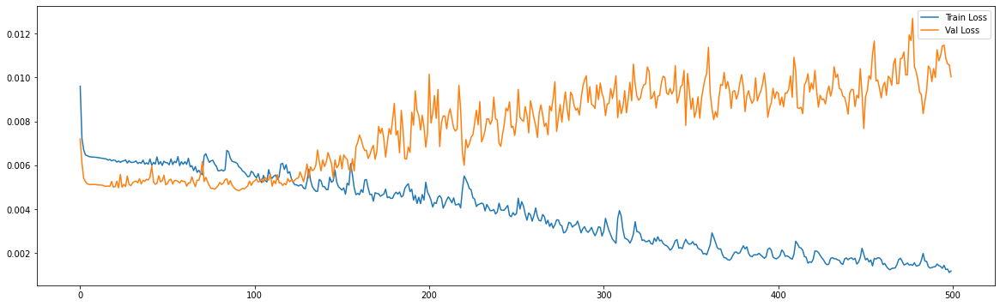

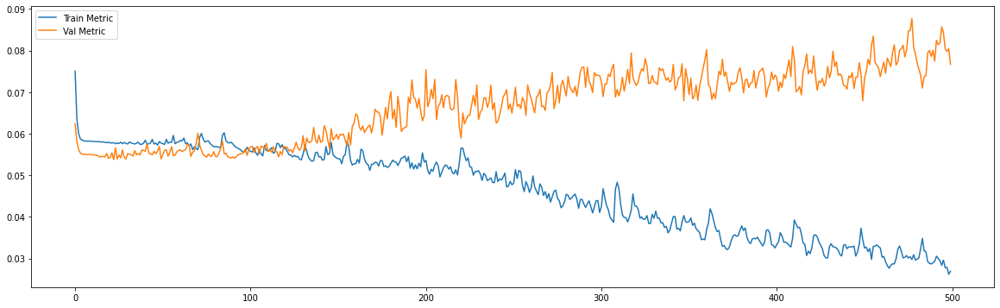



43/43 [==============================] - 0s 6ms/step - loss: 0.0013 - mae: 0.0279
loss and metric train data [0.0012693175813183188, 0.027884772047400475]
8/8 [==============================] - 0s 5ms/step - loss: 0.0100 - mae: 0.0767
loss and metric val data [0.01003158651292324, 0.07667165994644165]
8/8 [==============================] - 0s 5ms/step - loss: 0.0092 - mae: 0.0744
loss and metric test data [0.00920564029365778, 0.0743856206536293]


In [0]:
regressor = Sequential()
regressor.add(GRU(units=50, return_sequences=False, input_shape=(time_steps, n_features))) # return_sequences=False next layer is not LSTM
regressor.add(Dense(units=future_steps))

#Compiling the GRU
# mom = optimizers.SGD(lr=0.01, decay=1e-02, momentum=0.9,nesterov=True)
adam = optimizers.Adam(lr = 0.01, beta_1 = 0.9, beta_2 = 0.999, decay = 0.0)
# sgd = optimizers.SGD(lr=0.01, decay=1e-02, momentum=0.9,nesterov=True)
regressor.compile(optimizer = adam, loss = 'mse', metrics=['mae'])

# early stop
# es = EarlyStopping(monitor='val_loss', mode='min', verbose=1, patience=50)

#Fitting to traning set
history = regressor.fit(x_train, y_train, validation_data=(x_val,y_val), epochs = 500, batch_size=60, verbose = 0, shuffle= False
                        # , callbacks=[es]
                        )

plt.figure(figsize=(20,6))
plt.plot(history.history['loss'])
plt.plot(history.history['val_loss'])
plt.legend(['Train Loss', 'Val Loss'])

plt.figure(figsize=(20,6))
plt.plot(history.history['mae'])
plt.plot(history.history['val_mae'])
plt.legend(['Train Metric', 'Val Metric'])
plt.show()

print('\n')
print('loss and metric train data',regressor.evaluate(x_train,y_train))
print('loss and metric val data',regressor.evaluate(x_val,y_val))
print('loss and metric test data',regressor.evaluate(x_test,y_test))

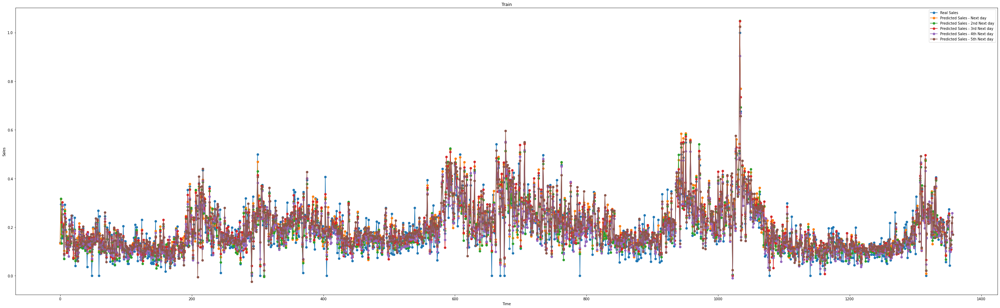

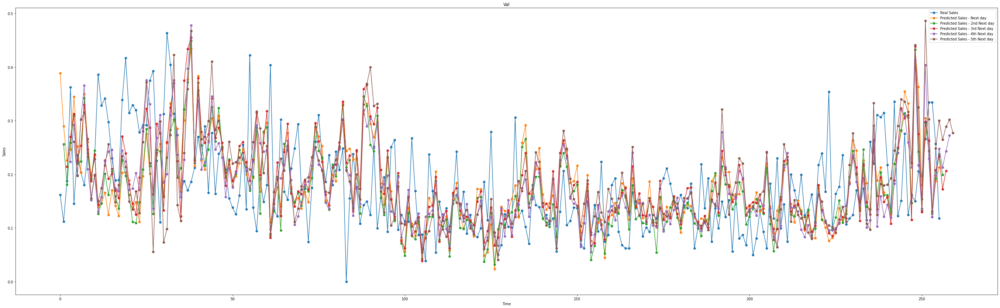

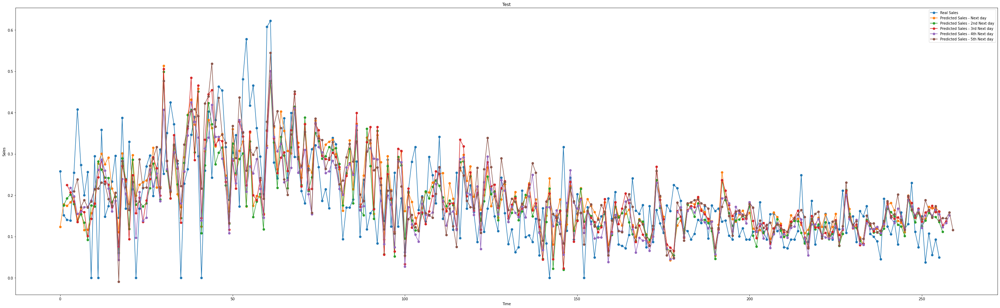

In [0]:
y_train_predict = regressor.predict(x_train)
y_val_predict = regressor.predict(x_val)
y_test_predict = regressor.predict(x_test)

plt.figure(figsize=(50,15))
plt.plot(y_train[:,0],marker='o',label='Real Sales')
plt.plot(y_train_predict[:,0],marker='o',label='Predicted Sales - Next day')
plt.plot(np.concatenate(([None],y_train_predict[:, 1])),marker='o',label='Predicted Sales - 2nd Next day')
plt.plot(np.concatenate(([None, None],y_train_predict[:, 2])),marker='o',label='Predicted Sales - 3rd Next day')
plt.plot(np.concatenate(([None, None, None],y_train_predict[:, 3])),marker='o',label='Predicted Sales - 4th Next day')
plt.plot(np.concatenate(([None, None, None,None],y_train_predict[:, 4])),marker='o',label='Predicted Sales - 5th Next day')
plt.title('Train')
plt.xlabel('Time')
plt.ylabel('Sales')
plt.legend()
plt.show()

plt.figure(figsize=(50,15))
plt.plot(y_val[:,0],marker='o',label='Real Sales')
plt.plot(y_val_predict[:,0],marker='o',label='Predicted Sales - Next day')
plt.plot(np.concatenate(([None],y_val_predict[:, 1])),marker='o',label='Predicted Sales - 2nd Next day')
plt.plot(np.concatenate(([None, None],y_val_predict[:, 2])),marker='o',label='Predicted Sales - 3rd Next day')
plt.plot(np.concatenate(([None, None, None],y_val_predict[:, 3])),marker='o',label='Predicted Sales - 4th Next day')
plt.plot(np.concatenate(([None, None, None,None],y_val_predict[:, 4])),marker='o',label='Predicted Sales - 5th Next day')
plt.title('Val')
plt.xlabel('Time')
plt.ylabel('Sales')
plt.legend()
plt.show()

plt.figure(figsize=(50,15))
plt.plot(y_test[:,0],marker='o',label='Real Sales')
plt.plot(y_test_predict[:,0],marker='o',label='Predicted Sales - Next day')
plt.plot(np.concatenate(([None],y_test_predict[:, 1])),marker='o',label='Predicted Sales - 2nd Next day')
plt.plot(np.concatenate(([None, None],y_test_predict[:, 2])),marker='o',label='Predicted Sales - 3rd Next day')
plt.plot(np.concatenate(([None, None, None],y_test_predict[:, 3])),marker='o',label='Predicted Sales - 4th Next day')
plt.plot(np.concatenate(([None, None, None,None],y_test_predict[:, 4])),marker='o',label='Predicted Sales - 5th Next day')
plt.title('Test')
plt.xlabel('Time')
plt.ylabel('Sales')
plt.legend()
plt.show()

### Decreasing Learning Rate

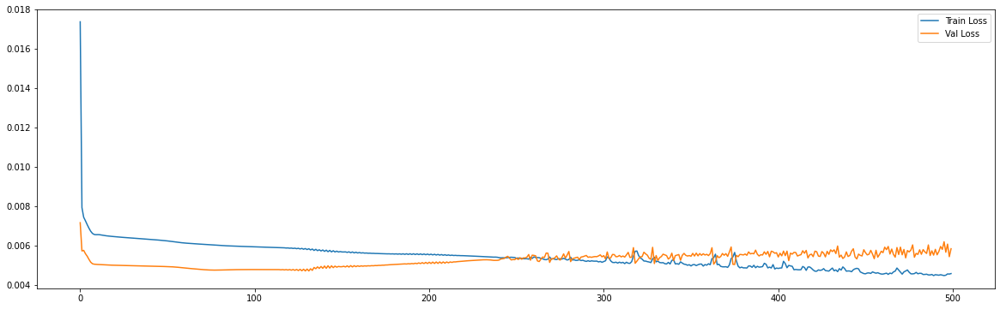

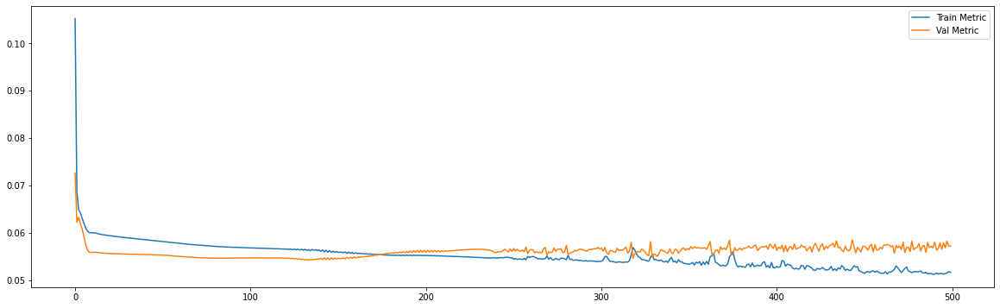



43/43 [==============================] - 0s 6ms/step - loss: 0.0045 - mae: 0.0506
loss and metric train data [0.00447889557108283, 0.05060448497533798]
8/8 [==============================] - 0s 5ms/step - loss: 0.0059 - mae: 0.0572
loss and metric val data [0.0058531370013952255, 0.05717754364013672]
8/8 [==============================] - 0s 5ms/step - loss: 0.0098 - mae: 0.0680
loss and metric test data [0.009822942316532135, 0.06800498068332672]


In [0]:
del regressor
regressor = Sequential()
regressor.add(GRU(units=50, return_sequences=False, input_shape=(time_steps, n_features))) # return_sequences=False next layer is not LSTM
regressor.add(Dense(units=future_steps))

#Compiling the GRU
# mom = optimizers.SGD(lr=0.01, decay=1e-02, momentum=0.9,nesterov=True)
adam = optimizers.Adam(lr = 0.001, beta_1 = 0.9, beta_2 = 0.999, decay = 0.0)
# sgd = optimizers.SGD(lr=0.01, decay=1e-02, momentum=0.9,nesterov=True)
regressor.compile(optimizer = adam, loss = 'mse', metrics=['mae'])

# early stop
# es = EarlyStopping(monitor='val_loss', mode='min', verbose=1, patience=50)

#Fitting to traning set
history = regressor.fit(x_train, y_train, validation_data=(x_val,y_val), epochs = 500, batch_size=60, verbose = 0, shuffle= False
                        # , callbacks=[es]
                        )

plt.figure(figsize=(20,6))
plt.plot(history.history['loss'])
plt.plot(history.history['val_loss'])
plt.legend(['Train Loss', 'Val Loss'])

plt.figure(figsize=(20,6))
plt.plot(history.history['mae'])
plt.plot(history.history['val_mae'])
plt.legend(['Train Metric', 'Val Metric'])
plt.show()

print('\n')
print('loss and metric train data',regressor.evaluate(x_train,y_train))
print('loss and metric val data',regressor.evaluate(x_val,y_val))
print('loss and metric test data',regressor.evaluate(x_test,y_test))

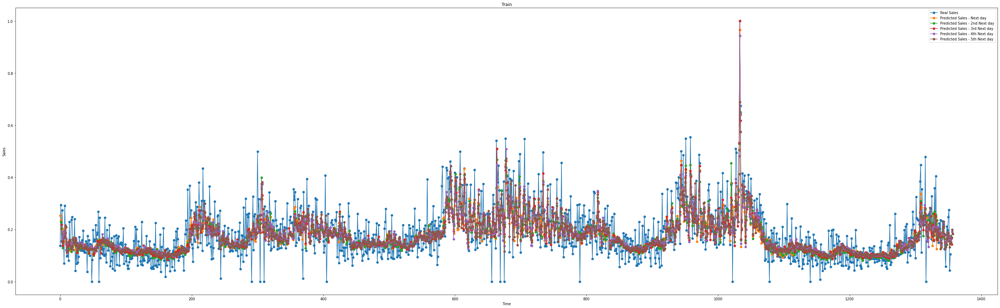

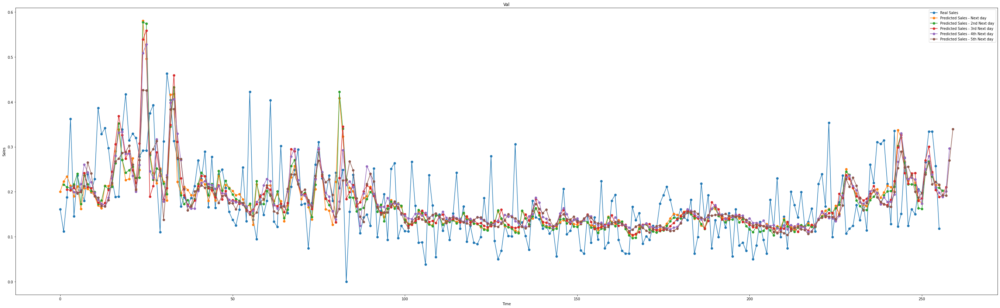

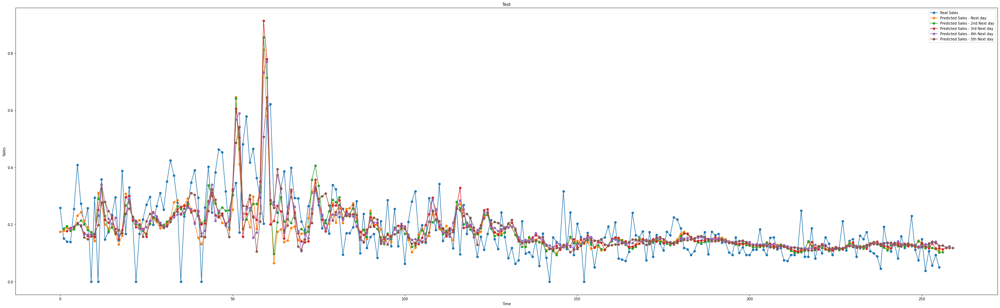

In [0]:
y_train_predict = regressor.predict(x_train)
y_val_predict = regressor.predict(x_val)
y_test_predict = regressor.predict(x_test)

plt.figure(figsize=(50,15))
plt.plot(y_train[:,0],marker='o',label='Real Sales')
plt.plot(y_train_predict[:,0],marker='o',label='Predicted Sales - Next day')
plt.plot(np.concatenate(([None],y_train_predict[:, 1])),marker='o',label='Predicted Sales - 2nd Next day')
plt.plot(np.concatenate(([None, None],y_train_predict[:, 2])),marker='o',label='Predicted Sales - 3rd Next day')
plt.plot(np.concatenate(([None, None, None],y_train_predict[:, 3])),marker='o',label='Predicted Sales - 4th Next day')
plt.plot(np.concatenate(([None, None, None,None],y_train_predict[:, 4])),marker='o',label='Predicted Sales - 5th Next day')
plt.title('Train')
plt.xlabel('Time')
plt.ylabel('Sales')
plt.legend()
plt.show()

plt.figure(figsize=(50,15))
plt.plot(y_val[:,0],marker='o',label='Real Sales')
plt.plot(y_val_predict[:,0],marker='o',label='Predicted Sales - Next day')
plt.plot(np.concatenate(([None],y_val_predict[:, 1])),marker='o',label='Predicted Sales - 2nd Next day')
plt.plot(np.concatenate(([None, None],y_val_predict[:, 2])),marker='o',label='Predicted Sales - 3rd Next day')
plt.plot(np.concatenate(([None, None, None],y_val_predict[:, 3])),marker='o',label='Predicted Sales - 4th Next day')
plt.plot(np.concatenate(([None, None, None,None],y_val_predict[:, 4])),marker='o',label='Predicted Sales - 5th Next day')
plt.title('Val')
plt.xlabel('Time')
plt.ylabel('Sales')
plt.legend()
plt.show()

plt.figure(figsize=(50,15))
plt.plot(y_test[:,0],marker='o',label='Real Sales')
plt.plot(y_test_predict[:,0],marker='o',label='Predicted Sales - Next day')
plt.plot(np.concatenate(([None],y_test_predict[:, 1])),marker='o',label='Predicted Sales - 2nd Next day')
plt.plot(np.concatenate(([None, None],y_test_predict[:, 2])),marker='o',label='Predicted Sales - 3rd Next day')
plt.plot(np.concatenate(([None, None, None],y_test_predict[:, 3])),marker='o',label='Predicted Sales - 4th Next day')
plt.plot(np.concatenate(([None, None, None,None],y_test_predict[:, 4])),marker='o',label='Predicted Sales - 5th Next day')
plt.title('Test')
plt.xlabel('Time')
plt.ylabel('Sales')
plt.legend()
plt.show()

#### Dropout

---

- Dropout = 0.2
- Dropout = 0.4 (MELHOR)

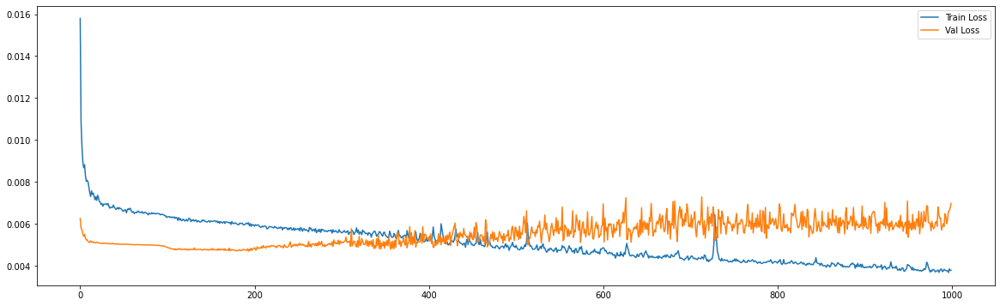

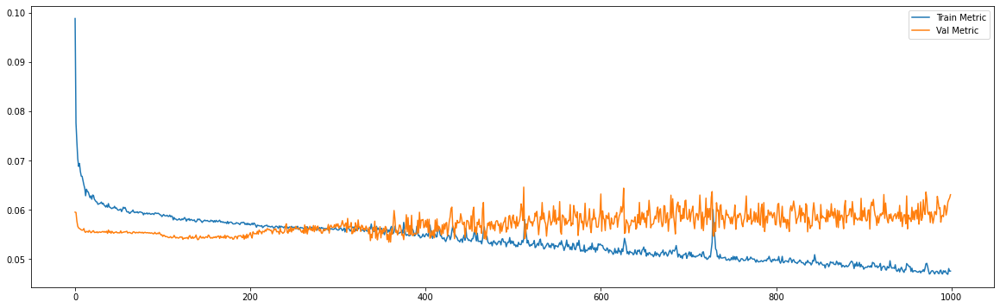



43/43 [==============================] - 0s 10ms/step - loss: 0.0032 - mae: 0.0443
loss and metric train data [0.0032374162692576647, 0.044280044734478]
8/8 [==============================] - 0s 9ms/step - loss: 0.0070 - mae: 0.0631
loss and metric val data [0.006970100104808807, 0.06305856257677078]
8/8 [==============================] - 0s 8ms/step - loss: 0.0109 - mae: 0.0752
loss and metric test data [0.010872077196836472, 0.07522899657487869]


In [0]:
# del regressor
regressor = Sequential()
regressor.add(GRU(units=50, return_sequences=True, input_shape=(time_steps, n_features))) # return_sequences=False next layer is not GRU
regressor.add(Dropout(0.4))
regressor.add(GRU(units=50, return_sequences=False))
regressor.add(Dropout(0.4))
regressor.add(Dense(units=future_steps))

#Compiling the GRU
# mom = optimizers.SGD(lr=0.01, decay=1e-02, momentum=0.9,nesterov=True)
adam = optimizers.Adam(lr = 0.001, beta_1 = 0.9, beta_2 = 0.999, decay = 0.0)
# sgd = optimizers.SGD(lr=0.01, decay=1e-02, momentum=0.9,nesterov=True)
regressor.compile(optimizer = adam, loss = 'mse', metrics=['mae'])

# early stop
# es = EarlyStopping(monitor='val_loss', mode='min', verbose=1, patience=50)

#Fitting to traning set
history = regressor.fit(x_train, y_train, validation_data=(x_val,y_val), epochs = 1000, batch_size=60, verbose = 0, shuffle= False
                        # , callbacks=[es]
                        )

plt.figure(figsize=(20,6))
plt.plot(history.history['loss'])
plt.plot(history.history['val_loss'])
plt.legend(['Train Loss', 'Val Loss'])

plt.figure(figsize=(20,6))
plt.plot(history.history['mae'])
plt.plot(history.history['val_mae'])
plt.legend(['Train Metric', 'Val Metric'])
plt.show()

print('\n')
print('loss and metric train data',regressor.evaluate(x_train,y_train))
print('loss and metric val data',regressor.evaluate(x_val,y_val))
print('loss and metric test data',regressor.evaluate(x_test,y_test))

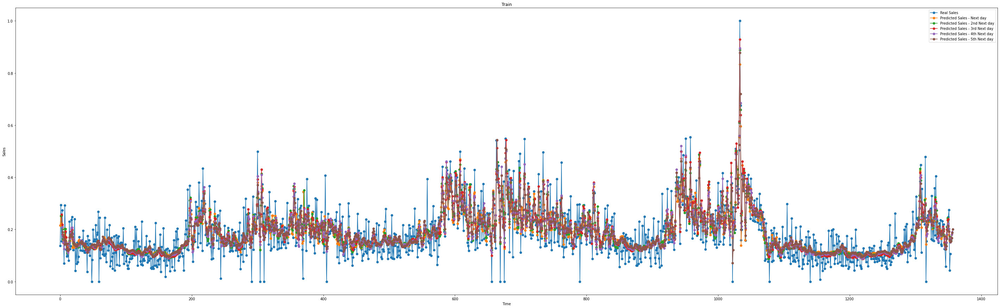

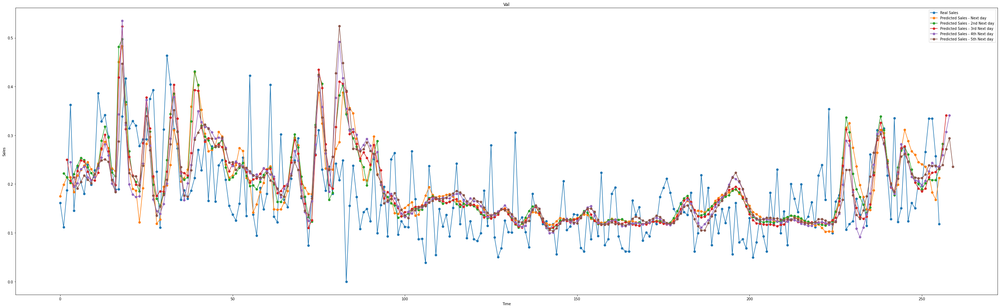

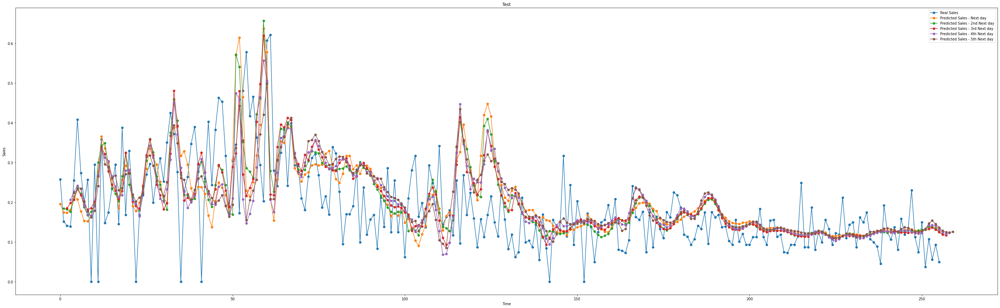

In [0]:
y_train_predict = regressor.predict(x_train)
y_val_predict = regressor.predict(x_val)
y_test_predict = regressor.predict(x_test)

plt.figure(figsize=(50,15))
plt.plot(y_train[:,0],marker='o',label='Real Sales')
plt.plot(y_train_predict[:,0],marker='o',label='Predicted Sales - Next day')
plt.plot(np.concatenate(([None],y_train_predict[:, 1])),marker='o',label='Predicted Sales - 2nd Next day')
plt.plot(np.concatenate(([None, None],y_train_predict[:, 2])),marker='o',label='Predicted Sales - 3rd Next day')
plt.plot(np.concatenate(([None, None, None],y_train_predict[:, 3])),marker='o',label='Predicted Sales - 4th Next day')
plt.plot(np.concatenate(([None, None, None,None],y_train_predict[:, 4])),marker='o',label='Predicted Sales - 5th Next day')
plt.title('Train')
plt.xlabel('Time')
plt.ylabel('Sales')
plt.legend()
plt.show()

plt.figure(figsize=(50,15))
plt.plot(y_val[:,0],marker='o',label='Real Sales')
plt.plot(y_val_predict[:,0],marker='o',label='Predicted Sales - Next day')
plt.plot(np.concatenate(([None],y_val_predict[:, 1])),marker='o',label='Predicted Sales - 2nd Next day')
plt.plot(np.concatenate(([None, None],y_val_predict[:, 2])),marker='o',label='Predicted Sales - 3rd Next day')
plt.plot(np.concatenate(([None, None, None],y_val_predict[:, 3])),marker='o',label='Predicted Sales - 4th Next day')
plt.plot(np.concatenate(([None, None, None,None],y_val_predict[:, 4])),marker='o',label='Predicted Sales - 5th Next day')
plt.title('Val')
plt.xlabel('Time')
plt.ylabel('Sales')
plt.legend()
plt.show()

plt.figure(figsize=(50,15))
plt.plot(y_test[:,0],marker='o',label='Real Sales')
plt.plot(y_test_predict[:,0],marker='o',label='Predicted Sales - Next day')
plt.plot(np.concatenate(([None],y_test_predict[:, 1])),marker='o',label='Predicted Sales - 2nd Next day')
plt.plot(np.concatenate(([None, None],y_test_predict[:, 2])),marker='o',label='Predicted Sales - 3rd Next day')
plt.plot(np.concatenate(([None, None, None],y_test_predict[:, 3])),marker='o',label='Predicted Sales - 4th Next day')
plt.plot(np.concatenate(([None, None, None,None],y_test_predict[:, 4])),marker='o',label='Predicted Sales - 5th Next day')
plt.title('Test')
plt.xlabel('Time')
plt.ylabel('Sales')
plt.legend()
plt.show()

#### L2 + Dropout

---

- Dropout = 0.4  + l2 = 0.001

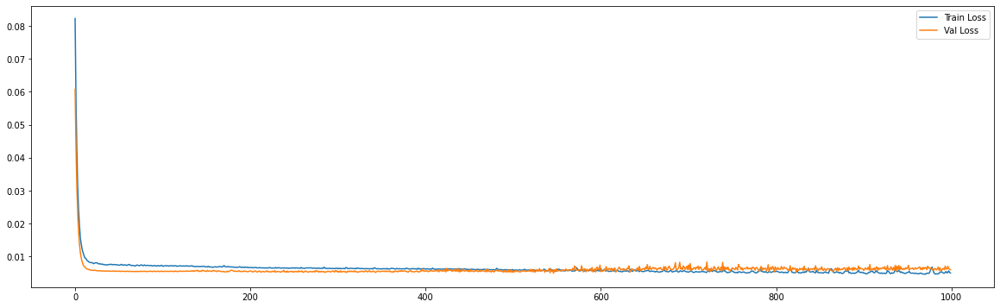

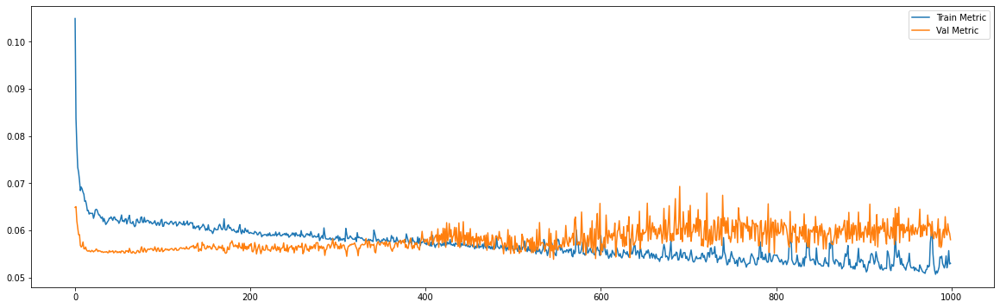



43/43 [==============================] - 0s 10ms/step - loss: 0.0047 - mae: 0.0502
loss and metric train data [0.004675442352890968, 0.05021343007683754]
8/8 [==============================] - 0s 9ms/step - loss: 0.0060 - mae: 0.0580
loss and metric val data [0.006027780007570982, 0.058001548051834106]
8/8 [==============================] - 0s 9ms/step - loss: 0.0078 - mae: 0.0652
loss and metric test data [0.007840144447982311, 0.06520229578018188]


In [0]:
# del regressor
regressor = Sequential()
regressor.add(GRU(units=50, return_sequences=True, kernel_regularizer=regularizers.l2(0.001),input_shape=(time_steps, n_features))) # return_sequences=False next layer is not GRU
regressor.add(Dropout(0.4))
regressor.add(GRU(units=50, return_sequences=False,kernel_regularizer=regularizers.l2(0.001)))
regressor.add(Dropout(0.4))
regressor.add(Dense(units=future_steps))

#Compiling the GRU
# mom = optimizers.SGD(lr=0.01, decay=1e-02, momentum=0.9,nesterov=True)
adam = optimizers.Adam(lr = 0.001, beta_1 = 0.9, beta_2 = 0.999, decay = 0.0)
# sgd = optimizers.SGD(lr=0.01, decay=1e-02, momentum=0.9,nesterov=True)
regressor.compile(optimizer = adam, loss = 'mse', metrics=['mae'])

# early stop
# es = EarlyStopping(monitor='val_loss', mode='min', verbose=1, patience=50)

#Fitting to traning set
history = regressor.fit(x_train, y_train, validation_data=(x_val,y_val), epochs = 1000, batch_size=60, verbose = 0, shuffle= False
                        # , callbacks=[es]
                        )

plt.figure(figsize=(20,6))
plt.plot(history.history['loss'])
plt.plot(history.history['val_loss'])
plt.legend(['Train Loss', 'Val Loss'])

plt.figure(figsize=(20,6))
plt.plot(history.history['mae'])
plt.plot(history.history['val_mae'])
plt.legend(['Train Metric', 'Val Metric'])
plt.show()

print('\n')
print('loss and metric train data',regressor.evaluate(x_train,y_train))
print('loss and metric val data',regressor.evaluate(x_val,y_val))
print('loss and metric test data',regressor.evaluate(x_test,y_test))

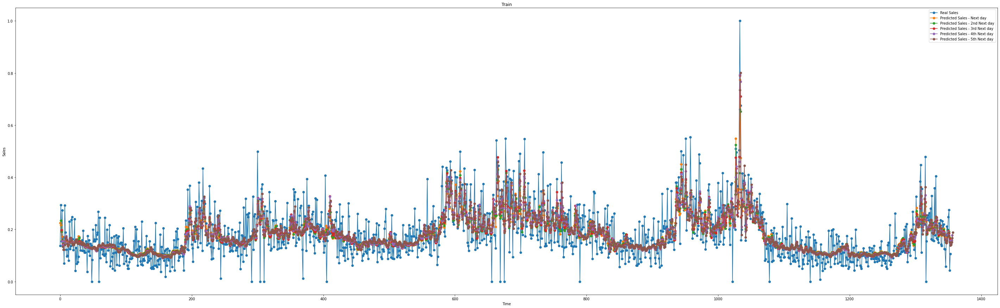

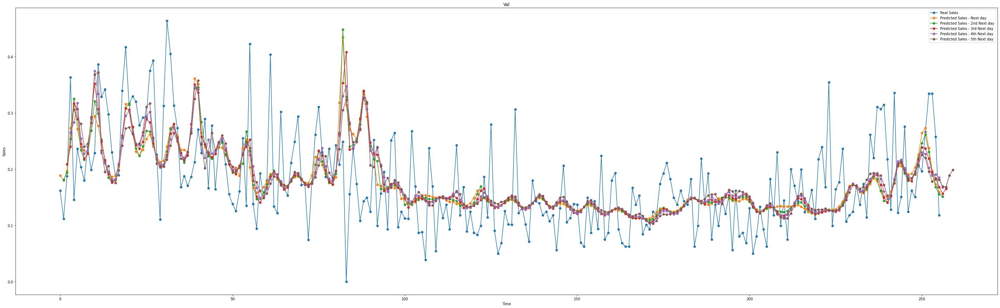

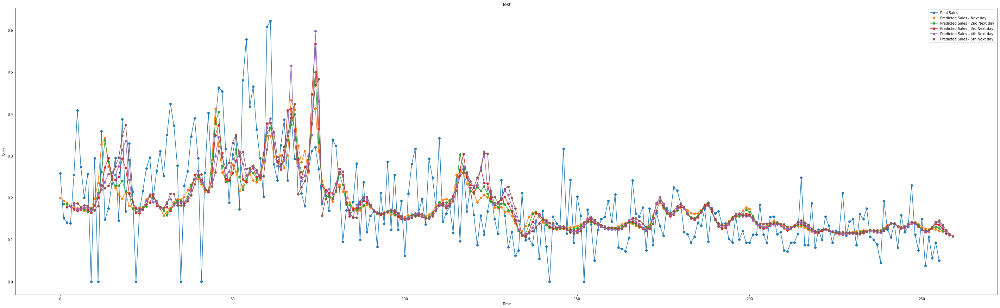

In [0]:
y_train_predict = regressor.predict(x_train)
y_val_predict = regressor.predict(x_val)
y_test_predict = regressor.predict(x_test)

plt.figure(figsize=(50,15))
plt.plot(y_train[:,0],marker='o',label='Real Sales')
plt.plot(y_train_predict[:,0],marker='o',label='Predicted Sales - Next day')
plt.plot(np.concatenate(([None],y_train_predict[:, 1])),marker='o',label='Predicted Sales - 2nd Next day')
plt.plot(np.concatenate(([None, None],y_train_predict[:, 2])),marker='o',label='Predicted Sales - 3rd Next day')
plt.plot(np.concatenate(([None, None, None],y_train_predict[:, 3])),marker='o',label='Predicted Sales - 4th Next day')
plt.plot(np.concatenate(([None, None, None,None],y_train_predict[:, 4])),marker='o',label='Predicted Sales - 5th Next day')
plt.title('Train')
plt.xlabel('Time')
plt.ylabel('Sales')
plt.legend()
plt.show()

plt.figure(figsize=(50,15))
plt.plot(y_val[:,0],marker='o',label='Real Sales')
plt.plot(y_val_predict[:,0],marker='o',label='Predicted Sales - Next day')
plt.plot(np.concatenate(([None],y_val_predict[:, 1])),marker='o',label='Predicted Sales - 2nd Next day')
plt.plot(np.concatenate(([None, None],y_val_predict[:, 2])),marker='o',label='Predicted Sales - 3rd Next day')
plt.plot(np.concatenate(([None, None, None],y_val_predict[:, 3])),marker='o',label='Predicted Sales - 4th Next day')
plt.plot(np.concatenate(([None, None, None,None],y_val_predict[:, 4])),marker='o',label='Predicted Sales - 5th Next day')
plt.title('Val')
plt.xlabel('Time')
plt.ylabel('Sales')
plt.legend()
plt.show()

plt.figure(figsize=(50,15))
plt.plot(y_test[:,0],marker='o',label='Real Sales')
plt.plot(y_test_predict[:,0],marker='o',label='Predicted Sales - Next day')
plt.plot(np.concatenate(([None],y_test_predict[:, 1])),marker='o',label='Predicted Sales - 2nd Next day')
plt.plot(np.concatenate(([None, None],y_test_predict[:, 2])),marker='o',label='Predicted Sales - 3rd Next day')
plt.plot(np.concatenate(([None, None, None],y_test_predict[:, 3])),marker='o',label='Predicted Sales - 4th Next day')
plt.plot(np.concatenate(([None, None, None,None],y_test_predict[:, 4])),marker='o',label='Predicted Sales - 5th Next day')
plt.title('Test')
plt.xlabel('Time')
plt.ylabel('Sales')
plt.legend()
plt.show()

### Decreasing model complexity

#### 30 neurons + Dropout

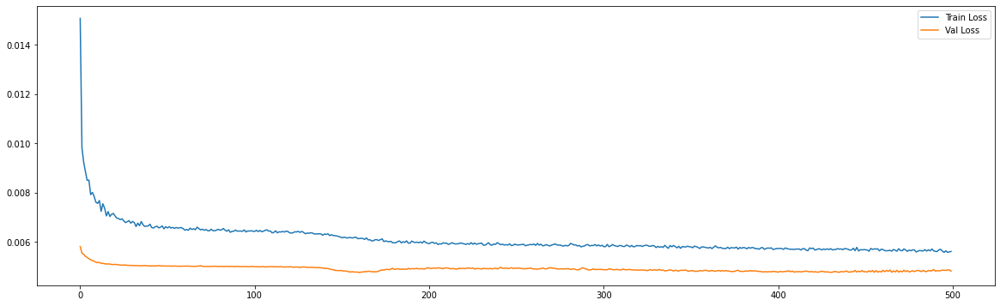

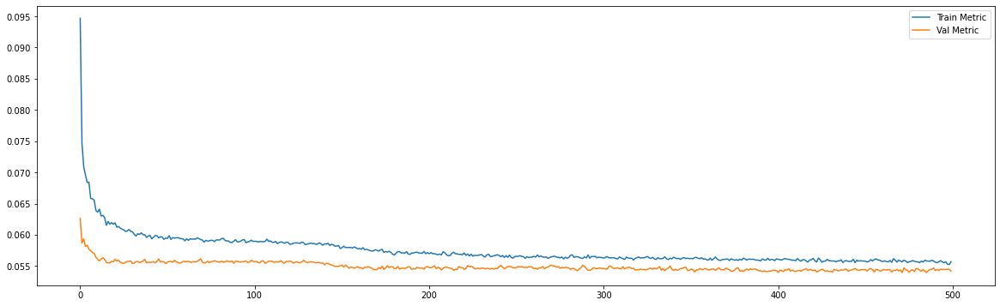



43/43 [==============================] - 0s 5ms/step - loss: 0.0054 - mae: 0.0546
loss and metric train data [0.005412366706877947, 0.054559603333473206]
8/8 [==============================] - 0s 5ms/step - loss: 0.0048 - mae: 0.0542
loss and metric val data [0.004814841318875551, 0.05418836325407028]
8/8 [==============================] - 0s 4ms/step - loss: 0.0070 - mae: 0.0629
loss and metric test data [0.006990830879658461, 0.06291639059782028]


In [0]:
del regressor
regressor = Sequential()
regressor.add(GRU(units=30, return_sequences=False, input_shape=(time_steps, n_features))) # return_sequences=False next layer is not GRU
regressor.add(Dropout(0.3))
regressor.add(Dense(units=future_steps))

#Compiling the GRU
# mom = optimizers.SGD(lr=0.01, decay=1e-02, momentum=0.9,nesterov=True)
adam = optimizers.Adam(lr = 0.001, beta_1 = 0.9, beta_2 = 0.999, decay = 0.0)
# sgd = optimizers.SGD(lr=0.01, decay=1e-02, momentum=0.9,nesterov=True)
regressor.compile(optimizer = adam, loss = 'mse', metrics=['mae'])

# early stop
# es = EarlyStopping(monitor='val_loss', mode='min', verbose=1, patience=50)

#Fitting to traning set
history = regressor.fit(x_train, y_train, validation_data=(x_val,y_val), epochs = 500, batch_size=60, verbose = 0, shuffle= False
                        # , callbacks=[es]
                        )

plt.figure(figsize=(20,6))
plt.plot(history.history['loss'])
plt.plot(history.history['val_loss'])
plt.legend(['Train Loss', 'Val Loss'])

plt.figure(figsize=(20,6))
plt.plot(history.history['mae'])
plt.plot(history.history['val_mae'])
plt.legend(['Train Metric', 'Val Metric'])
plt.show()

print('\n')
print('loss and metric train data',regressor.evaluate(x_train,y_train))
print('loss and metric val data',regressor.evaluate(x_val,y_val))
print('loss and metric test data',regressor.evaluate(x_test,y_test))

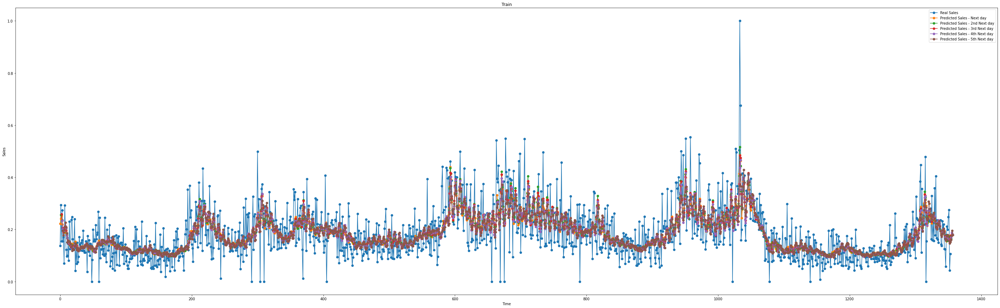

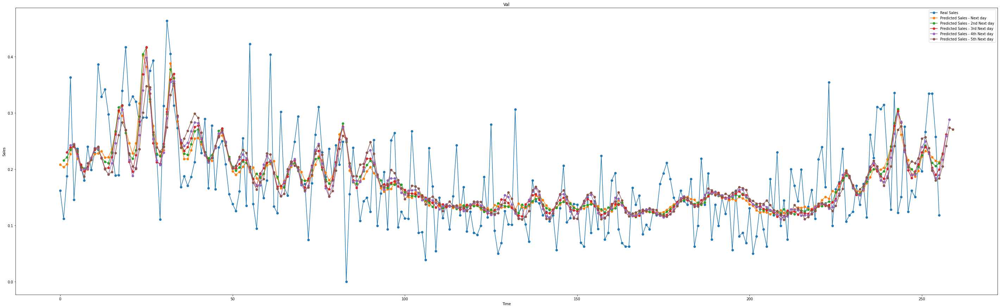

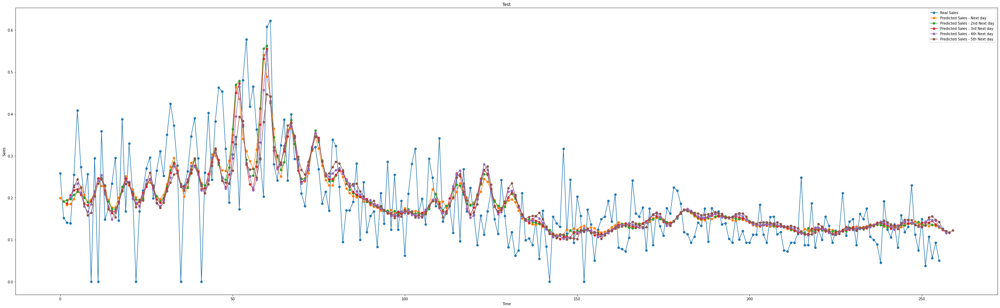

In [0]:
y_train_predict = regressor.predict(x_train)
y_val_predict = regressor.predict(x_val)
y_test_predict = regressor.predict(x_test)

plt.figure(figsize=(50,15))
plt.plot(y_train[:,0],marker='o',label='Real Sales')
plt.plot(y_train_predict[:,0],marker='o',label='Predicted Sales - Next day')
plt.plot(np.concatenate(([None],y_train_predict[:, 1])),marker='o',label='Predicted Sales - 2nd Next day')
plt.plot(np.concatenate(([None, None],y_train_predict[:, 2])),marker='o',label='Predicted Sales - 3rd Next day')
plt.plot(np.concatenate(([None, None, None],y_train_predict[:, 3])),marker='o',label='Predicted Sales - 4th Next day')
plt.plot(np.concatenate(([None, None, None,None],y_train_predict[:, 4])),marker='o',label='Predicted Sales - 5th Next day')
plt.title('Train')
plt.xlabel('Time')
plt.ylabel('Sales')
plt.legend()
plt.show()

plt.figure(figsize=(50,15))
plt.plot(y_val[:,0],marker='o',label='Real Sales')
plt.plot(y_val_predict[:,0],marker='o',label='Predicted Sales - Next day')
plt.plot(np.concatenate(([None],y_val_predict[:, 1])),marker='o',label='Predicted Sales - 2nd Next day')
plt.plot(np.concatenate(([None, None],y_val_predict[:, 2])),marker='o',label='Predicted Sales - 3rd Next day')
plt.plot(np.concatenate(([None, None, None],y_val_predict[:, 3])),marker='o',label='Predicted Sales - 4th Next day')
plt.plot(np.concatenate(([None, None, None,None],y_val_predict[:, 4])),marker='o',label='Predicted Sales - 5th Next day')
plt.title('Val')
plt.xlabel('Time')
plt.ylabel('Sales')
plt.legend()
plt.show()

plt.figure(figsize=(50,15))
plt.plot(y_test[:,0],marker='o',label='Real Sales')
plt.plot(y_test_predict[:,0],marker='o',label='Predicted Sales - Next day')
plt.plot(np.concatenate(([None],y_test_predict[:, 1])),marker='o',label='Predicted Sales - 2nd Next day')
plt.plot(np.concatenate(([None, None],y_test_predict[:, 2])),marker='o',label='Predicted Sales - 3rd Next day')
plt.plot(np.concatenate(([None, None, None],y_test_predict[:, 3])),marker='o',label='Predicted Sales - 4th Next day')
plt.plot(np.concatenate(([None, None, None,None],y_test_predict[:, 4])),marker='o',label='Predicted Sales - 5th Next day')
plt.title('Test')
plt.xlabel('Time')
plt.ylabel('Sales')
plt.legend()
plt.show()

### Variations

#### 20/25/50 neurons

Epoch 00367: early stopping
============================model:0===========================
45/45 [==============================] - 0s 2ms/step - loss: 0.0057 - mae: 0.0558
loss and metric train data [0.005716872867196798, 0.055752869695425034]
9/9 [==============================] - 0s 2ms/step - loss: 0.0049 - mae: 0.0554
loss and metric val data [0.004916392266750336, 0.05540670081973076]
9/9 [==============================] - 0s 3ms/step - loss: 0.0060 - mae: 0.0570
loss and metric test data [0.0059645455330610275, 0.0569976381957531]


'neurons': 20, 'dropout': 0.2, 'time_steps': 30, 'batch_size':30, 'learning_rate':0.001, 'hidden_layers':1




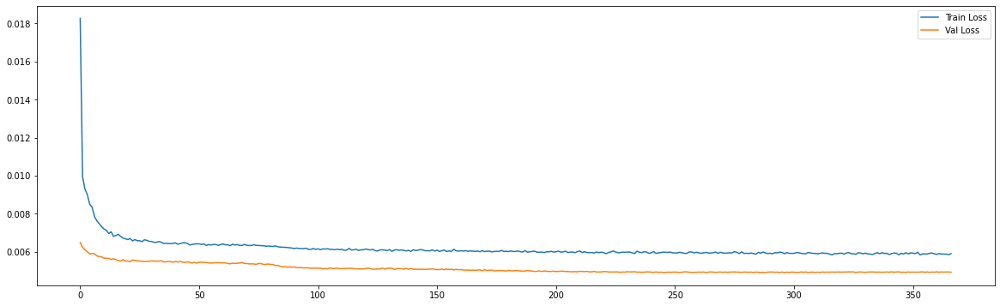

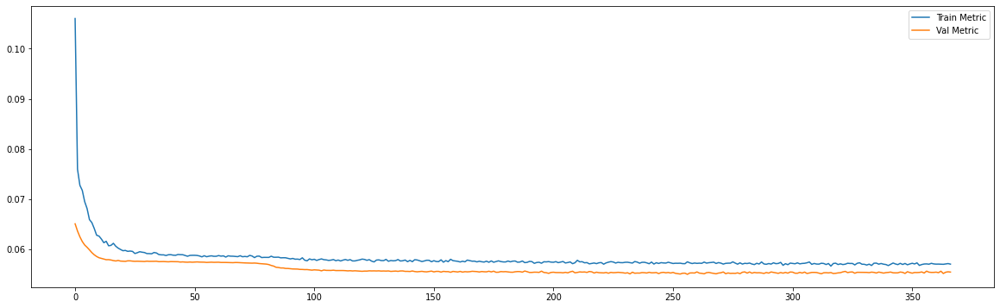

Epoch 00362: early stopping
============================model:1===========================
45/45 [==============================] - 0s 3ms/step - loss: 0.0055 - mae: 0.0553
loss and metric train data [0.00554933724924922, 0.05531824752688408]
9/9 [==============================] - 0s 3ms/step - loss: 0.0050 - mae: 0.0557
loss and metric val data [0.005009285639971495, 0.05567092448472977]
9/9 [==============================] - 0s 3ms/step - loss: 0.0063 - mae: 0.0579
loss and metric test data [0.00634456891566515, 0.05793353542685509]


'neurons': 20, 'dropout': 0.2, 'time_steps': 30, 'batch_size':30, 'hidden_layers':2




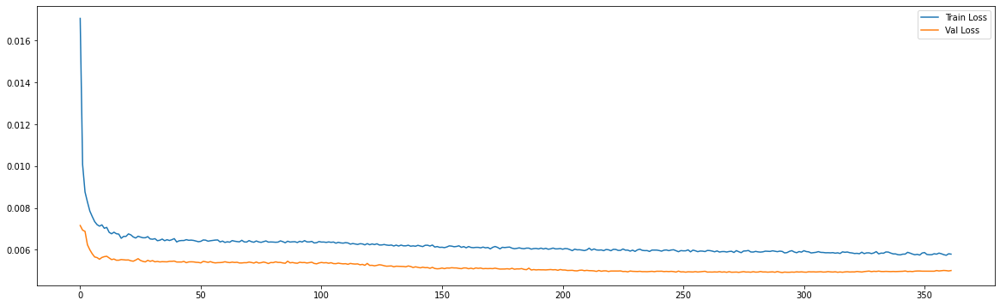

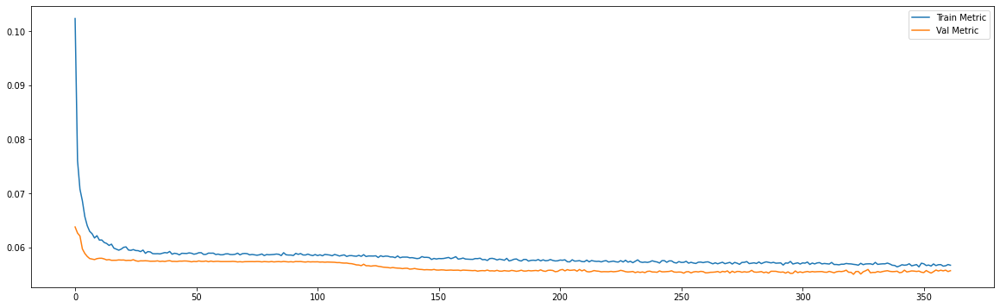

Epoch 00311: early stopping
============================model:2===========================
43/43 [==============================] - 0s 3ms/step - loss: 0.0058 - mae: 0.0560
loss and metric train data [0.00578785827383399, 0.05599810928106308]
8/8 [==============================] - 0s 3ms/step - loss: 0.0048 - mae: 0.0543
loss and metric val data [0.004835652187466621, 0.054321397095918655]
8/8 [==============================] - 0s 3ms/step - loss: 0.0068 - mae: 0.0619
loss and metric test data [0.006823192350566387, 0.0619315542280674]


'neurons': 20, 'dropout': 0.2, 'time_steps': 60, 'batch_size':60, 'learning_rate':0.001, 'hidden_layers':1




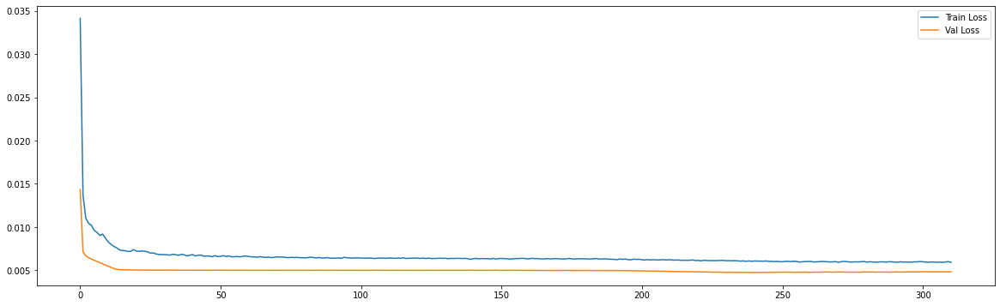

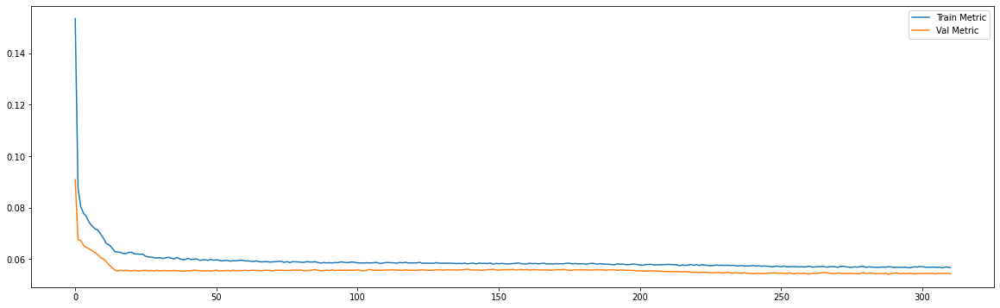

Epoch 00368: early stopping
============================model:3===========================
43/43 [==============================] - 0s 4ms/step - loss: 0.0056 - mae: 0.0554
loss and metric train data [0.005570624023675919, 0.055411893874406815]
8/8 [==============================] - 0s 4ms/step - loss: 0.0048 - mae: 0.0550
loss and metric val data [0.004834670573472977, 0.054967135190963745]
8/8 [==============================] - 0s 4ms/step - loss: 0.0073 - mae: 0.0635
loss and metric test data [0.0072985379956662655, 0.06351934373378754]


'neurons': 20, 'dropout': 0.2, 'time_steps': 60, 'batch_size':60, 'hidden_layers':2




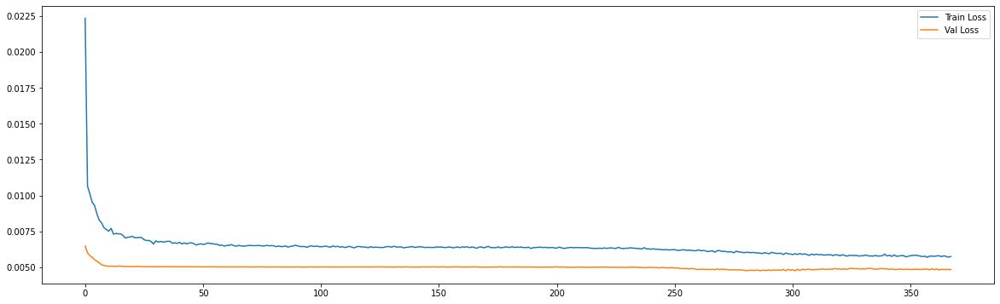

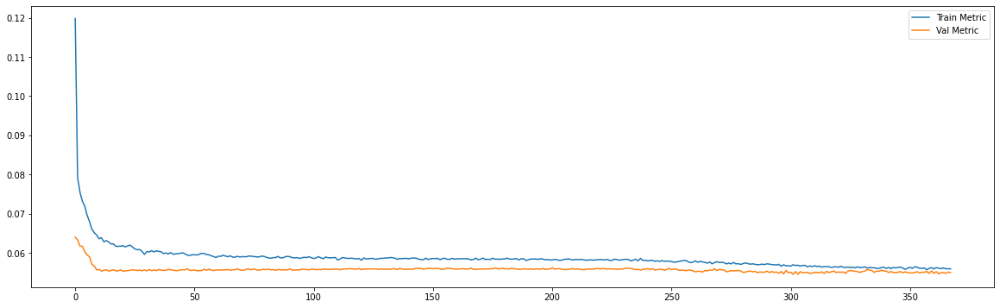

Epoch 00211: early stopping
============================model:4===========================
39/39 [==============================] - 0s 3ms/step - loss: 0.0062 - mae: 0.0575
loss and metric train data [0.006242106668651104, 0.05753002315759659]
7/7 [==============================] - 0s 3ms/step - loss: 0.0049 - mae: 0.0546
loss and metric val data [0.004857826512306929, 0.05456051975488663]
7/7 [==============================] - 0s 3ms/step - loss: 0.0085 - mae: 0.0705
loss and metric test data [0.00845723133534193, 0.07045967131853104]


'neurons': 20, 'dropout': 0.2, 'time_steps': 120, 'batch_size':120, 'learning_rate':0.001, 'hidden_layers':1




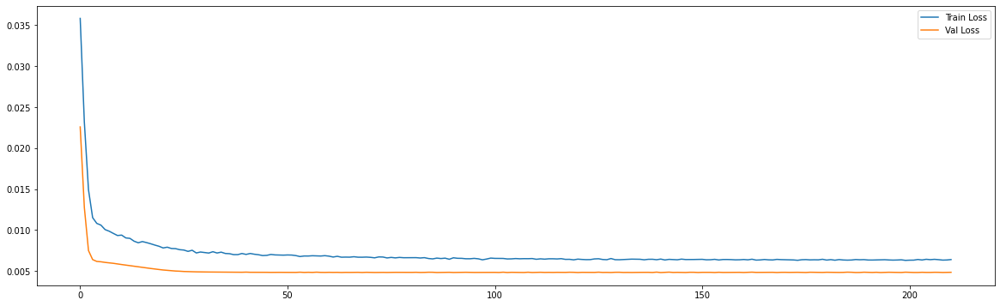

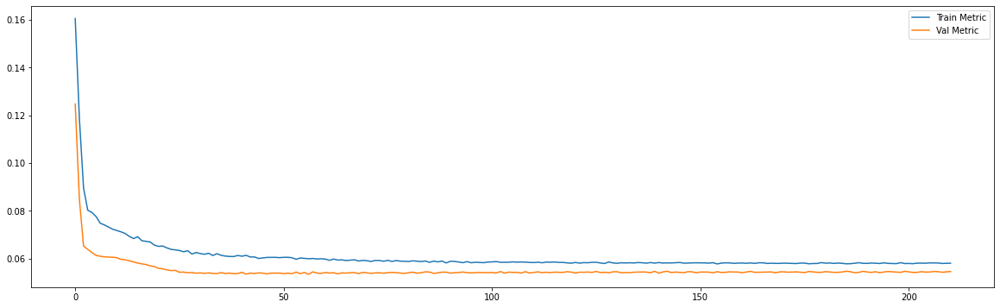

Epoch 00149: early stopping
============================model:5===========================
39/39 [==============================] - 0s 5ms/step - loss: 0.0062 - mae: 0.0571
loss and metric train data [0.006243582349270582, 0.057079896330833435]
7/7 [==============================] - 0s 5ms/step - loss: 0.0048 - mae: 0.0542
loss and metric val data [0.004823579452931881, 0.0541871078312397]
7/7 [==============================] - 0s 5ms/step - loss: 0.0085 - mae: 0.0702
loss and metric test data [0.008453570306301117, 0.07018569111824036]


'neurons': 20, 'dropout': 0.2, 'time_steps': 120, 'batch_size':120, 'hidden_layers':2




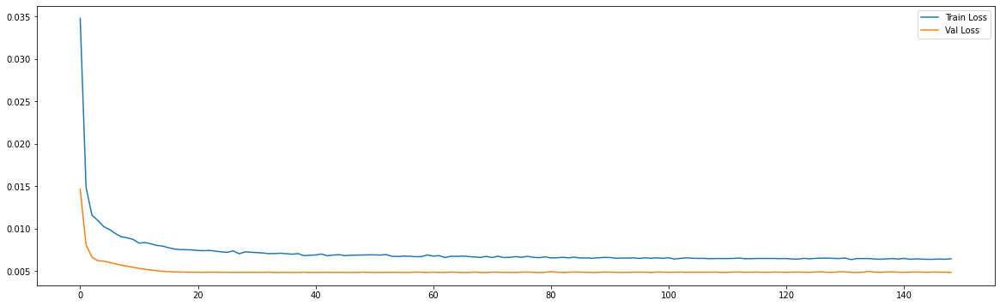

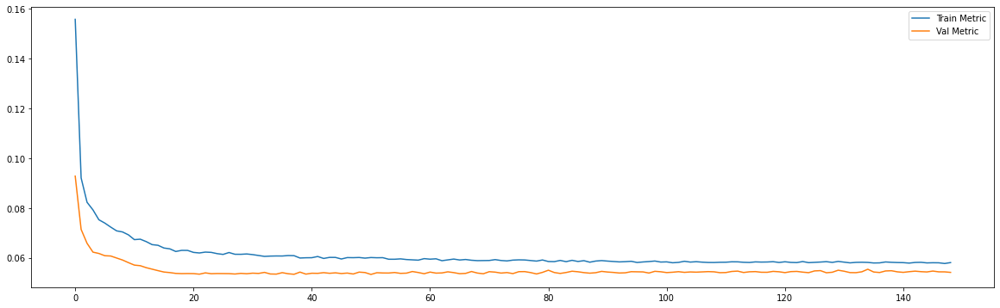

============================model:6===========================
32/32 [==============================] - 0s 5ms/step - loss: 0.0070 - mae: 0.0617
loss and metric train data [0.006978029850870371, 0.061706315726041794]
3/3 [==============================] - 0s 4ms/step - loss: 0.0066 - mae: 0.0652
loss and metric val data [0.006641107145696878, 0.06521307677030563]
3/3 [==============================] - 0s 4ms/step - loss: 0.0141 - mae: 0.0934
loss and metric test data [0.014082727022469044, 0.09335502982139587]


'neurons': 20, 'dropout': 0.2, 'time_steps': 240, 'batch_size':240, 'learning_rate':0.001, 'hidden_layers':1




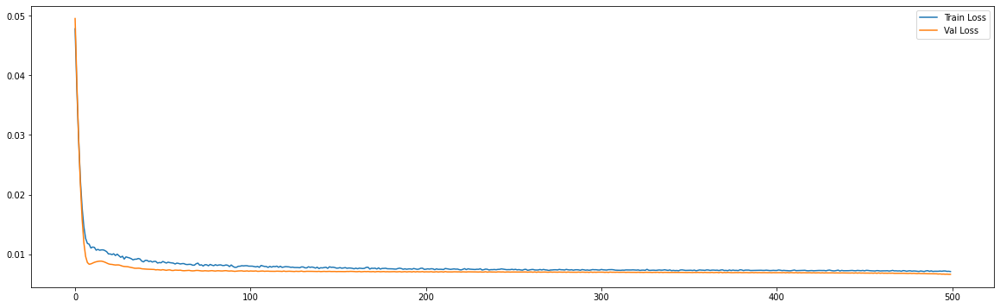

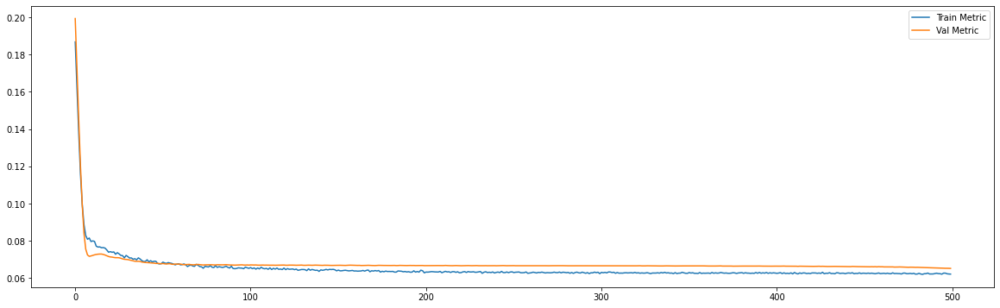

============================model:7===========================
32/32 [==============================] - 0s 8ms/step - loss: 0.0071 - mae: 0.0619
loss and metric train data [0.007086001802235842, 0.0619172677397728]
3/3 [==============================] - 0s 6ms/step - loss: 0.0069 - mae: 0.0663
loss and metric val data [0.006864097435027361, 0.06634662300348282]
3/3 [==============================] - 0s 6ms/step - loss: 0.0143 - mae: 0.0940
loss and metric test data [0.014290916733443737, 0.09397968649864197]


'neurons': 20, 'dropout': 0.2, 'time_steps': 240, 'batch_size':240, 'hidden_layers':2




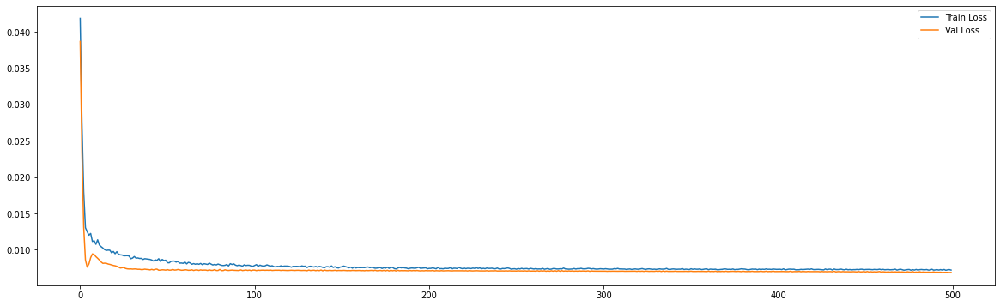

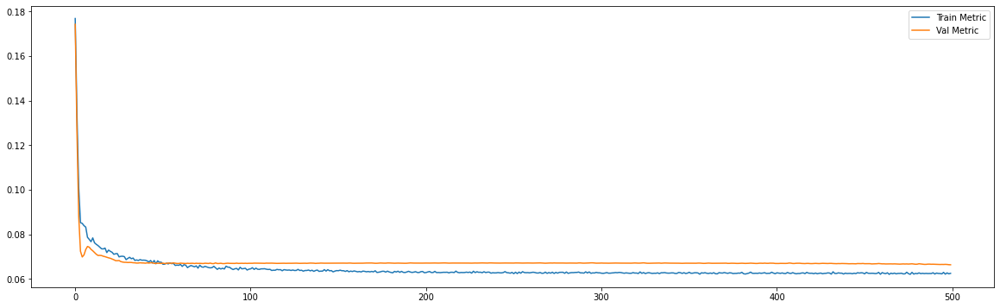

Epoch 00399: early stopping
============================model:8===========================
45/45 [==============================] - 0s 2ms/step - loss: 0.0057 - mae: 0.0561
loss and metric train data [0.005737171042710543, 0.05607327073812485]
9/9 [==============================] - 0s 2ms/step - loss: 0.0049 - mae: 0.0561
loss and metric val data [0.004949373193085194, 0.0561482235789299]
9/9 [==============================] - 0s 2ms/step - loss: 0.0060 - mae: 0.0571
loss and metric test data [0.0059723262675106525, 0.05713494122028351]


'neurons': 20, 'dropout': 0.4, 'time_steps': 30, 'batch_size':30, 'learning_rate':0.001, 'hidden_layers':1




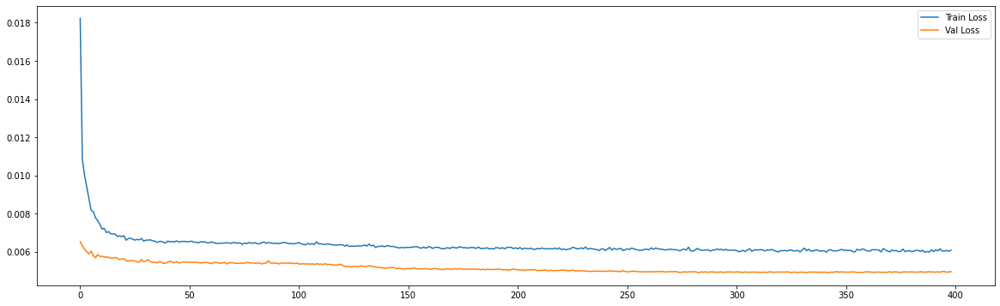

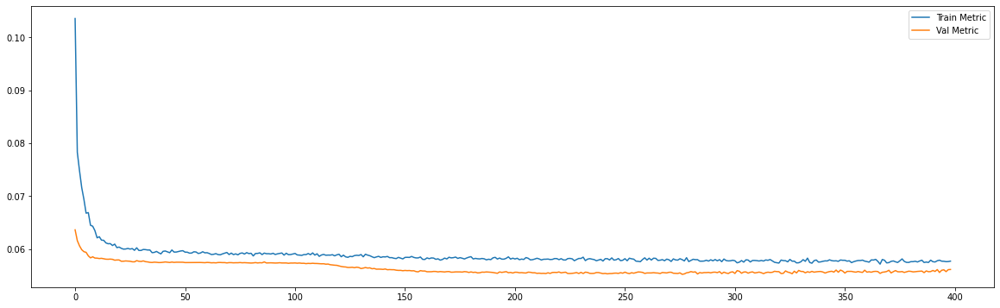

Epoch 00157: early stopping
============================model:9===========================
45/45 [==============================] - 0s 3ms/step - loss: 0.0063 - mae: 0.0571
loss and metric train data [0.006302664987742901, 0.05709829553961754]
9/9 [==============================] - 0s 3ms/step - loss: 0.0054 - mae: 0.0574
loss and metric val data [0.005385011434555054, 0.0573795810341835]
9/9 [==============================] - 0s 3ms/step - loss: 0.0065 - mae: 0.0586
loss and metric test data [0.006484425161033869, 0.0586058534681797]


'neurons': 20, 'dropout': 0.4, 'time_steps': 30, 'batch_size':30, 'hidden_layers':2




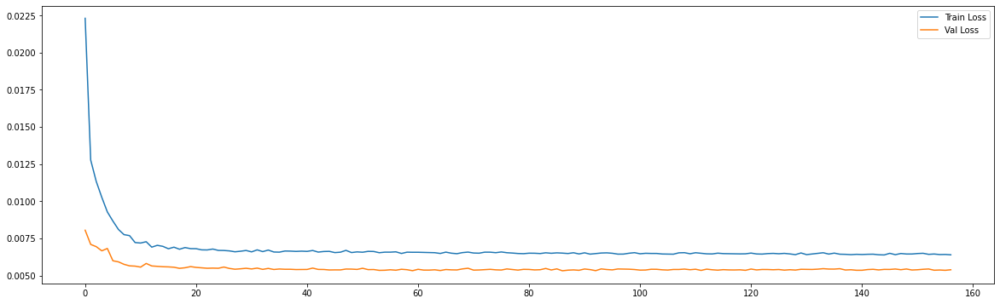

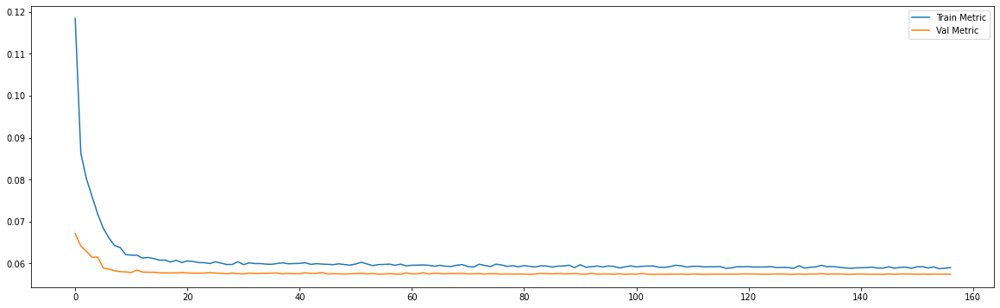

Epoch 00204: early stopping
============================model:10===========================
43/43 [==============================] - 0s 3ms/step - loss: 0.0062 - mae: 0.0578
loss and metric train data [0.006182572804391384, 0.05777817592024803]
8/8 [==============================] - 0s 3ms/step - loss: 0.0051 - mae: 0.0564
loss and metric val data [0.005073400679975748, 0.05635211616754532]
8/8 [==============================] - 0s 2ms/step - loss: 0.0070 - mae: 0.0631
loss and metric test data [0.006993080954998732, 0.06309289485216141]


'neurons': 20, 'dropout': 0.4, 'time_steps': 60, 'batch_size':60, 'learning_rate':0.001, 'hidden_layers':1




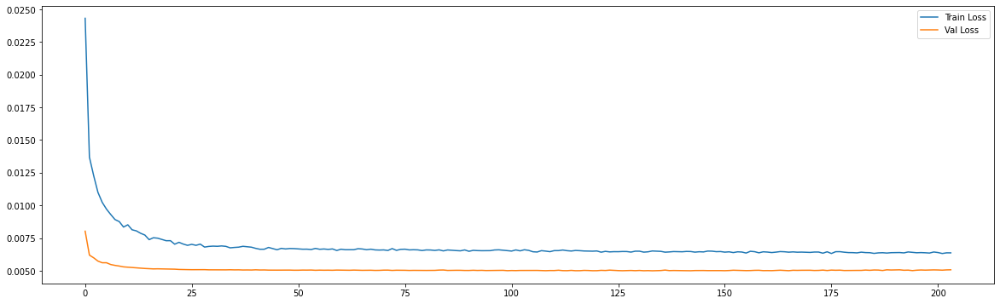

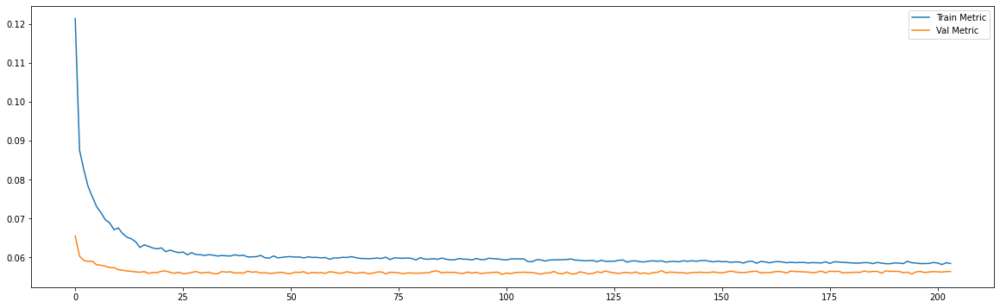

Epoch 00349: early stopping
============================model:11===========================
43/43 [==============================] - 0s 4ms/step - loss: 0.0056 - mae: 0.0556
loss and metric train data [0.005645243916660547, 0.05562465265393257]
8/8 [==============================] - 0s 3ms/step - loss: 0.0049 - mae: 0.0556
loss and metric val data [0.004889122676104307, 0.05557655170559883]
8/8 [==============================] - 0s 3ms/step - loss: 0.0072 - mae: 0.0642
loss and metric test data [0.007222912739962339, 0.06424025446176529]


'neurons': 20, 'dropout': 0.4, 'time_steps': 60, 'batch_size':60, 'hidden_layers':2




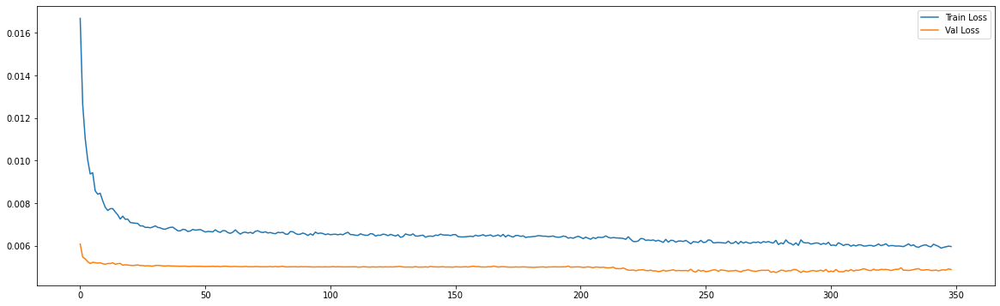

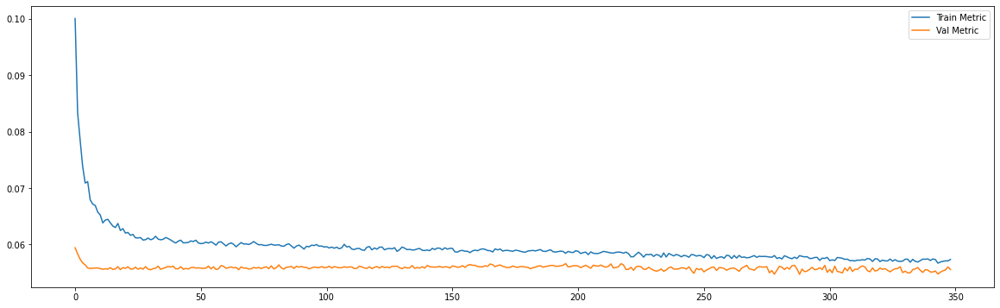

Epoch 00278: early stopping
============================model:12===========================
39/39 [==============================] - 0s 3ms/step - loss: 0.0062 - mae: 0.0573
loss and metric train data [0.006225984543561935, 0.05732866749167442]
7/7 [==============================] - 0s 3ms/step - loss: 0.0049 - mae: 0.0546
loss and metric val data [0.004869504366070032, 0.05461110919713974]
7/7 [==============================] - 0s 3ms/step - loss: 0.0084 - mae: 0.0701
loss and metric test data [0.008426092565059662, 0.07005153596401215]


'neurons': 20, 'dropout': 0.4, 'time_steps': 120, 'batch_size':120, 'learning_rate':0.001, 'hidden_layers':1




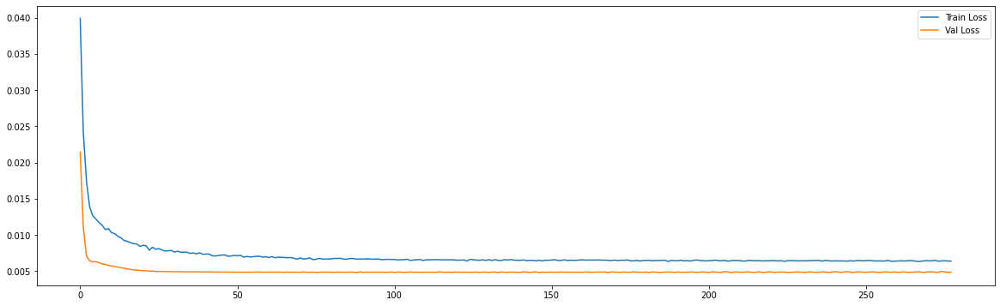

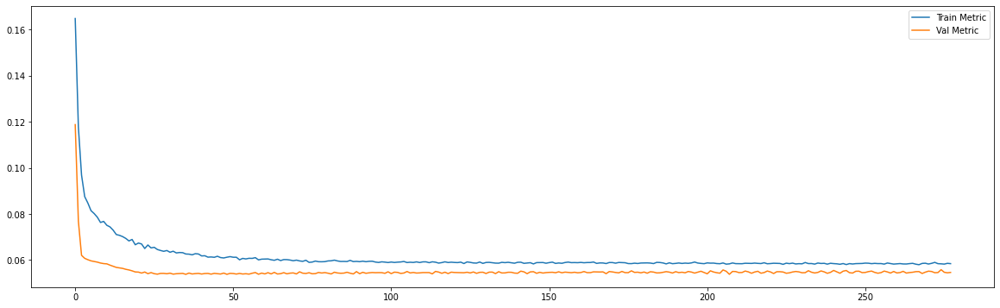

Epoch 00128: early stopping
============================model:13===========================
39/39 [==============================] - 0s 5ms/step - loss: 0.0063 - mae: 0.0572
loss and metric train data [0.006273924373090267, 0.05724979564547539]
7/7 [==============================] - 0s 5ms/step - loss: 0.0048 - mae: 0.0543
loss and metric val data [0.004846156109124422, 0.054282113909721375]
7/7 [==============================] - 0s 5ms/step - loss: 0.0085 - mae: 0.0703
loss and metric test data [0.008503747172653675, 0.07033856213092804]


'neurons': 20, 'dropout': 0.4, 'time_steps': 120, 'batch_size':120, 'hidden_layers':2




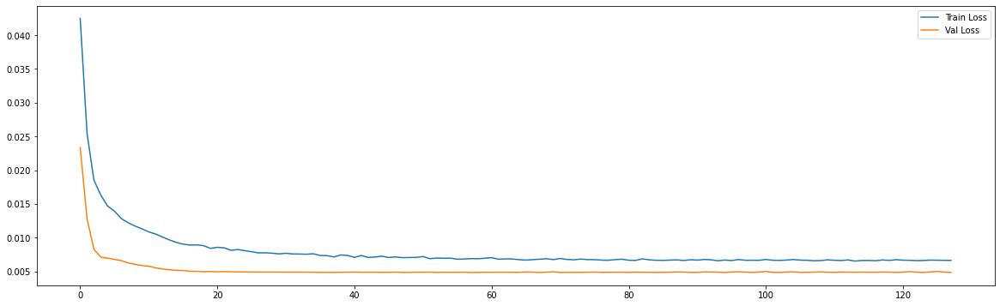

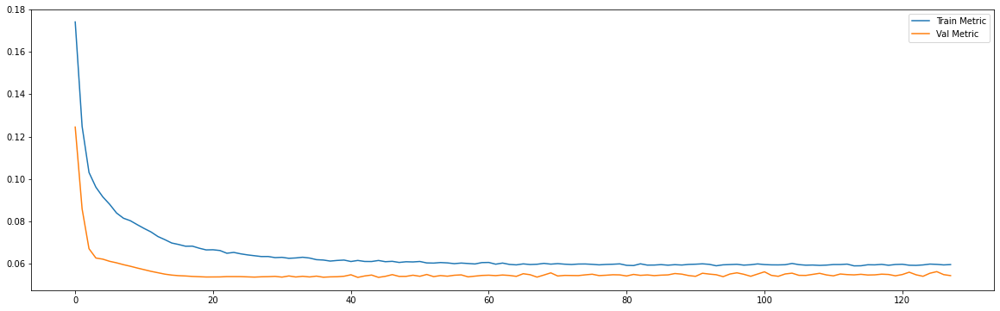

Epoch 00317: early stopping
============================model:14===========================
32/32 [==============================] - 0s 5ms/step - loss: 0.0072 - mae: 0.0624
loss and metric train data [0.007225045934319496, 0.0624375194311142]
3/3 [==============================] - 0s 4ms/step - loss: 0.0070 - mae: 0.0670
loss and metric val data [0.007005702704191208, 0.06697185337543488]
3/3 [==============================] - 0s 4ms/step - loss: 0.0148 - mae: 0.0951
loss and metric test data [0.014801626093685627, 0.09511766582727432]


'neurons': 20, 'dropout': 0.4, 'time_steps': 240, 'batch_size':240, 'learning_rate':0.001, 'hidden_layers':1




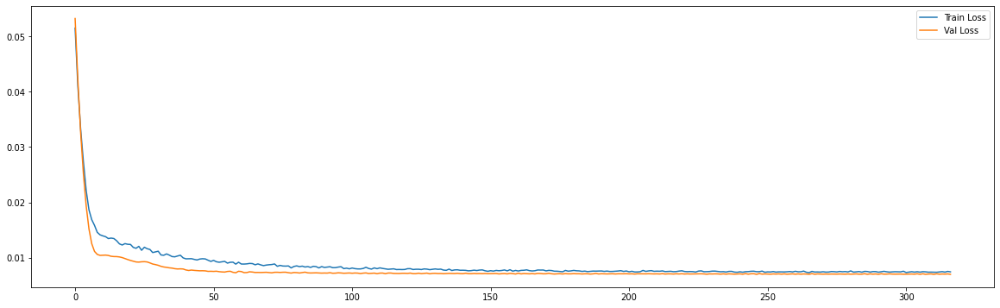

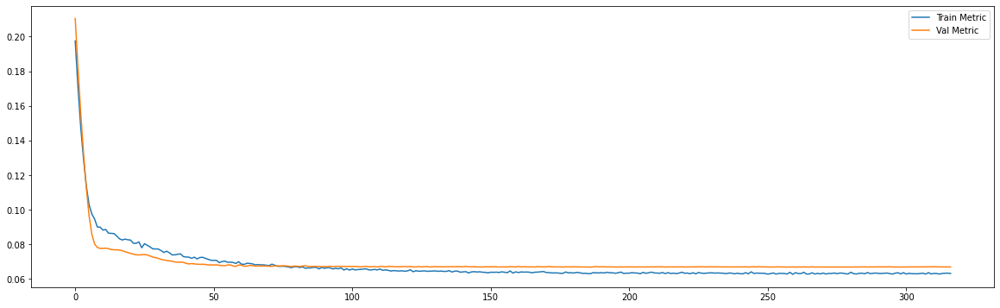

Epoch 00241: early stopping
============================model:15===========================
32/32 [==============================] - 0s 8ms/step - loss: 0.0072 - mae: 0.0621
loss and metric train data [0.007245228160172701, 0.06211202219128609]
3/3 [==============================] - 0s 6ms/step - loss: 0.0071 - mae: 0.0673
loss and metric val data [0.007088560611009598, 0.06728251278400421]
3/3 [==============================] - 0s 6ms/step - loss: 0.0149 - mae: 0.0959
loss and metric test data [0.014948503114283085, 0.09594712406396866]


'neurons': 20, 'dropout': 0.4, 'time_steps': 240, 'batch_size':240, 'hidden_layers':2




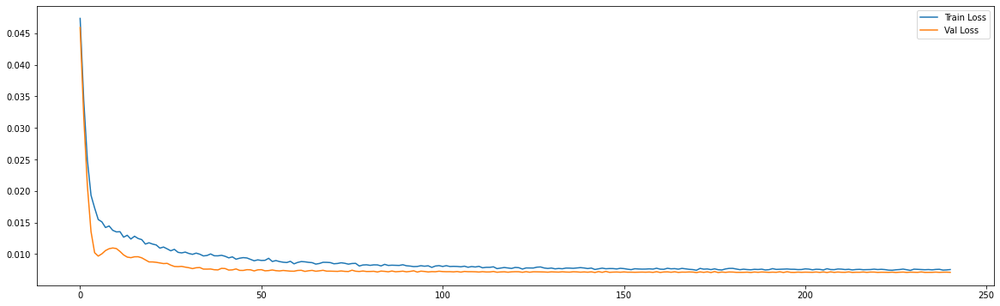

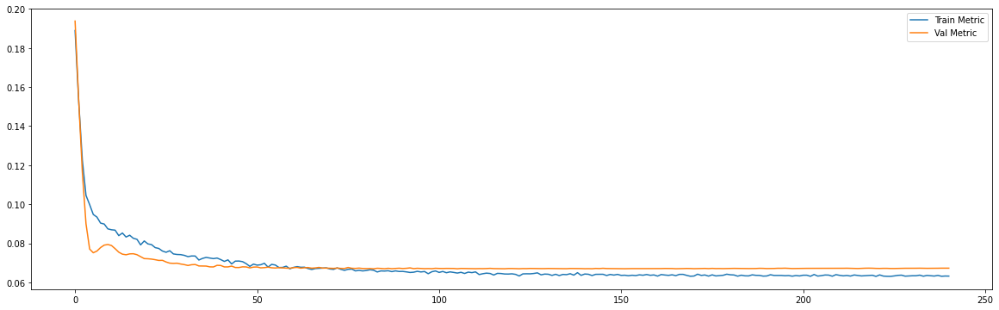

Epoch 00301: early stopping
============================model:16===========================
45/45 [==============================] - 0s 2ms/step - loss: 0.0057 - mae: 0.0557
loss and metric train data [0.005713159218430519, 0.055706340819597244]
9/9 [==============================] - 0s 2ms/step - loss: 0.0049 - mae: 0.0553
loss and metric val data [0.004938199650496244, 0.05530953407287598]
9/9 [==============================] - 0s 2ms/step - loss: 0.0060 - mae: 0.0572
loss and metric test data [0.006007374729961157, 0.057220760732889175]


'neurons': 25, 'dropout': 0.2, 'time_steps': 30, 'batch_size':30, 'learning_rate':0.001, 'hidden_layers':1




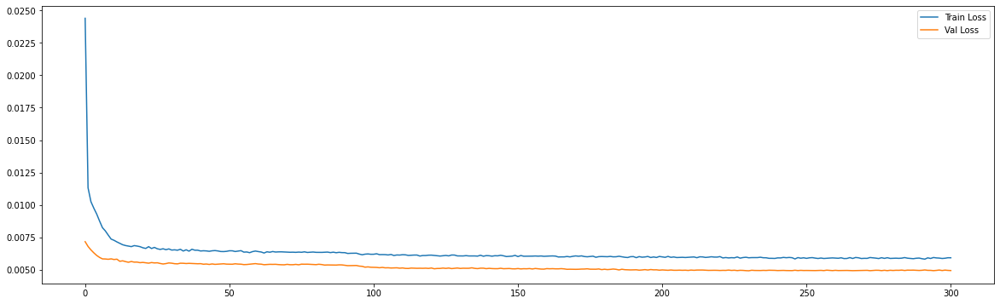

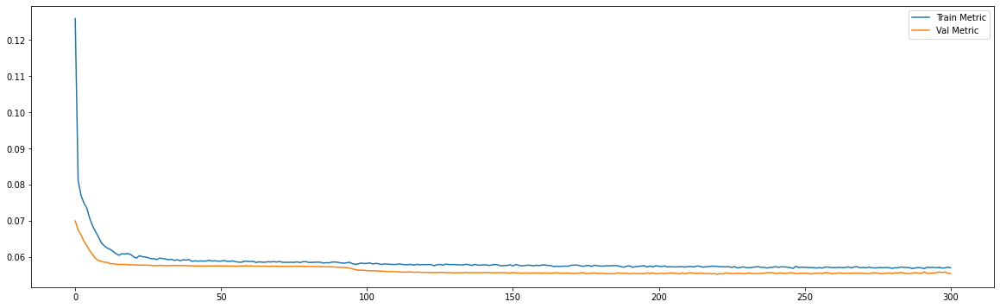

Epoch 00264: early stopping
============================model:17===========================
45/45 [==============================] - 0s 3ms/step - loss: 0.0056 - mae: 0.0554
loss and metric train data [0.005553440190851688, 0.05535385385155678]
9/9 [==============================] - 0s 3ms/step - loss: 0.0050 - mae: 0.0555
loss and metric val data [0.005045891273766756, 0.05550852790474892]
9/9 [==============================] - 0s 3ms/step - loss: 0.0064 - mae: 0.0569
loss and metric test data [0.006389949936419725, 0.05685372278094292]


'neurons': 25, 'dropout': 0.2, 'time_steps': 30, 'batch_size':30, 'hidden_layers':2




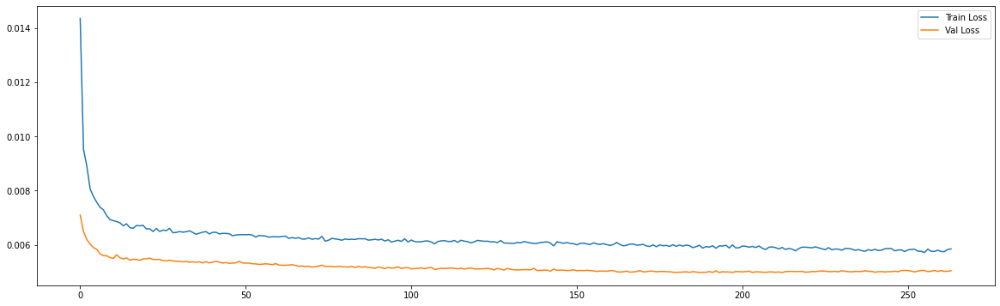

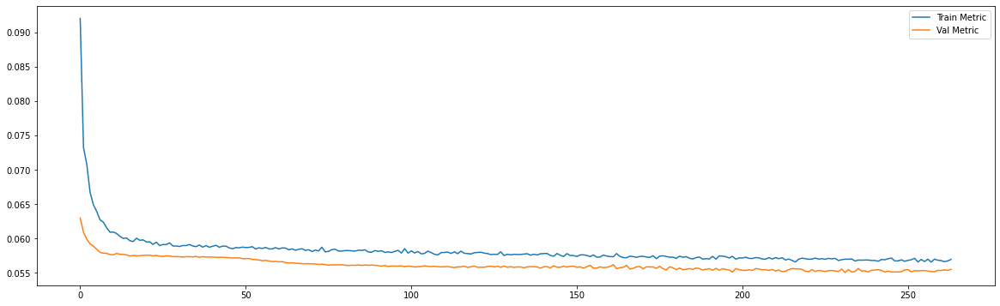

Epoch 00305: early stopping
============================model:18===========================
43/43 [==============================] - 0s 3ms/step - loss: 0.0057 - mae: 0.0555
loss and metric train data [0.005676721688359976, 0.055541157722473145]
8/8 [==============================] - 0s 3ms/step - loss: 0.0049 - mae: 0.0547
loss and metric val data [0.004857396706938744, 0.054688096046447754]
8/8 [==============================] - 0s 2ms/step - loss: 0.0069 - mae: 0.0627
loss and metric test data [0.006935873534530401, 0.06266849488019943]


'neurons': 25, 'dropout': 0.2, 'time_steps': 60, 'batch_size':60, 'learning_rate':0.001, 'hidden_layers':1




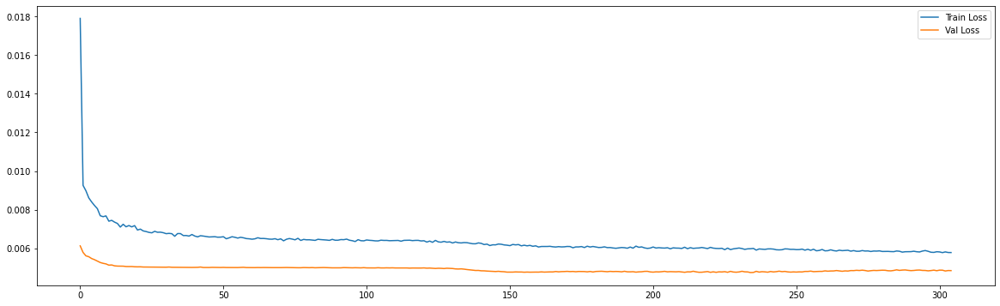

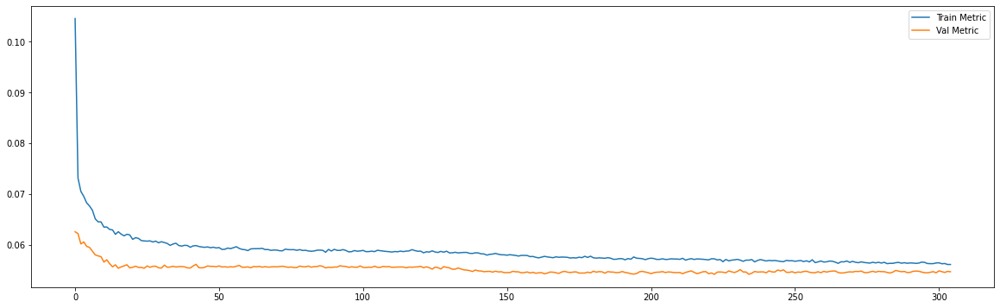

Epoch 00303: early stopping
============================model:19===========================
43/43 [==============================] - 0s 4ms/step - loss: 0.0056 - mae: 0.0558
loss and metric train data [0.00558113120496273, 0.055797357112169266]
8/8 [==============================] - 0s 3ms/step - loss: 0.0049 - mae: 0.0547
loss and metric val data [0.004875821992754936, 0.05469078943133354]
8/8 [==============================] - 0s 3ms/step - loss: 0.0080 - mae: 0.0632
loss and metric test data [0.007986540906131268, 0.06316696852445602]


'neurons': 25, 'dropout': 0.2, 'time_steps': 60, 'batch_size':60, 'hidden_layers':2




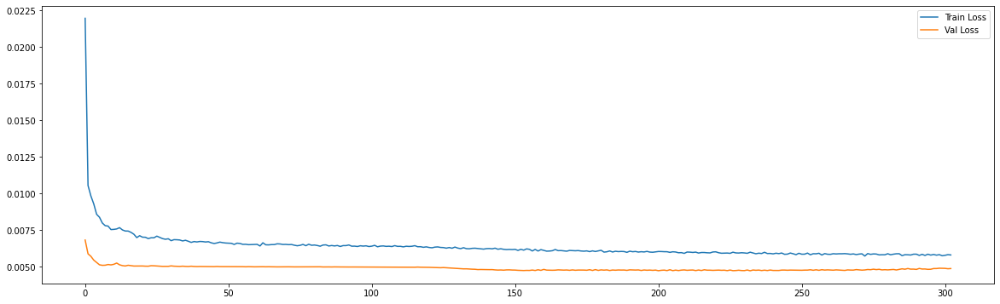

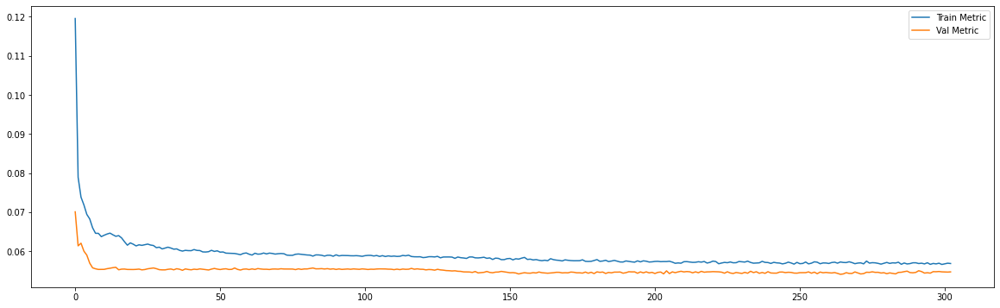

Epoch 00334: early stopping
============================model:20===========================
39/39 [==============================] - 0s 3ms/step - loss: 0.0058 - mae: 0.0560
loss and metric train data [0.005849240813404322, 0.05600116029381752]
7/7 [==============================] - 0s 3ms/step - loss: 0.0046 - mae: 0.0528
loss and metric val data [0.004636380355805159, 0.0528063140809536]
7/7 [==============================] - 0s 3ms/step - loss: 0.0082 - mae: 0.0684
loss and metric test data [0.008157462812960148, 0.068441241979599]


'neurons': 25, 'dropout': 0.2, 'time_steps': 120, 'batch_size':120, 'learning_rate':0.001, 'hidden_layers':1




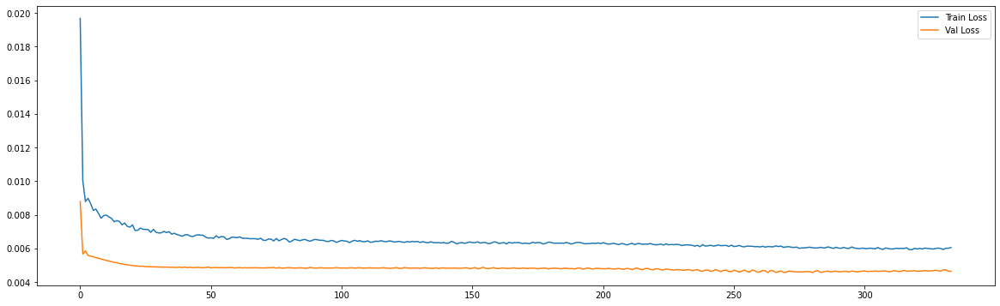

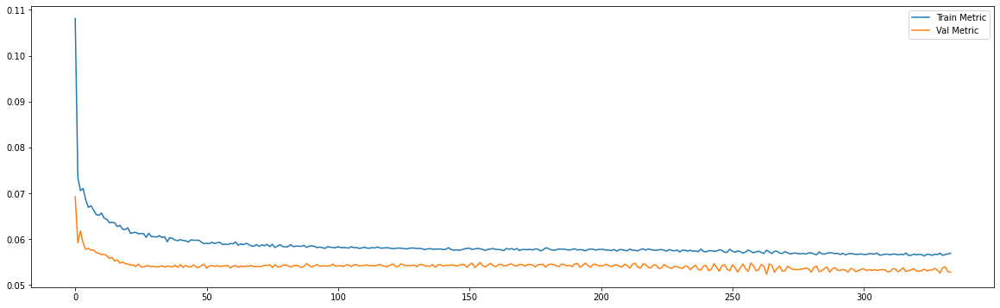

Epoch 00171: early stopping
============================model:21===========================
39/39 [==============================] - 0s 5ms/step - loss: 0.0062 - mae: 0.0577
loss and metric train data [0.006243163254112005, 0.05771689489483833]
7/7 [==============================] - 0s 4ms/step - loss: 0.0049 - mae: 0.0547
loss and metric val data [0.004880144260823727, 0.054729726165533066]
7/7 [==============================] - 0s 5ms/step - loss: 0.0084 - mae: 0.0706
loss and metric test data [0.008430900983512402, 0.07058452069759369]


'neurons': 25, 'dropout': 0.2, 'time_steps': 120, 'batch_size':120, 'hidden_layers':2




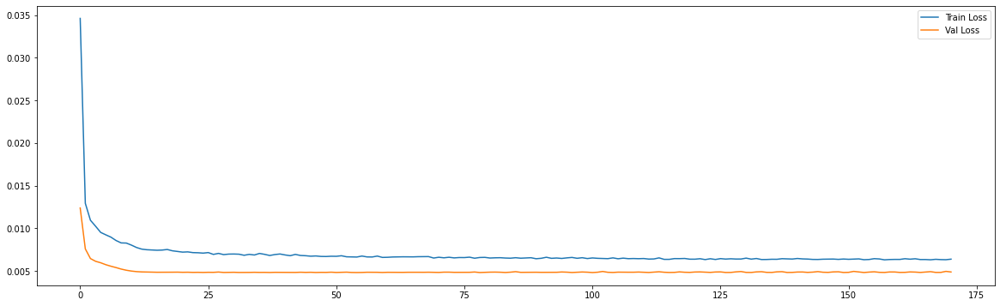

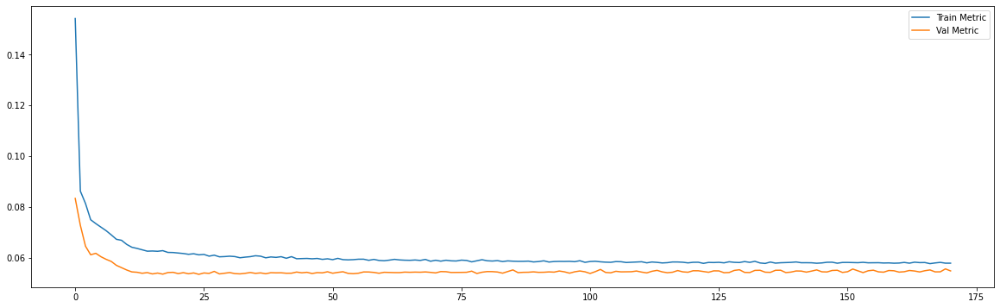

Epoch 00387: early stopping
============================model:22===========================
32/32 [==============================] - 0s 5ms/step - loss: 0.0071 - mae: 0.0620
loss and metric train data [0.00714123947545886, 0.06200296804308891]
3/3 [==============================] - 0s 4ms/step - loss: 0.0070 - mae: 0.0662
loss and metric val data [0.007027904503047466, 0.06618117541074753]
3/3 [==============================] - 0s 4ms/step - loss: 0.0146 - mae: 0.0950
loss and metric test data [0.014581575058400631, 0.09500224143266678]


'neurons': 25, 'dropout': 0.2, 'time_steps': 240, 'batch_size':240, 'learning_rate':0.001, 'hidden_layers':1




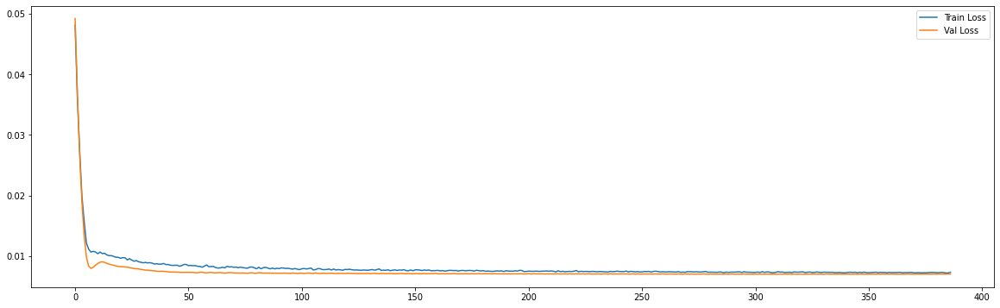

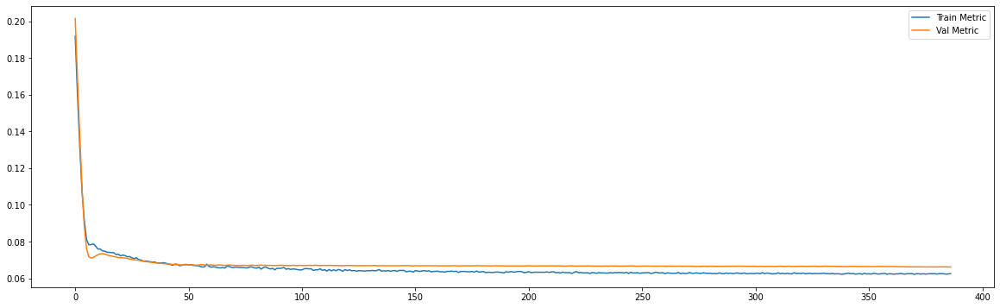

Epoch 00216: early stopping
============================model:23===========================
32/32 [==============================] - 0s 8ms/step - loss: 0.0072 - mae: 0.0620
loss and metric train data [0.007247279863804579, 0.061969708651304245]
3/3 [==============================] - 0s 6ms/step - loss: 0.0071 - mae: 0.0671
loss and metric val data [0.007104606367647648, 0.06705474108457565]
3/3 [==============================] - 0s 6ms/step - loss: 0.0150 - mae: 0.0961
loss and metric test data [0.014957672916352749, 0.09611129760742188]


'neurons': 25, 'dropout': 0.2, 'time_steps': 240, 'batch_size':240, 'hidden_layers':2




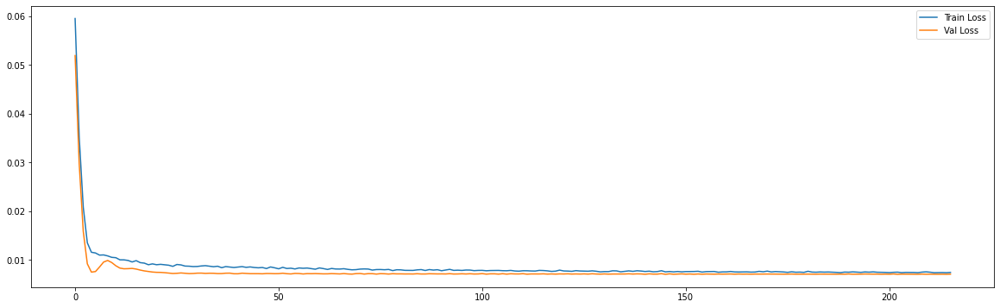

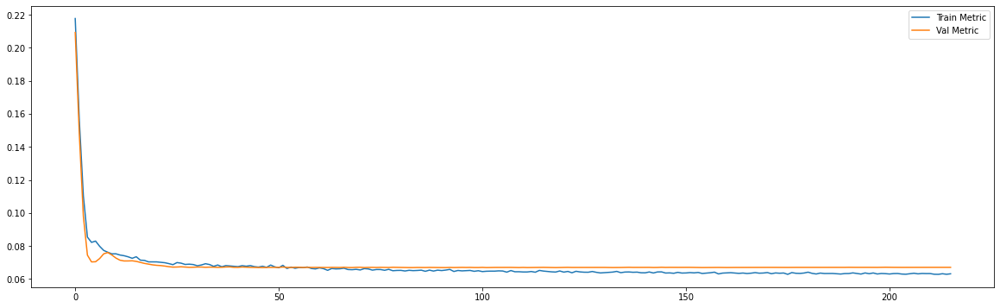

Epoch 00400: early stopping
============================model:24===========================
45/45 [==============================] - 0s 2ms/step - loss: 0.0057 - mae: 0.0558
loss and metric train data [0.005740767810493708, 0.05575957149267197]
9/9 [==============================] - 0s 2ms/step - loss: 0.0049 - mae: 0.0553
loss and metric val data [0.004936546087265015, 0.05534231662750244]
9/9 [==============================] - 0s 3ms/step - loss: 0.0059 - mae: 0.0568
loss and metric test data [0.00588682247325778, 0.056806065142154694]


'neurons': 25, 'dropout': 0.4, 'time_steps': 30, 'batch_size':30, 'learning_rate':0.001, 'hidden_layers':1




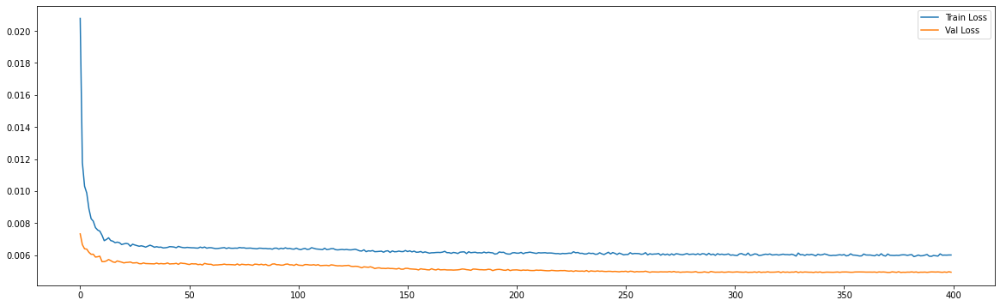

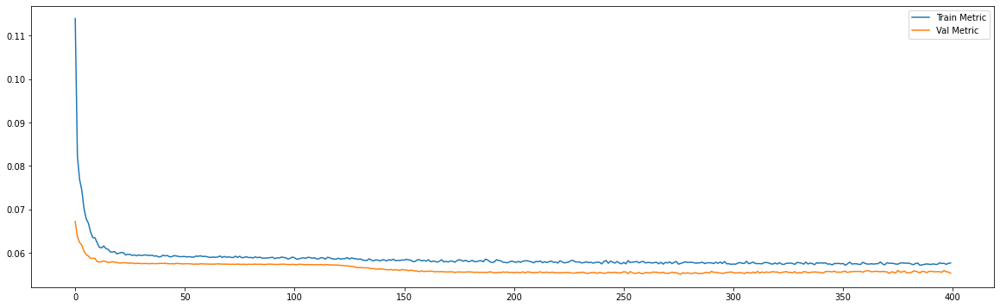

Epoch 00271: early stopping
============================model:25===========================
45/45 [==============================] - 0s 3ms/step - loss: 0.0057 - mae: 0.0557
loss and metric train data [0.005708177108317614, 0.05565563589334488]
9/9 [==============================] - 0s 3ms/step - loss: 0.0050 - mae: 0.0554
loss and metric val data [0.005029474850744009, 0.055406901985406876]
9/9 [==============================] - 0s 4ms/step - loss: 0.0062 - mae: 0.0569
loss and metric test data [0.006242448929697275, 0.056876663118600845]


'neurons': 25, 'dropout': 0.4, 'time_steps': 30, 'batch_size':30, 'hidden_layers':2




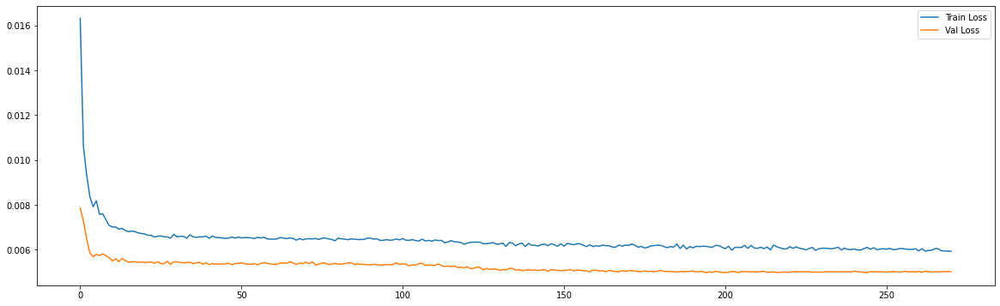

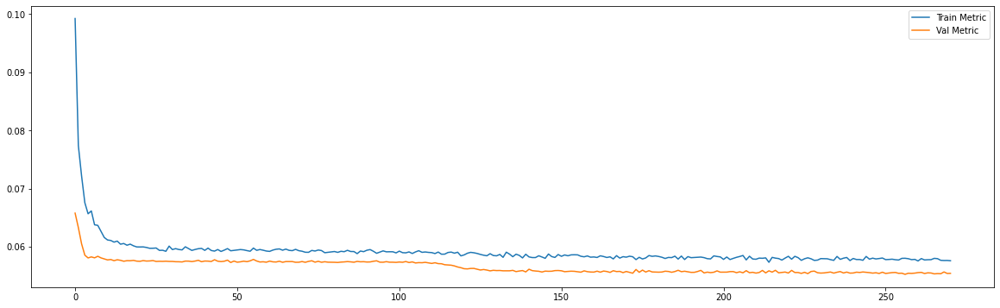

Epoch 00291: early stopping
============================model:26===========================
43/43 [==============================] - 0s 3ms/step - loss: 0.0058 - mae: 0.0558
loss and metric train data [0.005764383357018232, 0.05582679435610771]
8/8 [==============================] - 0s 2ms/step - loss: 0.0049 - mae: 0.0550
loss and metric val data [0.004925266839563847, 0.05498512089252472]
8/8 [==============================] - 0s 2ms/step - loss: 0.0070 - mae: 0.0626
loss and metric test data [0.006995095871388912, 0.06261807680130005]


'neurons': 25, 'dropout': 0.4, 'time_steps': 60, 'batch_size':60, 'learning_rate':0.001, 'hidden_layers':1




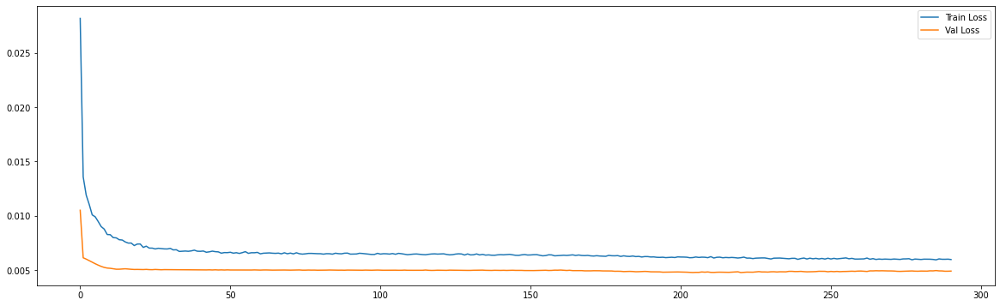

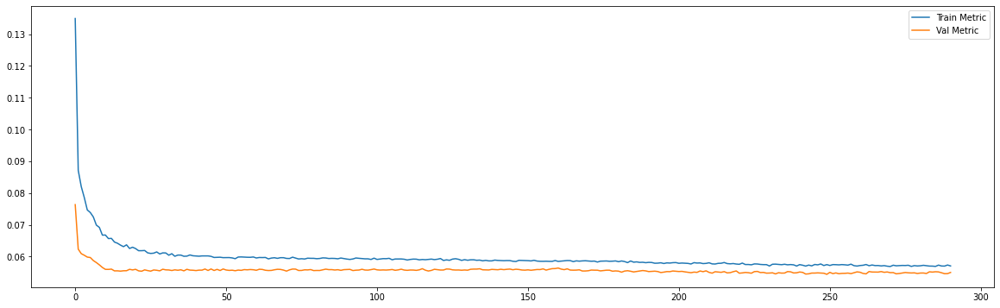

Epoch 00299: early stopping
============================model:27===========================
43/43 [==============================] - 0s 4ms/step - loss: 0.0057 - mae: 0.0553
loss and metric train data [0.005652585998177528, 0.05526701360940933]
8/8 [==============================] - 0s 3ms/step - loss: 0.0048 - mae: 0.0544
loss and metric val data [0.004800374154001474, 0.05442674458026886]
8/8 [==============================] - 0s 3ms/step - loss: 0.0071 - mae: 0.0633
loss and metric test data [0.00711915735155344, 0.06328801810741425]


'neurons': 25, 'dropout': 0.4, 'time_steps': 60, 'batch_size':60, 'hidden_layers':2




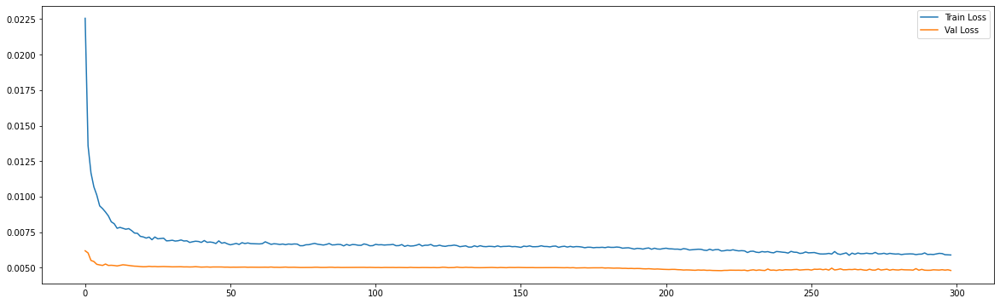

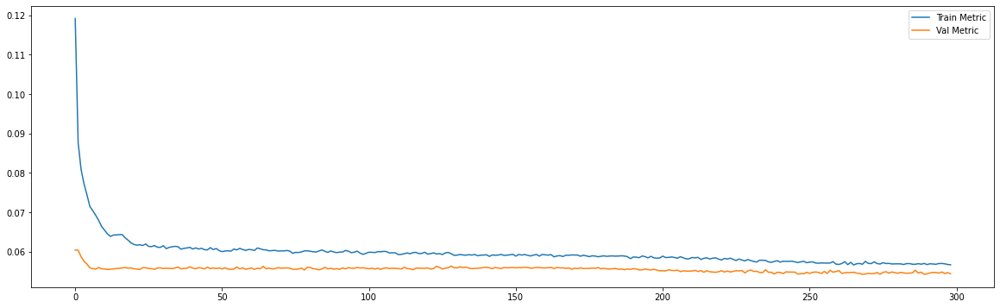

Epoch 00158: early stopping
============================model:28===========================
39/39 [==============================] - 0s 3ms/step - loss: 0.0063 - mae: 0.0579
loss and metric train data [0.006257960572838783, 0.057928137481212616]
7/7 [==============================] - 0s 3ms/step - loss: 0.0049 - mae: 0.0553
loss and metric val data [0.004903055261820555, 0.055300161242485046]
7/7 [==============================] - 0s 3ms/step - loss: 0.0085 - mae: 0.0704
loss and metric test data [0.00845158752053976, 0.07037421315908432]


'neurons': 25, 'dropout': 0.4, 'time_steps': 120, 'batch_size':120, 'learning_rate':0.001, 'hidden_layers':1




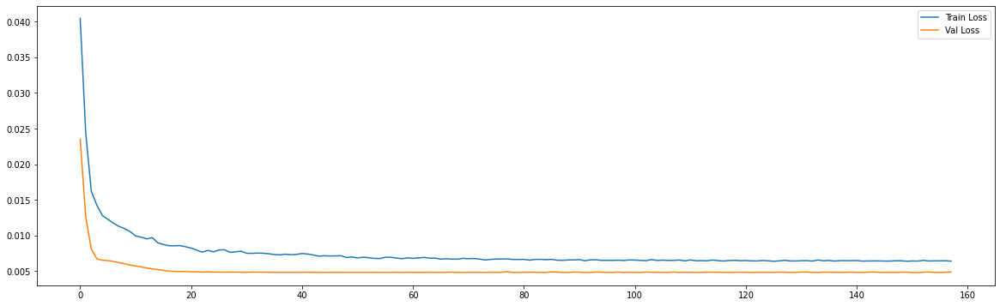

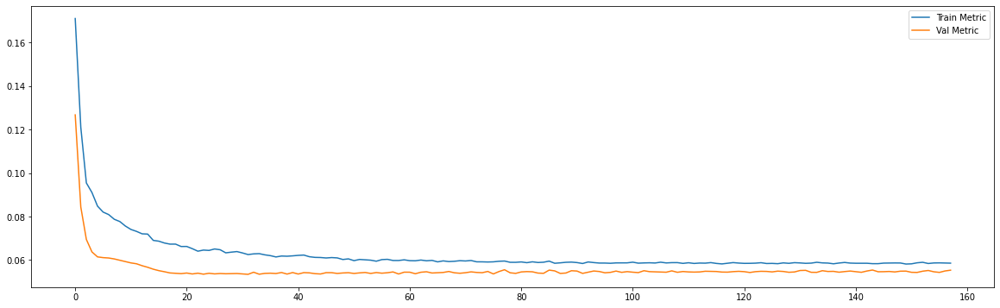

Epoch 00134: early stopping
============================model:29===========================
39/39 [==============================] - 0s 5ms/step - loss: 0.0063 - mae: 0.0580
loss and metric train data [0.006271832622587681, 0.057979051023721695]
7/7 [==============================] - 0s 4ms/step - loss: 0.0049 - mae: 0.0552
loss and metric val data [0.004910015035420656, 0.05515158548951149]
7/7 [==============================] - 0s 5ms/step - loss: 0.0085 - mae: 0.0707
loss and metric test data [0.008484771475195885, 0.07069045305252075]


'neurons': 25, 'dropout': 0.4, 'time_steps': 120, 'batch_size':120, 'hidden_layers':2




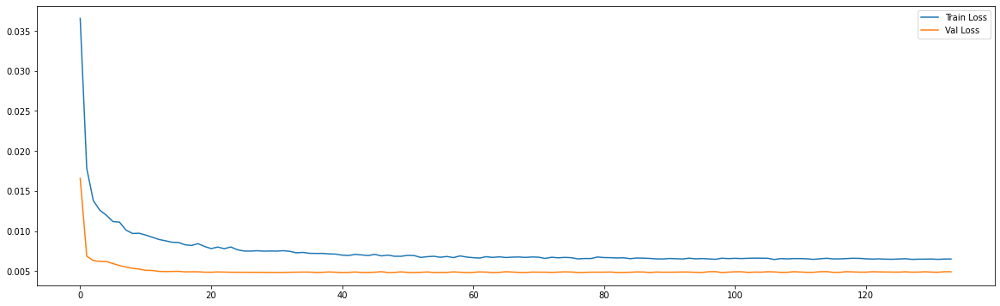

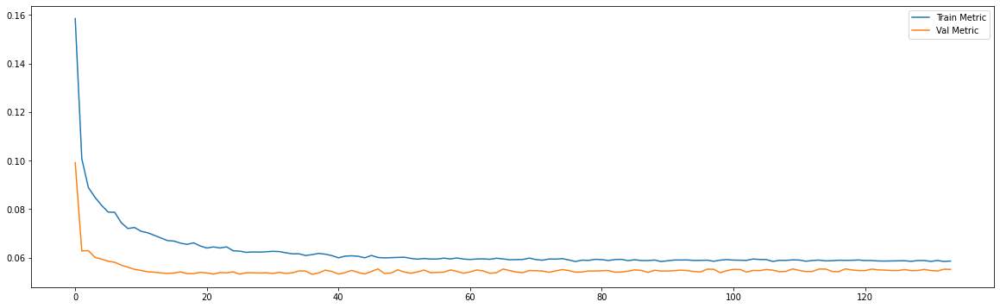

Epoch 00423: early stopping
============================model:30===========================
32/32 [==============================] - 0s 5ms/step - loss: 0.0071 - mae: 0.0622
loss and metric train data [0.007145998068153858, 0.06218961626291275]
3/3 [==============================] - 0s 4ms/step - loss: 0.0070 - mae: 0.0661
loss and metric val data [0.007028684951364994, 0.06614363193511963]
3/3 [==============================] - 0s 4ms/step - loss: 0.0146 - mae: 0.0945
loss and metric test data [0.01455799862742424, 0.09451040625572205]


'neurons': 25, 'dropout': 0.4, 'time_steps': 240, 'batch_size':240, 'learning_rate':0.001, 'hidden_layers':1




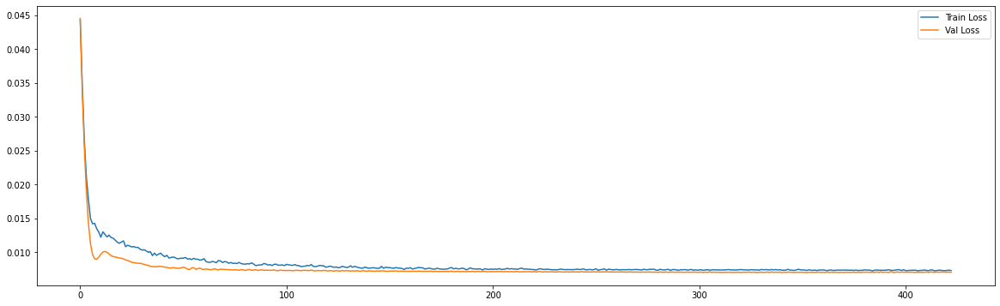

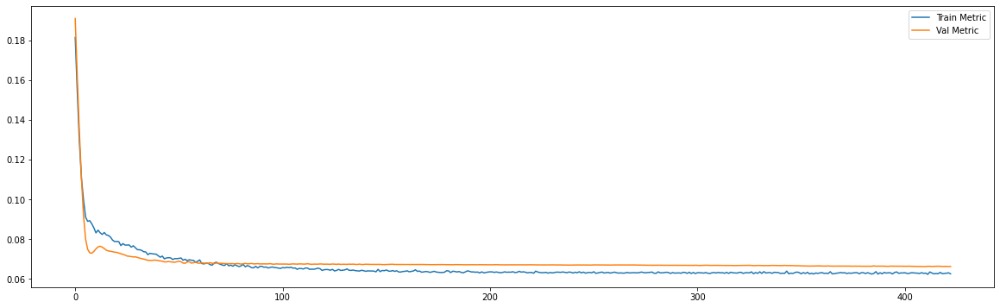

Epoch 00122: early stopping
============================model:31===========================
32/32 [==============================] - 0s 8ms/step - loss: 0.0073 - mae: 0.0619
loss and metric train data [0.007284610066562891, 0.06194480508565903]
3/3 [==============================] - 0s 6ms/step - loss: 0.0072 - mae: 0.0671
loss and metric val data [0.007162945810705423, 0.06705013662576675]
3/3 [==============================] - 0s 8ms/step - loss: 0.0151 - mae: 0.0967
loss and metric test data [0.015114919282495975, 0.09665282070636749]


'neurons': 25, 'dropout': 0.4, 'time_steps': 240, 'batch_size':240, 'hidden_layers':2




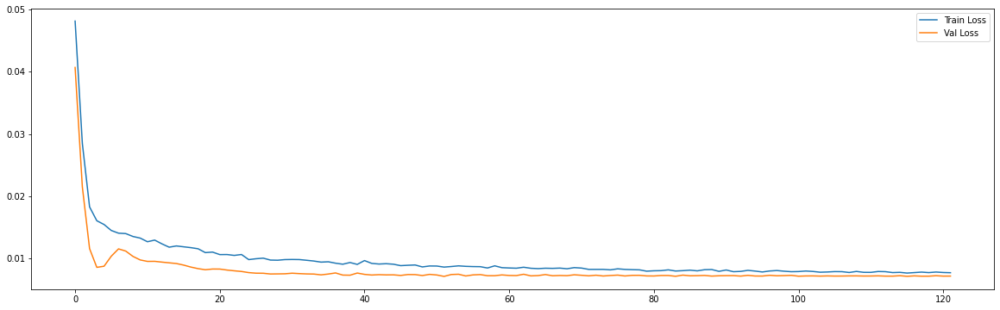

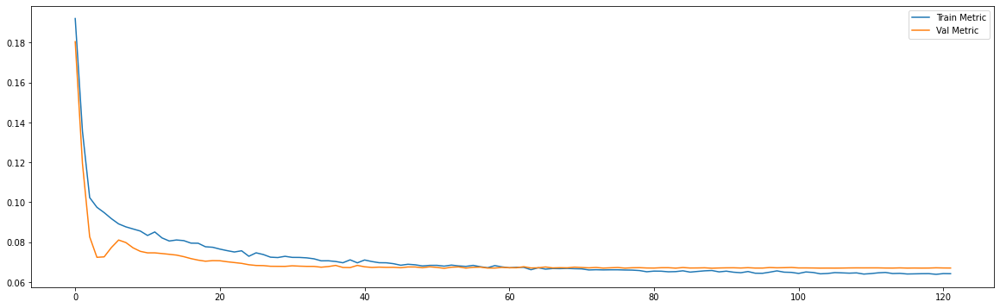

Epoch 00325: early stopping
============================model:32===========================
45/45 [==============================] - 0s 2ms/step - loss: 0.0057 - mae: 0.0557
loss and metric train data [0.005689416546374559, 0.055687591433525085]
9/9 [==============================] - 0s 2ms/step - loss: 0.0049 - mae: 0.0553
loss and metric val data [0.004936143755912781, 0.05531619116663933]
9/9 [==============================] - 0s 2ms/step - loss: 0.0059 - mae: 0.0565
loss and metric test data [0.0058643389493227005, 0.05650879070162773]


'neurons': 30, 'dropout': 0.2, 'time_steps': 30, 'batch_size':30, 'learning_rate':0.001, 'hidden_layers':1




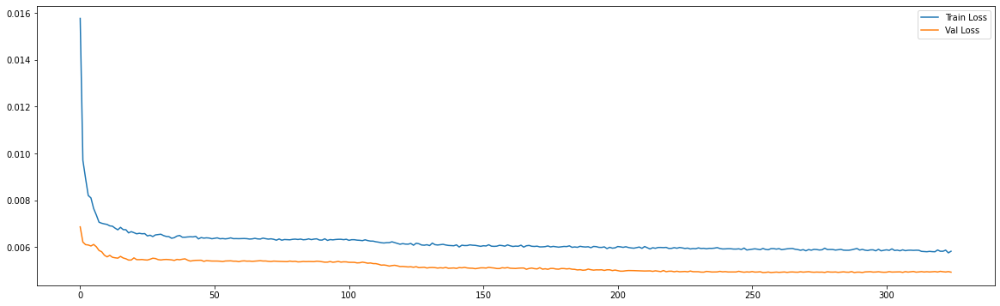

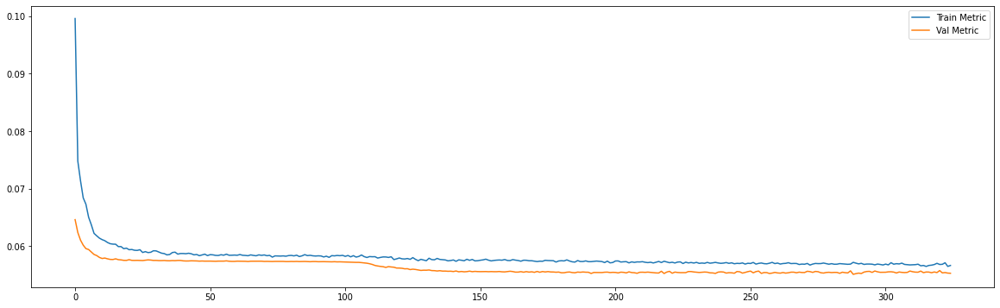

Epoch 00251: early stopping
============================model:33===========================
45/45 [==============================] - 0s 3ms/step - loss: 0.0056 - mae: 0.0553
loss and metric train data [0.005582778248935938, 0.0552726648747921]
9/9 [==============================] - 0s 3ms/step - loss: 0.0050 - mae: 0.0551
loss and metric val data [0.005046789068728685, 0.05514706298708916]
9/9 [==============================] - 0s 3ms/step - loss: 0.0060 - mae: 0.0567
loss and metric test data [0.006026224698871374, 0.05666276067495346]


'neurons': 30, 'dropout': 0.2, 'time_steps': 30, 'batch_size':30, 'hidden_layers':2




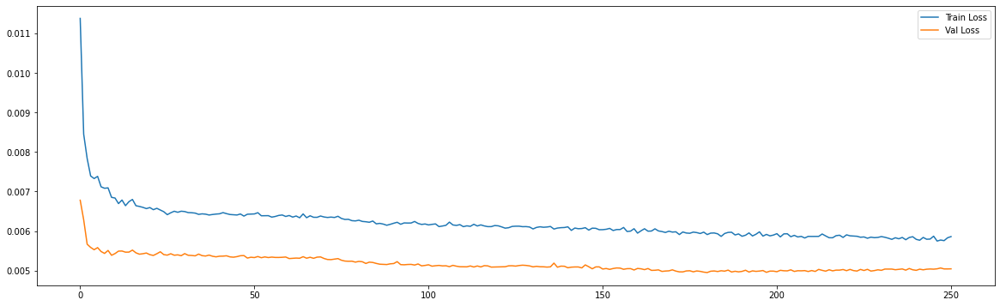

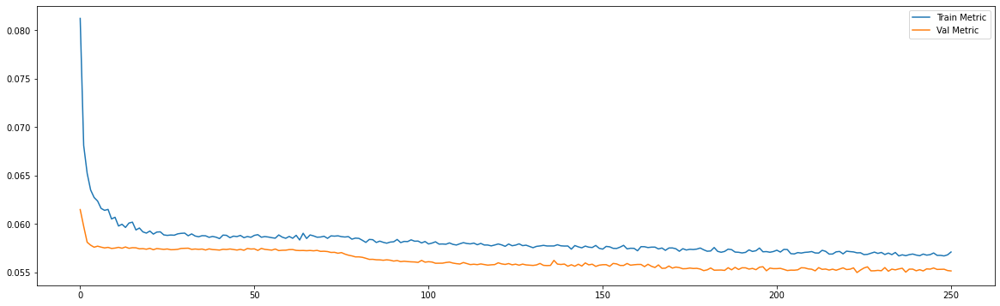

Epoch 00236: early stopping
============================model:34===========================
43/43 [==============================] - 0s 3ms/step - loss: 0.0059 - mae: 0.0563
loss and metric train data [0.005863914731889963, 0.056325364857912064]
8/8 [==============================] - 0s 3ms/step - loss: 0.0051 - mae: 0.0556
loss and metric val data [0.005051538348197937, 0.055566783994436264]
8/8 [==============================] - 0s 3ms/step - loss: 0.0071 - mae: 0.0637
loss and metric test data [0.0071044787764549255, 0.06372521817684174]


'neurons': 30, 'dropout': 0.2, 'time_steps': 60, 'batch_size':60, 'learning_rate':0.001, 'hidden_layers':1




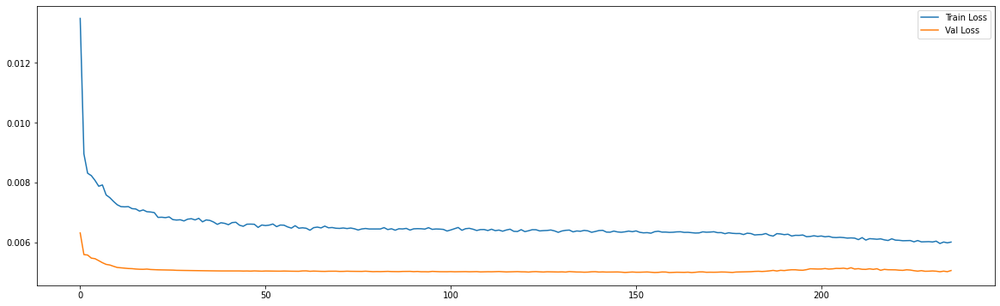

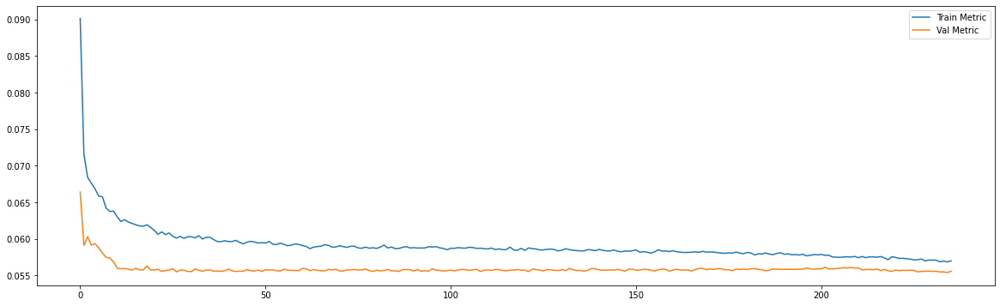

Epoch 00337: early stopping
============================model:35===========================
43/43 [==============================] - 0s 4ms/step - loss: 0.0056 - mae: 0.0555
loss and metric train data [0.005550400819629431, 0.05550995469093323]
8/8 [==============================] - 0s 3ms/step - loss: 0.0048 - mae: 0.0547
loss and metric val data [0.004849796649068594, 0.05471194535493851]
8/8 [==============================] - 0s 3ms/step - loss: 0.0071 - mae: 0.0633
loss and metric test data [0.007075724191963673, 0.06326693296432495]


'neurons': 30, 'dropout': 0.2, 'time_steps': 60, 'batch_size':60, 'hidden_layers':2




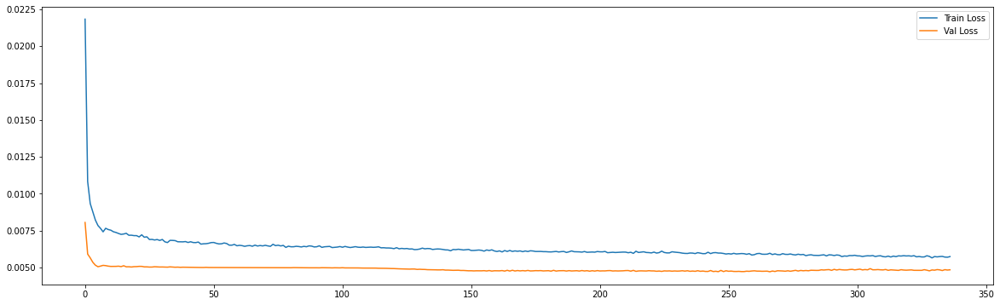

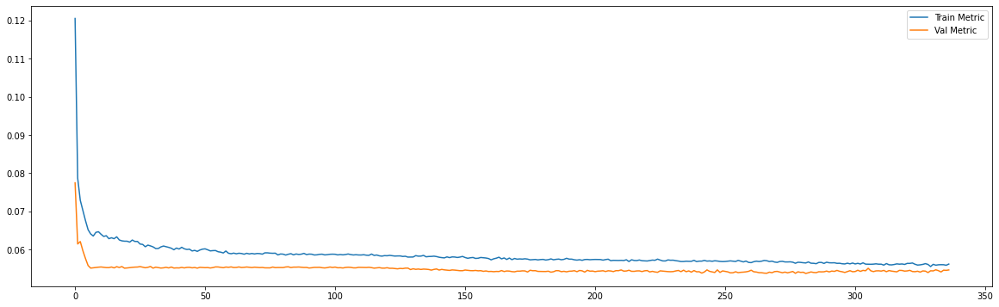

Epoch 00360: early stopping
============================model:36===========================
39/39 [==============================] - 0s 3ms/step - loss: 0.0058 - mae: 0.0560
loss and metric train data [0.005816586781293154, 0.056024253368377686]
7/7 [==============================] - 0s 3ms/step - loss: 0.0047 - mae: 0.0531
loss and metric val data [0.0047249882481992245, 0.05311534181237221]
7/7 [==============================] - 0s 3ms/step - loss: 0.0081 - mae: 0.0685
loss and metric test data [0.008108519949018955, 0.06854326277971268]


'neurons': 30, 'dropout': 0.2, 'time_steps': 120, 'batch_size':120, 'learning_rate':0.001, 'hidden_layers':1




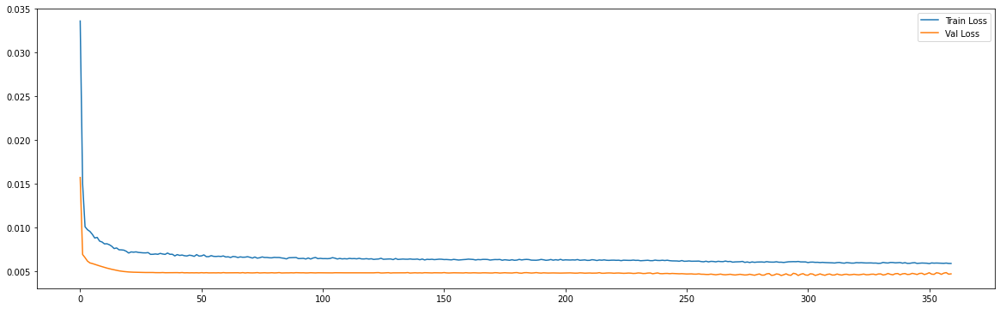

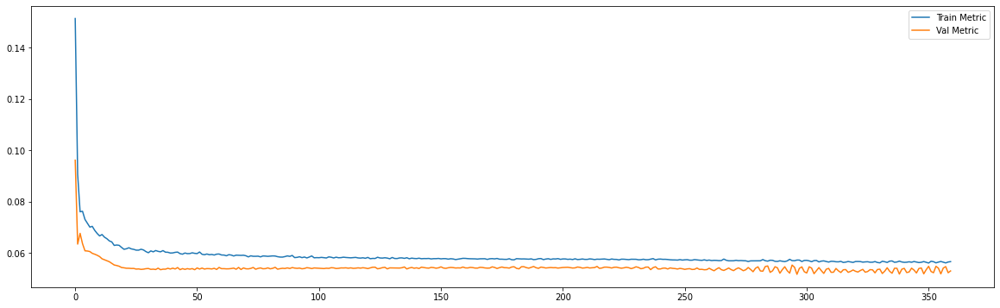

Epoch 00122: early stopping
============================model:37===========================
39/39 [==============================] - 0s 5ms/step - loss: 0.0062 - mae: 0.0571
loss and metric train data [0.006243633106350899, 0.05709344893693924]
7/7 [==============================] - 0s 5ms/step - loss: 0.0048 - mae: 0.0543
loss and metric val data [0.004838614724576473, 0.05425438657402992]
7/7 [==============================] - 0s 5ms/step - loss: 0.0085 - mae: 0.0703
loss and metric test data [0.00847229640930891, 0.07027769833803177]


'neurons': 30, 'dropout': 0.2, 'time_steps': 120, 'batch_size':120, 'hidden_layers':2




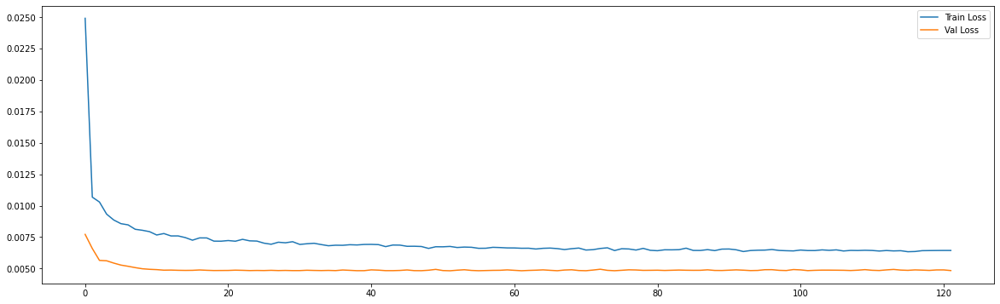

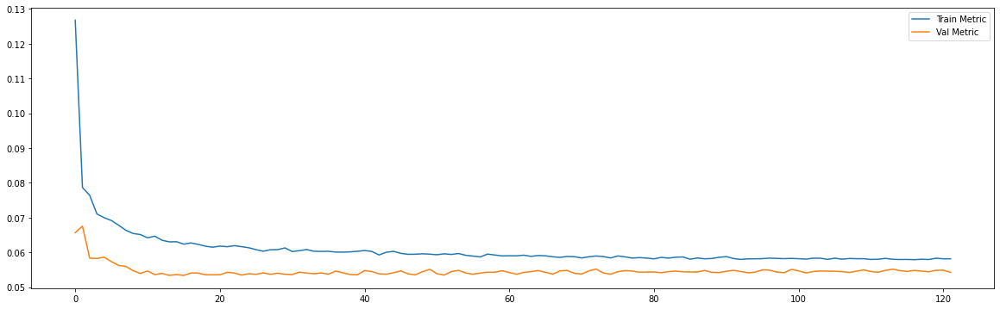

============================model:38===========================
32/32 [==============================] - 0s 5ms/step - loss: 0.0067 - mae: 0.0603
loss and metric train data [0.0066889552399516106, 0.060307569801807404]
3/3 [==============================] - 0s 4ms/step - loss: 0.0066 - mae: 0.0635
loss and metric val data [0.006632029078900814, 0.06347410380840302]
3/3 [==============================] - 0s 4ms/step - loss: 0.0139 - mae: 0.0913
loss and metric test data [0.01386228483170271, 0.09127357602119446]


'neurons': 30, 'dropout': 0.2, 'time_steps': 240, 'batch_size':240, 'learning_rate':0.001, 'hidden_layers':1




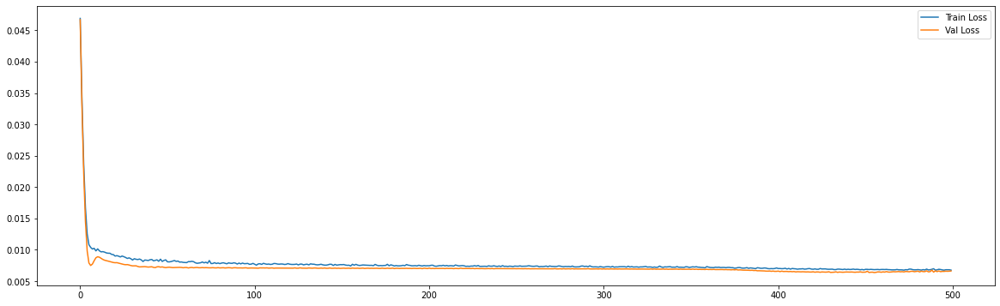

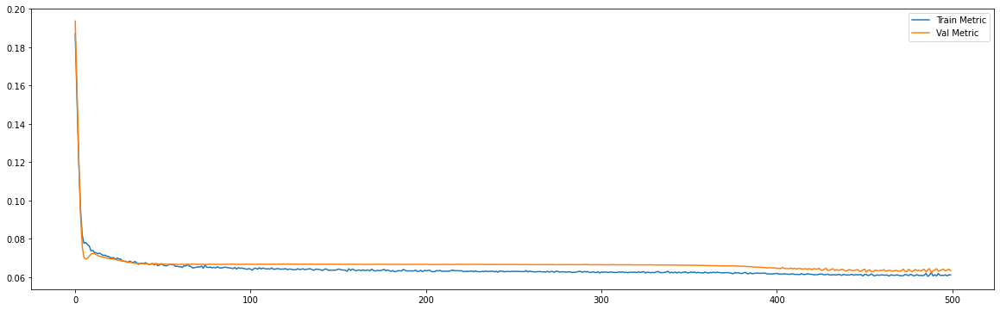

============================model:39===========================
32/32 [==============================] - 0s 8ms/step - loss: 0.0071 - mae: 0.0623
loss and metric train data [0.007138718850910664, 0.06229019537568092]
3/3 [==============================] - 0s 6ms/step - loss: 0.0069 - mae: 0.0666
loss and metric val data [0.006927653215825558, 0.06664962321519852]
3/3 [==============================] - 0s 6ms/step - loss: 0.0144 - mae: 0.0942
loss and metric test data [0.014368060044944286, 0.09421636909246445]


'neurons': 30, 'dropout': 0.2, 'time_steps': 240, 'batch_size':240, 'hidden_layers':2




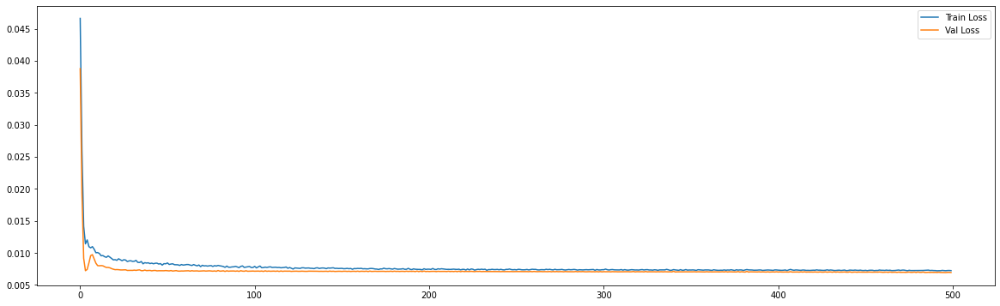

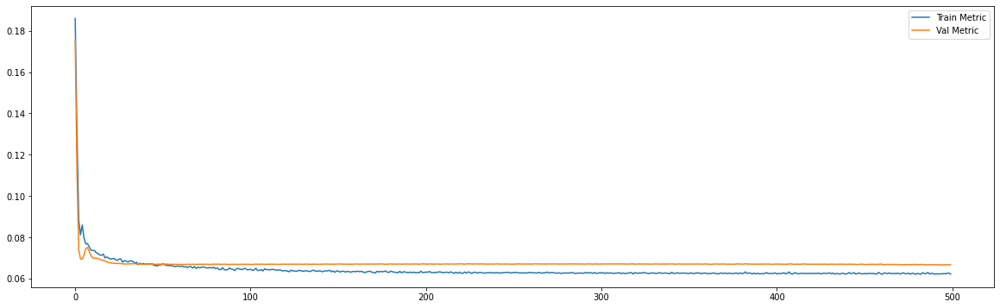

Epoch 00337: early stopping
============================model:40===========================
45/45 [==============================] - 0s 3ms/step - loss: 0.0057 - mae: 0.0558
loss and metric train data [0.005715296603739262, 0.05576305091381073]
9/9 [==============================] - 0s 2ms/step - loss: 0.0049 - mae: 0.0553
loss and metric val data [0.0049240682274103165, 0.055347803980112076]
9/9 [==============================] - 0s 2ms/step - loss: 0.0060 - mae: 0.0571
loss and metric test data [0.005961330141872168, 0.05711332708597183]


'neurons': 30, 'dropout': 0.4, 'time_steps': 30, 'batch_size':30, 'learning_rate':0.001, 'hidden_layers':1




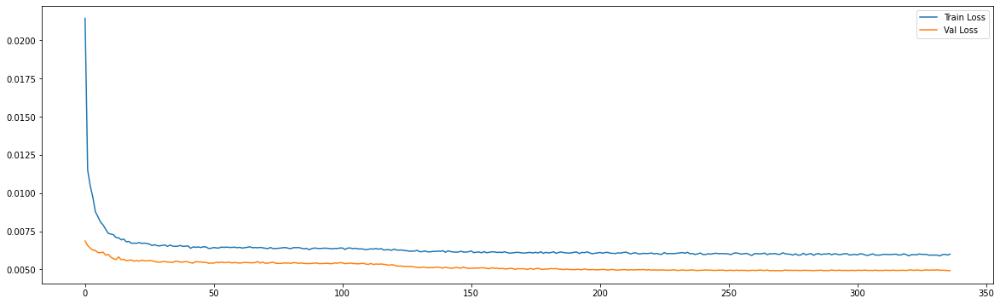

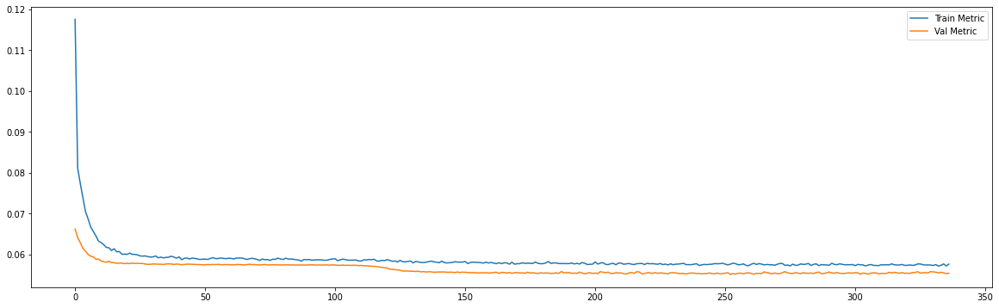

Epoch 00222: early stopping
============================model:41===========================
45/45 [==============================] - 0s 3ms/step - loss: 0.0057 - mae: 0.0559
loss and metric train data [0.005722274072468281, 0.055936817079782486]
9/9 [==============================] - 0s 3ms/step - loss: 0.0050 - mae: 0.0556
loss and metric val data [0.005031024571508169, 0.05560990795493126]
9/9 [==============================] - 0s 3ms/step - loss: 0.0062 - mae: 0.0566
loss and metric test data [0.0062180170789361, 0.05657695606350899]


'neurons': 30, 'dropout': 0.4, 'time_steps': 30, 'batch_size':30, 'hidden_layers':2




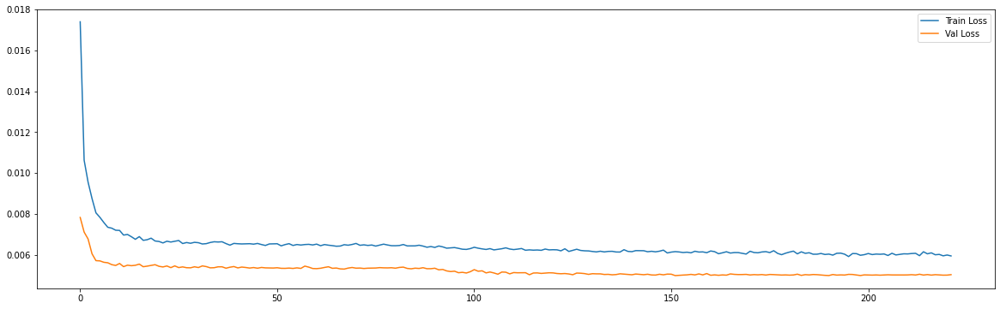

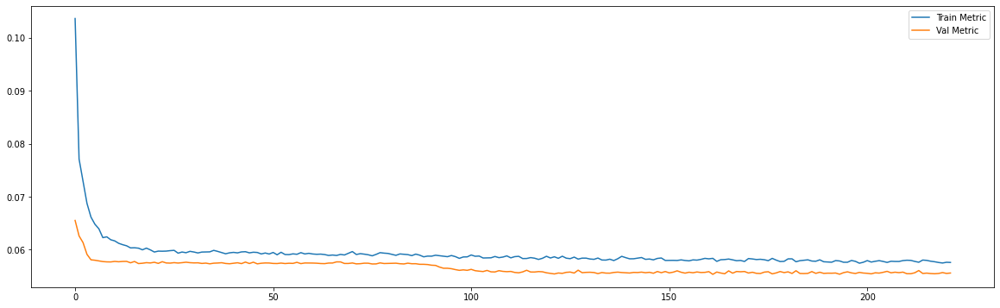

Epoch 00246: early stopping
============================model:42===========================
43/43 [==============================] - 0s 3ms/step - loss: 0.0058 - mae: 0.0559
loss and metric train data [0.005760444328188896, 0.05590888112783432]
8/8 [==============================] - 0s 3ms/step - loss: 0.0049 - mae: 0.0551
loss and metric val data [0.0049483561888337135, 0.05509951338171959]
8/8 [==============================] - 0s 3ms/step - loss: 0.0069 - mae: 0.0624
loss and metric test data [0.00691200653091073, 0.062419697642326355]


'neurons': 30, 'dropout': 0.4, 'time_steps': 60, 'batch_size':60, 'learning_rate':0.001, 'hidden_layers':1




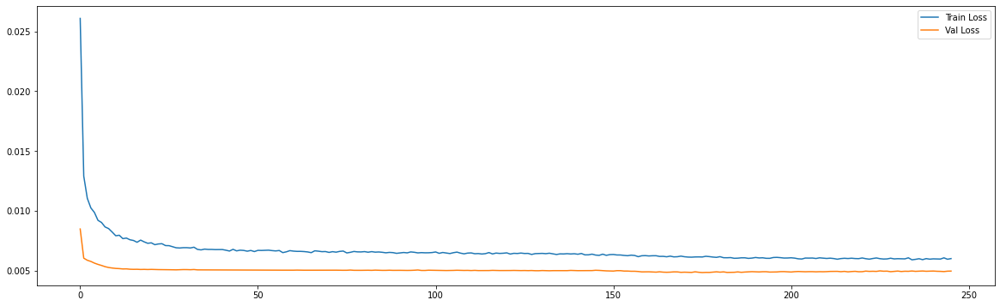

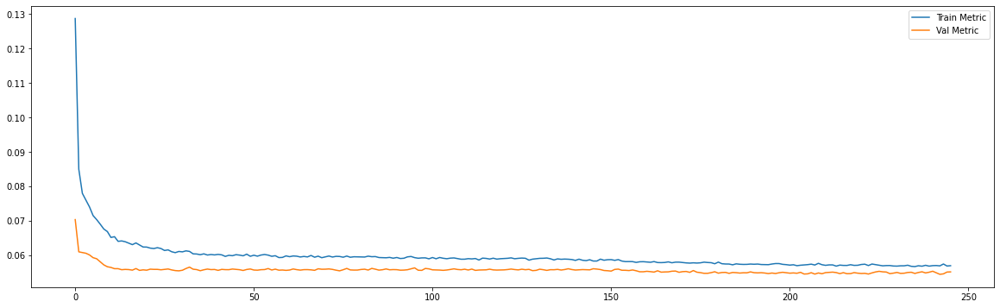

Epoch 00377: early stopping
============================model:43===========================
43/43 [==============================] - 0s 4ms/step - loss: 0.0055 - mae: 0.0556
loss and metric train data [0.0054622977040708065, 0.055596429854631424]
8/8 [==============================] - 0s 3ms/step - loss: 0.0049 - mae: 0.0559
loss and metric val data [0.004905794281512499, 0.05594325810670853]
8/8 [==============================] - 0s 3ms/step - loss: 0.0078 - mae: 0.0642
loss and metric test data [0.007801819127053022, 0.06422198563814163]


'neurons': 30, 'dropout': 0.4, 'time_steps': 60, 'batch_size':60, 'hidden_layers':2




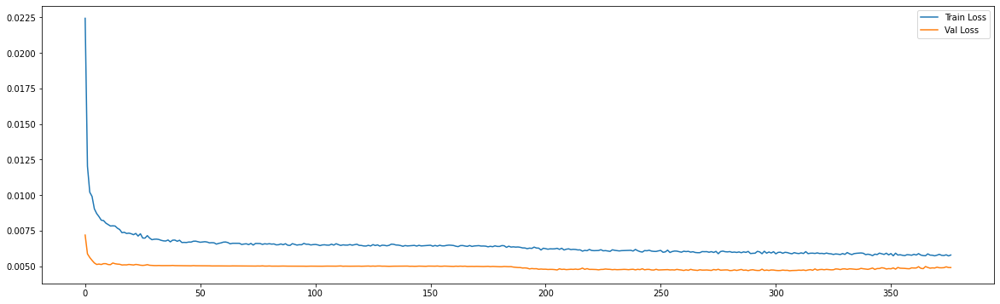

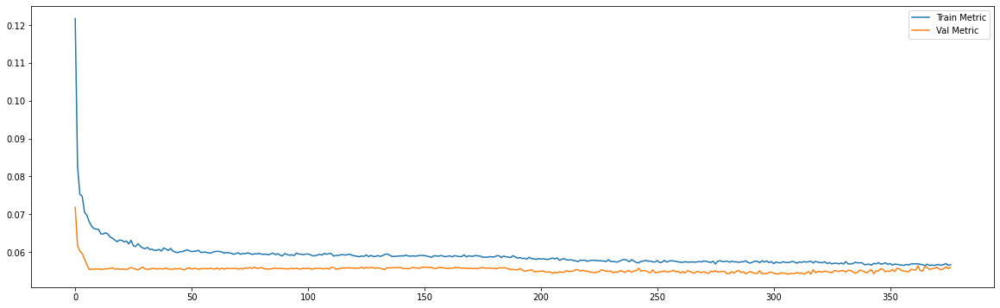

Epoch 00157: early stopping
============================model:44===========================
39/39 [==============================] - 0s 3ms/step - loss: 0.0062 - mae: 0.0573
loss and metric train data [0.006226296070963144, 0.05733156204223633]
7/7 [==============================] - 0s 3ms/step - loss: 0.0049 - mae: 0.0545
loss and metric val data [0.00485931895673275, 0.05448347330093384]
7/7 [==============================] - 0s 3ms/step - loss: 0.0084 - mae: 0.0703
loss and metric test data [0.008423399180173874, 0.07030537724494934]


'neurons': 30, 'dropout': 0.4, 'time_steps': 120, 'batch_size':120, 'learning_rate':0.001, 'hidden_layers':1




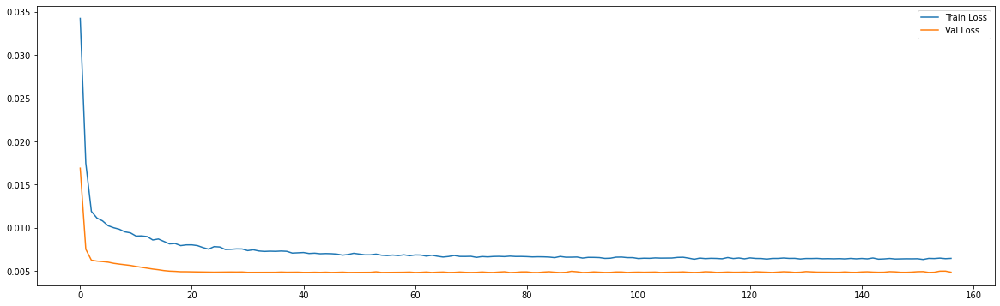

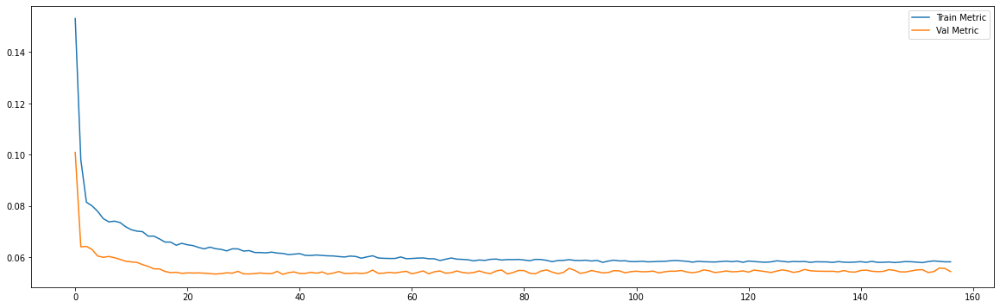

Epoch 00164: early stopping
============================model:45===========================
39/39 [==============================] - 0s 5ms/step - loss: 0.0063 - mae: 0.0581
loss and metric train data [0.006277879700064659, 0.05805978551506996]
7/7 [==============================] - 0s 5ms/step - loss: 0.0049 - mae: 0.0552
loss and metric val data [0.004934706725180149, 0.055239249020814896]
7/7 [==============================] - 0s 5ms/step - loss: 0.0085 - mae: 0.0709
loss and metric test data [0.008498834446072578, 0.07091137021780014]


'neurons': 30, 'dropout': 0.4, 'time_steps': 120, 'batch_size':120, 'hidden_layers':2




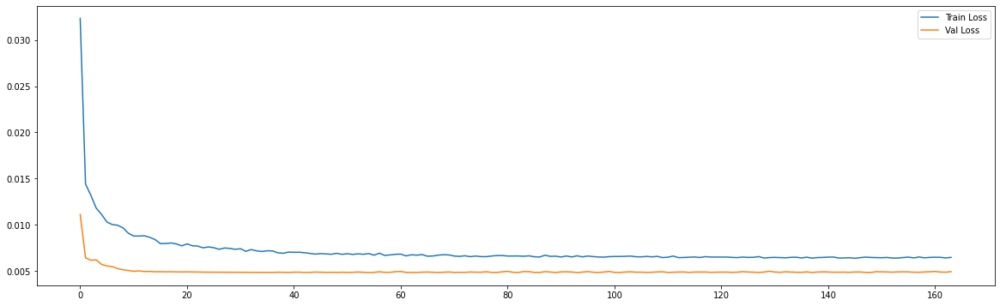

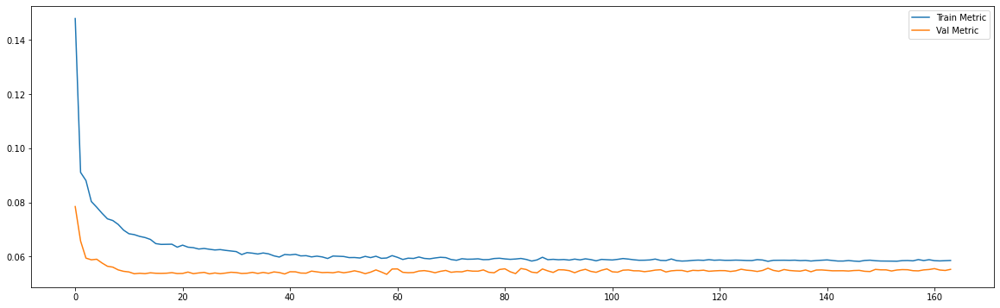

============================model:46===========================
32/32 [==============================] - 0s 5ms/step - loss: 0.0069 - mae: 0.0613
loss and metric train data [0.006936313584446907, 0.061325281858444214]
3/3 [==============================] - 0s 4ms/step - loss: 0.0068 - mae: 0.0649
loss and metric val data [0.006795255001634359, 0.06491972506046295]
3/3 [==============================] - 0s 4ms/step - loss: 0.0140 - mae: 0.0928
loss and metric test data [0.013977088034152985, 0.09277195483446121]


'neurons': 30, 'dropout': 0.4, 'time_steps': 240, 'batch_size':240, 'learning_rate':0.001, 'hidden_layers':1




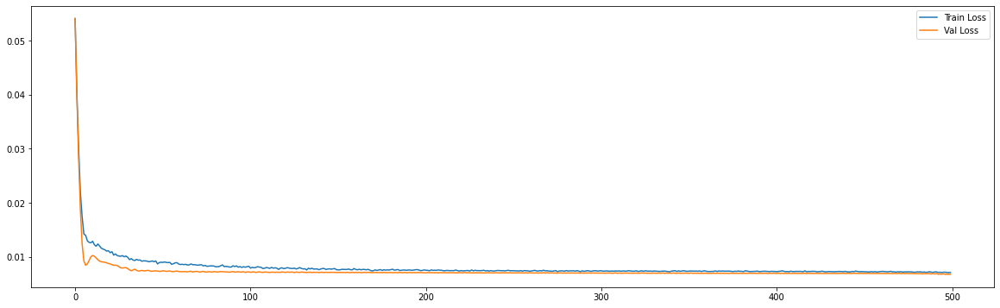

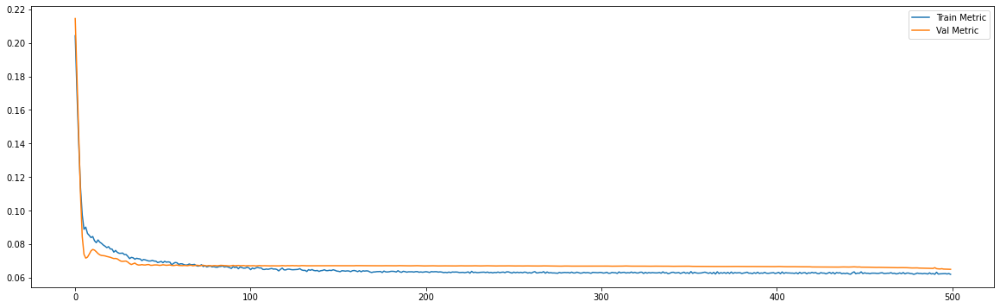

============================model:47===========================
32/32 [==============================] - 0s 8ms/step - loss: 0.0071 - mae: 0.0620
loss and metric train data [0.007129657547920942, 0.06196659803390503]
3/3 [==============================] - 0s 6ms/step - loss: 0.0069 - mae: 0.0668
loss and metric val data [0.006922638043761253, 0.06676823645830154]
3/3 [==============================] - 0s 6ms/step - loss: 0.0145 - mae: 0.0945
loss and metric test data [0.014543109573423862, 0.09451540559530258]


'neurons': 30, 'dropout': 0.4, 'time_steps': 240, 'batch_size':240, 'hidden_layers':2




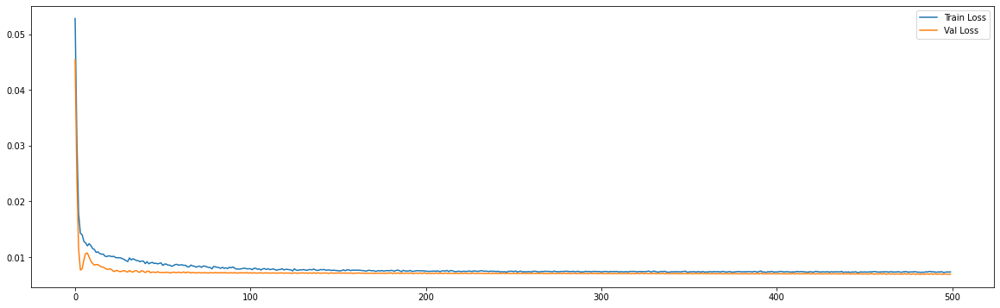

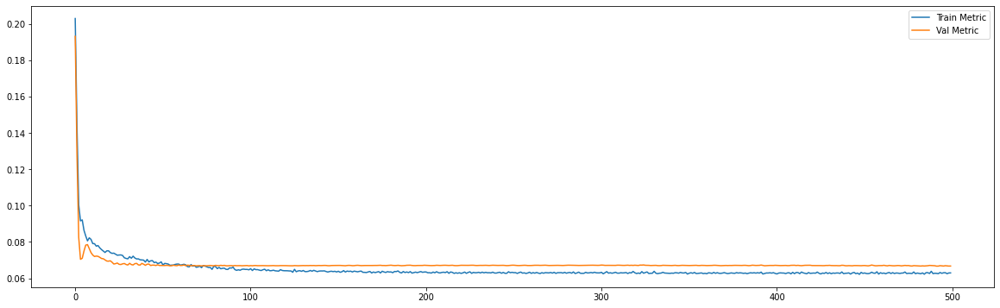

In [9]:
future_steps = 5
n_features = 1

neurons_list = [20,25,30]
dropout_list = [0.2,0.4]
time_steps_list = [30,60,120,240]
lr_list = [0.001]
models = {}
i=0
for neurons in neurons_list:
  for dropout in dropout_list:
    for time_steps in time_steps_list:
      for lr in lr_list:
        x_train,x_test,x_val,y_train,y_val,y_test = Regressor(future_steps = future_steps,time_steps = time_steps,n_features = n_features,df_train = df_train_norm,df_val = df_val_norm,df_test = df_test_norm)

        models[i] = {'neurons':neurons,'dropout':dropout,'time_steps': time_steps, 'batch_size':time_steps, 'learning_rate':lr}
        models[i]['resumo'] = "'neurons': {}, 'dropout': {}, 'time_steps': {}, 'batch_size':{}, 'learning_rate':{}, 'hidden_layers':{}".format(neurons,dropout,time_steps,time_steps,lr,1)

        # The GRU architecture
        models[i]['model'] = Sequential()
        models[i]['model'].add(GRU(units=neurons, return_sequences=False,input_shape=(time_steps, n_features))) # return_sequences=True next layer is GRU
        models[i]['model'].add(Dropout(dropout))
        models[i]['model'].add(Dense(units=future_steps))

        #Compiling the GRU
        adam = optimizers.Adam(lr = lr, beta_1 = 0.9, beta_2 = 0.999, decay = 0.0)
        models[i]['model'].compile(optimizer = adam, loss = 'mse', metrics=['mae'])

        # early stop
        es = EarlyStopping(monitor='val_loss', mode='min', verbose=1, patience = 70)

        #Fitting to traning set
        history = models[i]['model'].fit(x_train, y_train, validation_data = (x_val,y_val), epochs = 500, batch_size = time_steps, verbose = 0, shuffle = False, callbacks = [es])

        print('============================model:{}==========================='.format(i))

          
        print('loss and metric train data',models[i]['model'].evaluate(x_train,y_train))
        print('loss and metric val data',models[i]['model'].evaluate(x_val,y_val))
        print('loss and metric test data',models[i]['model'].evaluate(x_test,y_test))
        print('\n')

        print(models[i]['resumo'])
        print('\n')

        plt.figure(figsize=(20,6))
        plt.plot(history.history['loss'])
        plt.plot(history.history['val_loss'])
        plt.legend(['Train Loss', 'Val Loss'])

        plt.figure(figsize=(20,6))
        plt.plot(history.history['mae'])
        plt.plot(history.history['val_mae'])
        plt.legend(['Train Metric', 'Val Metric'])
        plt.show()

        i+=1


        models[i] = {'neurons':neurons,'dropout':dropout,'time_steps': time_steps, 'batch_size':time_steps}
        models[i]['resumo'] = "'neurons': {}, 'dropout': {}, 'time_steps': {}, 'batch_size':{}, 'hidden_layers':{}".format(neurons,dropout,time_steps,time_steps,2)

        # The GRU architecture
        models[i]['model'] = Sequential()
        models[i]['model'].add(GRU(units=neurons, return_sequences=True,input_shape=(time_steps, n_features))) # return_sequences=True next layer is GRU
        models[i]['model'].add(Dropout(dropout))
        models[i]['model'].add(GRU(units=neurons, return_sequences=False))
        models[i]['model'].add(Dropout(dropout))
        models[i]['model'].add(Dense(units=future_steps))

        #Compiling the GRU
        adam = optimizers.Adam(lr = lr, beta_1 = 0.9, beta_2 = 0.999, decay = 0.0)
        models[i]['model'].compile(optimizer = adam, loss = 'mse', metrics=['mae'])

         # early stop
        es = EarlyStopping(monitor='val_loss', mode='min', verbose=1, patience = 70)

        #Fitting to traning set
        history = models[i]['model'].fit(x_train, y_train, validation_data = (x_val,y_val), epochs = 500, batch_size = time_steps, verbose = 0, shuffle = False, callbacks = [es])

        print('============================model:{}==========================='.format(i))

          
        print('loss and metric train data',models[i]['model'].evaluate(x_train,y_train))
        print('loss and metric val data',models[i]['model'].evaluate(x_val,y_val))
        print('loss and metric test data',models[i]['model'].evaluate(x_test,y_test))
        print('\n')

        print(models[i]['resumo'])
        print('\n')

        plt.figure(figsize=(20,6))
        plt.plot(history.history['loss'])
        plt.plot(history.history['val_loss'])
        plt.legend(['Train Loss', 'Val Loss'])

        plt.figure(figsize=(20,6))
        plt.plot(history.history['mae'])
        plt.plot(history.history['val_mae'])
        plt.legend(['Train Metric', 'Val Metric'])
        plt.show()

        i+=1

## Best Model Resume 

`Validation metric as evaluation parameter`


Epoch 00334: early stopping

============================model:20===========================

39/39 [==============================] - 0s 3ms/step - loss: 0.0058 - mae: 0.0560

loss and metric train data [0.005849240813404322, 0.05600116029381752]

7/7 [==============================] - 0s 3ms/step - loss: 0.0046 - mae: 0.0528

loss and metric val data [0.004636380355805159, 0.0528063140809536]

7/7 [==============================] - 0s 3ms/step - loss: 0.0082 - mae: 0.0684

loss and metric test data [0.008157462812960148, 0.068441241979599]


'neurons': 25, 'dropout': 0.2, 'time_steps': 120, 'batch_size':120, 'learning_rate':0.001, 'hidden_layers':1

In [11]:
models[20]

{'batch_size': 120,
 'dropout': 0.2,
 'learning_rate': 0.001,
 'model': <tensorflow.python.keras.engine.sequential.Sequential at 0x7efe95b86438>,
 'neurons': 25,
 'resumo': "'neurons': 25, 'dropout': 0.2, 'time_steps': 120, 'batch_size':120, 'learning_rate':0.001, 'hidden_layers':1",
 'time_steps': 120}

Saving the Model

In [0]:
models[20]['model'].save("/content/drive/My Drive/ML Projects/Pharma Sales/GRU_OneFeature.h5")

Ploting the model prediction


In [0]:
future_steps = 5
n_features = 1
x_train,x_test,x_val,y_train,y_val,y_test = Regressor(future_steps = future_steps,time_steps = 120,n_features = n_features,df_train = df_train_norm,df_val = df_val_norm,df_test = df_test_norm)

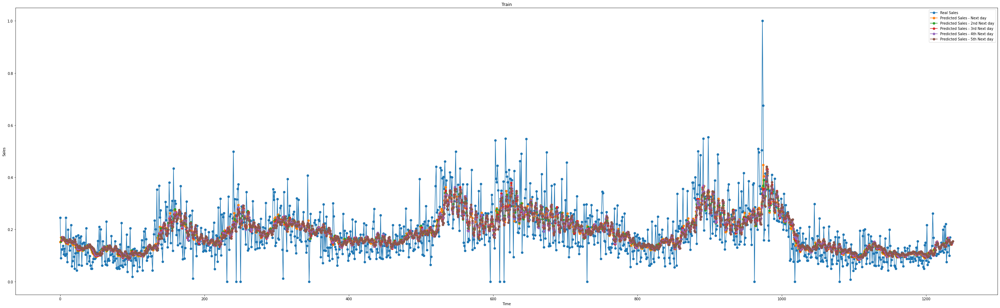

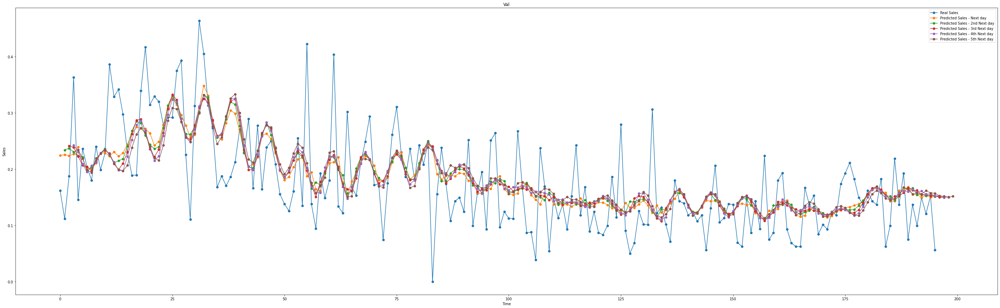

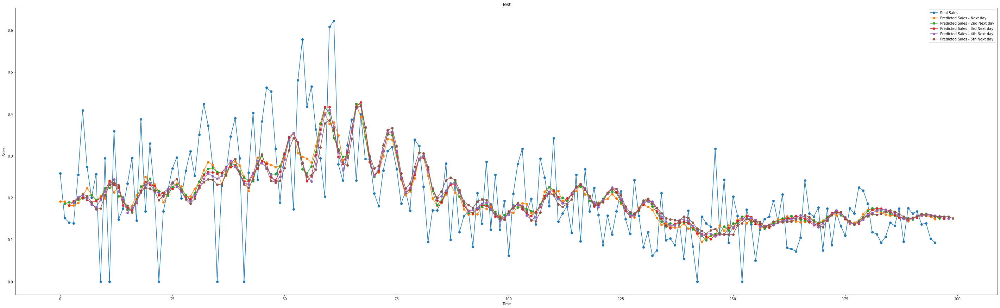

In [15]:
y_train_predict = models[20]['model'].predict(x_train)
y_val_predict = models[20]['model'].predict(x_val)
y_test_predict = models[20]['model'].predict(x_test)

plt.figure(figsize=(50,15))
plt.plot(y_train[:,0],marker='o',label='Real Sales')
plt.plot(y_train_predict[:,0],marker='o',label='Predicted Sales - Next day')
plt.plot(np.concatenate(([None],y_train_predict[:, 1])),marker='o',label='Predicted Sales - 2nd Next day')
plt.plot(np.concatenate(([None, None],y_train_predict[:, 2])),marker='o',label='Predicted Sales - 3rd Next day')
plt.plot(np.concatenate(([None, None, None],y_train_predict[:, 3])),marker='o',label='Predicted Sales - 4th Next day')
plt.plot(np.concatenate(([None, None, None,None],y_train_predict[:, 4])),marker='o',label='Predicted Sales - 5th Next day')
plt.title('Train')
plt.xlabel('Time')
plt.ylabel('Sales')
plt.legend()
plt.show()

plt.figure(figsize=(50,15))
plt.plot(y_val[:,0],marker='o',label='Real Sales')
plt.plot(y_val_predict[:,0],marker='o',label='Predicted Sales - Next day')
plt.plot(np.concatenate(([None],y_val_predict[:, 1])),marker='o',label='Predicted Sales - 2nd Next day')
plt.plot(np.concatenate(([None, None],y_val_predict[:, 2])),marker='o',label='Predicted Sales - 3rd Next day')
plt.plot(np.concatenate(([None, None, None],y_val_predict[:, 3])),marker='o',label='Predicted Sales - 4th Next day')
plt.plot(np.concatenate(([None, None, None,None],y_val_predict[:, 4])),marker='o',label='Predicted Sales - 5th Next day')
plt.title('Val')
plt.xlabel('Time')
plt.ylabel('Sales')
plt.legend()
plt.show()

plt.figure(figsize=(50,15))
plt.plot(y_test[:,0],marker='o',label='Real Sales')
plt.plot(y_test_predict[:,0],marker='o',label='Predicted Sales - Next day')
plt.plot(np.concatenate(([None],y_test_predict[:, 1])),marker='o',label='Predicted Sales - 2nd Next day')
plt.plot(np.concatenate(([None, None],y_test_predict[:, 2])),marker='o',label='Predicted Sales - 3rd Next day')
plt.plot(np.concatenate(([None, None, None],y_test_predict[:, 3])),marker='o',label='Predicted Sales - 4th Next day')
plt.plot(np.concatenate(([None, None, None,None],y_test_predict[:, 4])),marker='o',label='Predicted Sales - 5th Next day')
plt.title('Test')
plt.xlabel('Time')
plt.ylabel('Sales')
plt.legend()
plt.show()

# Multi-Feature

## Importing

In [0]:
df_daily = pd.read_csv('/content/drive/My Drive/ML Projects/Pharma Sales/Data/salesdaily.csv')
df_daily = df_daily[['datum','Weekday Name','N02BE']]
df_daily.columns = ['data','weekday','N02BE']

## Encoding Categorial Features





Extracting month information from date column

In [0]:
df_daily['data'] = pd.to_datetime(df_daily['data'])
df_daily['month'] = df_daily['data'].dt.month
df_daily = df_daily[['weekday','month','N02BE']]

weekday and month can be converted using the OneHot and OrdinalEnconder.

In [0]:
df_daily = pd.concat([pd.get_dummies(df_daily['weekday']),df_daily],axis=1)
dict_ = {'Monday':1,'Tuesday':2,'Wednesday':3,'Thursday':4,'Friday':5,'Saturday':6,'Sunday':7}
df_daily['weekday'].replace(dict_,inplace = True)

In [0]:
df_daily = pd.concat([pd.get_dummies(df_daily['month']),df_daily],axis=1)

## Feature Engineering

Lag Approach

In [0]:
df_daily['lag1'] = df_daily['N02BE'].shift(1)
df_daily['lag2'] = df_daily['N02BE'].shift(2)
df_daily['lag3'] = df_daily['N02BE'].shift(3)
df_daily['lag4'] = df_daily['N02BE'].shift(4)
df_daily['lag5'] = df_daily['N02BE'].shift(5)
df_daily['lag6'] = df_daily['N02BE'].shift(6)
df_daily['lag7'] = df_daily['N02BE'].shift(7)
df_daily['lag30'] = df_daily['N02BE'].shift(30)
df_daily['lag60'] = df_daily['N02BE'].shift(60)
df_daily['lag120'] = df_daily['N02BE'].shift(120)
df_daily['lag240'] = df_daily['N02BE'].shift(240)

Rolling Mean Approach

In [0]:
df_daily['rolling_mean_2'] = df_daily['N02BE'].rolling(window = 2).mean()
df_daily['rolling_mean_3'] = df_daily['N02BE'].rolling(window = 3).mean()
df_daily['rolling_mean_4'] = df_daily['N02BE'].rolling(window = 4).mean()
df_daily['rolling_mean_5'] = df_daily['N02BE'].rolling(window = 5).mean()
df_daily['rolling_mean_6'] = df_daily['N02BE'].rolling(window = 6).mean()
df_daily['rolling_mean_7'] = df_daily['N02BE'].rolling(window = 7).mean()
df_daily['rolling_mean_30'] = df_daily['N02BE'].rolling(window = 30).mean()
df_daily['rolling_mean_60'] = df_daily['N02BE'].rolling(window = 60).mean()
df_daily['rolling_mean_120'] = df_daily['N02BE'].rolling(window = 120).mean()
df_daily['rolling_mean_240'] = df_daily['N02BE'].rolling(window = 240).mean()

In [22]:
df_daily

,1,2,3,4,5,6,7,8,9,10,11,12,Friday,Monday,Saturday,Sunday,Thursday,Tuesday,Wednesday,weekday,month,N02BE,lag1,lag2,lag3,lag4,lag5,lag6,lag7,lag30,lag60,lag120,lag240,rolling_mean_2,rolling_mean_3,rolling_mean_4,rolling_mean_5,rolling_mean_6,rolling_mean_7,rolling_mean_30,rolling_mean_60,rolling_mean_120,rolling_mean_240
0,1,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,1,0,0,4,1,32.40,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN
1,1,0,0,0,0,0,0,0,0,0,0,0,1,0,0,0,0,0,0,5,1,50.60,32.40,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,41.500,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN
2,1,0,0,0,0,0,0,0,0,0,0,0,0,0,1,0,0,0,0,6,1,61.85,50.60,32.40,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,56.225,48.283333,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN
3,1,0,0,0,0,0,0,0,0,0,0,0,0,0,0,1,0,0,0,7,1,41.10,61.85,50.60,32.40,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,51.475,51.183333,46.4875,NaN,NaN,NaN,NaN,NaN,NaN,NaN
4,1,0,0,0,0,0,0,0,0,0,0,0,0,1,0,0,0,0,0,1,1,21.70,41.10,61.85,50.60,32.40,NaN,NaN,NaN,NaN,NaN,NaN,NaN,31.400,41.550000,43.8125,41.53,NaN,NaN,NaN,NaN,NaN,NaN
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
2101,0,0,0,0,0,0,0,0,0,1,0,0,1,0,0,0,0,0,0,5,10,22.45,40.40,30.20,47.00,49.40,67.8,48.0,41.1,29.23,6.00,27.0,29.00,31.425,31.016667,35.0125,37.89,42.875000,43.607143,34.939167,25.760500,22.726708,24.611371
2102,0,0,0,0,0,0,0,0,0,1,0,0,0,0,1,0,0,0,0,6,10,25.40,22.45,40.40,30.20,47.00,49.4,67.8,48.0,14.00,17.25,22.0,42.60,23.925,29.416667,29.6125,33.09,35.808333,40.378571,35.319167,25.896333,22.755042,24.539704
2103,0,0,0,0,0,0,0,0,0,1,0,0,0,0,0,1,0,0,0,7,10,34.60,25.40,22.45,40.40,30.20,47.0,49.4,67.8,28.40,9.00,22.4,50.20,30.000,27.483333,30.7125,30.61,33.341667,35.635714,35.525833,26.323000,22.856708,24.474704
2104,0,0,0,0,0,0,0,0,0,1,0,0,0,1,0,0,0,0,0,1,10,50.80,34.60,25.40,22.45,40.40,30.2,47.0,49.4,27.00,15.00,16.5,51.65,42.700,36.933333,33.3125,34.73,33.975000,35.835714,36.319167,26.919667,23.142542,24.471162


In [0]:
df_daily = df_daily[['weekday','Monday','Tuesday','Wednesday','Thursday','Friday','Saturday','Sunday','month',1,2,3,4,5,6,7,8,9,10,11,12,
          'lag1','lag2','lag3','lag4','lag5','lag6','lag7','lag30','lag60','lag120','lag240',
          'rolling_mean_2','rolling_mean_3','rolling_mean_4','rolling_mean_5','rolling_mean_6','rolling_mean_7','rolling_mean_30','rolling_mean_60','rolling_mean_120','rolling_mean_240',
          'N02BE']]

In [24]:
df_daily

,weekday,Monday,Tuesday,Wednesday,Thursday,Friday,Saturday,Sunday,month,1,2,3,4,5,6,7,8,9,10,11,12,lag1,lag2,lag3,lag4,lag5,lag6,lag7,lag30,lag60,lag120,lag240,rolling_mean_2,rolling_mean_3,rolling_mean_4,rolling_mean_5,rolling_mean_6,rolling_mean_7,rolling_mean_30,rolling_mean_60,rolling_mean_120,rolling_mean_240,N02BE
0,4,0,0,0,1,0,0,0,1,1,0,0,0,0,0,0,0,0,0,0,0,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,32.40
1,5,0,0,0,0,1,0,0,1,1,0,0,0,0,0,0,0,0,0,0,0,32.40,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,41.500,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,50.60
2,6,0,0,0,0,0,1,0,1,1,0,0,0,0,0,0,0,0,0,0,0,50.60,32.40,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,56.225,48.283333,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,61.85
3,7,0,0,0,0,0,0,1,1,1,0,0,0,0,0,0,0,0,0,0,0,61.85,50.60,32.40,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,51.475,51.183333,46.4875,NaN,NaN,NaN,NaN,NaN,NaN,NaN,41.10
4,1,1,0,0,0,0,0,0,1,1,0,0,0,0,0,0,0,0,0,0,0,41.10,61.85,50.60,32.40,NaN,NaN,NaN,NaN,NaN,NaN,NaN,31.400,41.550000,43.8125,41.53,NaN,NaN,NaN,NaN,NaN,NaN,21.70
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
2101,5,0,0,0,0,1,0,0,10,0,0,0,0,0,0,0,0,0,1,0,0,40.40,30.20,47.00,49.40,67.8,48.0,41.1,29.23,6.00,27.0,29.00,31.425,31.016667,35.0125,37.89,42.875000,43.607143,34.939167,25.760500,22.726708,24.611371,22.45
2102,6,0,0,0,0,0,1,0,10,0,0,0,0,0,0,0,0,0,1,0,0,22.45,40.40,30.20,47.00,49.4,67.8,48.0,14.00,17.25,22.0,42.60,23.925,29.416667,29.6125,33.09,35.808333,40.378571,35.319167,25.896333,22.755042,24.539704,25.40
2103,7,0,0,0,0,0,0,1,10,0,0,0,0,0,0,0,0,0,1,0,0,25.40,22.45,40.40,30.20,47.0,49.4,67.8,28.40,9.00,22.4,50.20,30.000,27.483333,30.7125,30.61,33.341667,35.635714,35.525833,26.323000,22.856708,24.474704,34.60
2104,1,1,0,0,0,0,0,0,10,0,0,0,0,0,0,0,0,0,1,0,0,34.60,25.40,22.45,40.40,30.2,47.0,49.4,27.00,15.00,16.5,51.65,42.700,36.933333,33.3125,34.73,33.975000,35.835714,36.319167,26.919667,23.142542,24.471162,50.80


## Feature Importance

----

Based on the features created above, I'll determine wich are really relevant for the LSTM.

In [25]:
df_daily.corr()

,weekday,Monday,Tuesday,Wednesday,Thursday,Friday,Saturday,Sunday,month,1,2,3,4,5,6,7,8,9,10,11,12,lag1,lag2,lag3,lag4,lag5,lag6,lag7,lag30,lag60,lag120,lag240,rolling_mean_2,rolling_mean_3,rolling_mean_4,rolling_mean_5,rolling_mean_6,rolling_mean_7,rolling_mean_30,rolling_mean_60,rolling_mean_120,rolling_mean_240,N02BE
weekday,1.000000,-0.612530,-0.408386,-0.203845,-0.000097,0.204047,0.408192,0.612336,0.000607,-0.000912,-0.002691,0.004945,-0.000922,-0.001747,0.002475,-0.002583,0.001599,0.000776,-0.004510,0.001780,0.001751,-0.004027,-0.121533,-0.079472,-0.023994,0.034387,0.085315,0.108987,-0.120500,-0.025819,0.000145,-0.130833,0.060833,-0.007872,-0.033305,-0.035007,-0.021126,-0.000753,0.005213,-0.002975,0.001867,0.000892,0.107282
Monday,-0.612530,1.000000,-0.166759,-0.166436,-0.166759,-0.166759,-0.166759,-0.166759,0.000152,-0.002114,0.004223,-0.002792,0.001327,-0.002792,0.001327,0.001989,-0.002792,0.001327,0.003570,-0.002314,-0.000797,0.091261,0.096462,-0.034244,-0.045414,-0.047875,-0.041311,-0.019317,0.098008,-0.044434,0.091111,0.106862,0.043208,0.072168,0.045620,0.025402,0.009389,-0.000210,0.003949,0.004066,-0.000537,0.000605,-0.017933
Tuesday,-0.408386,-0.166759,1.000000,-0.166436,-0.166759,-0.166759,-0.166759,-0.166759,-0.000649,0.002679,-0.000771,-0.002792,0.001327,0.001989,-0.003525,0.001989,-0.002792,0.001327,0.003570,-0.002314,-0.000797,-0.017758,0.091563,0.096527,-0.034303,-0.045511,-0.047751,-0.041308,0.089280,-0.034332,-0.021609,0.092743,-0.034265,0.014274,0.043708,0.026889,0.012376,0.000580,-0.002685,0.003792,-0.001071,-0.001265,-0.040435
Wednesday,-0.203845,-0.166436,-0.166436,1.000000,-0.166436,-0.166436,-0.166436,-0.166436,0.001494,-0.001696,-0.000370,-0.002373,0.001744,0.002414,-0.003115,0.002414,0.002414,-0.003115,-0.001115,0.003341,-0.000415,-0.041577,-0.019353,0.091345,0.097003,-0.033796,-0.046366,-0.047842,-0.020296,0.099296,-0.040937,-0.021522,-0.052858,-0.046168,-0.005617,0.022364,0.011275,0.000396,-0.004902,-0.000372,-0.000154,0.000242,-0.048179
Thursday,-0.000097,-0.166759,-0.166759,-0.166436,1.000000,-0.166759,-0.166759,-0.166759,-0.001451,0.002679,-0.000771,0.001989,-0.003525,0.001989,0.001327,-0.002792,0.001989,-0.003525,-0.001507,0.002961,-0.000797,-0.048012,-0.041336,-0.019296,0.091294,0.096919,-0.033670,-0.046364,-0.042313,0.091576,-0.049885,-0.042496,-0.055423,-0.057340,-0.051367,-0.017030,0.008454,0.000539,-0.004928,-0.004507,-0.000591,0.000189,-0.045818
Friday,0.204047,-0.166759,-0.166759,-0.166436,-0.166759,1.000000,-0.166759,-0.166759,-0.002252,0.002679,-0.000771,0.001989,-0.003525,0.001989,0.001327,-0.002792,0.001989,0.001327,-0.001507,-0.002314,-0.000797,-0.045650,-0.047775,-0.041280,-0.019353,0.091210,0.097064,-0.033668,-0.046822,-0.021601,-0.045551,-0.049313,-0.047325,-0.055142,-0.056979,-0.052214,-0.022864,0.000037,-0.004345,-0.005044,-0.000577,-0.001912,-0.034716
Saturday,0.408192,-0.166759,-0.166759,-0.166436,-0.166759,-0.166759,1.000000,-0.166759,0.001755,-0.002114,-0.000771,0.001989,0.001327,-0.002792,0.001327,-0.002792,0.001989,0.001327,-0.001507,-0.002314,0.004399,-0.034545,-0.045411,-0.047719,-0.041339,-0.019448,0.091354,0.097072,-0.044392,-0.042147,-0.035408,-0.045398,0.036204,0.006944,-0.011839,-0.020971,-0.022269,-0.000613,0.002967,-0.001301,0.001447,-0.000113,0.095955
Sunday,0.612336,-0.166759,-0.166759,-0.166436,-0.166759,-0.166759,-0.166759,1.000000,0.000953,-0.002114,-0.000771,0.001989,0.001327,-0.002792,0.001327,0.001989,-0.002792,0.001327,-0.001507,0.002961,-0.000797,0.096157,-0.034301,-0.045355,-0.047778,-0.041435,-0.019320,0.091362,-0.033619,-0.048245,0.102144,-0.041053,0.110308,0.065044,0.036300,0.015488,0.003621,-0.000729,0.009930,0.003350,0.001483,0.002255,0.091059
month,0.000607,0.000152,-0.000649,0.001494,-0.001451,-0.002252,0.001755,0.000953,1.000000,-0.489782,-0.378955,-0.307397,-0.211644,-0.123561,-0.031080,0.060275,0.152193,0.239766,0.312700,0.380754,0.470783,0.007281,-0.016833,-0.033153,-0.048309,-0.056490,-0.069706,-0.073206,-0.140758,-0.175870,-0.419919,0.25

## GRU

Whith Month and Weekday

In [26]:
df_train,df_val,df_test = dataSplit(df = df_daily[['weekday','month','N02BE']],train_percent = 0.7,val_percent = 0.15)
df_train_norm,df_val_norm,df_test_norm = normalizing_data(df_train,df_val,df_test,frange = (0,1))

(1474, 3)
(316, 3)
(316, 3)
[1. 1. 1.]
[0. 0. 0.]


[1.         0.90909091 0.46335404]
[0. 0. 0.]


[1.         1.         0.62173913]
[0. 0. 0.]
-------------------------
(1474, 3)
(316, 3)
(316, 3)


Epoch 00433: early stopping
============================model:0===========================
45/45 [==============================] - 0s 2ms/step - loss: 0.0051 - mae: 0.0542
loss and metric train data [0.005130077712237835, 0.05415976047515869]
9/9 [==============================] - 0s 3ms/step - loss: 0.0050 - mae: 0.0557
loss and metric val data [0.005032006185501814, 0.05565143749117851]
9/9 [==============================] - 0s 2ms/step - loss: 0.0059 - mae: 0.0572
loss and metric test data [0.005886624567210674, 0.05722475424408913]


'neurons': 20, 'dropout': 0.2, 'time_steps': 30, 'batch_size':30, 'learning_rate':0.001, 'hidden_layers':1




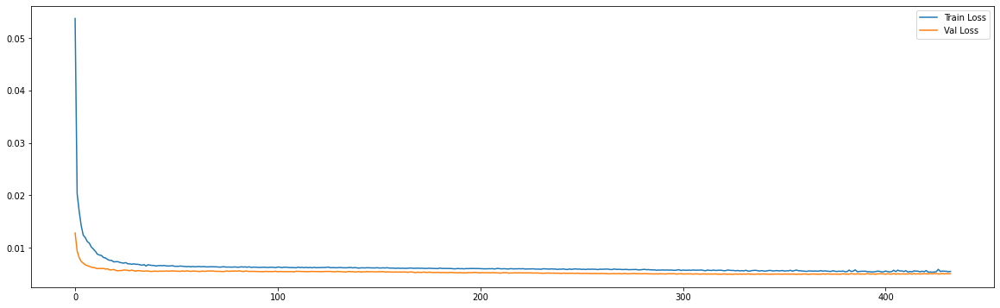

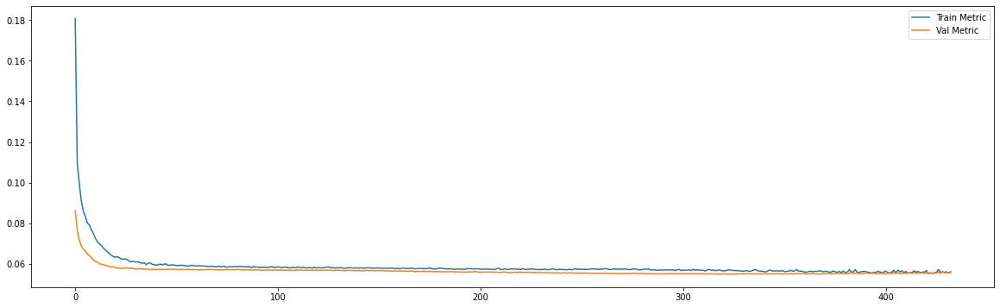

Epoch 00411: early stopping
============================model:1===========================
45/45 [==============================] - 0s 3ms/step - loss: 0.0055 - mae: 0.0557
loss and metric train data [0.005502866115421057, 0.055662572383880615]
9/9 [==============================] - 0s 3ms/step - loss: 0.0051 - mae: 0.0547
loss and metric val data [0.005132956895977259, 0.054721929132938385]
9/9 [==============================] - 0s 3ms/step - loss: 0.0066 - mae: 0.0591
loss and metric test data [0.006638986524194479, 0.059083111584186554]


'neurons': 20, 'dropout': 0.2, 'time_steps': 30, 'batch_size':30, 'hidden_layers':2




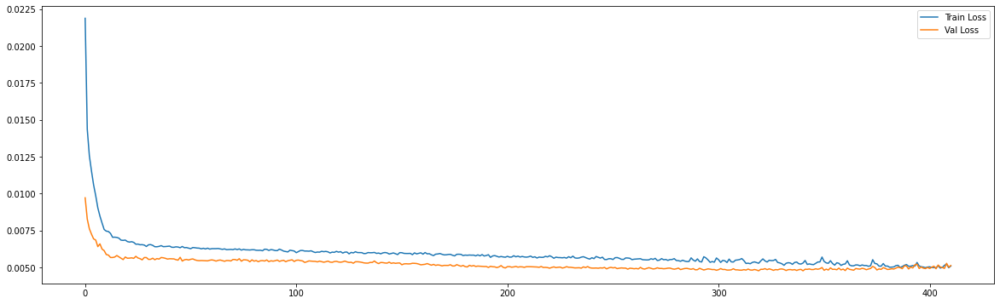

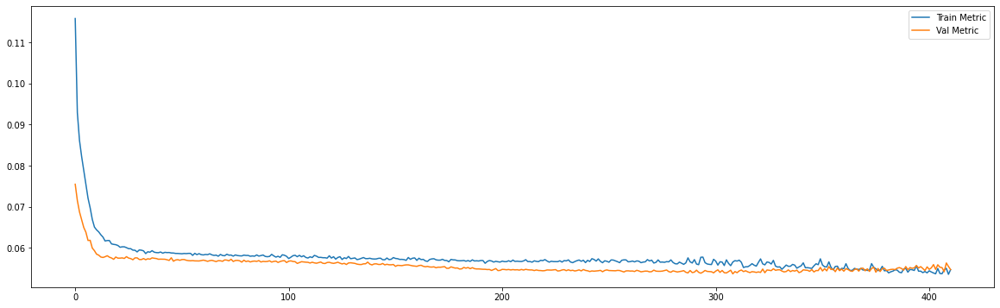

Epoch 00230: early stopping
============================model:2===========================
43/43 [==============================] - 0s 3ms/step - loss: 0.0060 - mae: 0.0575
loss and metric train data [0.005965467542409897, 0.05754919350147247]
8/8 [==============================] - 0s 3ms/step - loss: 0.0048 - mae: 0.0556
loss and metric val data [0.004847703501582146, 0.05561226233839989]
8/8 [==============================] - 0s 3ms/step - loss: 0.0066 - mae: 0.0617
loss and metric test data [0.006572109647095203, 0.061725884675979614]


'neurons': 20, 'dropout': 0.2, 'time_steps': 60, 'batch_size':60, 'learning_rate':0.001, 'hidden_layers':1




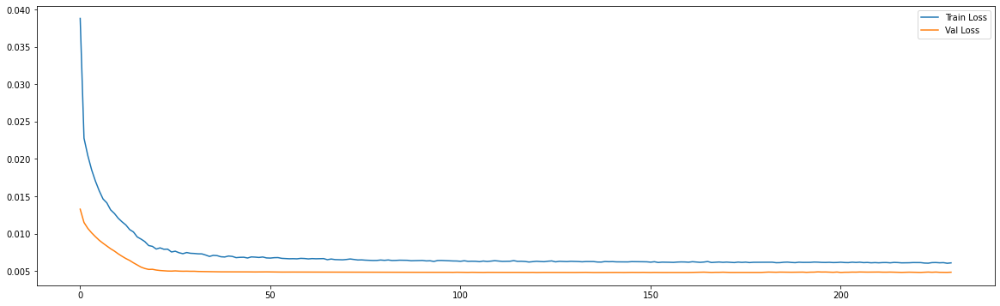

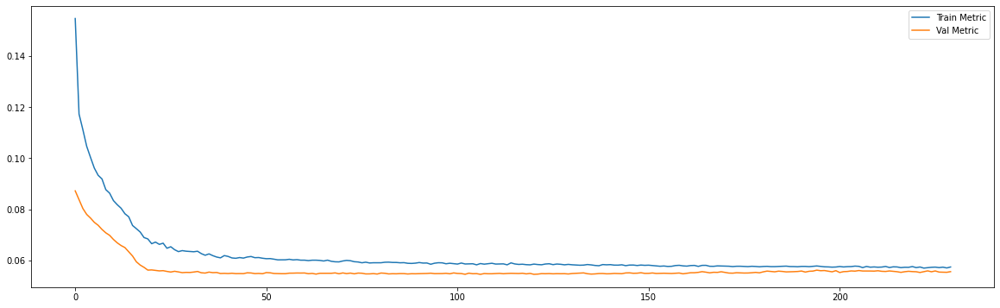

Epoch 00416: early stopping
============================model:3===========================
43/43 [==============================] - 0s 4ms/step - loss: 0.0049 - mae: 0.0526
loss and metric train data [0.004883249290287495, 0.052609652280807495]
8/8 [==============================] - 0s 3ms/step - loss: 0.0048 - mae: 0.0537
loss and metric val data [0.0047542629763484, 0.05373011529445648]
8/8 [==============================] - 0s 3ms/step - loss: 0.0072 - mae: 0.0636
loss and metric test data [0.007155927363783121, 0.06356757879257202]


'neurons': 20, 'dropout': 0.2, 'time_steps': 60, 'batch_size':60, 'hidden_layers':2




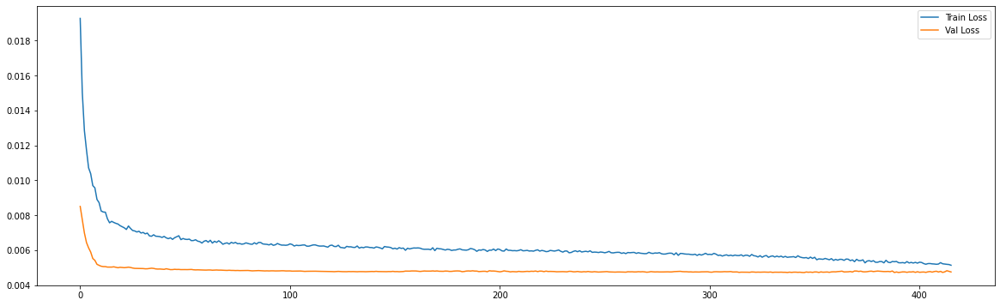

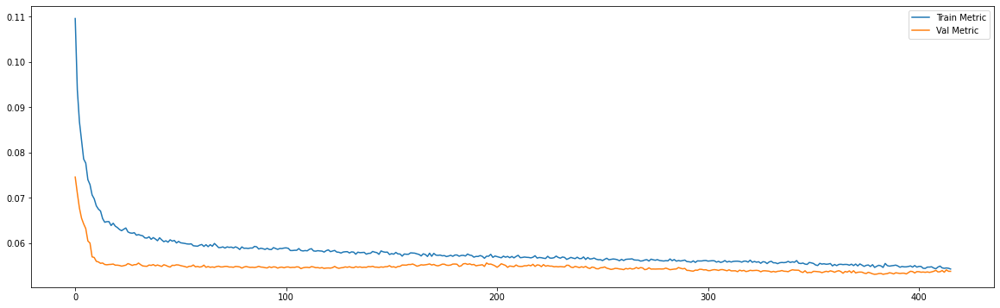

Epoch 00430: early stopping
============================model:4===========================
39/39 [==============================] - 0s 4ms/step - loss: 0.0058 - mae: 0.0566
loss and metric train data [0.005834671203047037, 0.05656662955880165]
7/7 [==============================] - 0s 3ms/step - loss: 0.0047 - mae: 0.0538
loss and metric val data [0.004701053723692894, 0.053761180490255356]
7/7 [==============================] - 0s 3ms/step - loss: 0.0077 - mae: 0.0671
loss and metric test data [0.007699886802583933, 0.06714209169149399]


'neurons': 20, 'dropout': 0.2, 'time_steps': 120, 'batch_size':120, 'learning_rate':0.001, 'hidden_layers':1




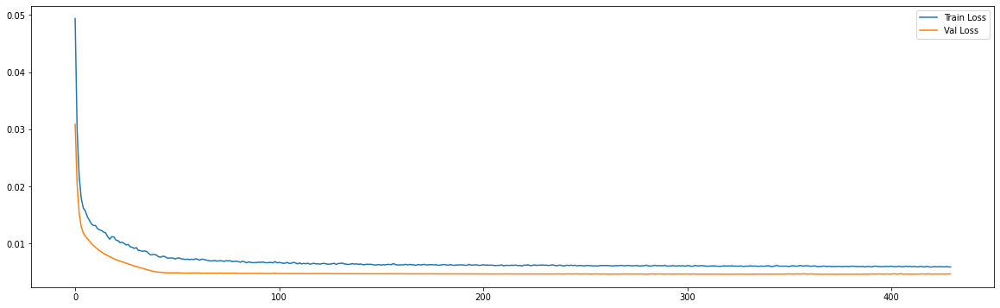

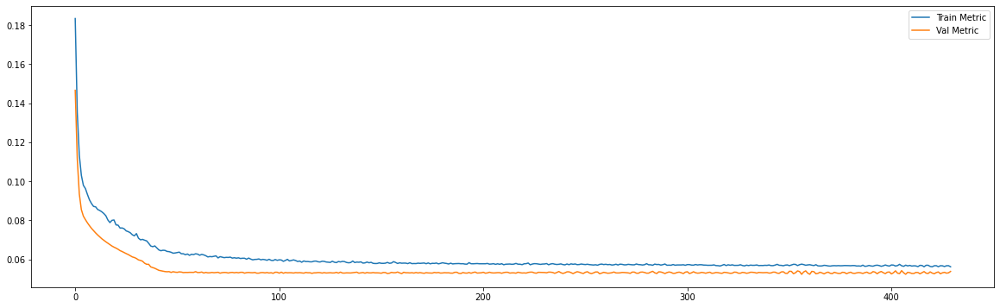

Epoch 00352: early stopping
============================model:5===========================
39/39 [==============================] - 0s 5ms/step - loss: 0.0058 - mae: 0.0568
loss and metric train data [0.00581497373059392, 0.05677591264247894]
7/7 [==============================] - 0s 5ms/step - loss: 0.0047 - mae: 0.0538
loss and metric val data [0.0046601491048932076, 0.05383796617388725]
7/7 [==============================] - 0s 5ms/step - loss: 0.0076 - mae: 0.0671
loss and metric test data [0.007590613793581724, 0.06706645339727402]


'neurons': 20, 'dropout': 0.2, 'time_steps': 120, 'batch_size':120, 'hidden_layers':2




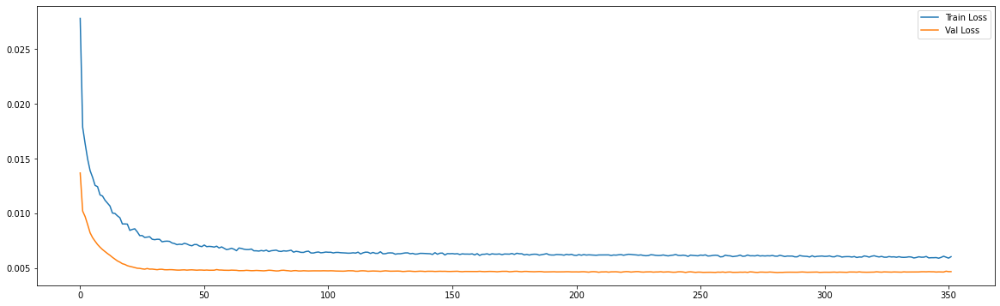

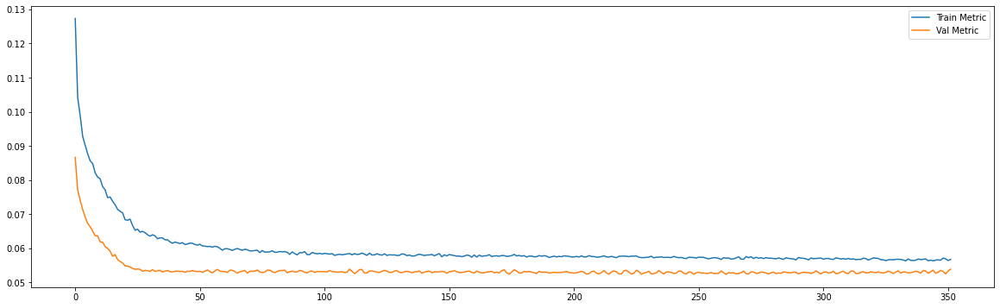

============================model:6===========================
32/32 [==============================] - 0s 5ms/step - loss: 0.0068 - mae: 0.0609
loss and metric train data [0.006835493259131908, 0.06088988855481148]
3/3 [==============================] - 0s 4ms/step - loss: 0.0070 - mae: 0.0659
loss and metric val data [0.0069514731876552105, 0.06589747965335846]
3/3 [==============================] - 0s 4ms/step - loss: 0.0140 - mae: 0.0925
loss and metric test data [0.01399343740195036, 0.09252363443374634]


'neurons': 20, 'dropout': 0.2, 'time_steps': 240, 'batch_size':240, 'learning_rate':0.001, 'hidden_layers':1




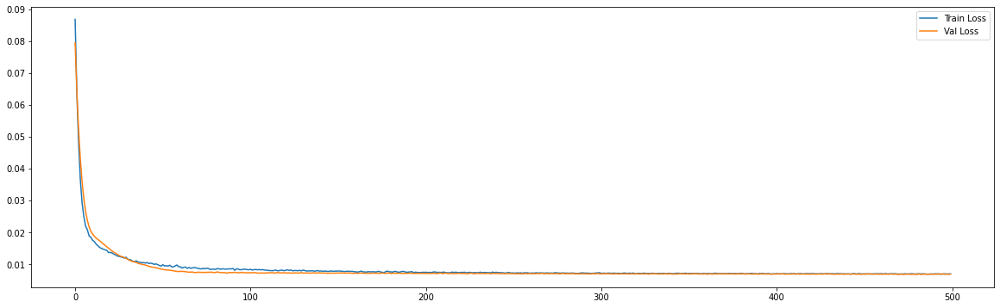

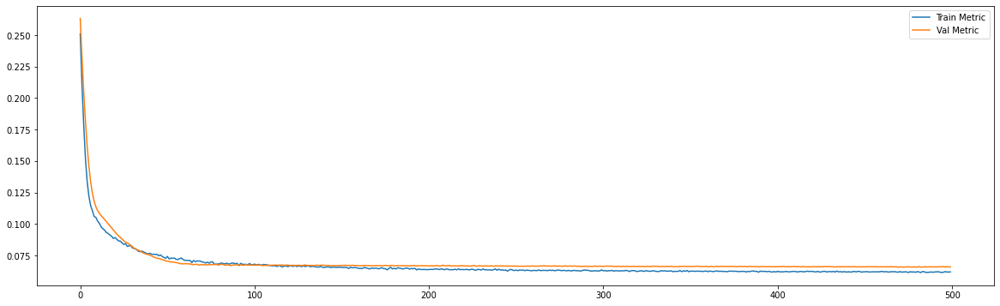

============================model:7===========================
32/32 [==============================] - 0s 9ms/step - loss: 0.0068 - mae: 0.0613
loss and metric train data [0.00683717243373394, 0.06127019599080086]
3/3 [==============================] - 0s 7ms/step - loss: 0.0068 - mae: 0.0653
loss and metric val data [0.006775957997888327, 0.0653195008635521]
3/3 [==============================] - 0s 6ms/step - loss: 0.0139 - mae: 0.0921
loss and metric test data [0.01386122964322567, 0.09211666882038116]


'neurons': 20, 'dropout': 0.2, 'time_steps': 240, 'batch_size':240, 'hidden_layers':2




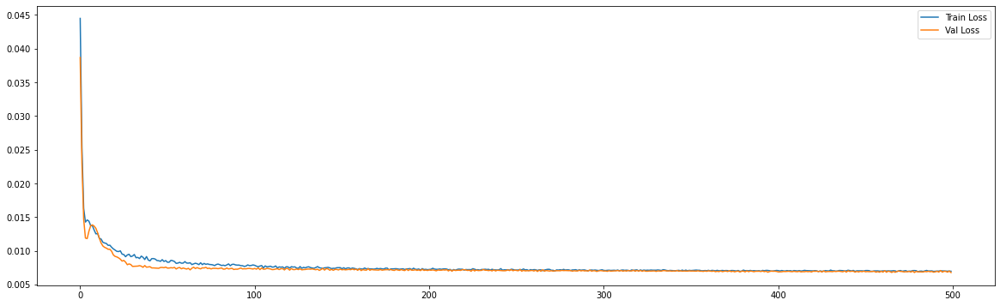

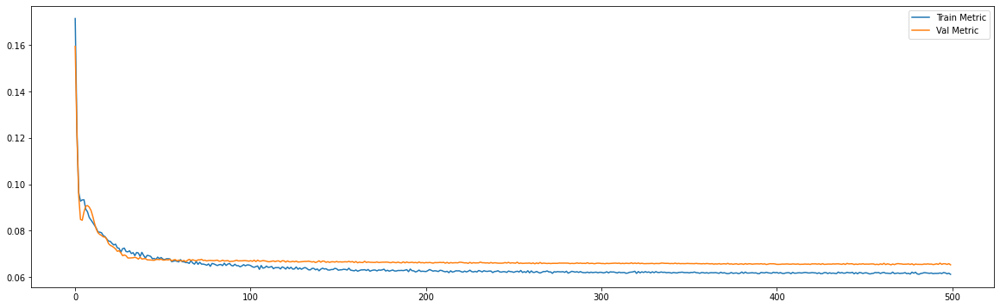

Epoch 00434: early stopping
============================model:8===========================
45/45 [==============================] - 0s 3ms/step - loss: 0.0053 - mae: 0.0545
loss and metric train data [0.005266416352242231, 0.05445774272084236]
9/9 [==============================] - 0s 3ms/step - loss: 0.0052 - mae: 0.0558
loss and metric val data [0.005150027573108673, 0.0558302067220211]
9/9 [==============================] - 0s 2ms/step - loss: 0.0058 - mae: 0.0556
loss and metric test data [0.005840047262609005, 0.055609624832868576]


'neurons': 20, 'dropout': 0.4, 'time_steps': 30, 'batch_size':30, 'learning_rate':0.001, 'hidden_layers':1




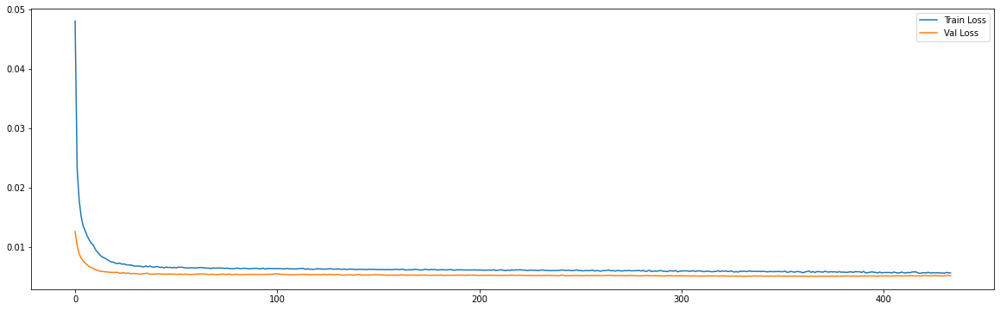

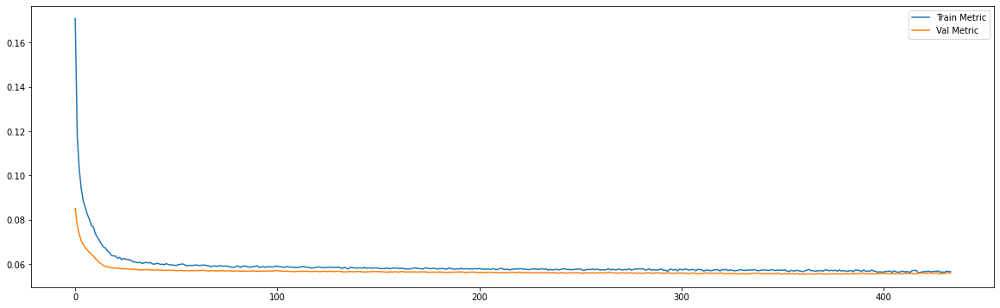

Epoch 00372: early stopping
============================model:9===========================
45/45 [==============================] - 0s 3ms/step - loss: 0.0054 - mae: 0.0545
loss and metric train data [0.005415886640548706, 0.05450864136219025]
9/9 [==============================] - 0s 3ms/step - loss: 0.0051 - mae: 0.0560
loss and metric val data [0.005126564763486385, 0.05595923960208893]
9/9 [==============================] - 0s 3ms/step - loss: 0.0058 - mae: 0.0564
loss and metric test data [0.0057714530266821384, 0.05640488862991333]


'neurons': 20, 'dropout': 0.4, 'time_steps': 30, 'batch_size':30, 'hidden_layers':2




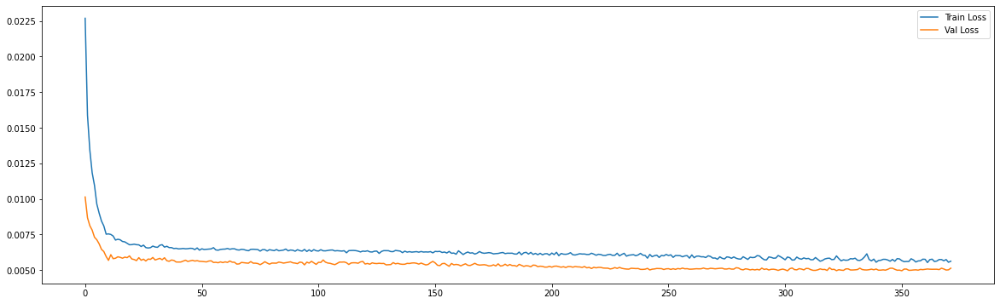

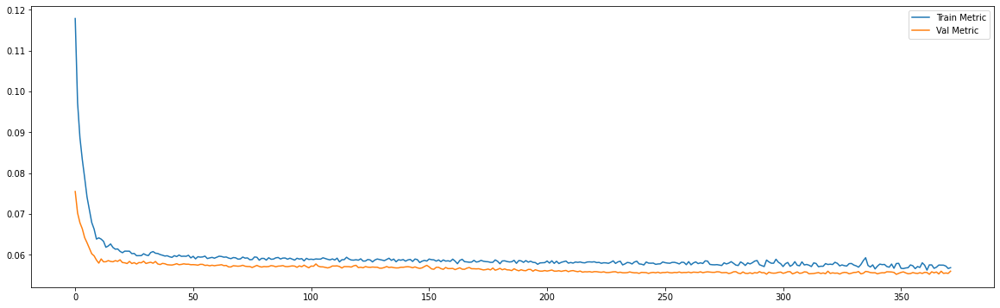

Epoch 00331: early stopping
============================model:10===========================
43/43 [==============================] - 0s 3ms/step - loss: 0.0057 - mae: 0.0561
loss and metric train data [0.005716706160455942, 0.056092970073223114]
8/8 [==============================] - 0s 3ms/step - loss: 0.0049 - mae: 0.0552
loss and metric val data [0.004882526583969593, 0.05519450083374977]
8/8 [==============================] - 0s 2ms/step - loss: 0.0066 - mae: 0.0626
loss and metric test data [0.00663128774613142, 0.06259699165821075]


'neurons': 20, 'dropout': 0.4, 'time_steps': 60, 'batch_size':60, 'learning_rate':0.001, 'hidden_layers':1




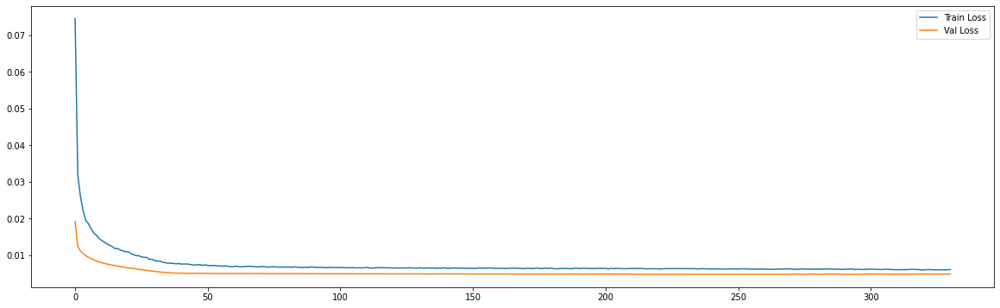

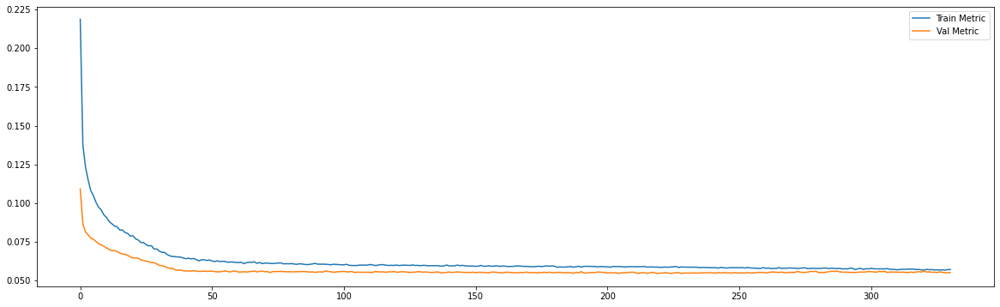

Epoch 00255: early stopping
============================model:11===========================
43/43 [==============================] - 0s 4ms/step - loss: 0.0060 - mae: 0.0581
loss and metric train data [0.005990650504827499, 0.058102961629629135]
8/8 [==============================] - 0s 4ms/step - loss: 0.0049 - mae: 0.0562
loss and metric val data [0.004881193861365318, 0.056159745901823044]
8/8 [==============================] - 0s 3ms/step - loss: 0.0066 - mae: 0.0619
loss and metric test data [0.006576393265277147, 0.06193933263421059]


'neurons': 20, 'dropout': 0.4, 'time_steps': 60, 'batch_size':60, 'hidden_layers':2




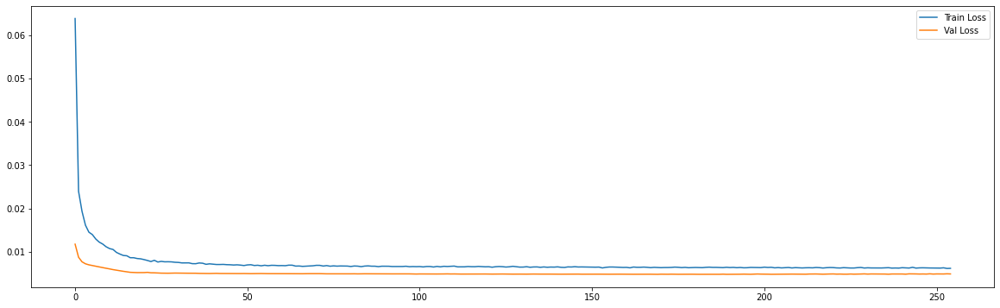

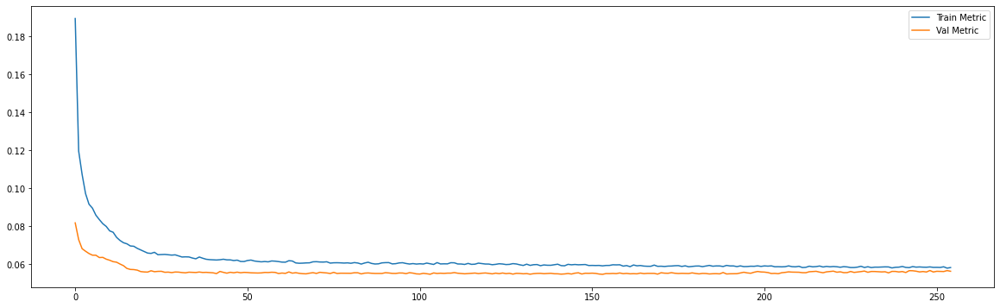

============================model:12===========================
39/39 [==============================] - 0s 3ms/step - loss: 0.0059 - mae: 0.0567
loss and metric train data [0.005942748859524727, 0.05670337378978729]
7/7 [==============================] - 0s 3ms/step - loss: 0.0047 - mae: 0.0535
loss and metric val data [0.0046992735005915165, 0.05347943305969238]
7/7 [==============================] - 0s 3ms/step - loss: 0.0080 - mae: 0.0684
loss and metric test data [0.007960242219269276, 0.068392314016819]


'neurons': 20, 'dropout': 0.4, 'time_steps': 120, 'batch_size':120, 'learning_rate':0.001, 'hidden_layers':1




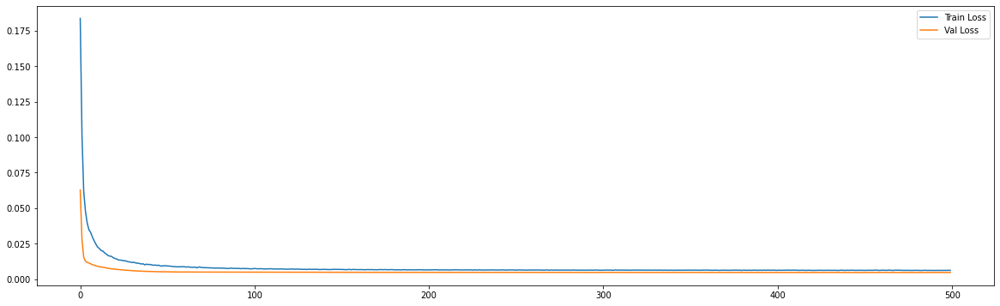

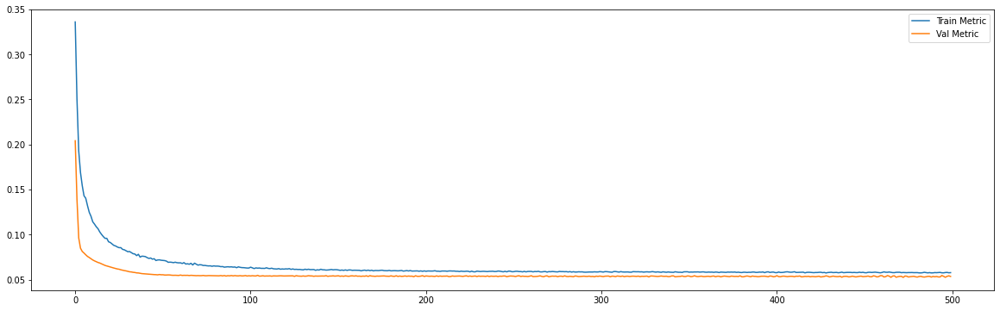

Epoch 00462: early stopping
============================model:13===========================
39/39 [==============================] - 0s 6ms/step - loss: 0.0058 - mae: 0.0560
loss and metric train data [0.0057737031020224094, 0.05604872852563858]
7/7 [==============================] - 0s 5ms/step - loss: 0.0048 - mae: 0.0541
loss and metric val data [0.004769593942910433, 0.054128244519233704]
7/7 [==============================] - 0s 5ms/step - loss: 0.0077 - mae: 0.0671
loss and metric test data [0.007709026336669922, 0.06713612377643585]


'neurons': 20, 'dropout': 0.4, 'time_steps': 120, 'batch_size':120, 'hidden_layers':2




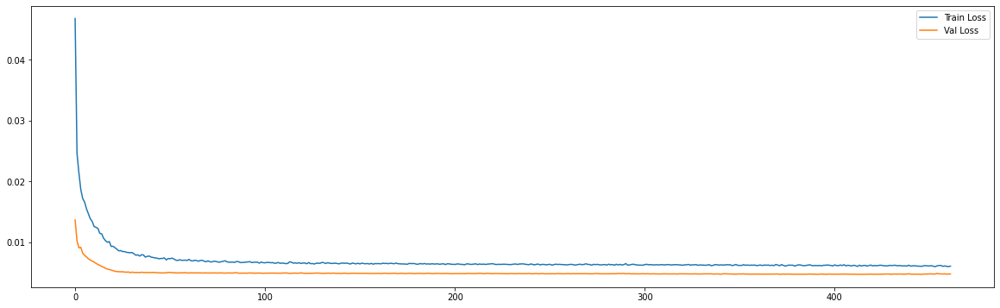

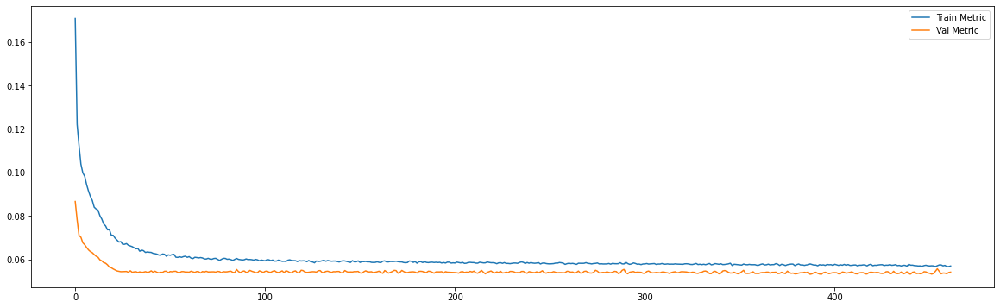

Epoch 00377: early stopping
============================model:14===========================
32/32 [==============================] - 0s 6ms/step - loss: 0.0070 - mae: 0.0613
loss and metric train data [0.006970836315304041, 0.061317525804042816]
3/3 [==============================] - 0s 4ms/step - loss: 0.0073 - mae: 0.0671
loss and metric val data [0.007271918933838606, 0.0670546442270279]
3/3 [==============================] - 0s 4ms/step - loss: 0.0147 - mae: 0.0943
loss and metric test data [0.014722712337970734, 0.09433656930923462]


'neurons': 20, 'dropout': 0.4, 'time_steps': 240, 'batch_size':240, 'learning_rate':0.001, 'hidden_layers':1




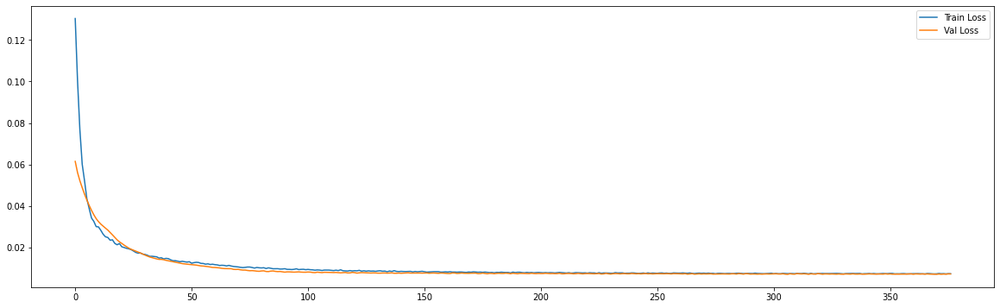

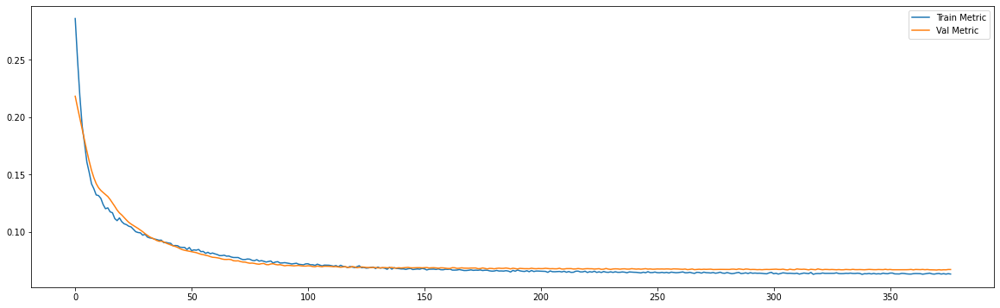

============================model:15===========================
32/32 [==============================] - 0s 9ms/step - loss: 0.0069 - mae: 0.0609
loss and metric train data [0.006888032425194979, 0.06094362959265709]
3/3 [==============================] - 0s 7ms/step - loss: 0.0070 - mae: 0.0663
loss and metric val data [0.0070337471552193165, 0.06625480949878693]
3/3 [==============================] - 0s 6ms/step - loss: 0.0141 - mae: 0.0922
loss and metric test data [0.014080055058002472, 0.09224889427423477]


'neurons': 20, 'dropout': 0.4, 'time_steps': 240, 'batch_size':240, 'hidden_layers':2




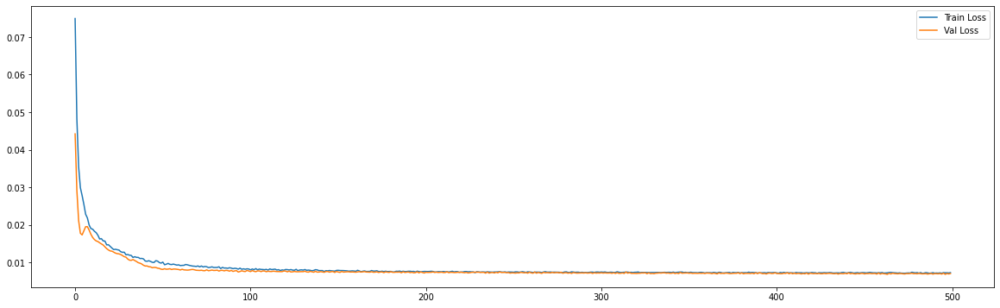

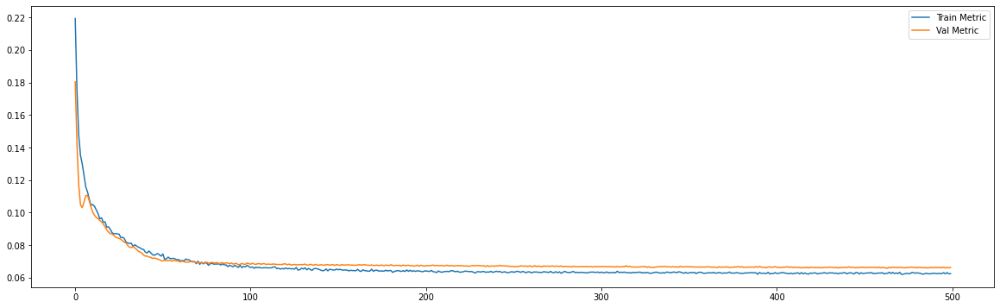

Epoch 00346: early stopping
============================model:16===========================
45/45 [==============================] - 0s 3ms/step - loss: 0.0051 - mae: 0.0539
loss and metric train data [0.005142141133546829, 0.05393848195672035]
9/9 [==============================] - 0s 2ms/step - loss: 0.0050 - mae: 0.0548
loss and metric val data [0.005019456148147583, 0.05480111017823219]
9/9 [==============================] - 0s 2ms/step - loss: 0.0060 - mae: 0.0568
loss and metric test data [0.005969066172838211, 0.05679863318800926]


'neurons': 25, 'dropout': 0.2, 'time_steps': 30, 'batch_size':30, 'learning_rate':0.001, 'hidden_layers':1




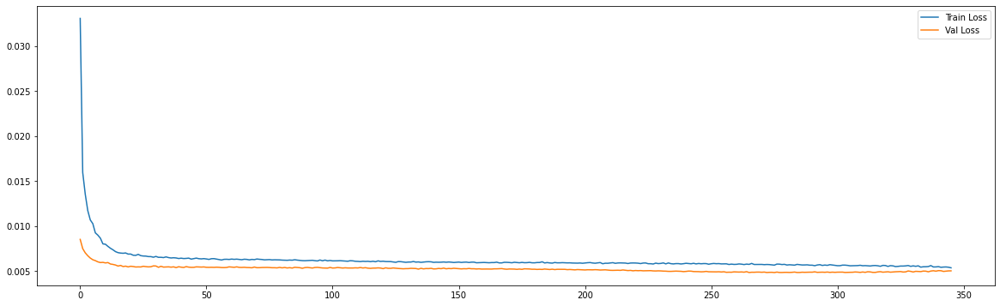

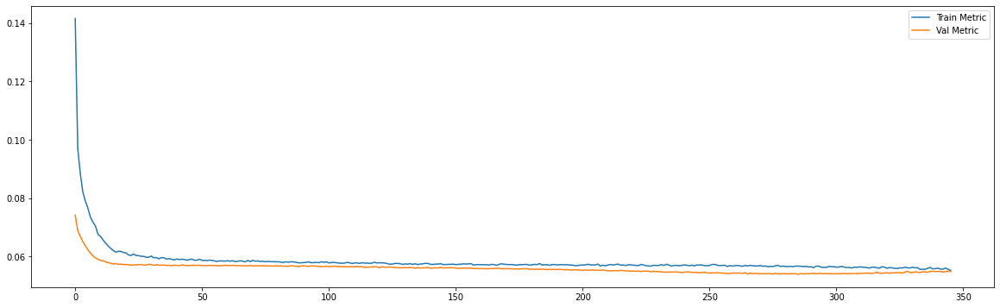

Epoch 00263: early stopping
============================model:17===========================
45/45 [==============================] - 0s 3ms/step - loss: 0.0049 - mae: 0.0533
loss and metric train data [0.004913791082799435, 0.05334512144327164]
9/9 [==============================] - 0s 3ms/step - loss: 0.0051 - mae: 0.0553
loss and metric val data [0.005052110645920038, 0.055286820977926254]
9/9 [==============================] - 0s 3ms/step - loss: 0.0054 - mae: 0.0542
loss and metric test data [0.005432377569377422, 0.0542326495051384]


'neurons': 25, 'dropout': 0.2, 'time_steps': 30, 'batch_size':30, 'hidden_layers':2




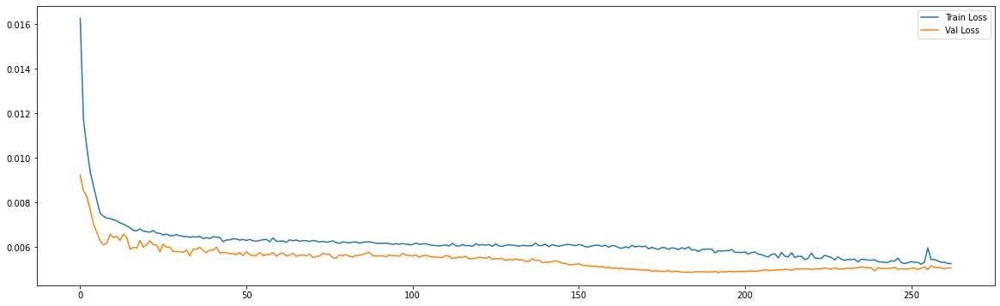

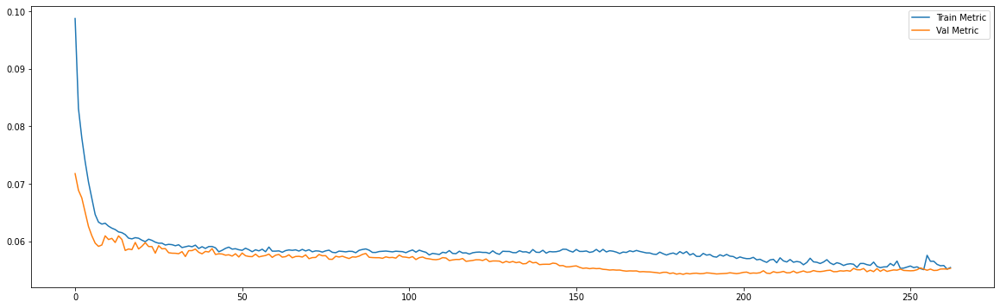

Epoch 00220: early stopping
============================model:18===========================
43/43 [==============================] - 0s 3ms/step - loss: 0.0059 - mae: 0.0574
loss and metric train data [0.005863323342055082, 0.057400912046432495]
8/8 [==============================] - 0s 3ms/step - loss: 0.0048 - mae: 0.0552
loss and metric val data [0.004829398822039366, 0.05520721524953842]
8/8 [==============================] - 0s 2ms/step - loss: 0.0065 - mae: 0.0614
loss and metric test data [0.006464886479079723, 0.06136319041252136]


'neurons': 25, 'dropout': 0.2, 'time_steps': 60, 'batch_size':60, 'learning_rate':0.001, 'hidden_layers':1




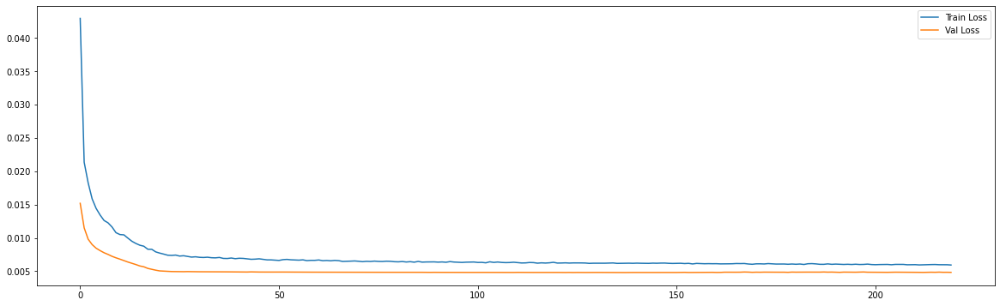

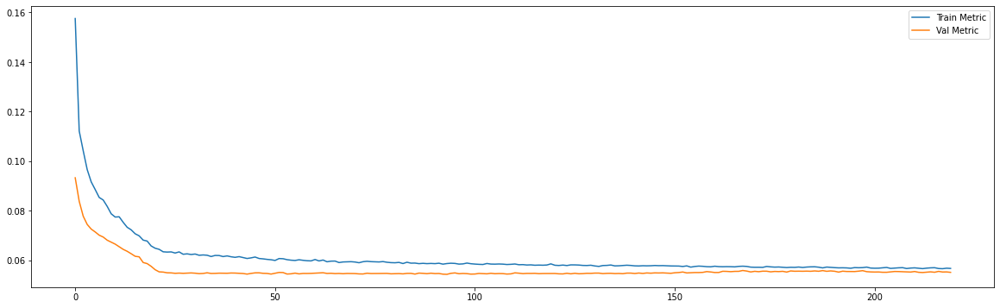

Epoch 00189: early stopping
============================model:19===========================
43/43 [==============================] - 0s 4ms/step - loss: 0.0057 - mae: 0.0574
loss and metric train data [0.005709770601242781, 0.05739959329366684]
8/8 [==============================] - 0s 4ms/step - loss: 0.0049 - mae: 0.0557
loss and metric val data [0.004854502156376839, 0.05566374957561493]
8/8 [==============================] - 0s 3ms/step - loss: 0.0064 - mae: 0.0614
loss and metric test data [0.0063779400661587715, 0.06142129376530647]


'neurons': 25, 'dropout': 0.2, 'time_steps': 60, 'batch_size':60, 'hidden_layers':2




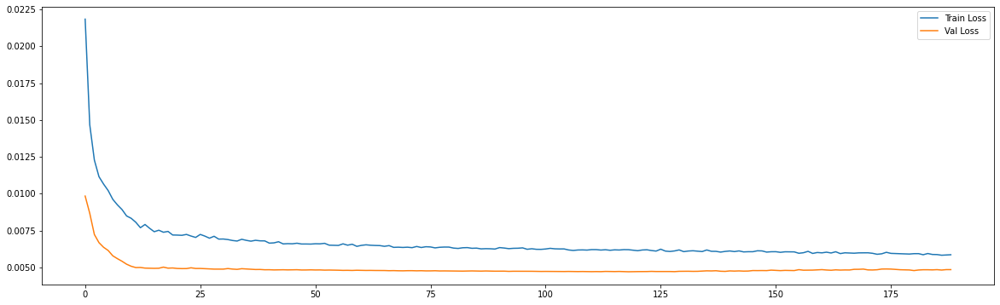

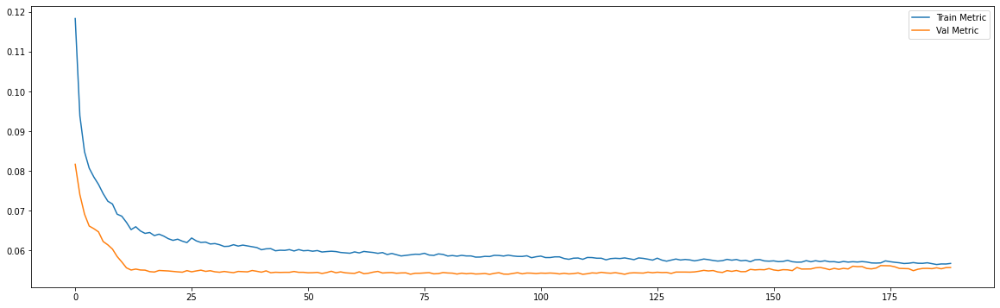

Epoch 00455: early stopping
============================model:20===========================
39/39 [==============================] - 0s 4ms/step - loss: 0.0057 - mae: 0.0560
loss and metric train data [0.005672444589436054, 0.05601860210299492]
7/7 [==============================] - 0s 3ms/step - loss: 0.0047 - mae: 0.0539
loss and metric val data [0.004713843576610088, 0.05387381091713905]
7/7 [==============================] - 0s 3ms/step - loss: 0.0076 - mae: 0.0672
loss and metric test data [0.0075554437935352325, 0.0672290176153183]


'neurons': 25, 'dropout': 0.2, 'time_steps': 120, 'batch_size':120, 'learning_rate':0.001, 'hidden_layers':1




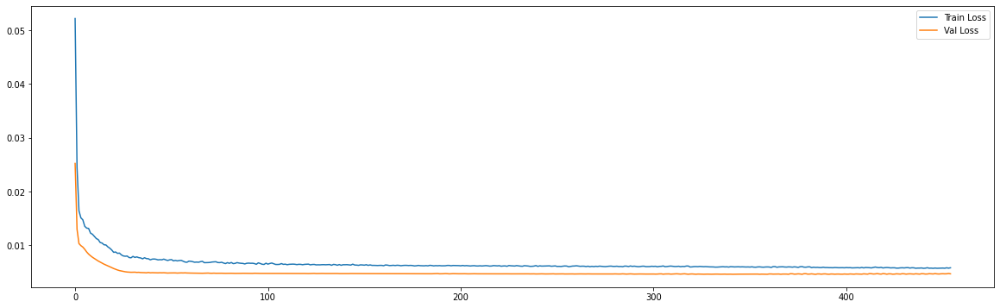

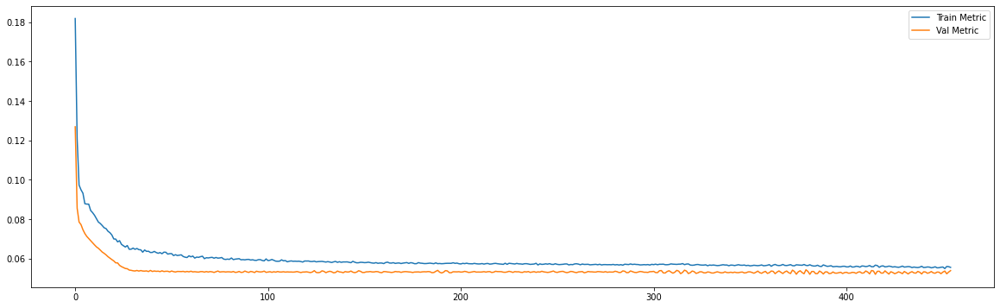

Epoch 00340: early stopping
============================model:21===========================
39/39 [==============================] - 0s 5ms/step - loss: 0.0058 - mae: 0.0565
loss and metric train data [0.005765113979578018, 0.05653715133666992]
7/7 [==============================] - 0s 5ms/step - loss: 0.0047 - mae: 0.0536
loss and metric val data [0.0046902853064239025, 0.05355377495288849]
7/7 [==============================] - 0s 5ms/step - loss: 0.0075 - mae: 0.0668
loss and metric test data [0.007540185935795307, 0.06678151339292526]


'neurons': 25, 'dropout': 0.2, 'time_steps': 120, 'batch_size':120, 'hidden_layers':2




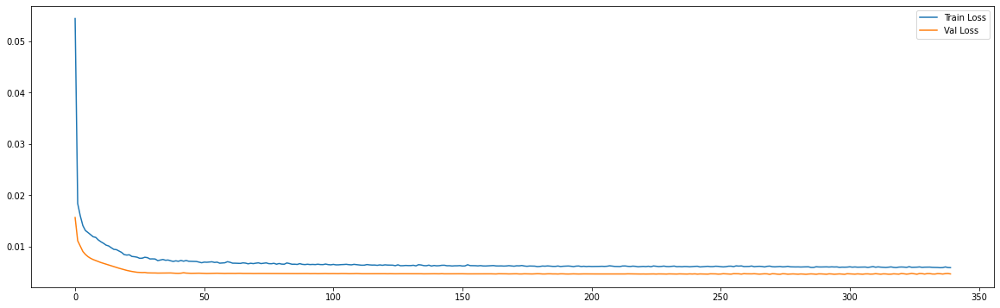

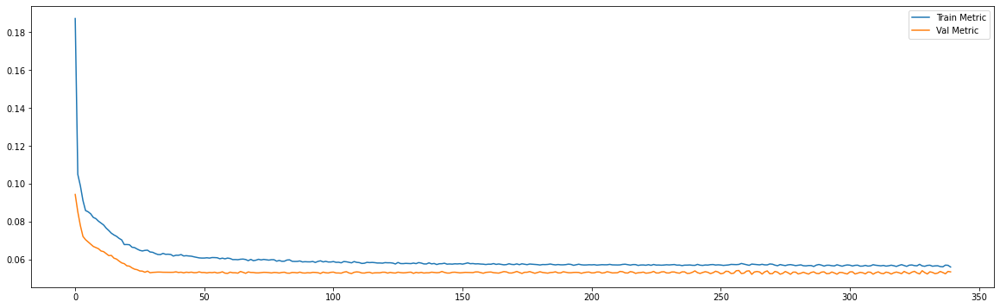

Epoch 00344: early stopping
============================model:22===========================
32/32 [==============================] - 0s 5ms/step - loss: 0.0069 - mae: 0.0613
loss and metric train data [0.00691889226436615, 0.06126291677355766]
3/3 [==============================] - 0s 4ms/step - loss: 0.0070 - mae: 0.0663
loss and metric val data [0.007045671343803406, 0.06627728790044785]
3/3 [==============================] - 0s 4ms/step - loss: 0.0142 - mae: 0.0920
loss and metric test data [0.014202019199728966, 0.09203553199768066]


'neurons': 25, 'dropout': 0.2, 'time_steps': 240, 'batch_size':240, 'learning_rate':0.001, 'hidden_layers':1




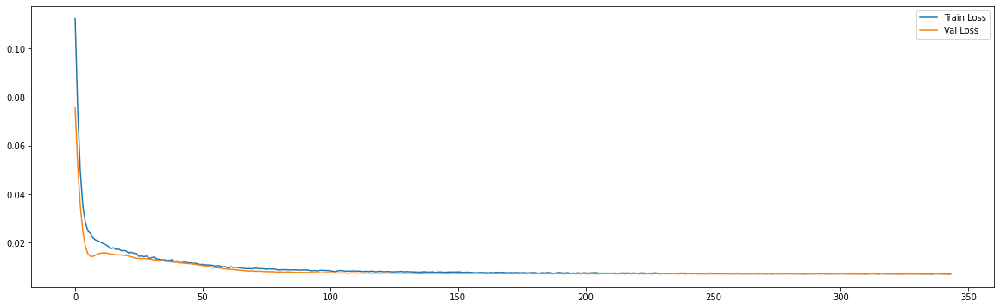

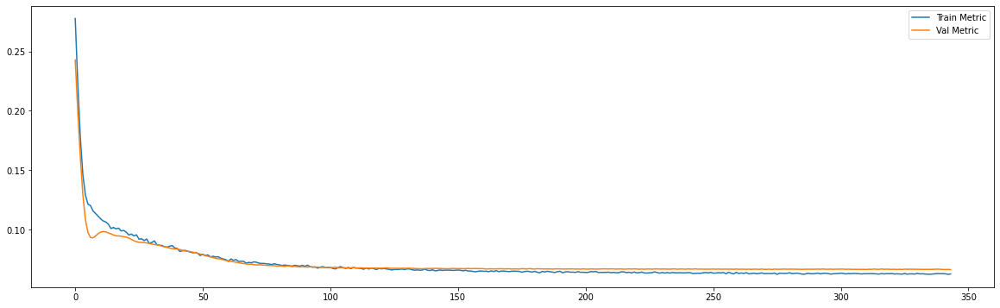

============================model:23===========================
32/32 [==============================] - 0s 9ms/step - loss: 0.0068 - mae: 0.0613
loss and metric train data [0.006808906327933073, 0.06134721264243126]
3/3 [==============================] - 0s 6ms/step - loss: 0.0069 - mae: 0.0660
loss and metric val data [0.006866741459816694, 0.06603033095598221]
3/3 [==============================] - 0s 7ms/step - loss: 0.0137 - mae: 0.0910
loss and metric test data [0.013667039573192596, 0.09100408852100372]


'neurons': 25, 'dropout': 0.2, 'time_steps': 240, 'batch_size':240, 'hidden_layers':2




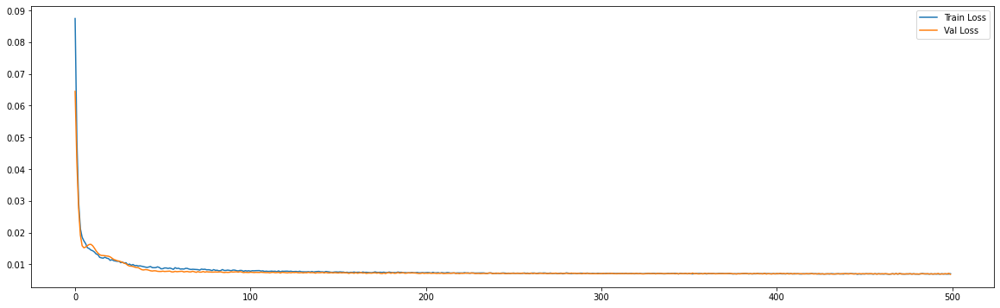

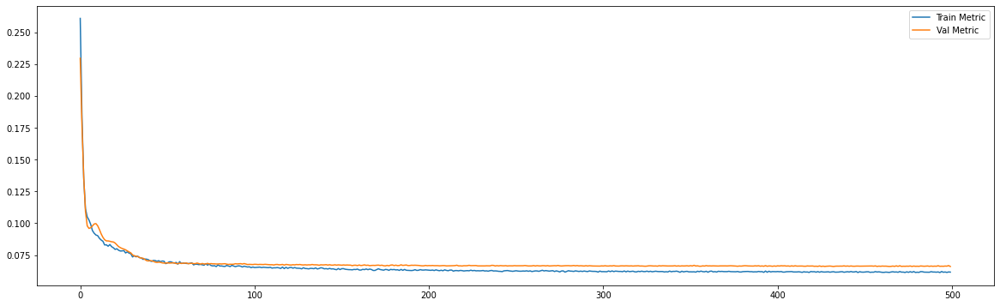

Epoch 00353: early stopping
============================model:24===========================
45/45 [==============================] - 0s 2ms/step - loss: 0.0054 - mae: 0.0552
loss and metric train data [0.005368352867662907, 0.05515444278717041]
9/9 [==============================] - 0s 2ms/step - loss: 0.0051 - mae: 0.0560
loss and metric val data [0.005051984451711178, 0.05603138729929924]
9/9 [==============================] - 0s 2ms/step - loss: 0.0057 - mae: 0.0555
loss and metric test data [0.005706045310944319, 0.05548867583274841]


'neurons': 25, 'dropout': 0.4, 'time_steps': 30, 'batch_size':30, 'learning_rate':0.001, 'hidden_layers':1




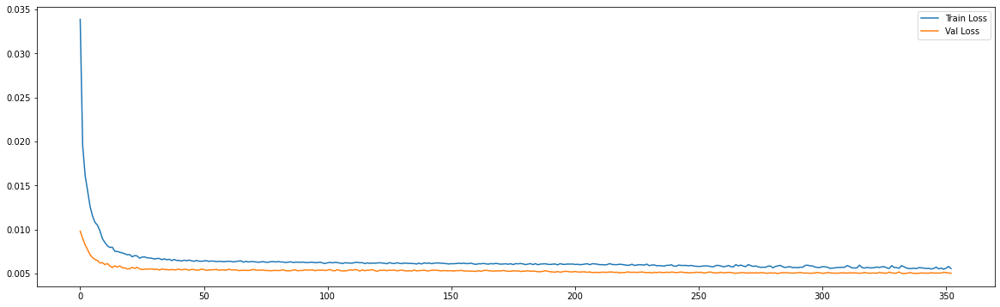

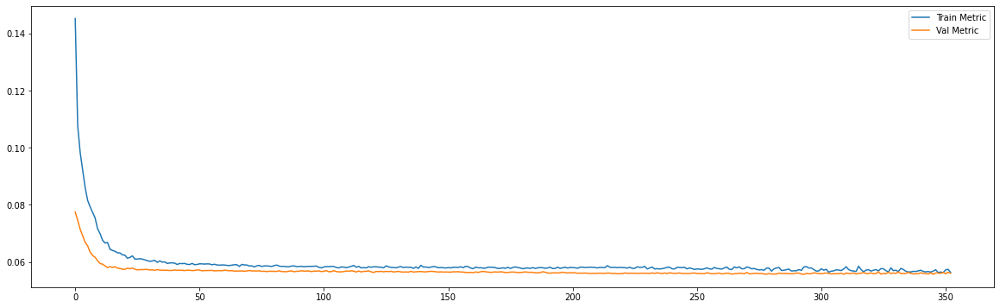

Epoch 00264: early stopping
============================model:25===========================
45/45 [==============================] - 0s 3ms/step - loss: 0.0051 - mae: 0.0539
loss and metric train data [0.005135964602231979, 0.05389648303389549]
9/9 [==============================] - 0s 3ms/step - loss: 0.0053 - mae: 0.0564
loss and metric val data [0.0052526528015732765, 0.05639268457889557]
9/9 [==============================] - 0s 3ms/step - loss: 0.0058 - mae: 0.0555
loss and metric test data [0.005795602686703205, 0.05554988235235214]


'neurons': 25, 'dropout': 0.4, 'time_steps': 30, 'batch_size':30, 'hidden_layers':2




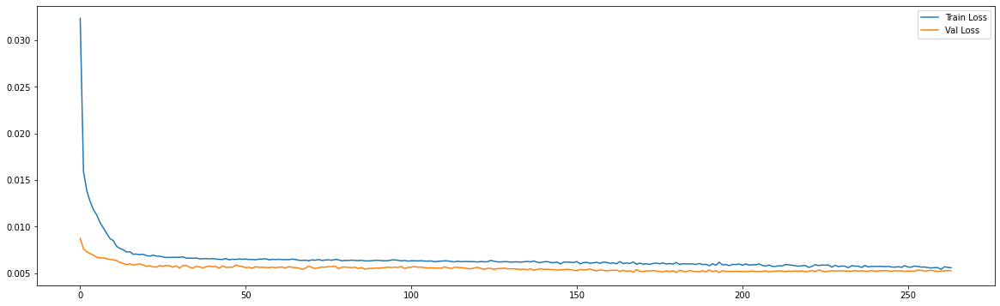

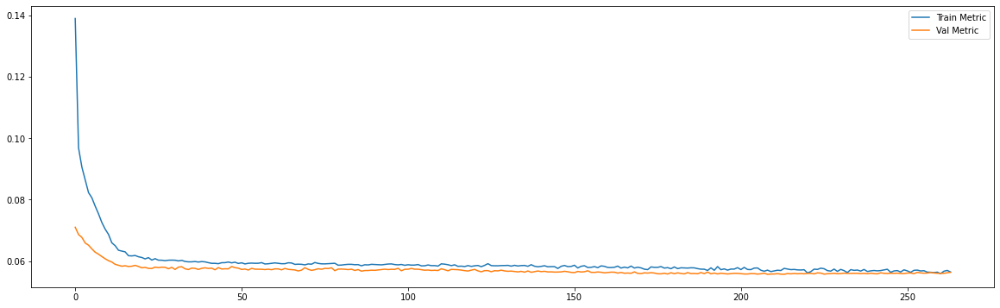

Epoch 00289: early stopping
============================model:26===========================
43/43 [==============================] - 0s 3ms/step - loss: 0.0058 - mae: 0.0570
loss and metric train data [0.005771000403910875, 0.05699902027845383]
8/8 [==============================] - 0s 3ms/step - loss: 0.0049 - mae: 0.0555
loss and metric val data [0.0048527345061302185, 0.05553637817502022]
8/8 [==============================] - 0s 3ms/step - loss: 0.0065 - mae: 0.0622
loss and metric test data [0.006544225849211216, 0.06217244639992714]


'neurons': 25, 'dropout': 0.4, 'time_steps': 60, 'batch_size':60, 'learning_rate':0.001, 'hidden_layers':1




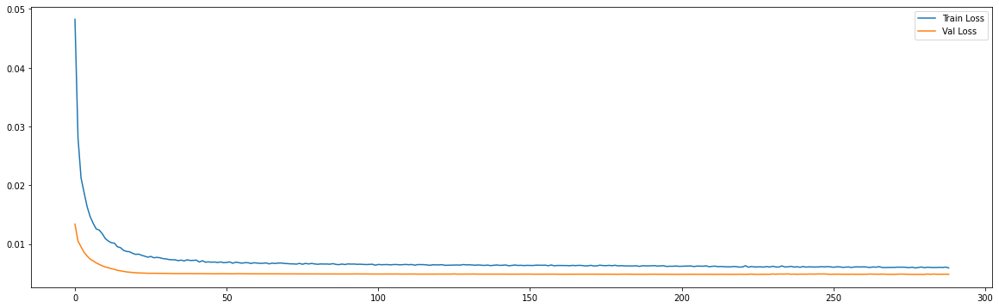

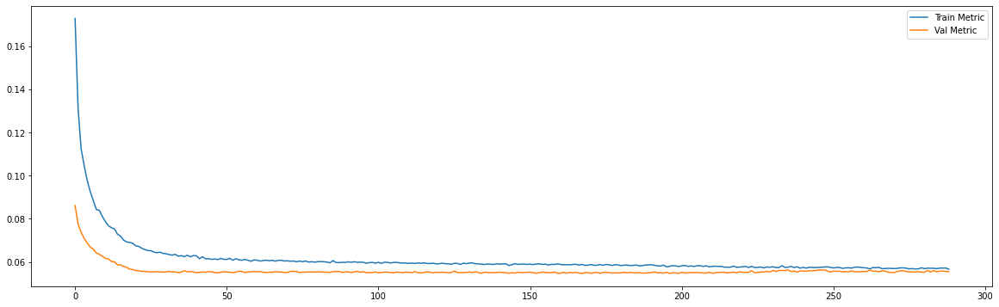

Epoch 00223: early stopping
============================model:27===========================
43/43 [==============================] - 0s 4ms/step - loss: 0.0058 - mae: 0.0571
loss and metric train data [0.005791191477328539, 0.057071201503276825]
8/8 [==============================] - 0s 4ms/step - loss: 0.0049 - mae: 0.0558
loss and metric val data [0.0049036843702197075, 0.055790916085243225]
8/8 [==============================] - 0s 4ms/step - loss: 0.0065 - mae: 0.0618
loss and metric test data [0.006522032897919416, 0.06179092824459076]


'neurons': 25, 'dropout': 0.4, 'time_steps': 60, 'batch_size':60, 'hidden_layers':2




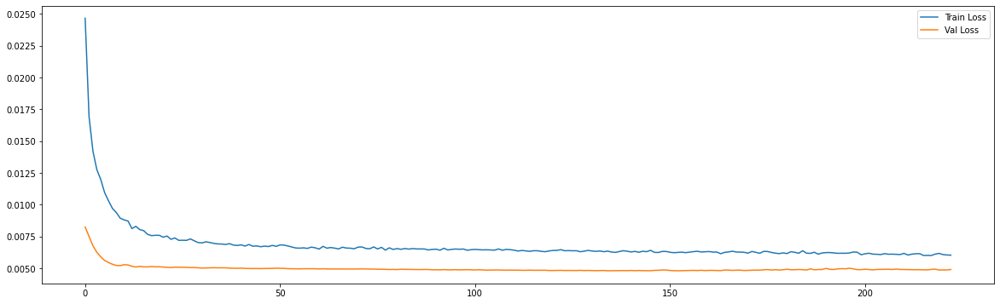

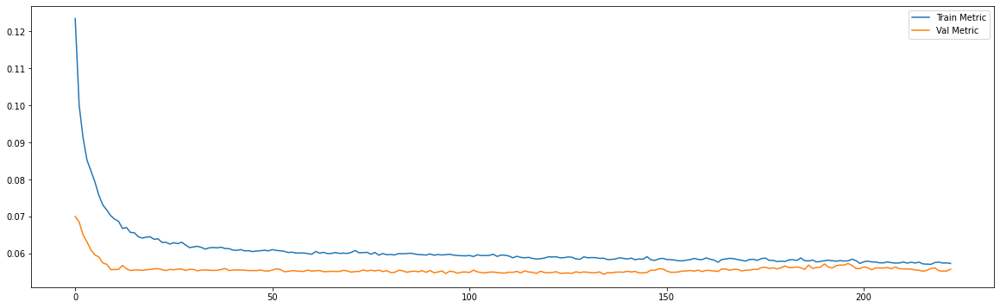

============================model:28===========================
39/39 [==============================] - 0s 4ms/step - loss: 0.0058 - mae: 0.0554
loss and metric train data [0.005820287857204676, 0.05539274960756302]
7/7 [==============================] - 0s 3ms/step - loss: 0.0048 - mae: 0.0533
loss and metric val data [0.004826911725103855, 0.05329803004860878]
7/7 [==============================] - 0s 3ms/step - loss: 0.0079 - mae: 0.0676
loss and metric test data [0.007901309058070183, 0.06764107197523117]


'neurons': 25, 'dropout': 0.4, 'time_steps': 120, 'batch_size':120, 'learning_rate':0.001, 'hidden_layers':1




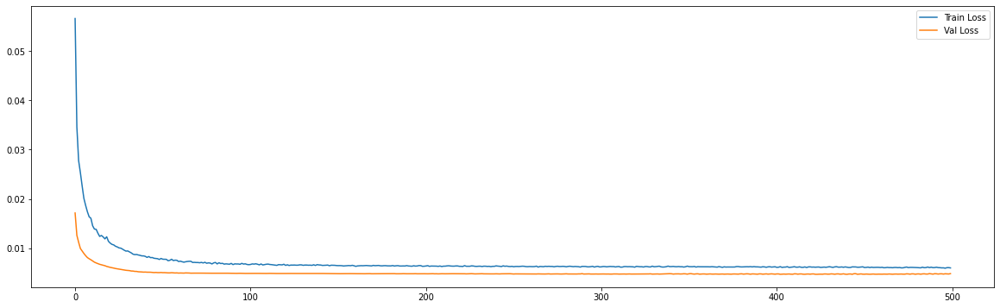

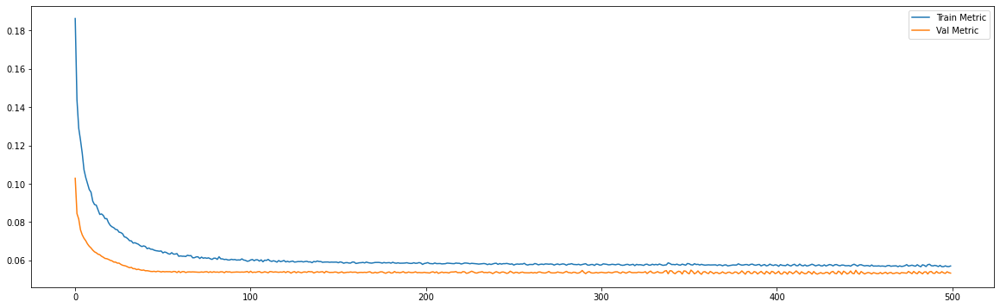

Epoch 00422: early stopping
============================model:29===========================
39/39 [==============================] - 0s 6ms/step - loss: 0.0057 - mae: 0.0555
loss and metric train data [0.005743882618844509, 0.055544327944517136]
7/7 [==============================] - 0s 5ms/step - loss: 0.0047 - mae: 0.0531
loss and metric val data [0.004675128031522036, 0.053073182702064514]
7/7 [==============================] - 0s 5ms/step - loss: 0.0077 - mae: 0.0669
loss and metric test data [0.007692073006182909, 0.06685073673725128]


'neurons': 25, 'dropout': 0.4, 'time_steps': 120, 'batch_size':120, 'hidden_layers':2




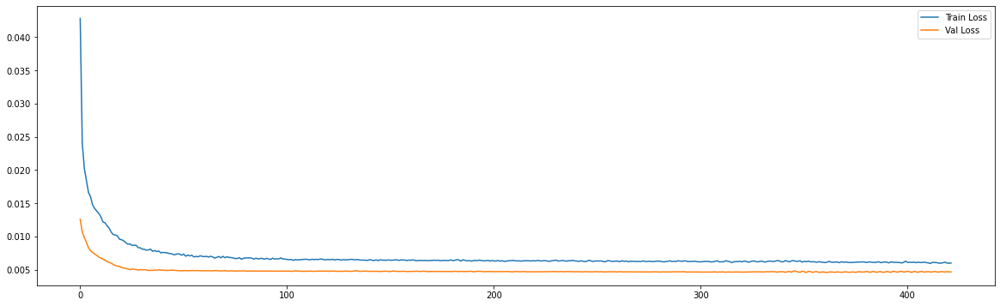

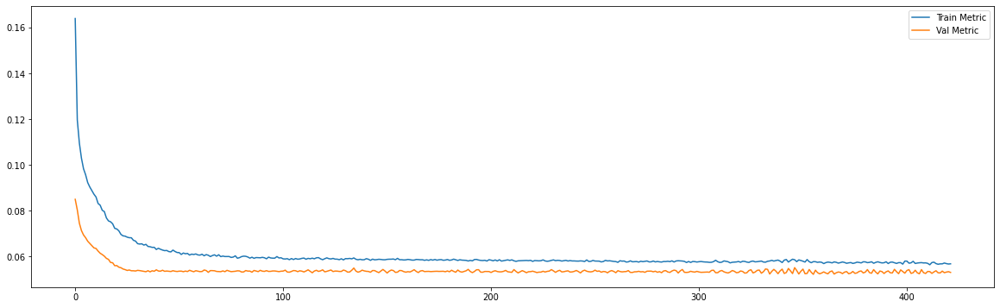

============================model:30===========================
32/32 [==============================] - 0s 5ms/step - loss: 0.0069 - mae: 0.0613
loss and metric train data [0.006895352620631456, 0.061262041330337524]
3/3 [==============================] - 0s 4ms/step - loss: 0.0070 - mae: 0.0659
loss and metric val data [0.006956794764846563, 0.06592892110347748]
3/3 [==============================] - 0s 4ms/step - loss: 0.0141 - mae: 0.0920
loss and metric test data [0.014063438400626183, 0.09195344150066376]


'neurons': 25, 'dropout': 0.4, 'time_steps': 240, 'batch_size':240, 'learning_rate':0.001, 'hidden_layers':1




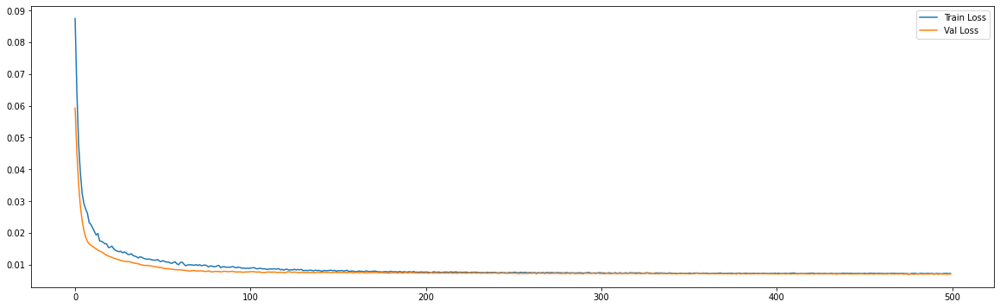

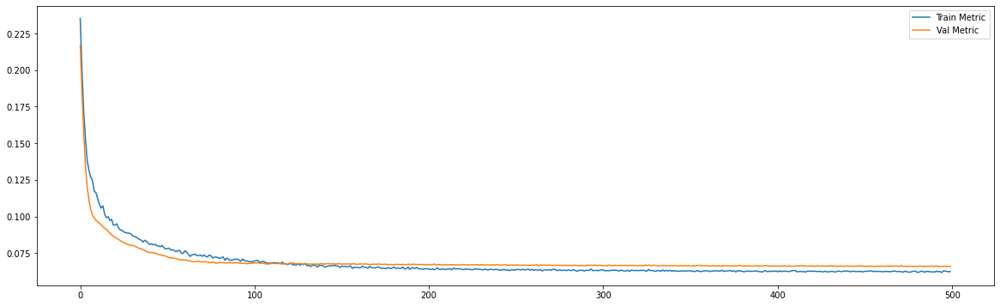

============================model:31===========================
32/32 [==============================] - 0s 9ms/step - loss: 0.0069 - mae: 0.0607
loss and metric train data [0.006928423419594765, 0.060724303126335144]
3/3 [==============================] - 0s 6ms/step - loss: 0.0072 - mae: 0.0667
loss and metric val data [0.007231385912746191, 0.06667043268680573]
3/3 [==============================] - 0s 6ms/step - loss: 0.0143 - mae: 0.0936
loss and metric test data [0.01429024152457714, 0.09363263845443726]


'neurons': 25, 'dropout': 0.4, 'time_steps': 240, 'batch_size':240, 'hidden_layers':2




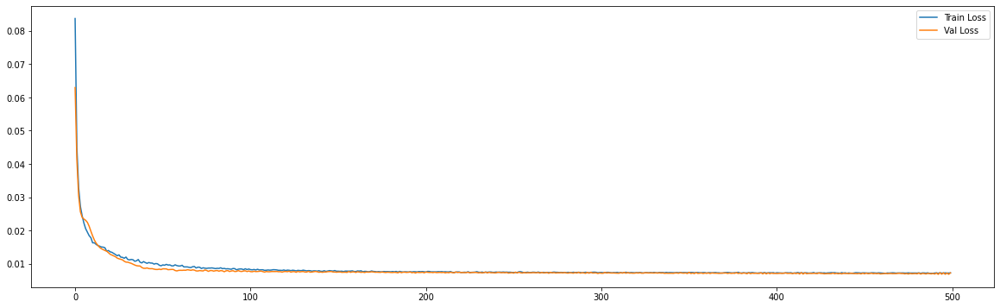

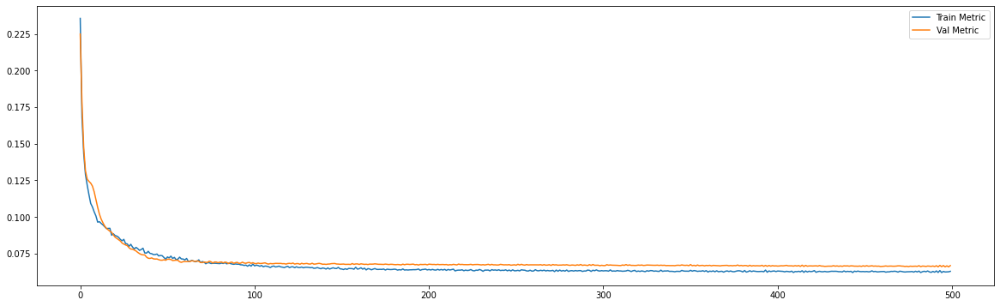

Epoch 00120: early stopping
============================model:32===========================
45/45 [==============================] - 0s 3ms/step - loss: 0.0061 - mae: 0.0563
loss and metric train data [0.006124560721218586, 0.05629393085837364]
9/9 [==============================] - 0s 2ms/step - loss: 0.0054 - mae: 0.0565
loss and metric val data [0.005407491698861122, 0.05648331716656685]
9/9 [==============================] - 0s 2ms/step - loss: 0.0062 - mae: 0.0567
loss and metric test data [0.006187201477587223, 0.0566658079624176]


'neurons': 30, 'dropout': 0.2, 'time_steps': 30, 'batch_size':30, 'learning_rate':0.001, 'hidden_layers':1




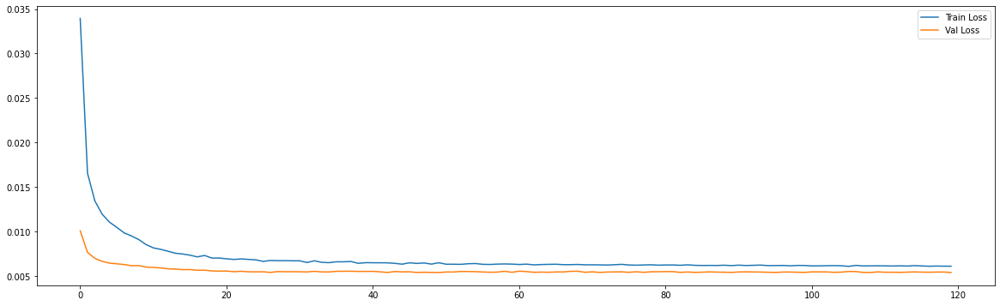

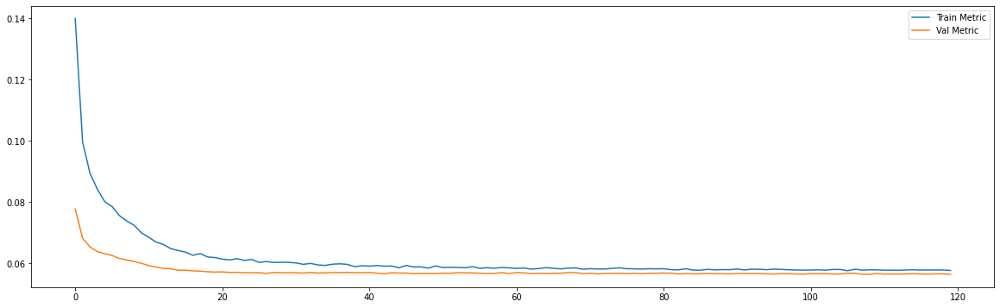

Epoch 00280: early stopping
============================model:33===========================
45/45 [==============================] - 0s 3ms/step - loss: 0.0051 - mae: 0.0542
loss and metric train data [0.005057441536337137, 0.05417165160179138]
9/9 [==============================] - 0s 3ms/step - loss: 0.0050 - mae: 0.0548
loss and metric val data [0.004966085776686668, 0.054752614349126816]
9/9 [==============================] - 0s 3ms/step - loss: 0.0060 - mae: 0.0560
loss and metric test data [0.00596429780125618, 0.05598166957497597]


'neurons': 30, 'dropout': 0.2, 'time_steps': 30, 'batch_size':30, 'hidden_layers':2




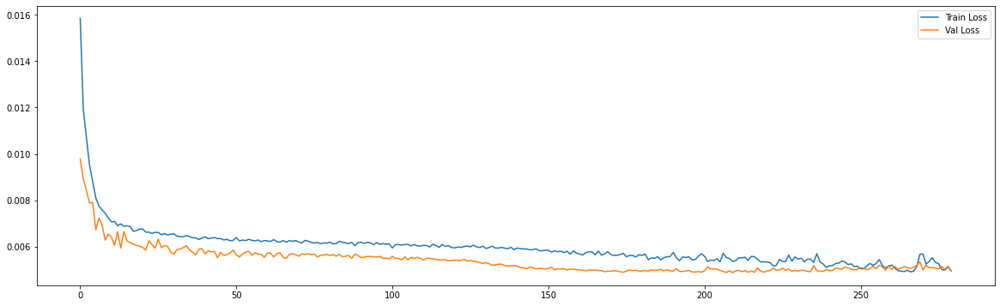

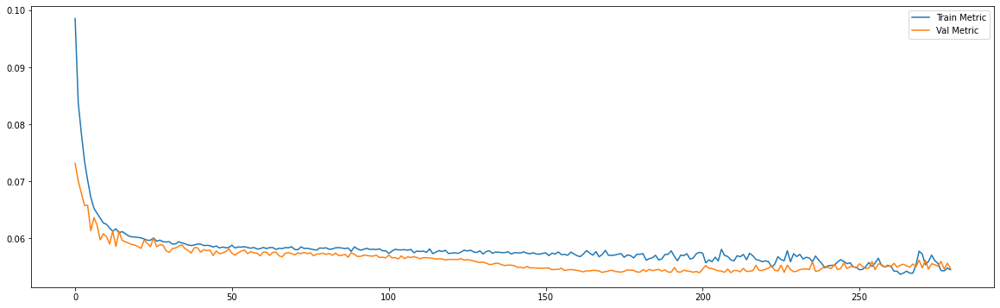

Epoch 00232: early stopping
============================model:34===========================
43/43 [==============================] - 0s 3ms/step - loss: 0.0058 - mae: 0.0569
loss and metric train data [0.0057917810045182705, 0.05691993236541748]
8/8 [==============================] - 0s 3ms/step - loss: 0.0048 - mae: 0.0549
loss and metric val data [0.0047931969165802, 0.05487457290291786]
8/8 [==============================] - 0s 3ms/step - loss: 0.0065 - mae: 0.0613
loss and metric test data [0.006461856886744499, 0.06128712743520737]


'neurons': 30, 'dropout': 0.2, 'time_steps': 60, 'batch_size':60, 'learning_rate':0.001, 'hidden_layers':1




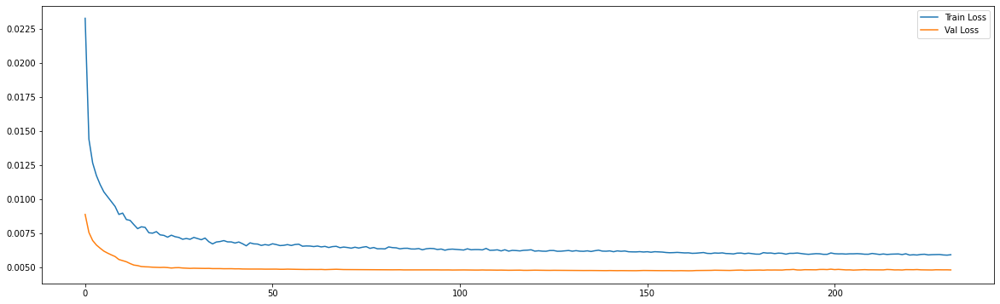

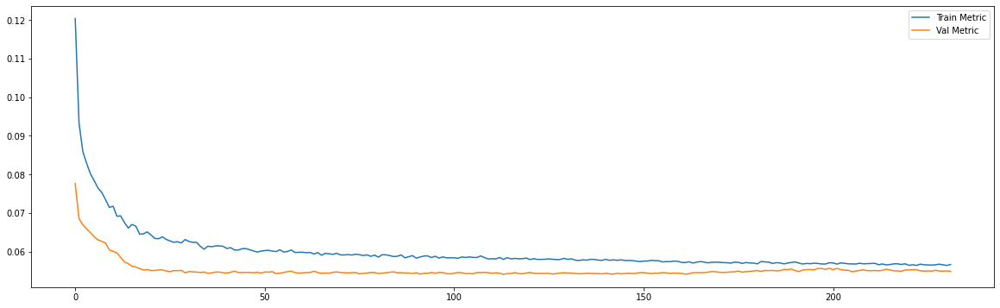

Epoch 00173: early stopping
============================model:35===========================
43/43 [==============================] - 0s 4ms/step - loss: 0.0058 - mae: 0.0578
loss and metric train data [0.005826118867844343, 0.057802073657512665]
8/8 [==============================] - 0s 4ms/step - loss: 0.0049 - mae: 0.0562
loss and metric val data [0.0049209753051400185, 0.05615026503801346]
8/8 [==============================] - 0s 4ms/step - loss: 0.0065 - mae: 0.0619
loss and metric test data [0.006468558683991432, 0.061933521181344986]


'neurons': 30, 'dropout': 0.2, 'time_steps': 60, 'batch_size':60, 'hidden_layers':2




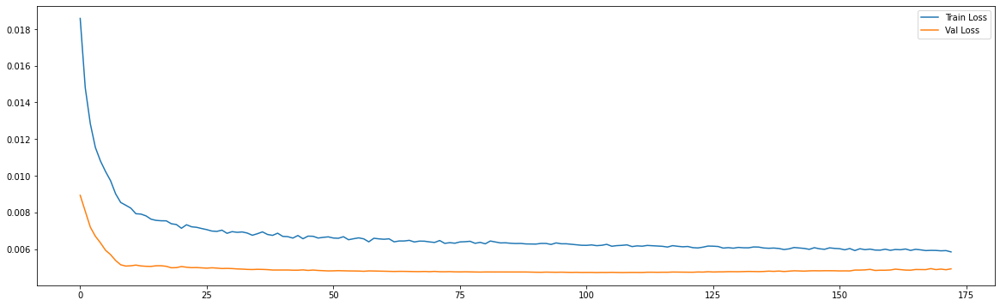

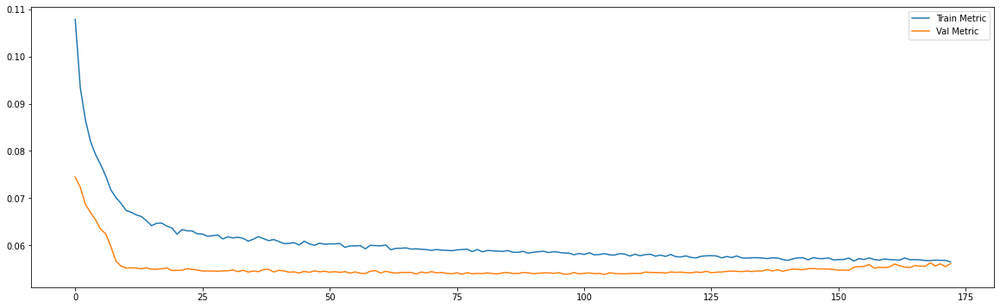

Epoch 00439: early stopping
============================model:36===========================
39/39 [==============================] - 0s 4ms/step - loss: 0.0057 - mae: 0.0557
loss and metric train data [0.00566868344321847, 0.05572602525353432]
7/7 [==============================] - 0s 3ms/step - loss: 0.0046 - mae: 0.0529
loss and metric val data [0.00462071830406785, 0.05293845012784004]
7/7 [==============================] - 0s 3ms/step - loss: 0.0076 - mae: 0.0670
loss and metric test data [0.007626295555382967, 0.06698981672525406]


'neurons': 30, 'dropout': 0.2, 'time_steps': 120, 'batch_size':120, 'learning_rate':0.001, 'hidden_layers':1




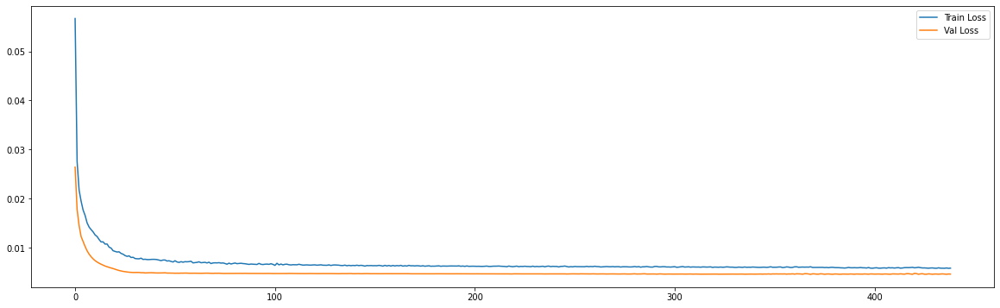

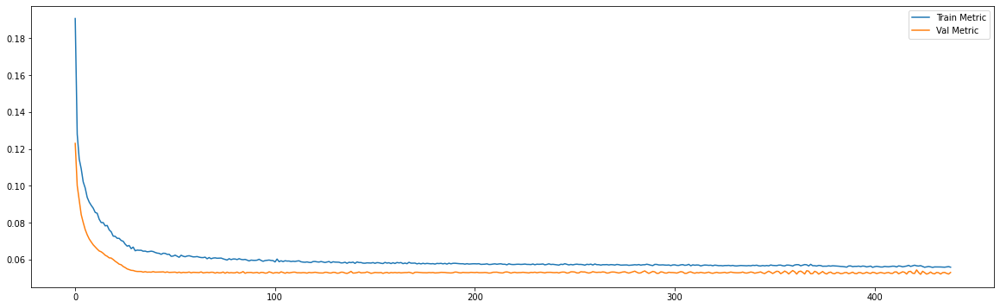

Epoch 00292: early stopping
============================model:37===========================
39/39 [==============================] - 0s 6ms/step - loss: 0.0057 - mae: 0.0554
loss and metric train data [0.005699935834854841, 0.05542084202170372]
7/7 [==============================] - 0s 5ms/step - loss: 0.0047 - mae: 0.0529
loss and metric val data [0.004688308108597994, 0.05291558802127838]
7/7 [==============================] - 0s 5ms/step - loss: 0.0076 - mae: 0.0671
loss and metric test data [0.007604670245200396, 0.06710100919008255]


'neurons': 30, 'dropout': 0.2, 'time_steps': 120, 'batch_size':120, 'hidden_layers':2




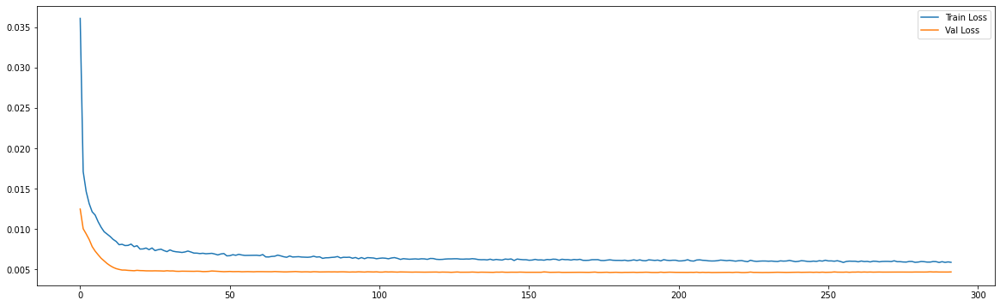

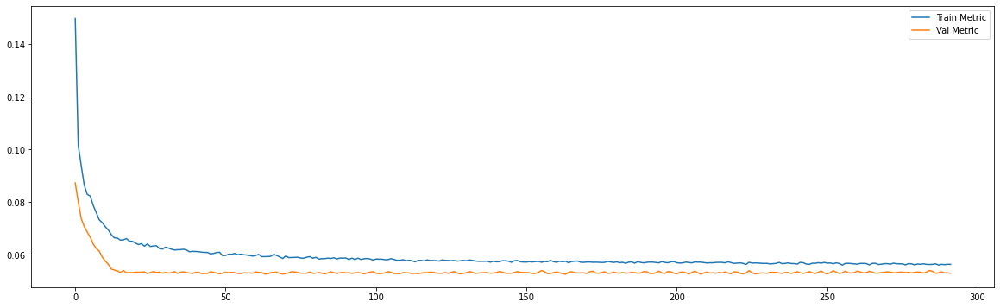

============================model:38===========================
32/32 [==============================] - 0s 5ms/step - loss: 0.0067 - mae: 0.0605
loss and metric train data [0.00672928337007761, 0.0605454184114933]
3/3 [==============================] - 0s 4ms/step - loss: 0.0069 - mae: 0.0655
loss and metric val data [0.006867025978863239, 0.06553269177675247]
3/3 [==============================] - 0s 4ms/step - loss: 0.0134 - mae: 0.0910
loss and metric test data [0.013407757505774498, 0.09096747636795044]


'neurons': 30, 'dropout': 0.2, 'time_steps': 240, 'batch_size':240, 'learning_rate':0.001, 'hidden_layers':1




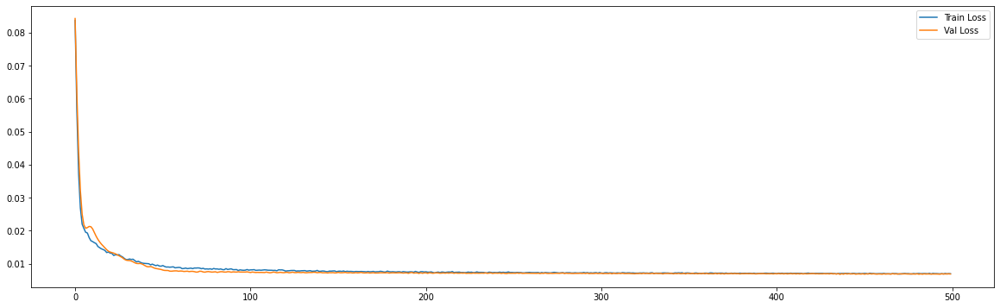

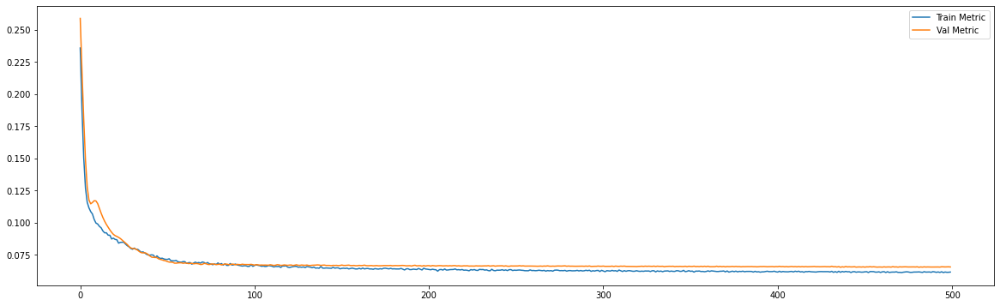

Epoch 00429: early stopping
============================model:39===========================
32/32 [==============================] - 0s 8ms/step - loss: 0.0067 - mae: 0.0606
loss and metric train data [0.006728002335876226, 0.060610536485910416]
3/3 [==============================] - 0s 7ms/step - loss: 0.0068 - mae: 0.0652
loss and metric val data [0.006804030854254961, 0.06521500647068024]
3/3 [==============================] - 0s 6ms/step - loss: 0.0133 - mae: 0.0909
loss and metric test data [0.013340099714696407, 0.090894915163517]


'neurons': 30, 'dropout': 0.2, 'time_steps': 240, 'batch_size':240, 'hidden_layers':2




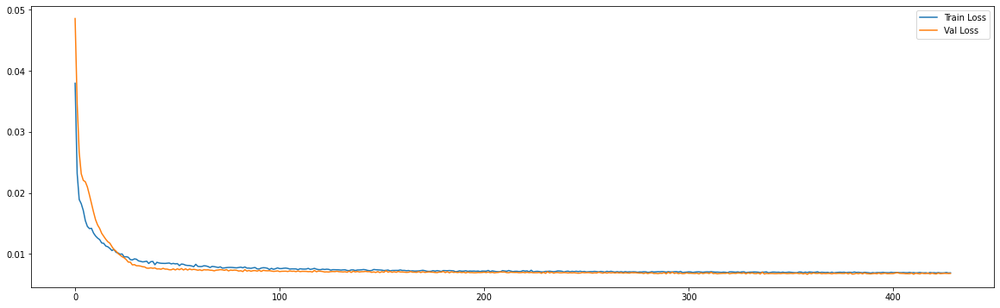

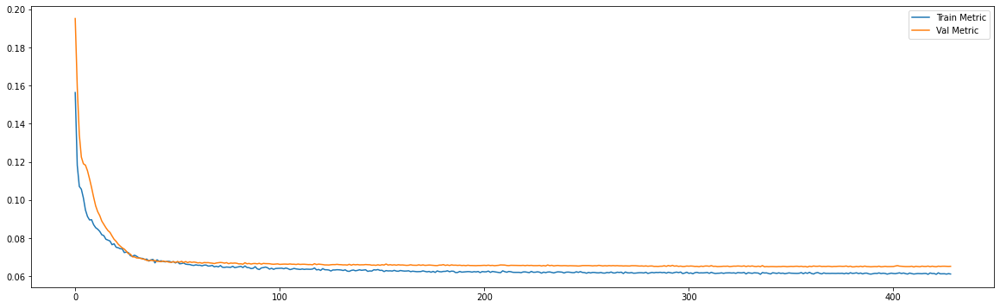

Epoch 00322: early stopping
============================model:40===========================
45/45 [==============================] - 0s 3ms/step - loss: 0.0055 - mae: 0.0559
loss and metric train data [0.005476051475852728, 0.055887699127197266]
9/9 [==============================] - 0s 2ms/step - loss: 0.0050 - mae: 0.0554
loss and metric val data [0.004984464030712843, 0.055351246148347855]
9/9 [==============================] - 0s 3ms/step - loss: 0.0055 - mae: 0.0545
loss and metric test data [0.005492374300956726, 0.054457440972328186]


'neurons': 30, 'dropout': 0.4, 'time_steps': 30, 'batch_size':30, 'learning_rate':0.001, 'hidden_layers':1




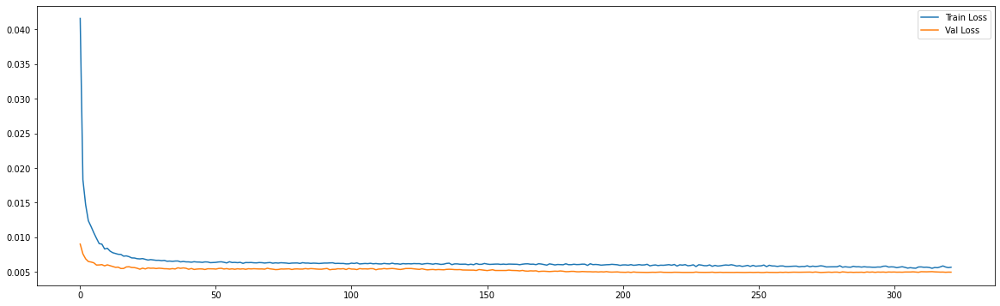

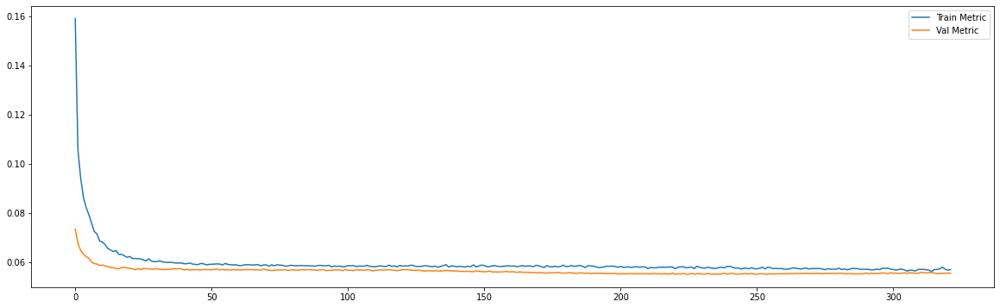

Epoch 00139: early stopping
============================model:41===========================
45/45 [==============================] - 0s 3ms/step - loss: 0.0061 - mae: 0.0560
loss and metric train data [0.006057522725313902, 0.056039683520793915]
9/9 [==============================] - 0s 3ms/step - loss: 0.0055 - mae: 0.0570
loss and metric val data [0.0055463253520429134, 0.05699915811419487]
9/9 [==============================] - 0s 3ms/step - loss: 0.0061 - mae: 0.0566
loss and metric test data [0.006117585580796003, 0.05661855638027191]


'neurons': 30, 'dropout': 0.4, 'time_steps': 30, 'batch_size':30, 'hidden_layers':2




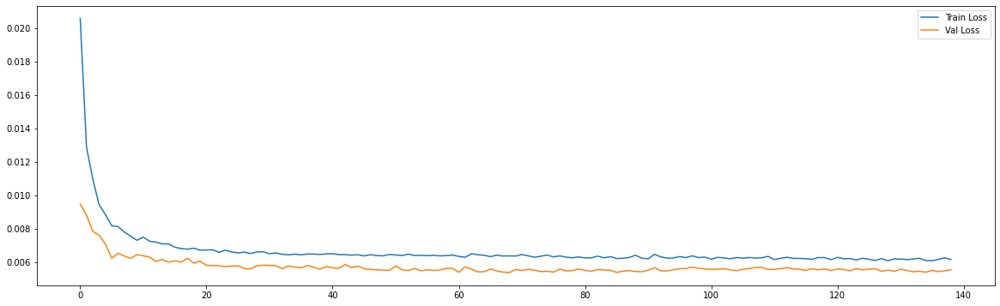

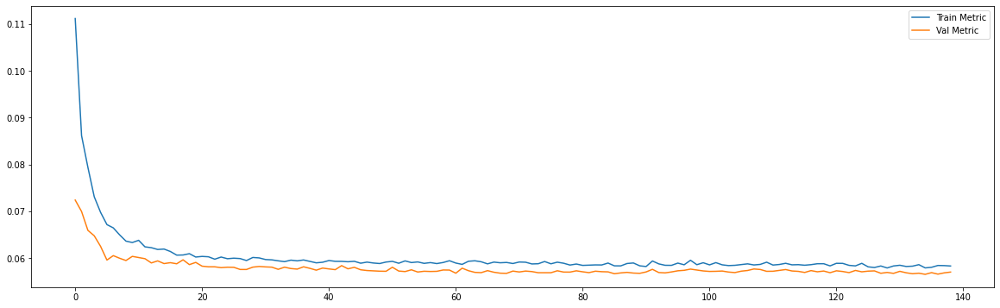

Epoch 00227: early stopping
============================model:42===========================
43/43 [==============================] - 0s 3ms/step - loss: 0.0054 - mae: 0.0546
loss and metric train data [0.005426312331110239, 0.0545724555850029]
8/8 [==============================] - 0s 3ms/step - loss: 0.0049 - mae: 0.0549
loss and metric val data [0.00493435375392437, 0.05494607239961624]
8/8 [==============================] - 0s 3ms/step - loss: 0.0066 - mae: 0.0619
loss and metric test data [0.0065537854097783566, 0.06185321509838104]


'neurons': 30, 'dropout': 0.4, 'time_steps': 60, 'batch_size':60, 'learning_rate':0.001, 'hidden_layers':1




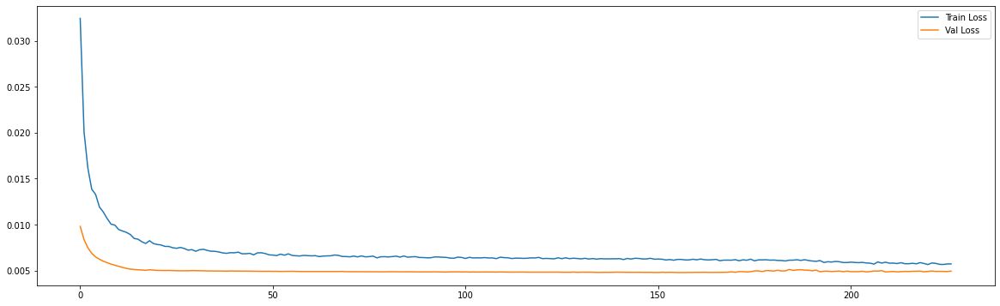

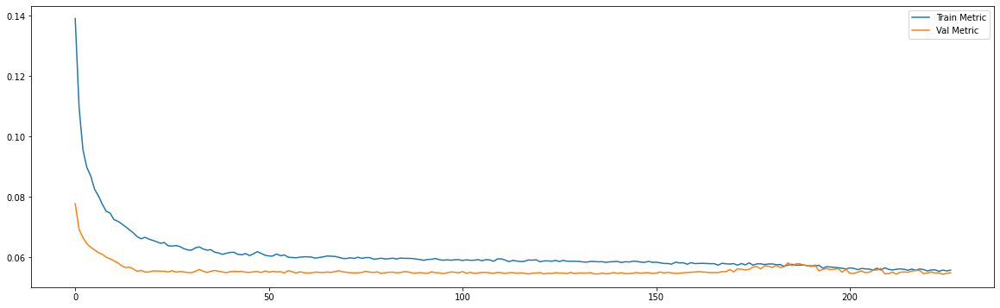

Epoch 00195: early stopping
============================model:43===========================
43/43 [==============================] - 0s 4ms/step - loss: 0.0058 - mae: 0.0571
loss and metric train data [0.005792733281850815, 0.05709574744105339]
8/8 [==============================] - 0s 4ms/step - loss: 0.0048 - mae: 0.0554
loss and metric val data [0.004839887376874685, 0.055355556309223175]
8/8 [==============================] - 0s 3ms/step - loss: 0.0064 - mae: 0.0616
loss and metric test data [0.006396777927875519, 0.06157653033733368]


'neurons': 30, 'dropout': 0.4, 'time_steps': 60, 'batch_size':60, 'hidden_layers':2




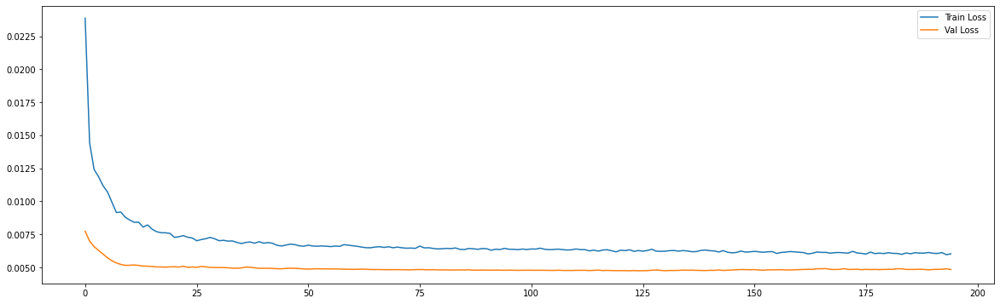

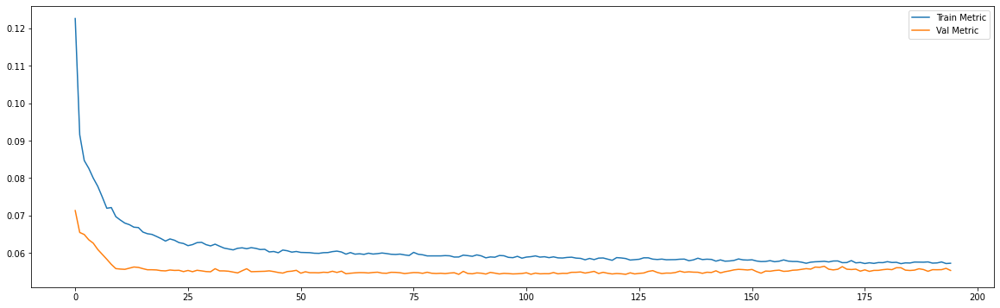

Epoch 00314: early stopping
============================model:44===========================
39/39 [==============================] - 0s 4ms/step - loss: 0.0060 - mae: 0.0575
loss and metric train data [0.005975225009024143, 0.05752633512020111]
7/7 [==============================] - 0s 3ms/step - loss: 0.0048 - mae: 0.0548
loss and metric val data [0.004821948241442442, 0.05477461591362953]
7/7 [==============================] - 0s 3ms/step - loss: 0.0080 - mae: 0.0686
loss and metric test data [0.00797939021140337, 0.06859880685806274]


'neurons': 30, 'dropout': 0.4, 'time_steps': 120, 'batch_size':120, 'learning_rate':0.001, 'hidden_layers':1




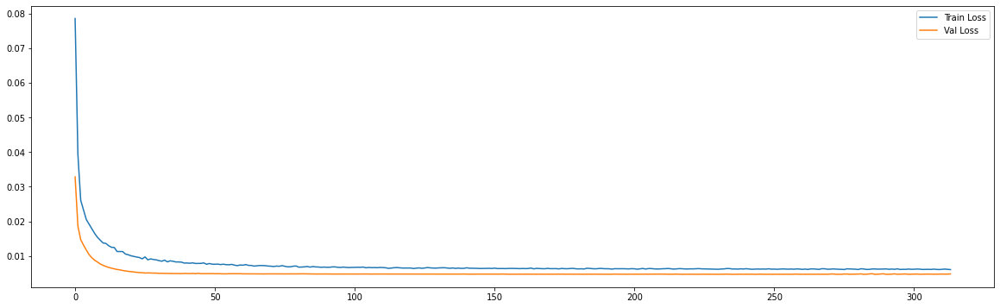

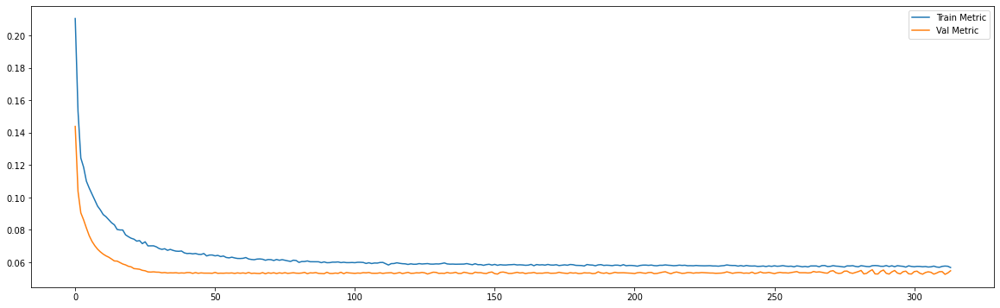

Epoch 00392: early stopping
============================model:45===========================
39/39 [==============================] - 0s 6ms/step - loss: 0.0057 - mae: 0.0557
loss and metric train data [0.005694994702935219, 0.0557081513106823]
7/7 [==============================] - 0s 5ms/step - loss: 0.0047 - mae: 0.0538
loss and metric val data [0.004720193799585104, 0.053773846477270126]
7/7 [==============================] - 0s 5ms/step - loss: 0.0078 - mae: 0.0680
loss and metric test data [0.007750967983156443, 0.06804218888282776]


'neurons': 30, 'dropout': 0.4, 'time_steps': 120, 'batch_size':120, 'hidden_layers':2




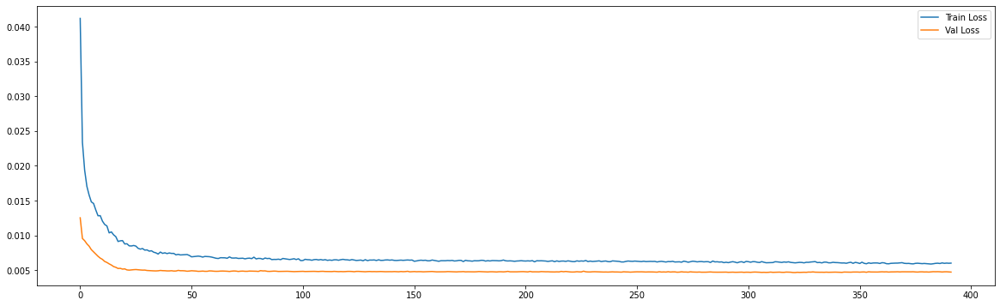

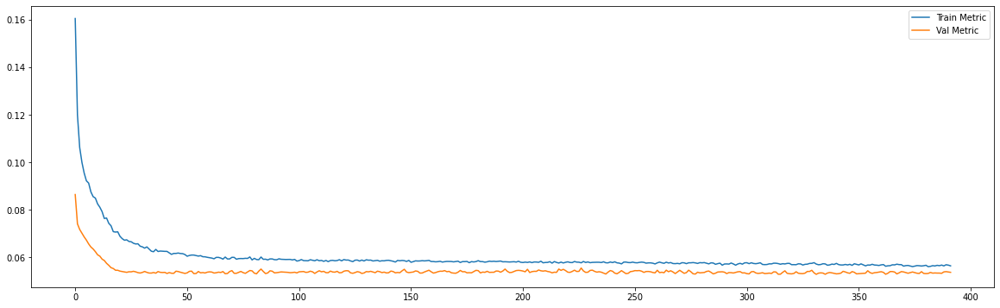

============================model:46===========================
32/32 [==============================] - 0s 5ms/step - loss: 0.0069 - mae: 0.0609
loss and metric train data [0.006859093438833952, 0.06088368967175484]
3/3 [==============================] - 0s 4ms/step - loss: 0.0069 - mae: 0.0655
loss and metric val data [0.006921401247382164, 0.06550320982933044]
3/3 [==============================] - 0s 5ms/step - loss: 0.0140 - mae: 0.0922
loss and metric test data [0.013998285867273808, 0.09222285449504852]


'neurons': 30, 'dropout': 0.4, 'time_steps': 240, 'batch_size':240, 'learning_rate':0.001, 'hidden_layers':1




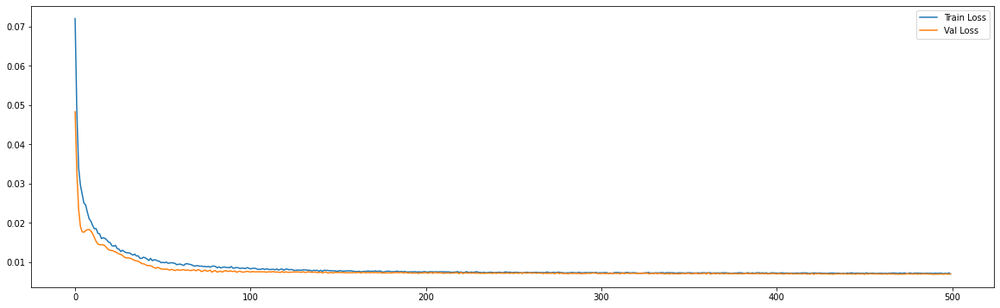

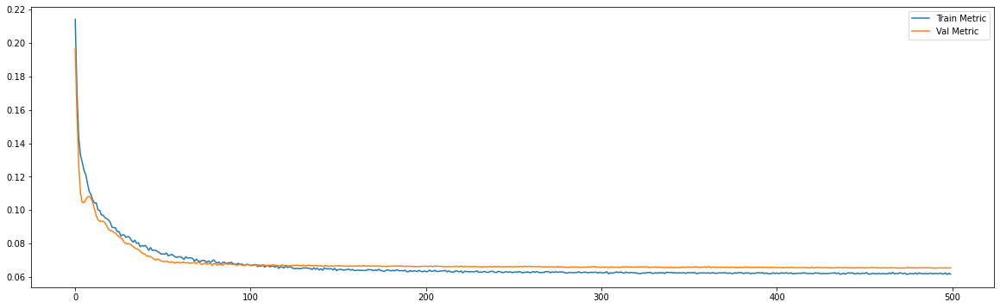

Epoch 00423: early stopping
============================model:47===========================
32/32 [==============================] - 0s 9ms/step - loss: 0.0069 - mae: 0.0612
loss and metric train data [0.006869042292237282, 0.06119496747851372]
3/3 [==============================] - 0s 7ms/step - loss: 0.0070 - mae: 0.0664
loss and metric val data [0.006997468415647745, 0.0663696900010109]
3/3 [==============================] - 0s 6ms/step - loss: 0.0141 - mae: 0.0923
loss and metric test data [0.014075953513383865, 0.09229514747858047]


'neurons': 30, 'dropout': 0.4, 'time_steps': 240, 'batch_size':240, 'hidden_layers':2




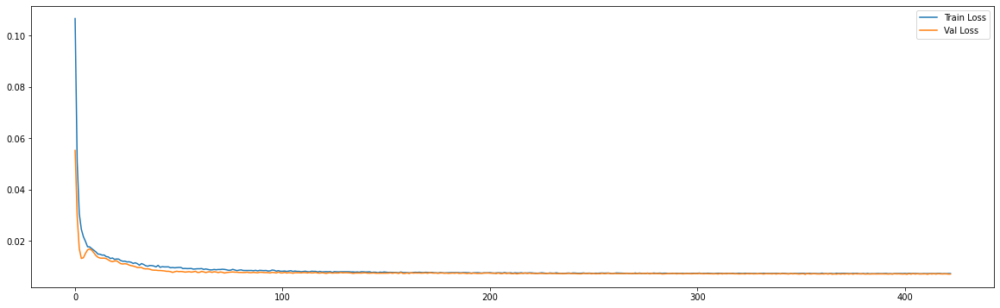

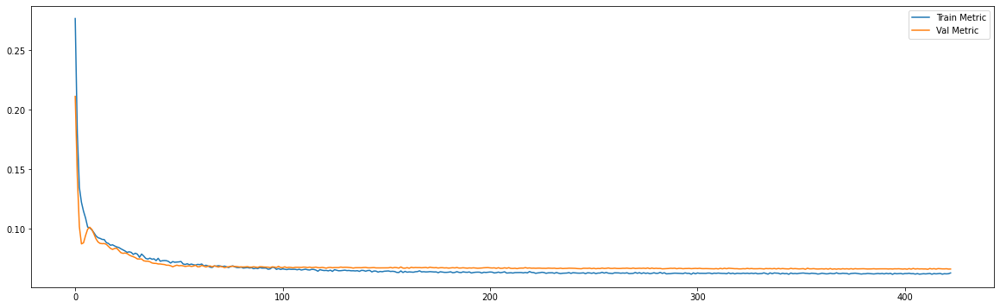

In [27]:
future_steps = 5
n_features = df_train.shape[1]

neurons_list = [20,25,30]
dropout_list = [0.2,0.4]
time_steps_list = [30,60,120,240]
lr_list = [0.001]
models = {}
i=0
for neurons in neurons_list:
  for dropout in dropout_list:
    for time_steps in time_steps_list:
      for lr in lr_list:
        x_train,x_test,x_val,y_train,y_val,y_test = Regressor(future_steps = future_steps,time_steps = time_steps,n_features = n_features,df_train = df_train_norm,df_val = df_val_norm,df_test = df_test_norm)

        models[i] = {'neurons':neurons,'dropout':dropout,'time_steps': time_steps, 'batch_size':time_steps, 'learning_rate':lr}
        models[i]['resumo'] = "'neurons': {}, 'dropout': {}, 'time_steps': {}, 'batch_size':{}, 'learning_rate':{}, 'hidden_layers':{}".format(neurons,dropout,time_steps,time_steps,lr,1)

        # The GRU architecture
        models[i]['model'] = Sequential()
        models[i]['model'].add(GRU(units=neurons, return_sequences=False,input_shape=(time_steps, n_features))) # return_sequences=True next layer is GRU
        models[i]['model'].add(Dropout(dropout))
        models[i]['model'].add(Dense(units=future_steps))

        #Compiling the GRU
        adam = optimizers.Adam(lr = lr, beta_1 = 0.9, beta_2 = 0.999, decay = 0.0)
        models[i]['model'].compile(optimizer = adam, loss = 'mse', metrics=['mae'])

        # early stop
        es = EarlyStopping(monitor='val_loss', mode='min', verbose=1, patience = 70)

        #Fitting to traning set
        history = models[i]['model'].fit(x_train, y_train, validation_data = (x_val,y_val), epochs = 500, batch_size = time_steps, verbose = 0, shuffle = False, callbacks = [es])

        print('============================model:{}==========================='.format(i))

          
        print('loss and metric train data',models[i]['model'].evaluate(x_train,y_train))
        print('loss and metric val data',models[i]['model'].evaluate(x_val,y_val))
        print('loss and metric test data',models[i]['model'].evaluate(x_test,y_test))
        print('\n')

        print(models[i]['resumo'])
        print('\n')

        plt.figure(figsize=(20,6))
        plt.plot(history.history['loss'])
        plt.plot(history.history['val_loss'])
        plt.legend(['Train Loss', 'Val Loss'])

        plt.figure(figsize=(20,6))
        plt.plot(history.history['mae'])
        plt.plot(history.history['val_mae'])
        plt.legend(['Train Metric', 'Val Metric'])
        plt.show()

        i+=1


        models[i] = {'neurons':neurons,'dropout':dropout,'time_steps': time_steps, 'batch_size':time_steps}
        models[i]['resumo'] = "'neurons': {}, 'dropout': {}, 'time_steps': {}, 'batch_size':{}, 'hidden_layers':{}".format(neurons,dropout,time_steps,time_steps,2)

        # The GRU architecture
        models[i]['model'] = Sequential()
        models[i]['model'].add(GRU(units=neurons, return_sequences=True,input_shape=(time_steps, n_features))) # return_sequences=True next layer is GRU
        models[i]['model'].add(Dropout(dropout))
        models[i]['model'].add(GRU(units=neurons, return_sequences=False))
        models[i]['model'].add(Dropout(dropout))
        models[i]['model'].add(Dense(units=future_steps))

        #Compiling the GRU
        adam = optimizers.Adam(lr = lr, beta_1 = 0.9, beta_2 = 0.999, decay = 0.0)
        models[i]['model'].compile(optimizer = adam, loss = 'mse', metrics=['mae'])

         # early stop
        es = EarlyStopping(monitor='val_loss', mode='min', verbose=1, patience = 70)

        #Fitting to traning set
        history = models[i]['model'].fit(x_train, y_train, validation_data = (x_val,y_val), epochs = 500, batch_size = time_steps, verbose = 0, shuffle = False, callbacks = [es])

        print('============================model:{}==========================='.format(i))

          
        print('loss and metric train data',models[i]['model'].evaluate(x_train,y_train))
        print('loss and metric val data',models[i]['model'].evaluate(x_val,y_val))
        print('loss and metric test data',models[i]['model'].evaluate(x_test,y_test))
        print('\n')

        print(models[i]['resumo'])
        print('\n')

        plt.figure(figsize=(20,6))
        plt.plot(history.history['loss'])
        plt.plot(history.history['val_loss'])
        plt.legend(['Train Loss', 'Val Loss'])

        plt.figure(figsize=(20,6))
        plt.plot(history.history['mae'])
        plt.plot(history.history['val_mae'])
        plt.legend(['Train Metric', 'Val Metric'])
        plt.show()

        i+=1

### Best Model Resume

`Validation metric as evaluation parameter`

Epoch 00292: early stopping

============================model:37===========================

39/39 [==============================] - 0s 6ms/step - loss: 0.0057 - mae: 0.0554

loss and metric train data [0.005699935834854841, 0.05542084202170372]

7/7 [==============================] - 0s 5ms/step - loss: 0.0047 - mae: 0.0529

loss and metric val data [0.004688308108597994, 0.05291558802127838]

7/7 [==============================] - 0s 5ms/step - loss: 0.0076 - mae: 0.0671

loss and metric test data [0.007604670245200396, 0.06710100919008255]


'neurons': 30, 'dropout': 0.2, 'time_steps': 120, 'batch_size':120, 'hidden_layers':2


In [28]:
models[37]

{'batch_size': 120,
 'dropout': 0.2,
 'model': <tensorflow.python.keras.engine.sequential.Sequential at 0x7efe91f953c8>,
 'neurons': 30,
 'resumo': "'neurons': 30, 'dropout': 0.2, 'time_steps': 120, 'batch_size':120, 'hidden_layers':2",
 'time_steps': 120}

Saving the Model

In [0]:
models[37]['model'].save("/content/drive/My Drive/ML Projects/Pharma Sales/GRU_weekdayMonth.h5")

Ploting the model prediction


In [0]:
future_steps = 5
n_features = df_train.shape[1]
x_train,x_test,x_val,y_train,y_val,y_test = Regressor(future_steps = future_steps,time_steps = 120,n_features = n_features,df_train = df_train_norm,df_val = df_val_norm,df_test = df_test_norm)

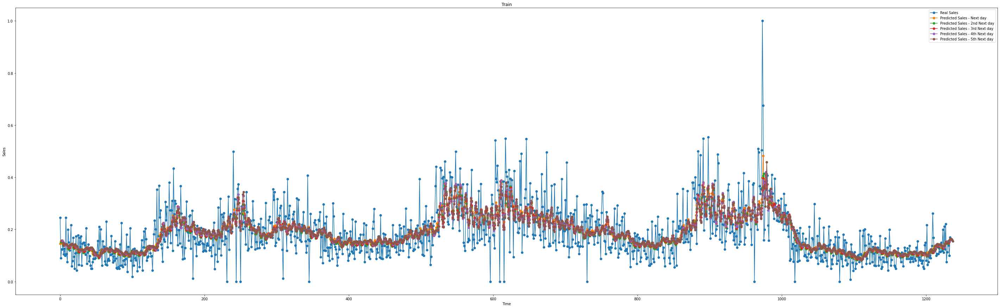

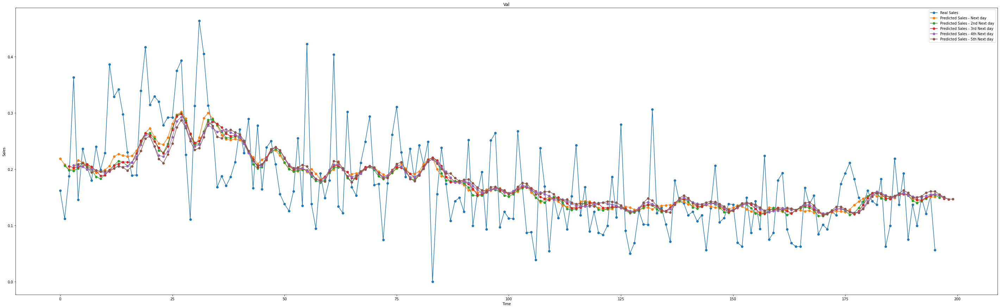

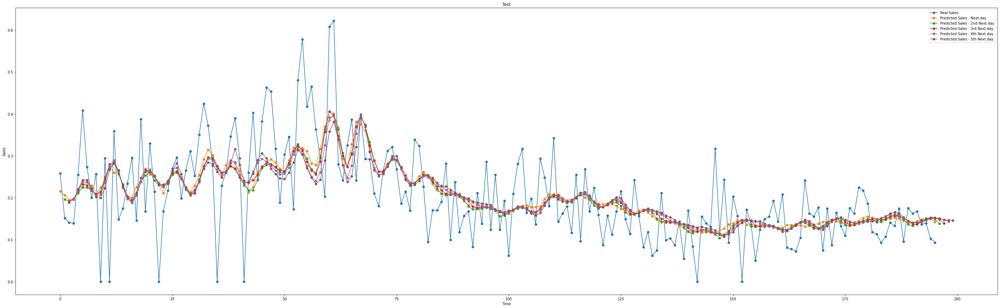

In [33]:
y_train_predict = models[37]['model'].predict(x_train)
y_val_predict = models[37]['model'].predict(x_val)
y_test_predict = models[37]['model'].predict(x_test)

plt.figure(figsize=(50,15))
plt.plot(y_train[:,0],marker='o',label='Real Sales')
plt.plot(y_train_predict[:,0],marker='o',label='Predicted Sales - Next day')
plt.plot(np.concatenate(([None],y_train_predict[:, 1])),marker='o',label='Predicted Sales - 2nd Next day')
plt.plot(np.concatenate(([None, None],y_train_predict[:, 2])),marker='o',label='Predicted Sales - 3rd Next day')
plt.plot(np.concatenate(([None, None, None],y_train_predict[:, 3])),marker='o',label='Predicted Sales - 4th Next day')
plt.plot(np.concatenate(([None, None, None,None],y_train_predict[:, 4])),marker='o',label='Predicted Sales - 5th Next day')
plt.title('Train')
plt.xlabel('Time')
plt.ylabel('Sales')
plt.legend()
plt.show()

plt.figure(figsize=(50,15))
plt.plot(y_val[:,0],marker='o',label='Real Sales')
plt.plot(y_val_predict[:,0],marker='o',label='Predicted Sales - Next day')
plt.plot(np.concatenate(([None],y_val_predict[:, 1])),marker='o',label='Predicted Sales - 2nd Next day')
plt.plot(np.concatenate(([None, None],y_val_predict[:, 2])),marker='o',label='Predicted Sales - 3rd Next day')
plt.plot(np.concatenate(([None, None, None],y_val_predict[:, 3])),marker='o',label='Predicted Sales - 4th Next day')
plt.plot(np.concatenate(([None, None, None,None],y_val_predict[:, 4])),marker='o',label='Predicted Sales - 5th Next day')
plt.title('Val')
plt.xlabel('Time')
plt.ylabel('Sales')
plt.legend()
plt.show()

plt.figure(figsize=(50,15))
plt.plot(y_test[:,0],marker='o',label='Real Sales')
plt.plot(y_test_predict[:,0],marker='o',label='Predicted Sales - Next day')
plt.plot(np.concatenate(([None],y_test_predict[:, 1])),marker='o',label='Predicted Sales - 2nd Next day')
plt.plot(np.concatenate(([None, None],y_test_predict[:, 2])),marker='o',label='Predicted Sales - 3rd Next day')
plt.plot(np.concatenate(([None, None, None],y_test_predict[:, 3])),marker='o',label='Predicted Sales - 4th Next day')
plt.plot(np.concatenate(([None, None, None,None],y_test_predict[:, 4])),marker='o',label='Predicted Sales - 5th Next day')
plt.title('Test')
plt.xlabel('Time')
plt.ylabel('Sales')
plt.legend()
plt.show()

## GRU

With the most relevant features

Making a filter based on the average importance.

In [34]:
df_daily.corr().iloc[:-1,-1][df_daily.corr().iloc[:-1,-1].abs() > df_daily.corr().iloc[:-1,-1].abs().mean()]

lag1                0.440795
lag2                0.396495
lag3                0.369587
lag4                0.376088
lag5                0.399644
lag6                0.438007
lag7                0.473197
rolling_mean_2      0.848795
rolling_mean_3      0.779523
rolling_mean_4      0.736699
rolling_mean_5      0.712445
rolling_mean_6      0.701197
rolling_mean_7      0.700098
rolling_mean_30     0.587698
rolling_mean_60     0.475406
rolling_mean_120    0.340235
Name: N02BE, dtype: float64

In [35]:
df_daily = df_daily[['lag1','rolling_mean_2','rolling_mean_3','N02BE']]
df_daily.fillna(0,inplace = True)
df_daily

/usr/local/lib/python3.6/dist-packages/pandas/core/frame.py:4153: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  downcast=downcast,


,lag1,rolling_mean_2,rolling_mean_3,N02BE
0,0.00,0.000,0.000000,32.40
1,32.40,41.500,0.000000,50.60
2,50.60,56.225,48.283333,61.85
3,61.85,51.475,51.183333,41.10
4,41.10,31.400,41.550000,21.70
...,...,...,...,...
2101,40.40,31.425,31.016667,22.45
2102,22.45,23.925,29.416667,25.40
2103,25.40,30.000,27.483333,34.60
2104,34.60,42.700,36.933333,50.80


In [36]:
df_train,df_val,df_test = dataSplit(df = df_daily,train_percent = 0.7,val_percent = 0.15)

df_train_norm,df_val_norm,df_test_norm = normalizing_data(df_train,df_val,df_test,frange = (0,1))

(1474, 4)
(316, 4)
(316, 4)
[1. 1. 1. 1.]
[0. 0. 0. 0.]


[0.46335404 0.51821283 0.54192647 0.46335404]
[0.         0.07067853 0.08834426 0.        ]


[0.62173913 0.73377827 0.69222001 0.62173913]
[0.         0.05005562 0.09119407 0.        ]
-------------------------
(1474, 4)
(316, 4)
(316, 4)


Epoch 00342: early stopping
============================model:0===========================
45/45 [==============================] - 0s 2ms/step - loss: 0.0056 - mae: 0.0558
loss and metric train data [0.005610885098576546, 0.055758312344551086]
9/9 [==============================] - 0s 2ms/step - loss: 0.0050 - mae: 0.0562
loss and metric val data [0.004992780275642872, 0.056166380643844604]
9/9 [==============================] - 0s 2ms/step - loss: 0.0060 - mae: 0.0572
loss and metric test data [0.005994966719299555, 0.05720294639468193]


'neurons': 20, 'dropout': 0.2, 'time_steps': 30, 'batch_size':30, 'learning_rate':0.001, 'hidden_layers':1




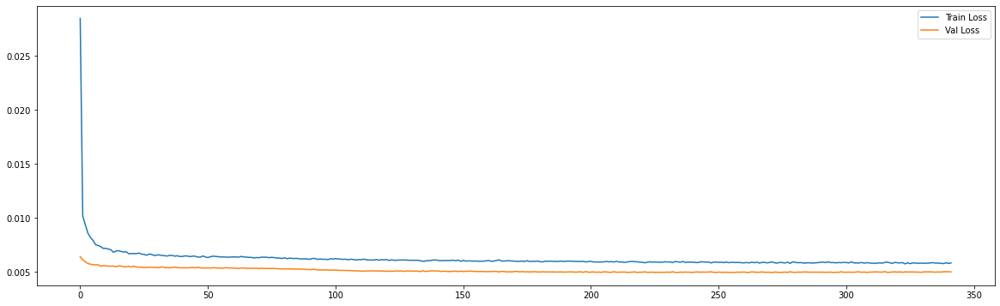

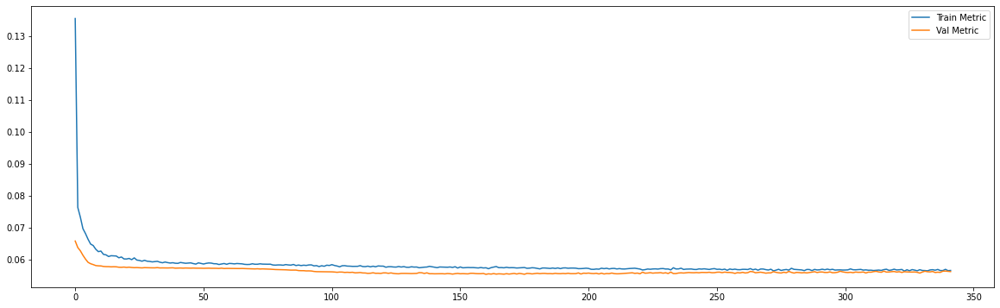

Epoch 00229: early stopping
============================model:1===========================
45/45 [==============================] - 0s 4ms/step - loss: 0.0056 - mae: 0.0554
loss and metric train data [0.00558262225240469, 0.055414095520973206]
9/9 [==============================] - 0s 3ms/step - loss: 0.0050 - mae: 0.0555
loss and metric val data [0.0049735177308321, 0.05547070503234863]
9/9 [==============================] - 0s 3ms/step - loss: 0.0063 - mae: 0.0569
loss and metric test data [0.006264999508857727, 0.05685419961810112]


'neurons': 20, 'dropout': 0.2, 'time_steps': 30, 'batch_size':30, 'hidden_layers':2




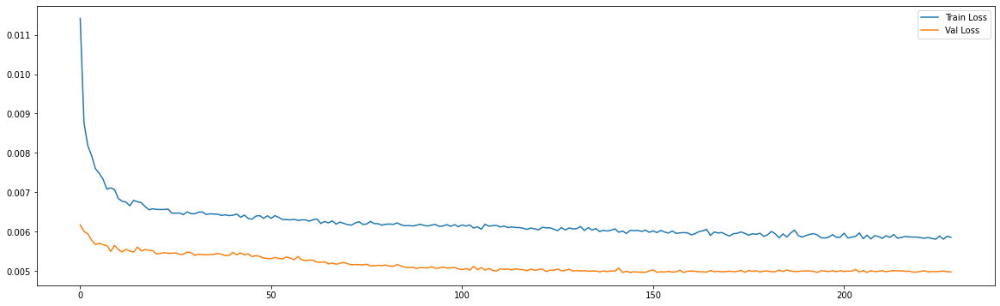

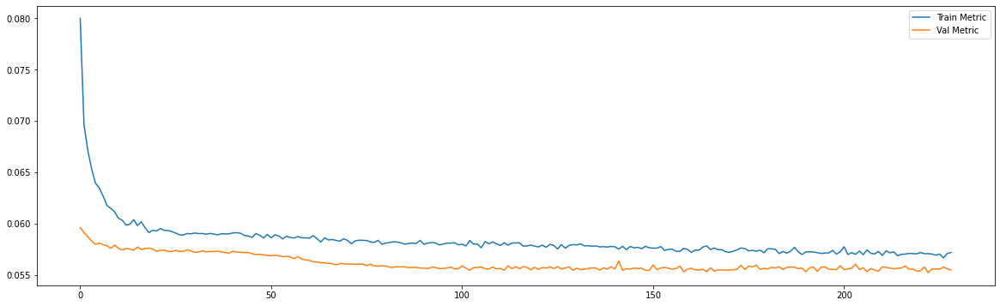

Epoch 00295: early stopping
============================model:2===========================
43/43 [==============================] - 0s 3ms/step - loss: 0.0057 - mae: 0.0558
loss and metric train data [0.0057131885550916195, 0.05576682090759277]
8/8 [==============================] - 0s 3ms/step - loss: 0.0049 - mae: 0.0548
loss and metric val data [0.0048858714289963245, 0.05479935556650162]
8/8 [==============================] - 0s 3ms/step - loss: 0.0071 - mae: 0.0632
loss and metric test data [0.007098108995705843, 0.06320352107286453]


'neurons': 20, 'dropout': 0.2, 'time_steps': 60, 'batch_size':60, 'learning_rate':0.001, 'hidden_layers':1




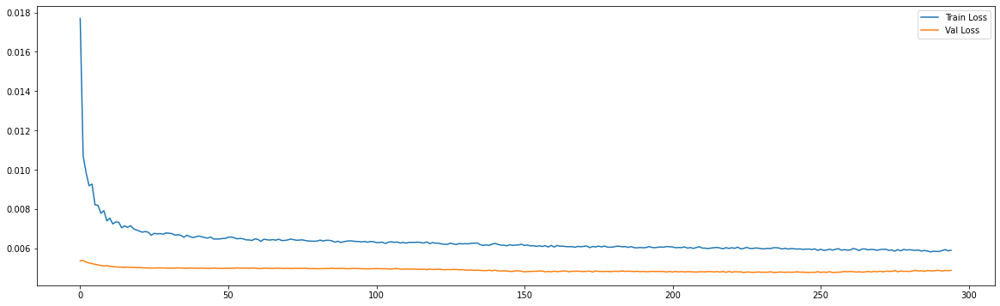

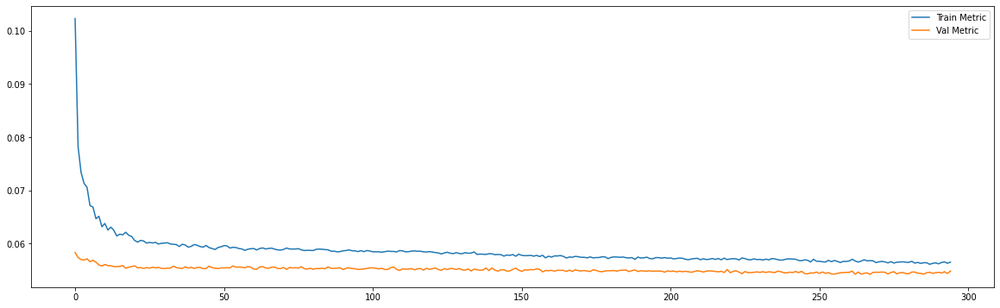

Epoch 00348: early stopping
============================model:3===========================
43/43 [==============================] - 0s 4ms/step - loss: 0.0053 - mae: 0.0548
loss and metric train data [0.005319010000675917, 0.05480480194091797]
8/8 [==============================] - 0s 4ms/step - loss: 0.0050 - mae: 0.0554
loss and metric val data [0.005024177022278309, 0.055372342467308044]
8/8 [==============================] - 0s 4ms/step - loss: 0.0083 - mae: 0.0660
loss and metric test data [0.008312826044857502, 0.0660242810845375]


'neurons': 20, 'dropout': 0.2, 'time_steps': 60, 'batch_size':60, 'hidden_layers':2




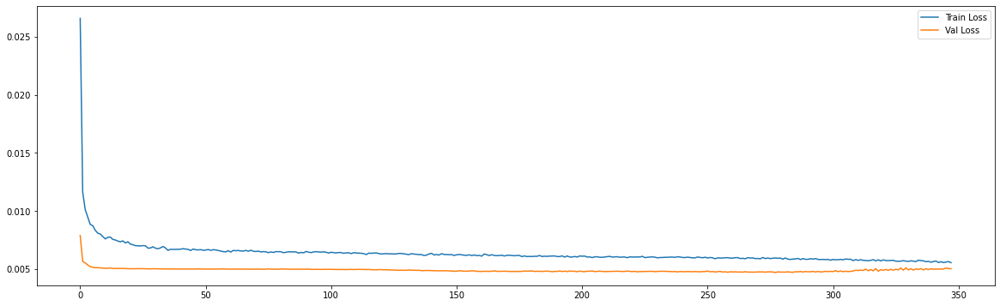

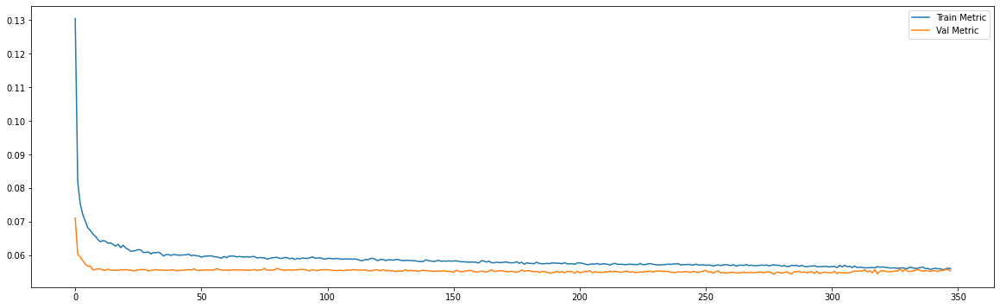

Epoch 00398: early stopping
============================model:4===========================
39/39 [==============================] - 0s 4ms/step - loss: 0.0058 - mae: 0.0558
loss and metric train data [0.005796931684017181, 0.05584670603275299]
7/7 [==============================] - 0s 4ms/step - loss: 0.0047 - mae: 0.0533
loss and metric val data [0.004695860203355551, 0.05331514775753021]
7/7 [==============================] - 0s 4ms/step - loss: 0.0081 - mae: 0.0684
loss and metric test data [0.008135025389492512, 0.06841914355754852]


'neurons': 20, 'dropout': 0.2, 'time_steps': 120, 'batch_size':120, 'learning_rate':0.001, 'hidden_layers':1




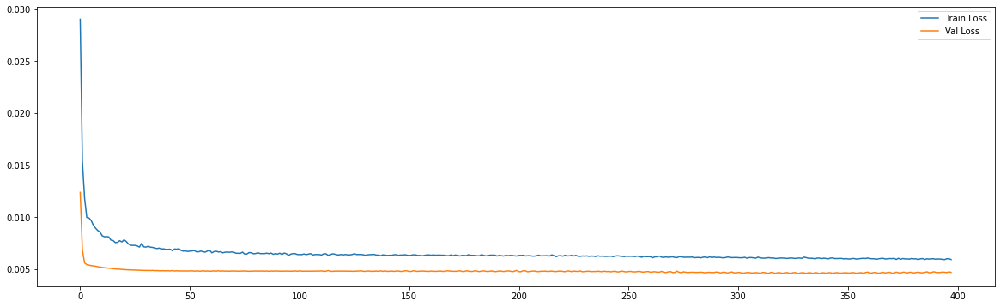

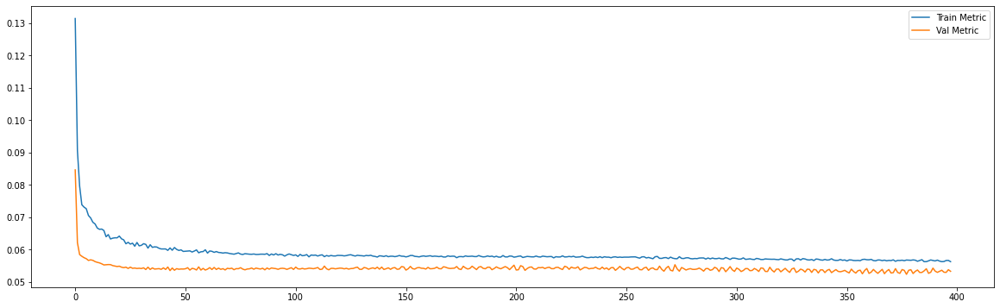

============================model:5===========================
39/39 [==============================] - 0s 6ms/step - loss: 0.0056 - mae: 0.0553
loss and metric train data [0.005575587507337332, 0.0553184412419796]
7/7 [==============================] - 0s 5ms/step - loss: 0.0045 - mae: 0.0531
loss and metric val data [0.004516974091529846, 0.053124889731407166]
7/7 [==============================] - 0s 5ms/step - loss: 0.0084 - mae: 0.0690
loss and metric test data [0.008403356187045574, 0.06903021037578583]


'neurons': 20, 'dropout': 0.2, 'time_steps': 120, 'batch_size':120, 'hidden_layers':2




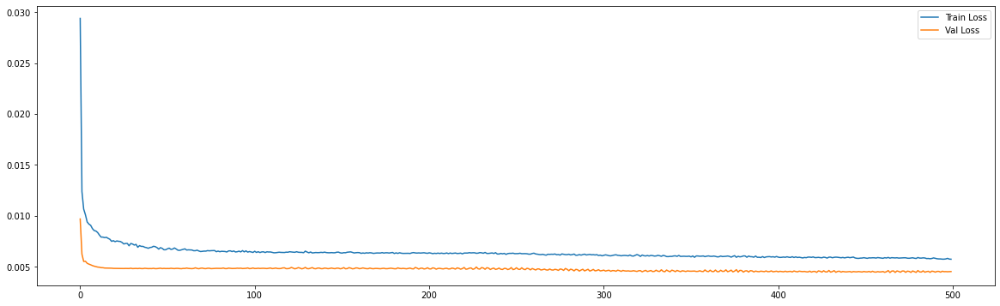

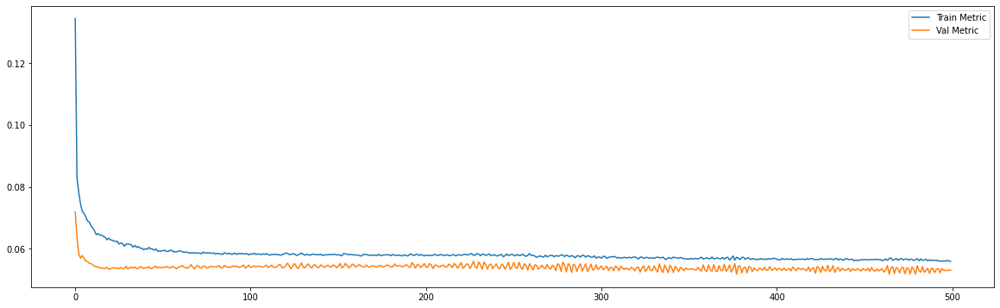

============================model:6===========================
32/32 [==============================] - 0s 5ms/step - loss: 0.0068 - mae: 0.0609
loss and metric train data [0.006752654444426298, 0.06086605414748192]
3/3 [==============================] - 0s 4ms/step - loss: 0.0063 - mae: 0.0637
loss and metric val data [0.006251676473766565, 0.06373368203639984]
3/3 [==============================] - 0s 4ms/step - loss: 0.0138 - mae: 0.0918
loss and metric test data [0.013849700801074505, 0.0917932540178299]


'neurons': 20, 'dropout': 0.2, 'time_steps': 240, 'batch_size':240, 'learning_rate':0.001, 'hidden_layers':1




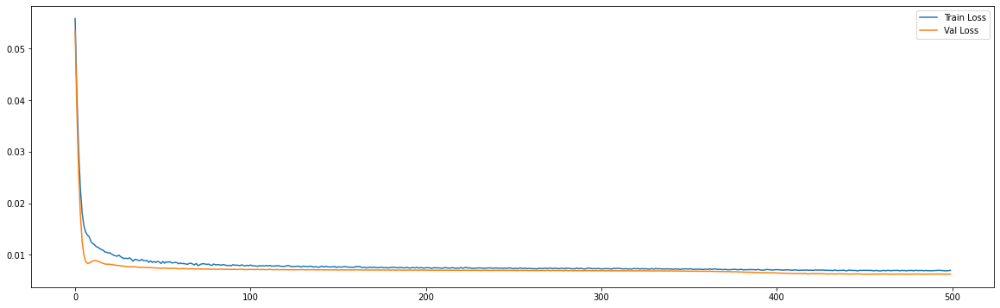

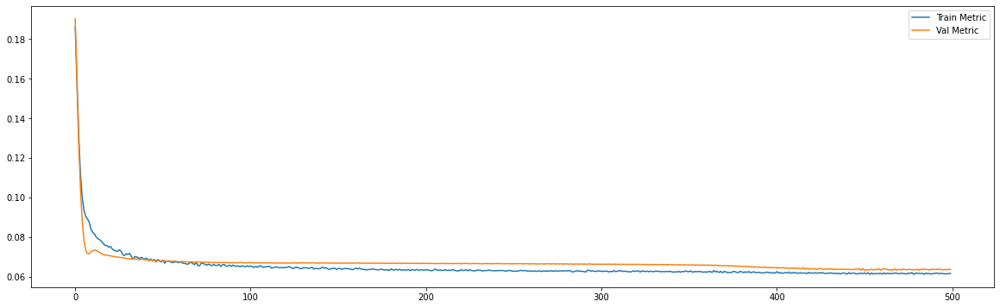

============================model:7===========================
32/32 [==============================] - 0s 9ms/step - loss: 0.0071 - mae: 0.0620
loss and metric train data [0.007123859133571386, 0.062004681676626205]
3/3 [==============================] - 0s 6ms/step - loss: 0.0069 - mae: 0.0665
loss and metric val data [0.006880388595163822, 0.06645709276199341]
3/3 [==============================] - 0s 7ms/step - loss: 0.0144 - mae: 0.0941
loss and metric test data [0.014431443996727467, 0.09411022812128067]


'neurons': 20, 'dropout': 0.2, 'time_steps': 240, 'batch_size':240, 'hidden_layers':2




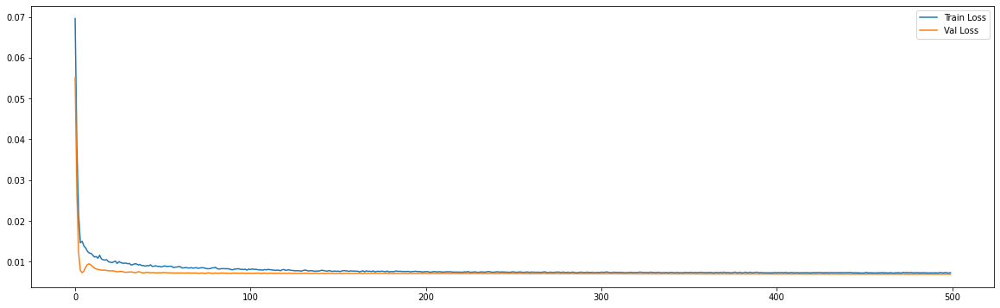

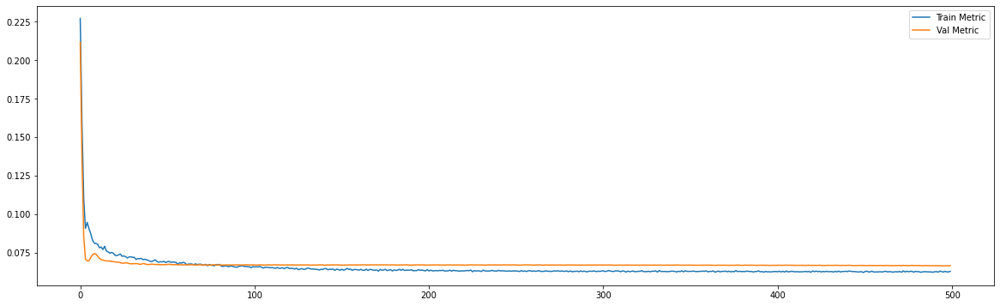

Epoch 00373: early stopping
============================model:8===========================
45/45 [==============================] - 0s 2ms/step - loss: 0.0057 - mae: 0.0562
loss and metric train data [0.005699497181922197, 0.05620163679122925]
9/9 [==============================] - 0s 2ms/step - loss: 0.0050 - mae: 0.0567
loss and metric val data [0.005002426449209452, 0.05672799050807953]
9/9 [==============================] - 0s 2ms/step - loss: 0.0061 - mae: 0.0579
loss and metric test data [0.006090972106903791, 0.05790691077709198]


'neurons': 20, 'dropout': 0.4, 'time_steps': 30, 'batch_size':30, 'learning_rate':0.001, 'hidden_layers':1




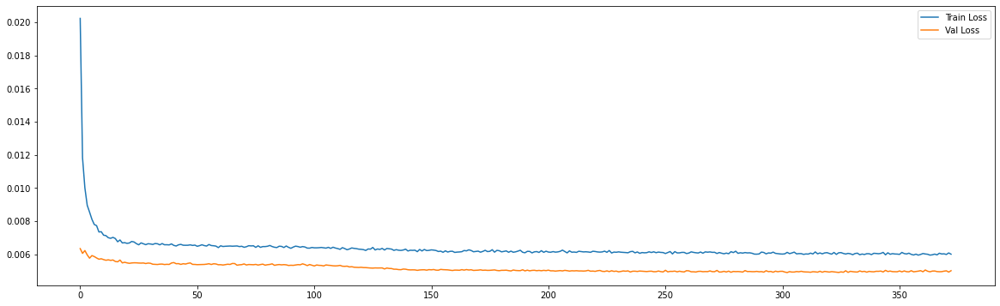

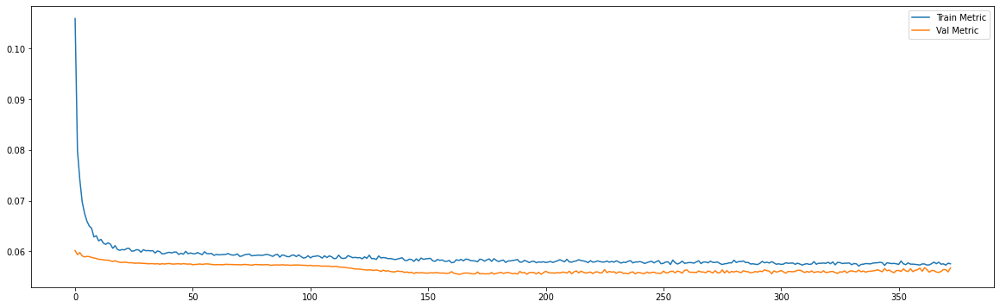

Epoch 00358: early stopping
============================model:9===========================
45/45 [==============================] - 0s 3ms/step - loss: 0.0056 - mae: 0.0554
loss and metric train data [0.005568712949752808, 0.05537620186805725]
9/9 [==============================] - 0s 3ms/step - loss: 0.0050 - mae: 0.0559
loss and metric val data [0.004957061726599932, 0.055854104459285736]
9/9 [==============================] - 0s 3ms/step - loss: 0.0066 - mae: 0.0579
loss and metric test data [0.006560968235135078, 0.05792609974741936]


'neurons': 20, 'dropout': 0.4, 'time_steps': 30, 'batch_size':30, 'hidden_layers':2




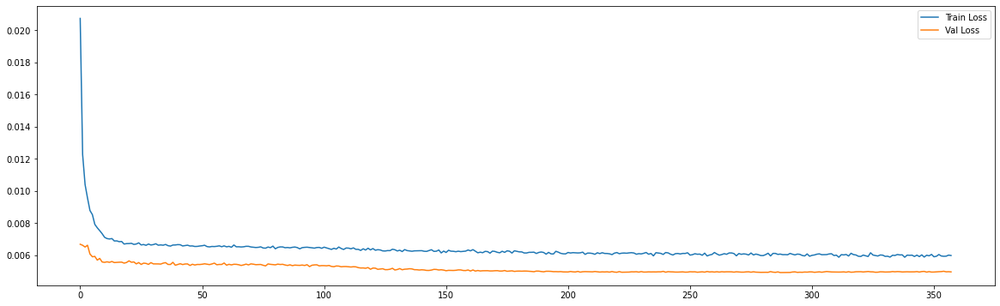

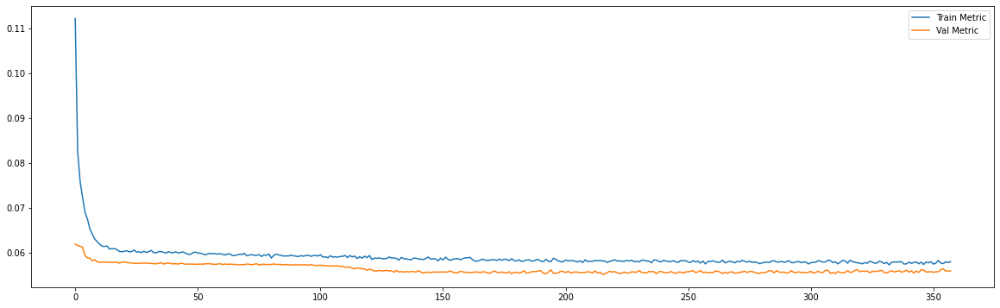

Epoch 00306: early stopping
============================model:10===========================
43/43 [==============================] - 0s 3ms/step - loss: 0.0057 - mae: 0.0556
loss and metric train data [0.0057451375760138035, 0.0555570088326931]
8/8 [==============================] - 0s 3ms/step - loss: 0.0049 - mae: 0.0546
loss and metric val data [0.004917939659208059, 0.05458609014749527]
8/8 [==============================] - 0s 2ms/step - loss: 0.0068 - mae: 0.0617
loss and metric test data [0.006821088958531618, 0.06172850728034973]


'neurons': 20, 'dropout': 0.4, 'time_steps': 60, 'batch_size':60, 'learning_rate':0.001, 'hidden_layers':1




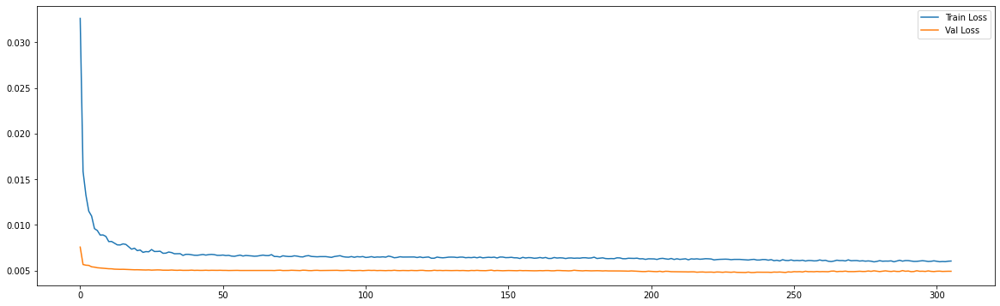

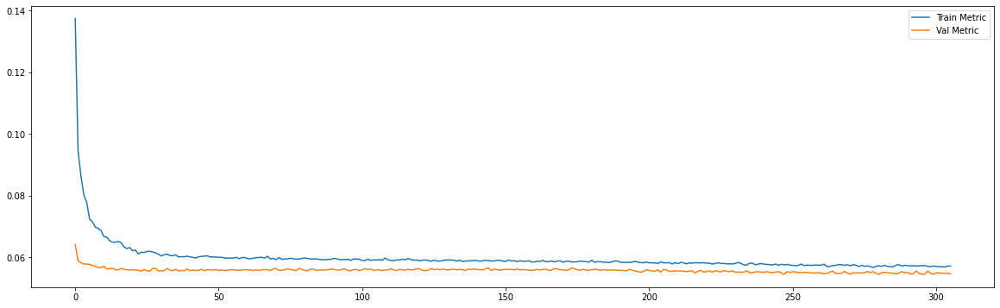

Epoch 00302: early stopping
============================model:11===========================
43/43 [==============================] - 0s 5ms/step - loss: 0.0057 - mae: 0.0555
loss and metric train data [0.005685604643076658, 0.055504217743873596]
8/8 [==============================] - 0s 4ms/step - loss: 0.0049 - mae: 0.0551
loss and metric val data [0.004857268650084734, 0.055089302361011505]
8/8 [==============================] - 0s 3ms/step - loss: 0.0071 - mae: 0.0638
loss and metric test data [0.007062779273837805, 0.0637846291065216]


'neurons': 20, 'dropout': 0.4, 'time_steps': 60, 'batch_size':60, 'hidden_layers':2




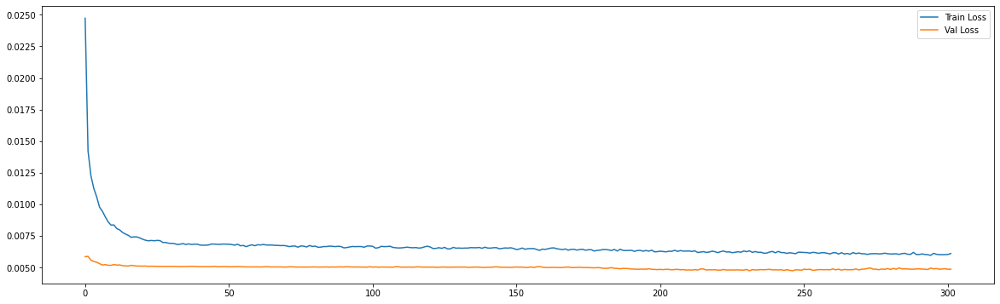

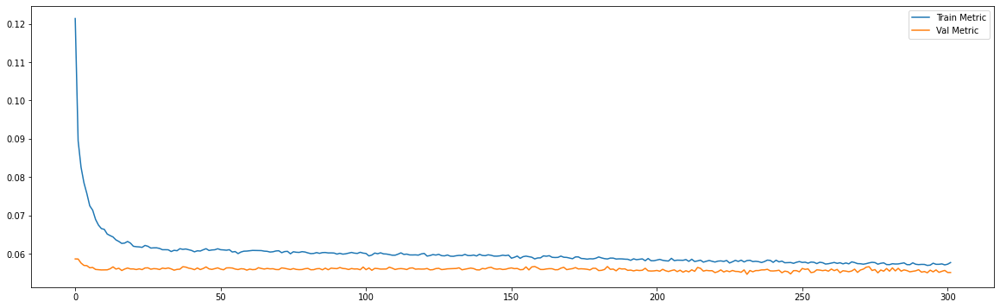

============================model:12===========================
39/39 [==============================] - 0s 3ms/step - loss: 0.0060 - mae: 0.0572
loss and metric train data [0.006038110703229904, 0.05715516582131386]
7/7 [==============================] - 0s 3ms/step - loss: 0.0048 - mae: 0.0546
loss and metric val data [0.004776096902787685, 0.05456645041704178]
7/7 [==============================] - 0s 3ms/step - loss: 0.0082 - mae: 0.0688
loss and metric test data [0.0081560043618083, 0.06884976476430893]


'neurons': 20, 'dropout': 0.4, 'time_steps': 120, 'batch_size':120, 'learning_rate':0.001, 'hidden_layers':1




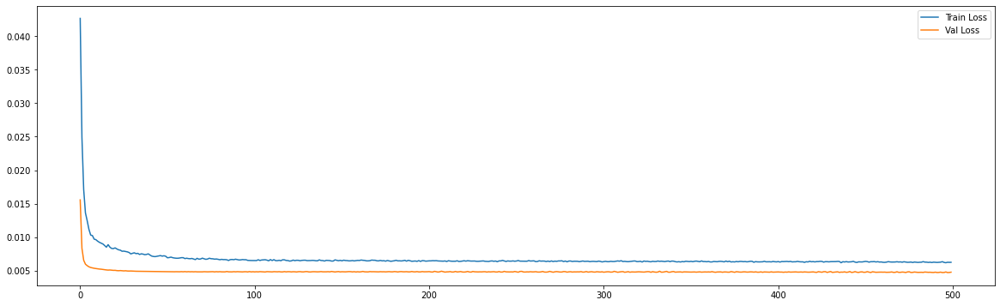

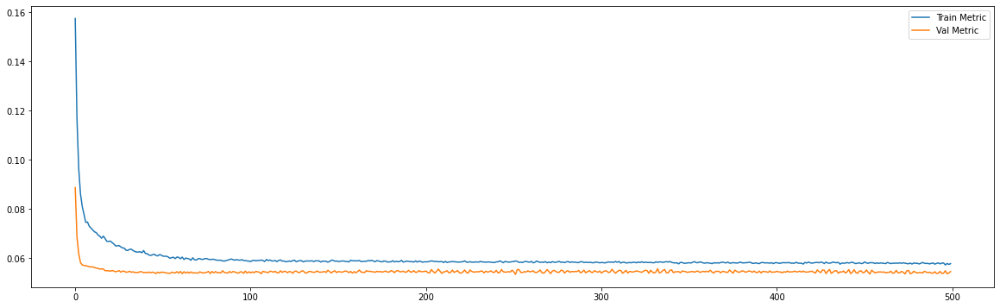

Epoch 00142: early stopping
============================model:13===========================
39/39 [==============================] - 0s 5ms/step - loss: 0.0062 - mae: 0.0576
loss and metric train data [0.006248985417187214, 0.05759567767381668]
7/7 [==============================] - 0s 4ms/step - loss: 0.0049 - mae: 0.0548
loss and metric val data [0.004857941530644894, 0.05477530509233475]
7/7 [==============================] - 0s 5ms/step - loss: 0.0085 - mae: 0.0705
loss and metric test data [0.008464045822620392, 0.07045098394155502]


'neurons': 20, 'dropout': 0.4, 'time_steps': 120, 'batch_size':120, 'hidden_layers':2




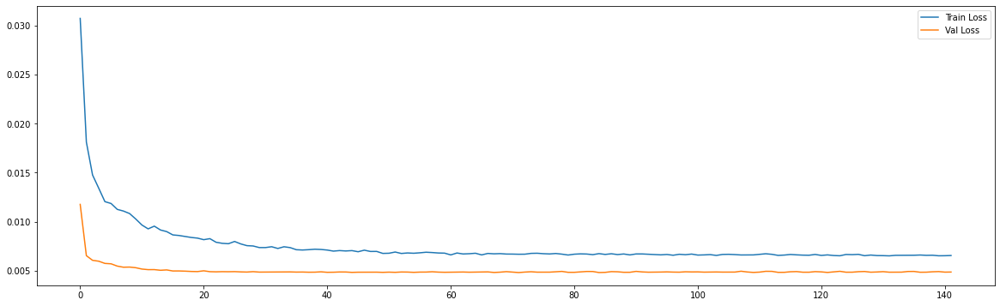

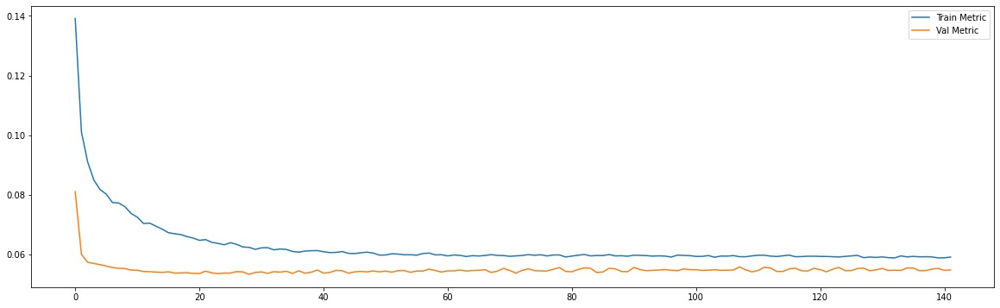

============================model:14===========================
32/32 [==============================] - 0s 5ms/step - loss: 0.0072 - mae: 0.0619
loss and metric train data [0.007197739090770483, 0.061862289905548096]
3/3 [==============================] - 0s 4ms/step - loss: 0.0070 - mae: 0.0670
loss and metric val data [0.0070445844903588295, 0.06696189939975739]
3/3 [==============================] - 0s 4ms/step - loss: 0.0149 - mae: 0.0956
loss and metric test data [0.014865751378238201, 0.09564901143312454]


'neurons': 20, 'dropout': 0.4, 'time_steps': 240, 'batch_size':240, 'learning_rate':0.001, 'hidden_layers':1




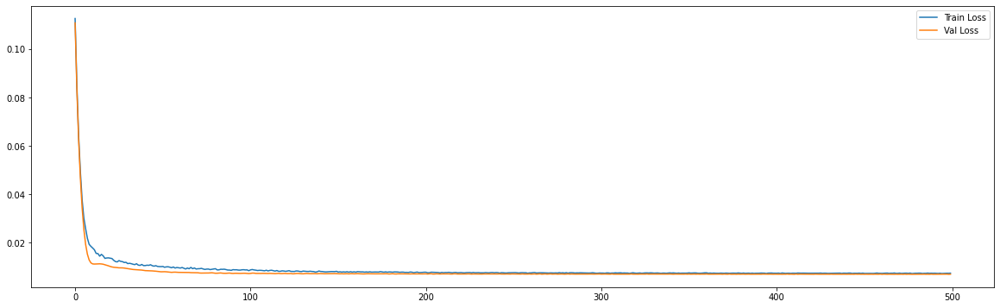

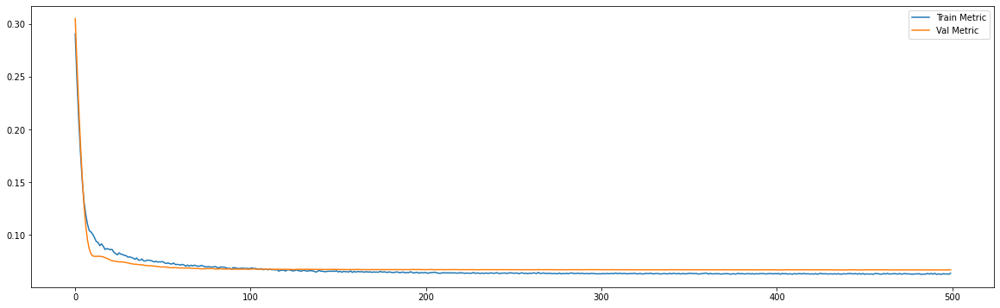

============================model:15===========================
32/32 [==============================] - 0s 8ms/step - loss: 0.0072 - mae: 0.0623
loss and metric train data [0.007180204149335623, 0.062262825667858124]
3/3 [==============================] - 0s 6ms/step - loss: 0.0070 - mae: 0.0672
loss and metric val data [0.006977901794016361, 0.06716050952672958]
3/3 [==============================] - 0s 7ms/step - loss: 0.0146 - mae: 0.0945
loss and metric test data [0.014584078453481197, 0.09453673660755157]


'neurons': 20, 'dropout': 0.4, 'time_steps': 240, 'batch_size':240, 'hidden_layers':2




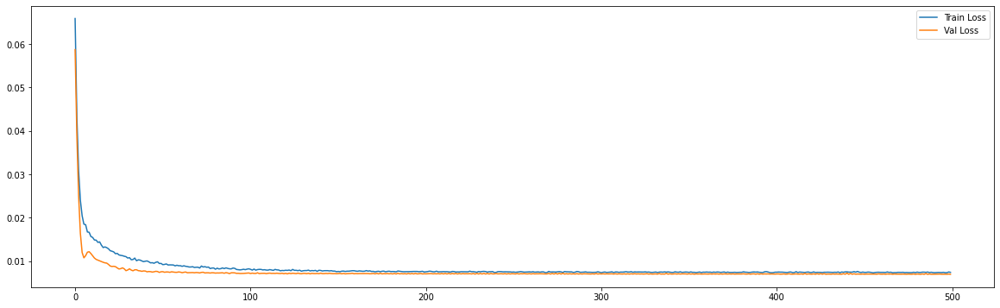

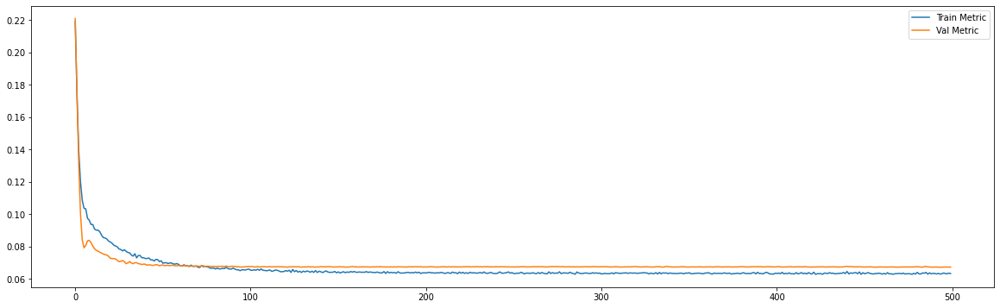

Epoch 00296: early stopping
============================model:16===========================
45/45 [==============================] - 0s 2ms/step - loss: 0.0056 - mae: 0.0556
loss and metric train data [0.005611182190477848, 0.05562274903059006]
9/9 [==============================] - 0s 2ms/step - loss: 0.0050 - mae: 0.0561
loss and metric val data [0.004997094627469778, 0.05613661929965019]
9/9 [==============================] - 0s 2ms/step - loss: 0.0060 - mae: 0.0573
loss and metric test data [0.005984010174870491, 0.057254716753959656]


'neurons': 25, 'dropout': 0.2, 'time_steps': 30, 'batch_size':30, 'learning_rate':0.001, 'hidden_layers':1




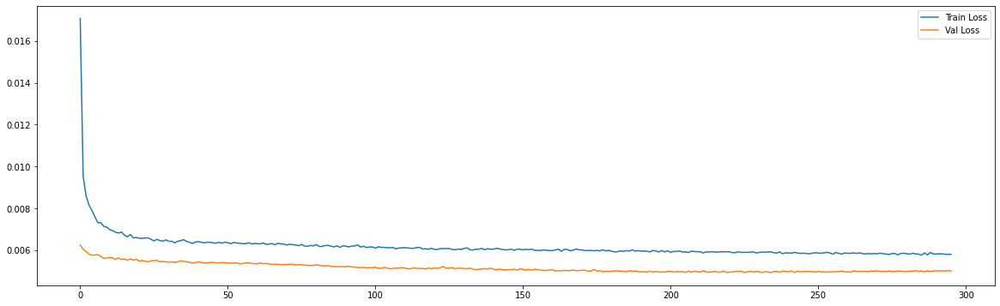

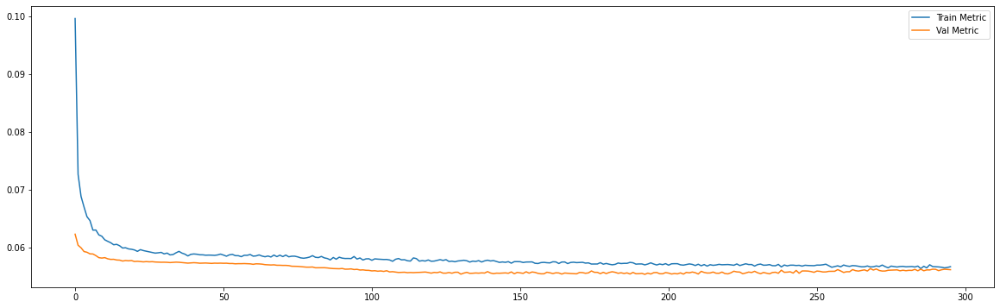

Epoch 00328: early stopping
============================model:17===========================
45/45 [==============================] - 0s 3ms/step - loss: 0.0051 - mae: 0.0537
loss and metric train data [0.005137850064784288, 0.053654994815588]
9/9 [==============================] - 0s 3ms/step - loss: 0.0051 - mae: 0.0555
loss and metric val data [0.005055279470980167, 0.05552301183342934]
9/9 [==============================] - 0s 3ms/step - loss: 0.0059 - mae: 0.0566
loss and metric test data [0.0058618648909032345, 0.05657515674829483]


'neurons': 25, 'dropout': 0.2, 'time_steps': 30, 'batch_size':30, 'hidden_layers':2




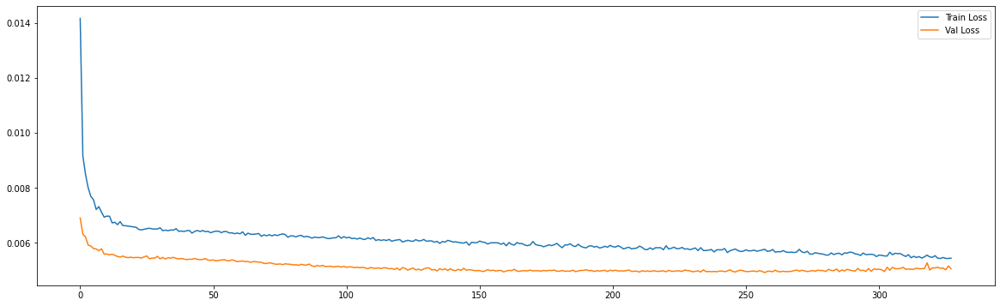

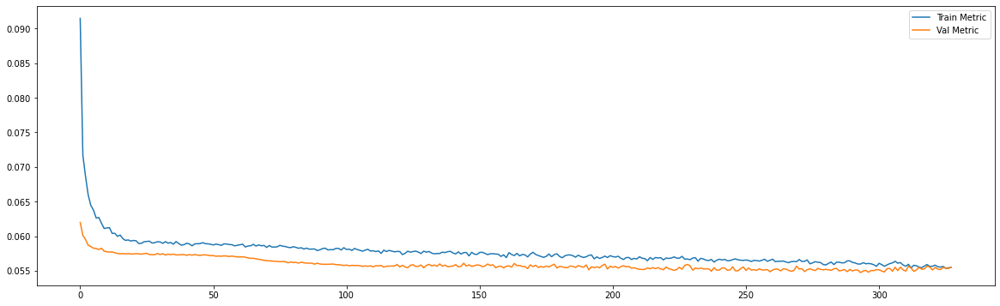

Epoch 00247: early stopping
============================model:18===========================
43/43 [==============================] - 0s 3ms/step - loss: 0.0057 - mae: 0.0555
loss and metric train data [0.005682469345629215, 0.055516794323921204]
8/8 [==============================] - 0s 2ms/step - loss: 0.0049 - mae: 0.0548
loss and metric val data [0.004896311089396477, 0.054845962673425674]
8/8 [==============================] - 0s 2ms/step - loss: 0.0068 - mae: 0.0619
loss and metric test data [0.006787878926843405, 0.06186359003186226]


'neurons': 25, 'dropout': 0.2, 'time_steps': 60, 'batch_size':60, 'learning_rate':0.001, 'hidden_layers':1




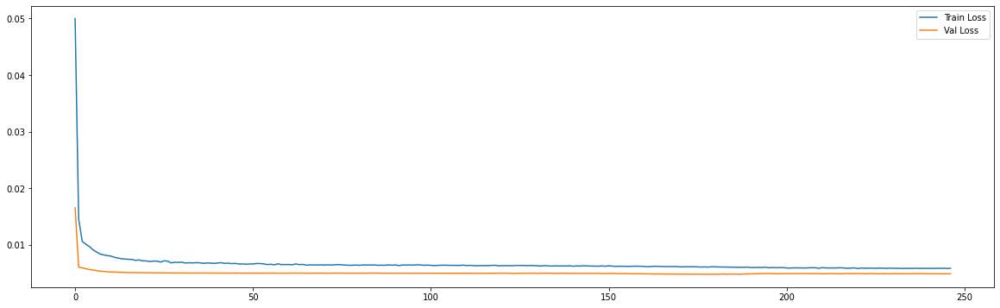

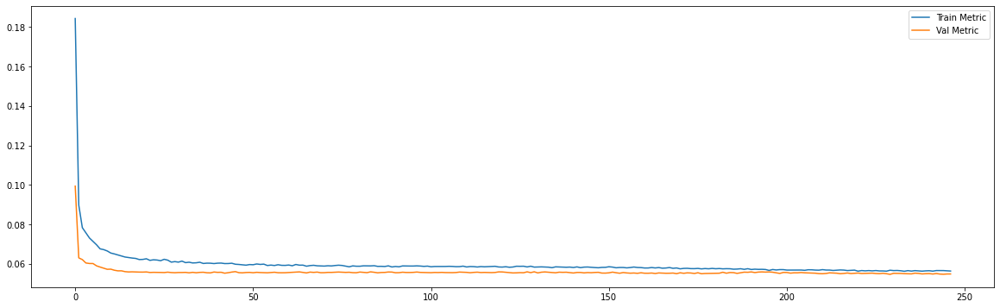

Epoch 00326: early stopping
============================model:19===========================
43/43 [==============================] - 0s 4ms/step - loss: 0.0053 - mae: 0.0547
loss and metric train data [0.005348600447177887, 0.05469784140586853]
8/8 [==============================] - 0s 3ms/step - loss: 0.0050 - mae: 0.0551
loss and metric val data [0.005025070160627365, 0.05507350713014603]
8/8 [==============================] - 0s 3ms/step - loss: 0.0077 - mae: 0.0638
loss and metric test data [0.00770485308021307, 0.06375893950462341]


'neurons': 25, 'dropout': 0.2, 'time_steps': 60, 'batch_size':60, 'hidden_layers':2




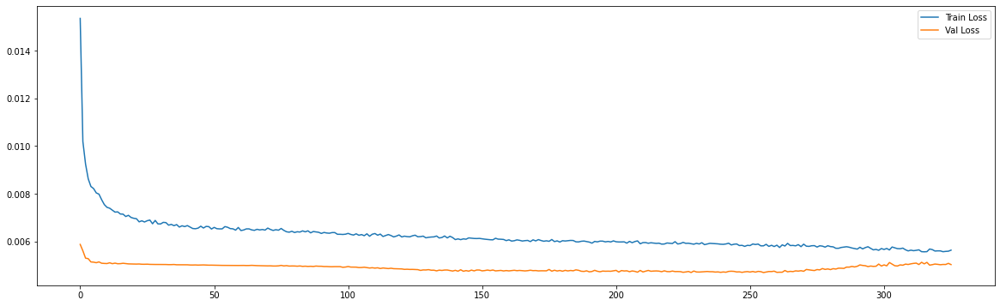

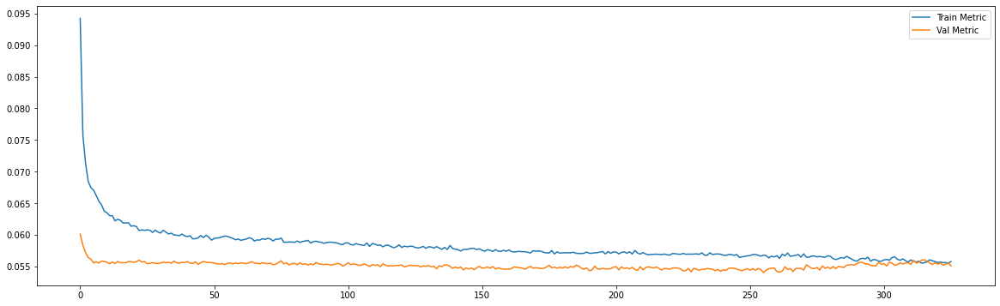

Epoch 00430: early stopping
============================model:20===========================
39/39 [==============================] - 0s 3ms/step - loss: 0.0057 - mae: 0.0556
loss and metric train data [0.0057449787855148315, 0.05562569200992584]
7/7 [==============================] - 0s 3ms/step - loss: 0.0048 - mae: 0.0537
loss and metric val data [0.004804981406778097, 0.05368518829345703]
7/7 [==============================] - 0s 3ms/step - loss: 0.0083 - mae: 0.0695
loss and metric test data [0.00833231583237648, 0.06953907012939453]


'neurons': 25, 'dropout': 0.2, 'time_steps': 120, 'batch_size':120, 'learning_rate':0.001, 'hidden_layers':1




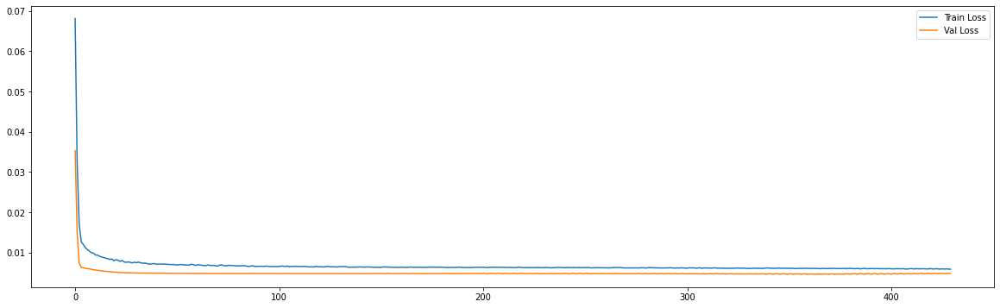

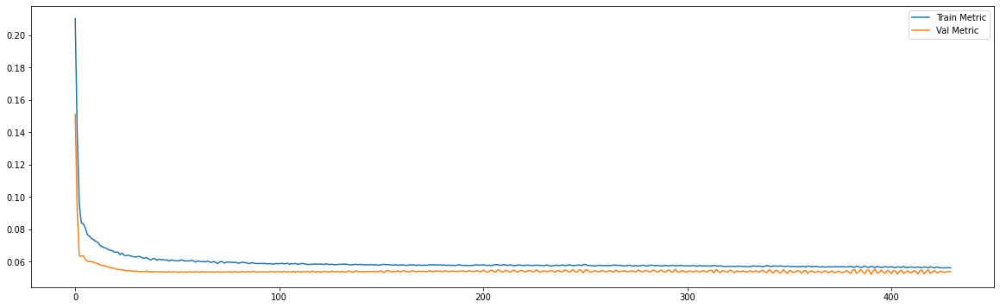

Epoch 00112: early stopping
============================model:21===========================
39/39 [==============================] - 0s 5ms/step - loss: 0.0062 - mae: 0.0575
loss and metric train data [0.006230321247130632, 0.05747496336698532]
7/7 [==============================] - 0s 5ms/step - loss: 0.0048 - mae: 0.0543
loss and metric val data [0.004831386264413595, 0.05429621785879135]
7/7 [==============================] - 0s 4ms/step - loss: 0.0084 - mae: 0.0705
loss and metric test data [0.008436816744506359, 0.0705462098121643]


'neurons': 25, 'dropout': 0.2, 'time_steps': 120, 'batch_size':120, 'hidden_layers':2




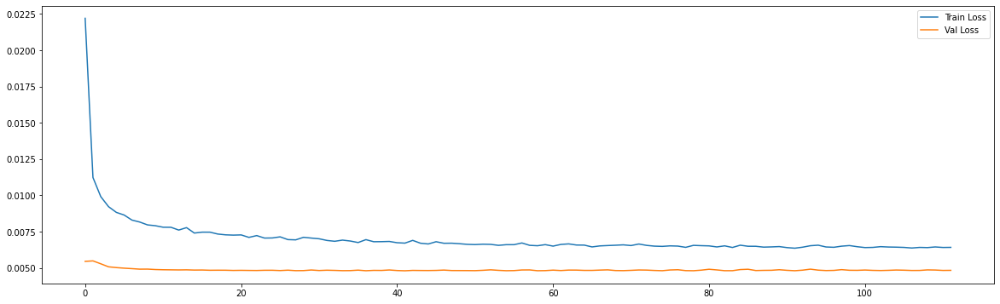

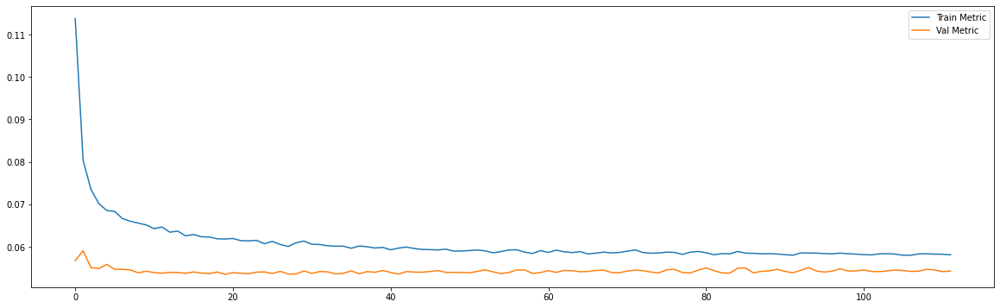

============================model:22===========================
32/32 [==============================] - 0s 5ms/step - loss: 0.0070 - mae: 0.0614
loss and metric train data [0.006978021934628487, 0.06136983260512352]
3/3 [==============================] - 0s 4ms/step - loss: 0.0069 - mae: 0.0658
loss and metric val data [0.006901056505739689, 0.06582397222518921]
3/3 [==============================] - 0s 4ms/step - loss: 0.0142 - mae: 0.0936
loss and metric test data [0.014161031693220139, 0.09362608939409256]


'neurons': 25, 'dropout': 0.2, 'time_steps': 240, 'batch_size':240, 'learning_rate':0.001, 'hidden_layers':1




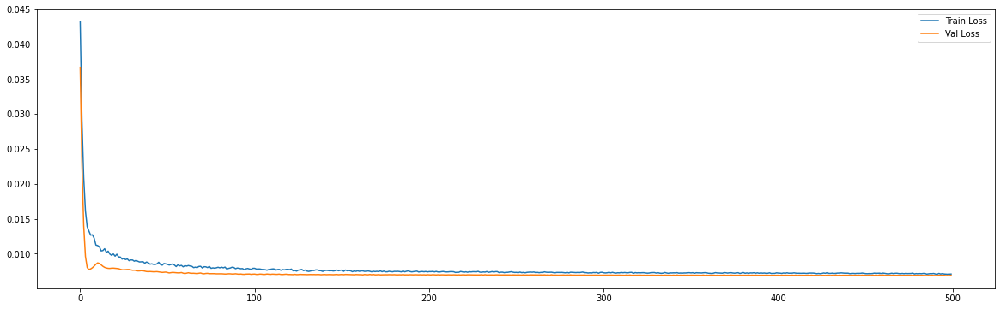

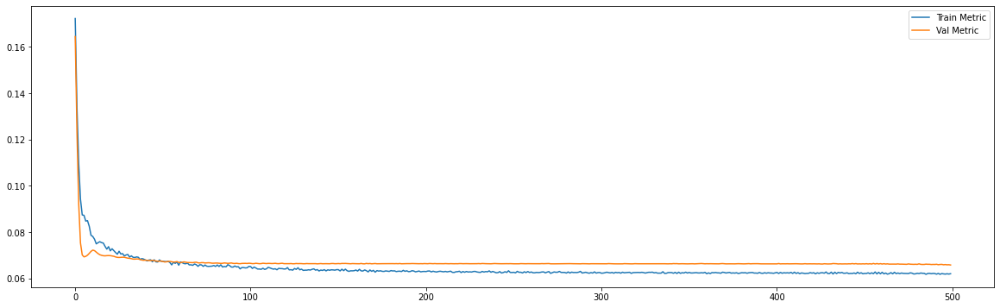

============================model:23===========================
32/32 [==============================] - 0s 8ms/step - loss: 0.0067 - mae: 0.0607
loss and metric train data [0.006722932681441307, 0.060747262090444565]
3/3 [==============================] - 0s 6ms/step - loss: 0.0063 - mae: 0.0640
loss and metric val data [0.0063164508901536465, 0.06395310908555984]
3/3 [==============================] - 0s 6ms/step - loss: 0.0142 - mae: 0.0917
loss and metric test data [0.014181447215378284, 0.0917467549443245]


'neurons': 25, 'dropout': 0.2, 'time_steps': 240, 'batch_size':240, 'hidden_layers':2




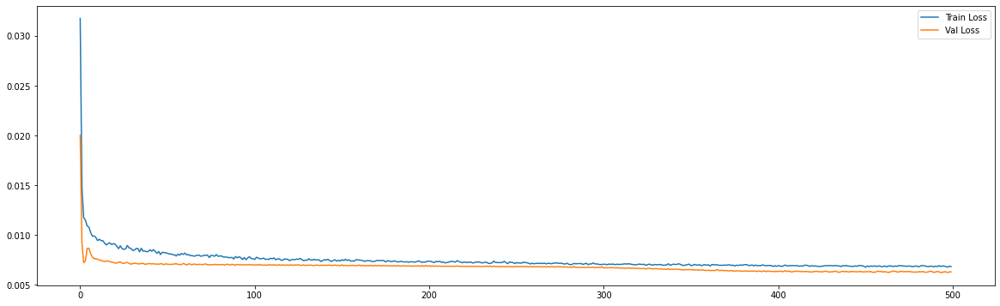

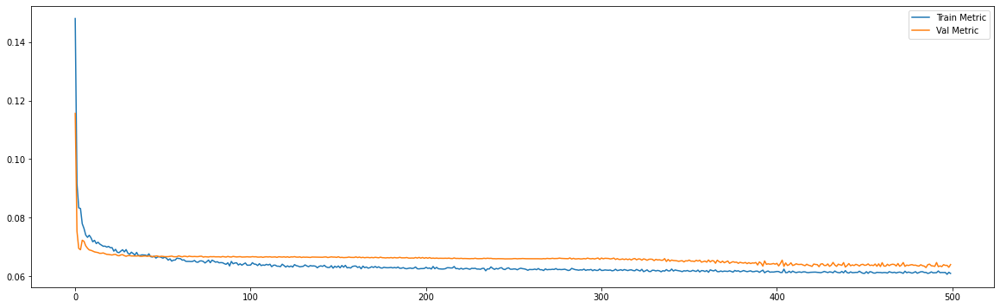

Epoch 00347: early stopping
============================model:24===========================
45/45 [==============================] - 0s 2ms/step - loss: 0.0056 - mae: 0.0557
loss and metric train data [0.005615628324449062, 0.055698223412036896]
9/9 [==============================] - 0s 2ms/step - loss: 0.0050 - mae: 0.0564
loss and metric val data [0.0050179618410766125, 0.05643025040626526]
9/9 [==============================] - 0s 2ms/step - loss: 0.0061 - mae: 0.0575
loss and metric test data [0.006124572828412056, 0.057480987161397934]


'neurons': 25, 'dropout': 0.4, 'time_steps': 30, 'batch_size':30, 'learning_rate':0.001, 'hidden_layers':1




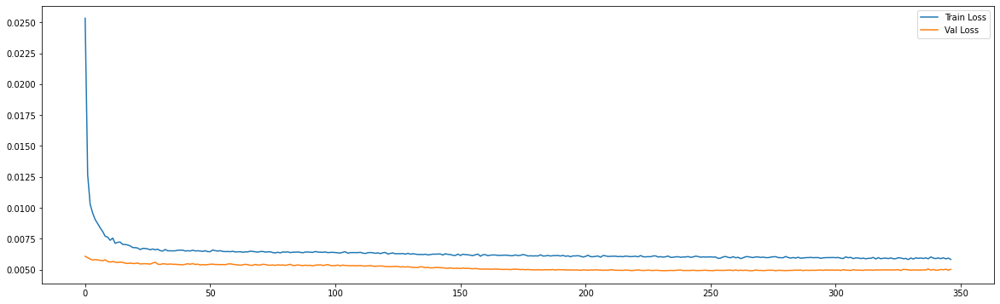

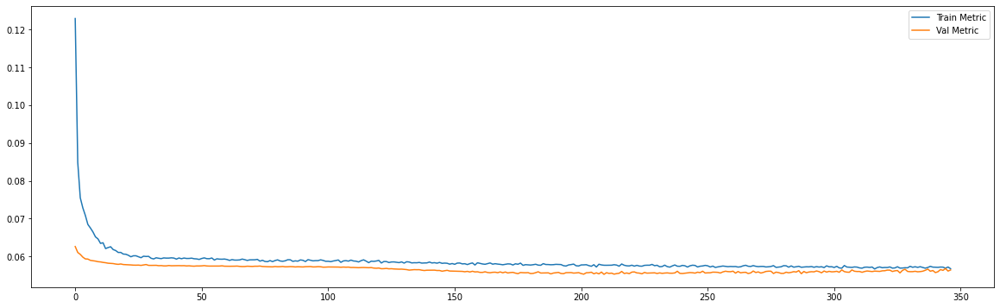

Epoch 00304: early stopping
============================model:25===========================
45/45 [==============================] - 0s 3ms/step - loss: 0.0056 - mae: 0.0552
loss and metric train data [0.00556762283667922, 0.05518612638115883]
9/9 [==============================] - 0s 3ms/step - loss: 0.0050 - mae: 0.0553
loss and metric val data [0.004974287003278732, 0.055250052362680435]
9/9 [==============================] - 0s 3ms/step - loss: 0.0066 - mae: 0.0578
loss and metric test data [0.006627589464187622, 0.057782527059316635]


'neurons': 25, 'dropout': 0.4, 'time_steps': 30, 'batch_size':30, 'hidden_layers':2




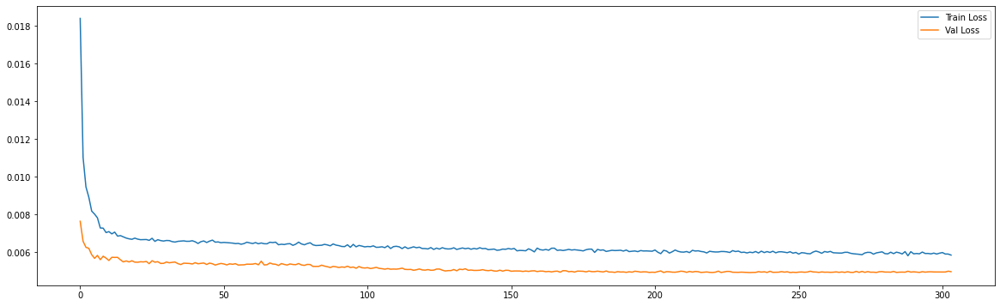

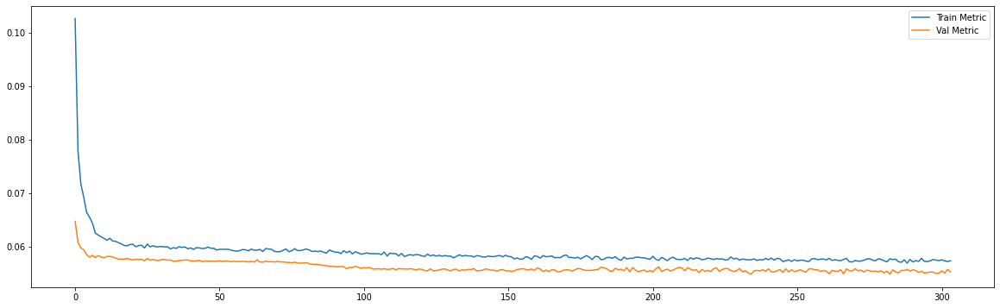

Epoch 00238: early stopping
============================model:26===========================
43/43 [==============================] - 0s 3ms/step - loss: 0.0058 - mae: 0.0556
loss and metric train data [0.005757329985499382, 0.05557224527001381]
8/8 [==============================] - 0s 3ms/step - loss: 0.0049 - mae: 0.0546
loss and metric val data [0.0049095069989562035, 0.05460841581225395]
8/8 [==============================] - 0s 2ms/step - loss: 0.0069 - mae: 0.0625
loss and metric test data [0.006925862282514572, 0.06251558661460876]


'neurons': 25, 'dropout': 0.4, 'time_steps': 60, 'batch_size':60, 'learning_rate':0.001, 'hidden_layers':1




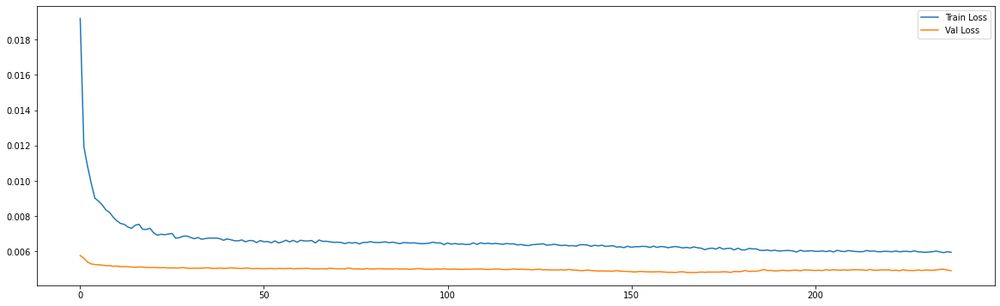

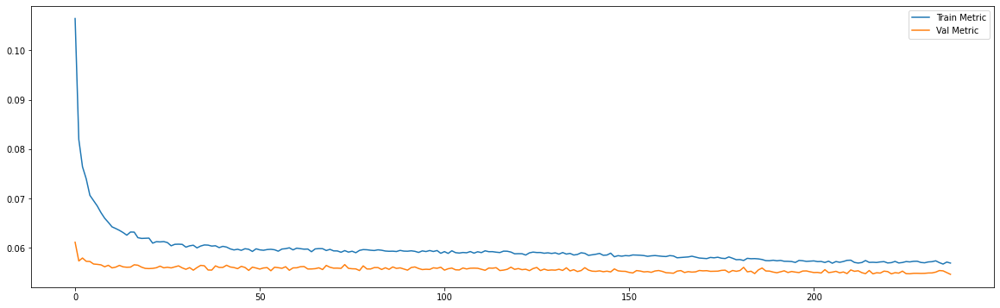

Epoch 00349: early stopping
============================model:27===========================
43/43 [==============================] - 0s 4ms/step - loss: 0.0055 - mae: 0.0555
loss and metric train data [0.005525321699678898, 0.055478353053331375]
8/8 [==============================] - 0s 3ms/step - loss: 0.0048 - mae: 0.0552
loss and metric val data [0.004825943149626255, 0.05520214885473251]
8/8 [==============================] - 0s 3ms/step - loss: 0.0071 - mae: 0.0624
loss and metric test data [0.007062946446239948, 0.06239938735961914]


'neurons': 25, 'dropout': 0.4, 'time_steps': 60, 'batch_size':60, 'hidden_layers':2




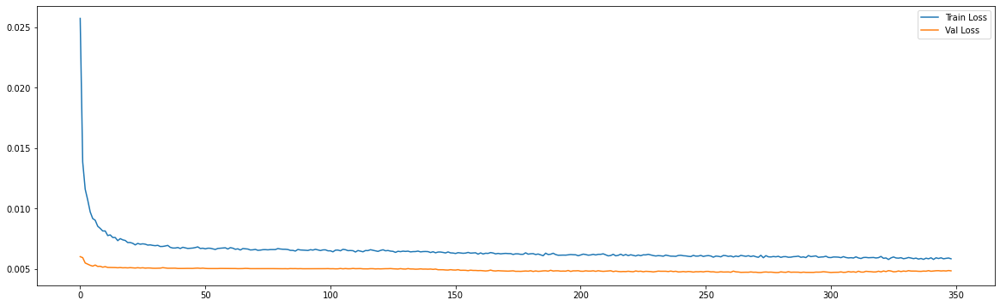

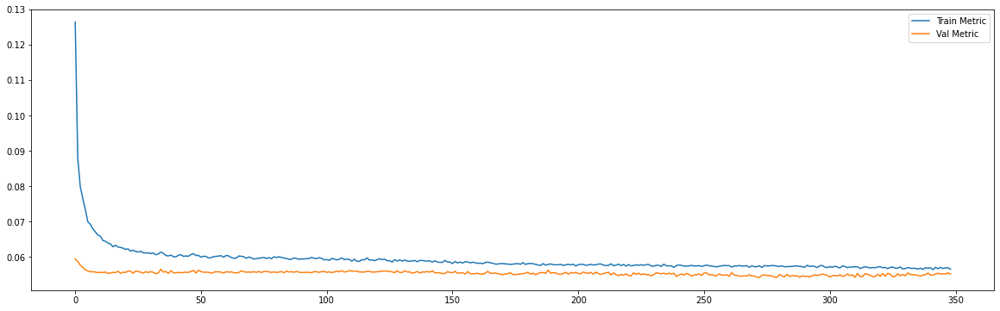

Epoch 00343: early stopping
============================model:28===========================
39/39 [==============================] - 0s 3ms/step - loss: 0.0059 - mae: 0.0559
loss and metric train data [0.005854784976691008, 0.055939722806215286]
7/7 [==============================] - 0s 3ms/step - loss: 0.0048 - mae: 0.0540
loss and metric val data [0.004782811272889376, 0.05397482216358185]
7/7 [==============================] - 0s 3ms/step - loss: 0.0084 - mae: 0.0695
loss and metric test data [0.008353815414011478, 0.06949660181999207]


'neurons': 25, 'dropout': 0.4, 'time_steps': 120, 'batch_size':120, 'learning_rate':0.001, 'hidden_layers':1




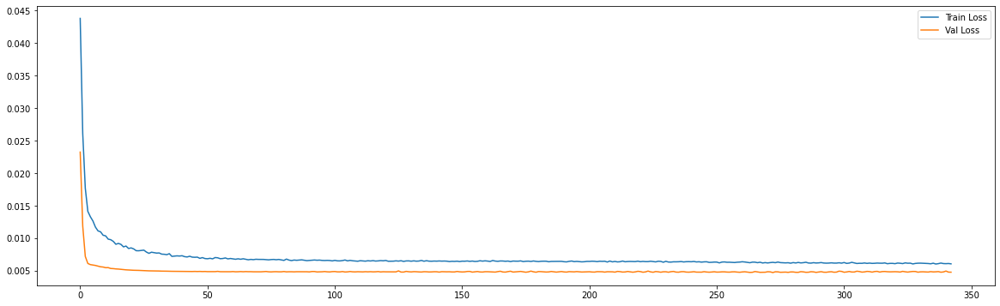

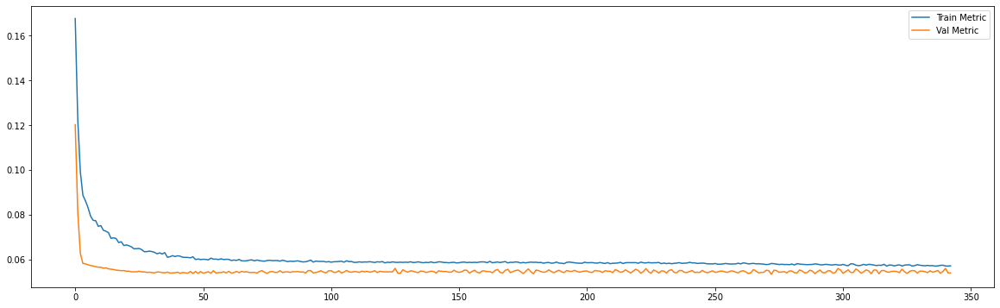

Epoch 00136: early stopping
============================model:29===========================
39/39 [==============================] - 0s 6ms/step - loss: 0.0063 - mae: 0.0575
loss and metric train data [0.00625248858705163, 0.05754479393362999]
7/7 [==============================] - 0s 5ms/step - loss: 0.0048 - mae: 0.0546
loss and metric val data [0.004841228481382132, 0.05463339015841484]
7/7 [==============================] - 0s 5ms/step - loss: 0.0085 - mae: 0.0704
loss and metric test data [0.00845935195684433, 0.07038021087646484]


'neurons': 25, 'dropout': 0.4, 'time_steps': 120, 'batch_size':120, 'hidden_layers':2




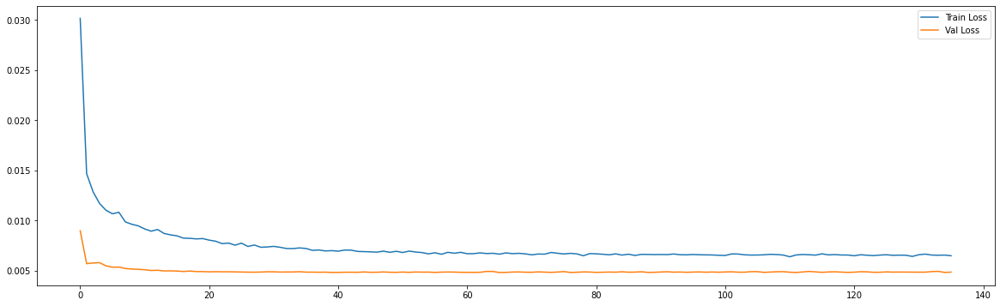

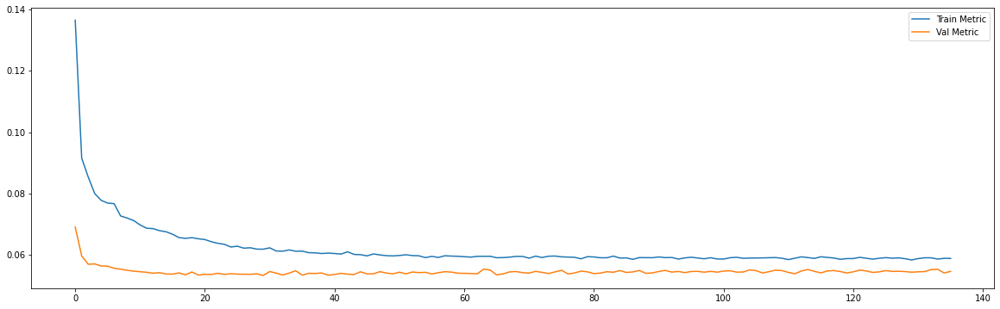

============================model:30===========================
32/32 [==============================] - 0s 5ms/step - loss: 0.0069 - mae: 0.0610
loss and metric train data [0.006949974689632654, 0.06096799671649933]
3/3 [==============================] - 0s 4ms/step - loss: 0.0068 - mae: 0.0656
loss and metric val data [0.0067550805397331715, 0.06557154655456543]
3/3 [==============================] - 0s 4ms/step - loss: 0.0143 - mae: 0.0933
loss and metric test data [0.014339598827064037, 0.09327850490808487]


'neurons': 25, 'dropout': 0.4, 'time_steps': 240, 'batch_size':240, 'learning_rate':0.001, 'hidden_layers':1




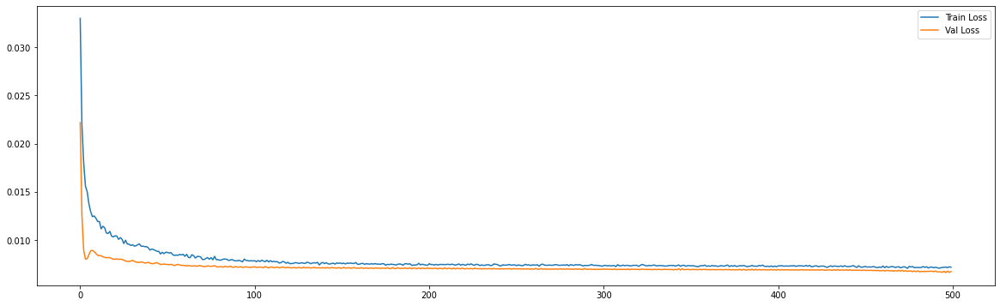

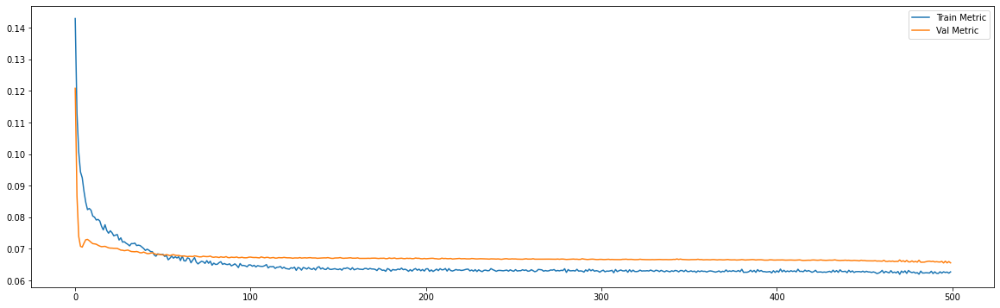

============================model:31===========================
32/32 [==============================] - 0s 8ms/step - loss: 0.0070 - mae: 0.0608
loss and metric train data [0.006955412216484547, 0.06079573929309845]
3/3 [==============================] - 0s 6ms/step - loss: 0.0066 - mae: 0.0649
loss and metric val data [0.00664981734007597, 0.06492797285318375]
3/3 [==============================] - 0s 6ms/step - loss: 0.0146 - mae: 0.0931
loss and metric test data [0.014565431512892246, 0.09312945604324341]


'neurons': 25, 'dropout': 0.4, 'time_steps': 240, 'batch_size':240, 'hidden_layers':2




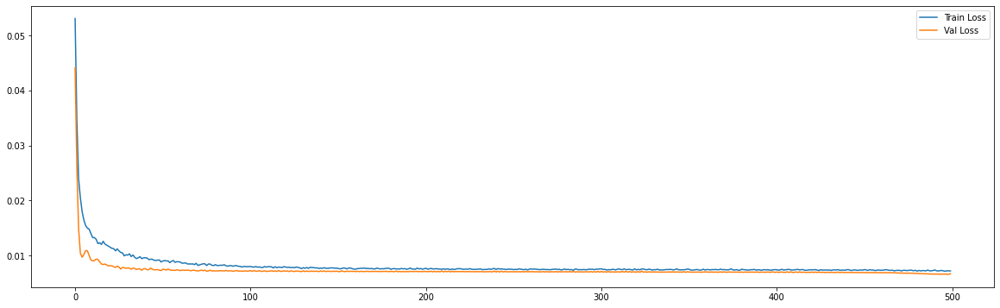

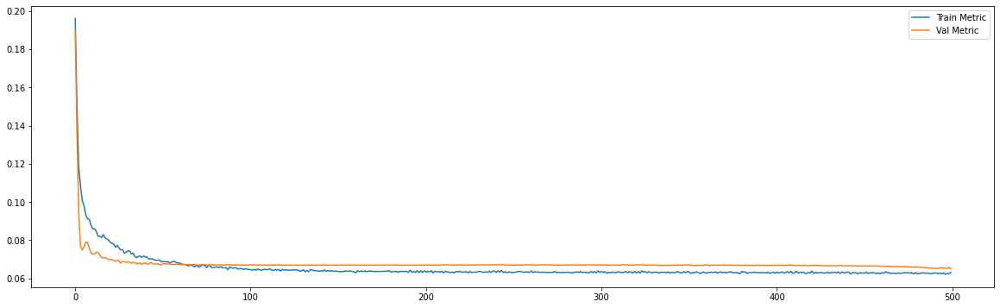

Epoch 00266: early stopping
============================model:32===========================
45/45 [==============================] - 0s 2ms/step - loss: 0.0056 - mae: 0.0556
loss and metric train data [0.005569870118051767, 0.05557886138558388]
9/9 [==============================] - 0s 2ms/step - loss: 0.0051 - mae: 0.0563
loss and metric val data [0.005059802904725075, 0.056259870529174805]
9/9 [==============================] - 0s 2ms/step - loss: 0.0063 - mae: 0.0577
loss and metric test data [0.006261090748012066, 0.0577348954975605]


'neurons': 30, 'dropout': 0.2, 'time_steps': 30, 'batch_size':30, 'learning_rate':0.001, 'hidden_layers':1




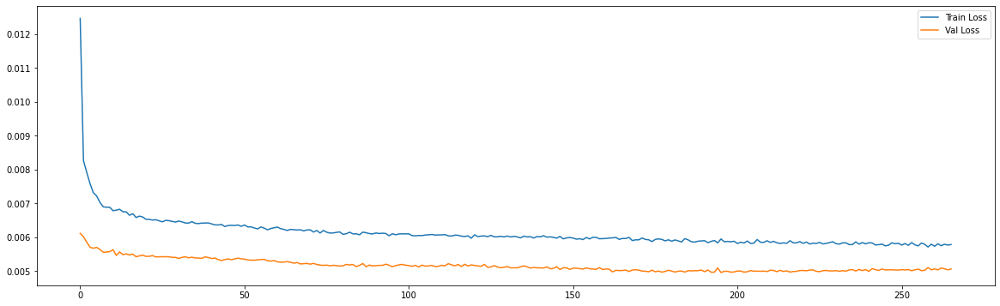

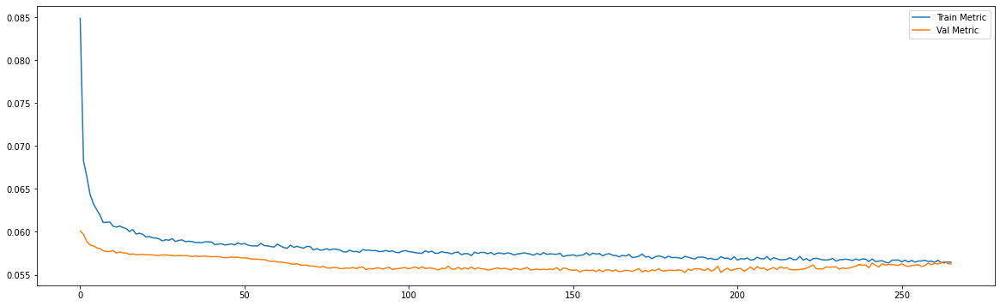

Epoch 00213: early stopping
============================model:33===========================
45/45 [==============================] - 0s 3ms/step - loss: 0.0055 - mae: 0.0551
loss and metric train data [0.005469282157719135, 0.055053409188985825]
9/9 [==============================] - 0s 3ms/step - loss: 0.0050 - mae: 0.0550
loss and metric val data [0.005021486431360245, 0.05501900240778923]
9/9 [==============================] - 0s 3ms/step - loss: 0.0060 - mae: 0.0562
loss and metric test data [0.006021958775818348, 0.05623187869787216]


'neurons': 30, 'dropout': 0.2, 'time_steps': 30, 'batch_size':30, 'hidden_layers':2




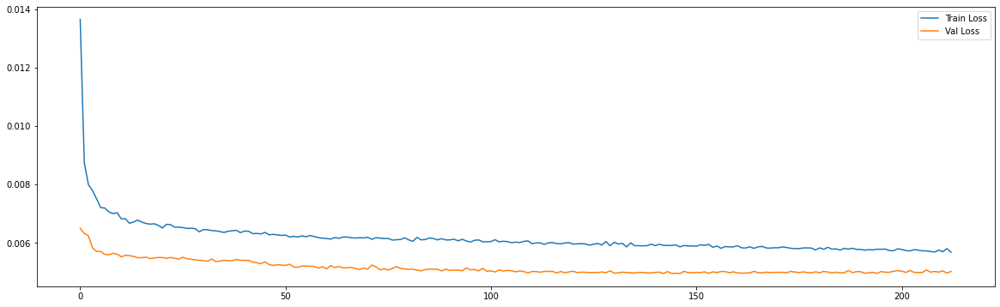

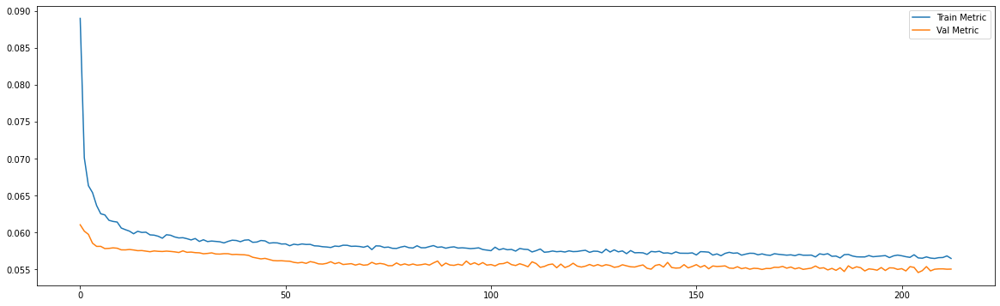

Epoch 00260: early stopping
============================model:34===========================
43/43 [==============================] - 0s 3ms/step - loss: 0.0056 - mae: 0.0552
loss and metric train data [0.0056389798410236835, 0.0552472248673439]
8/8 [==============================] - 0s 3ms/step - loss: 0.0049 - mae: 0.0547
loss and metric val data [0.0049188388511538506, 0.054717790335416794]
8/8 [==============================] - 0s 2ms/step - loss: 0.0072 - mae: 0.0631
loss and metric test data [0.007173735648393631, 0.06307116150856018]


'neurons': 30, 'dropout': 0.2, 'time_steps': 60, 'batch_size':60, 'learning_rate':0.001, 'hidden_layers':1




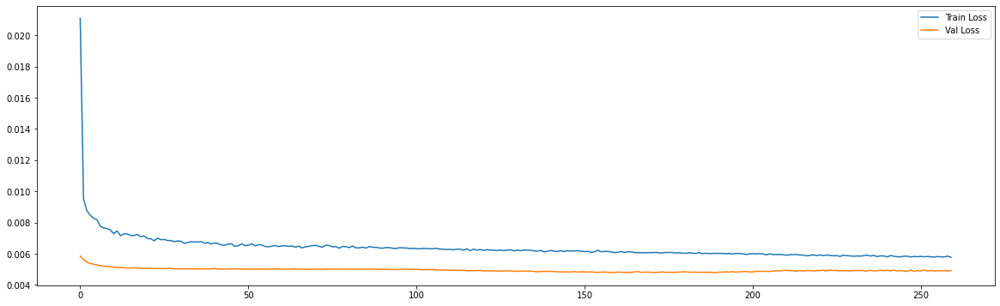

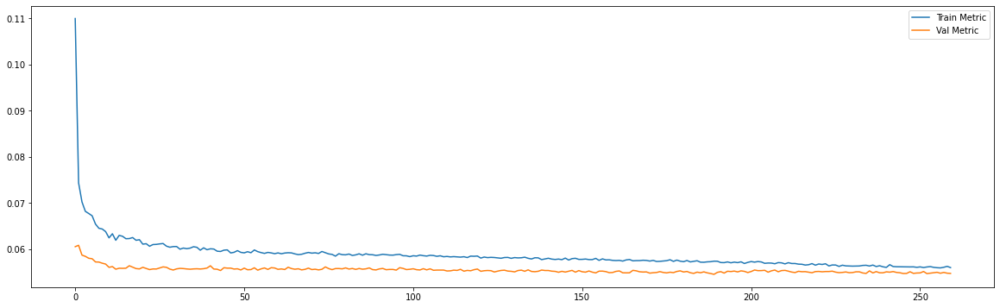

Epoch 00282: early stopping
============================model:35===========================
43/43 [==============================] - 0s 4ms/step - loss: 0.0055 - mae: 0.0556
loss and metric train data [0.005471284966915846, 0.05564844235777855]
8/8 [==============================] - 0s 3ms/step - loss: 0.0050 - mae: 0.0557
loss and metric val data [0.004997678101062775, 0.055705852806568146]
8/8 [==============================] - 0s 3ms/step - loss: 0.0081 - mae: 0.0639
loss and metric test data [0.008107300847768784, 0.06387535482645035]


'neurons': 30, 'dropout': 0.2, 'time_steps': 60, 'batch_size':60, 'hidden_layers':2




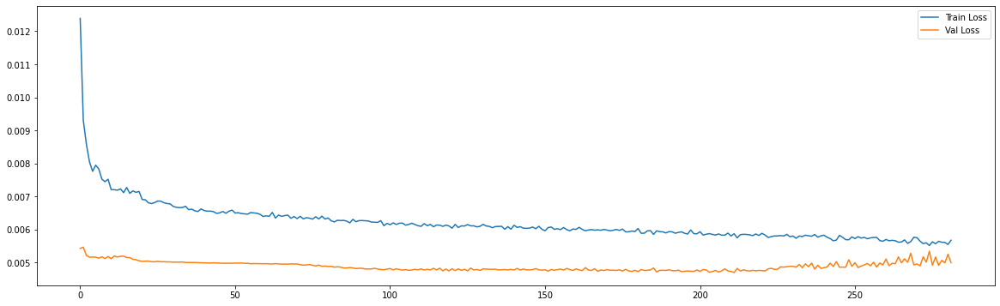

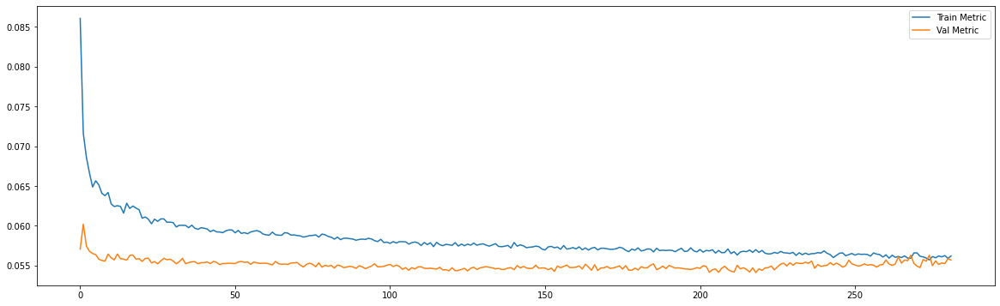

Epoch 00233: early stopping
============================model:36===========================
39/39 [==============================] - 0s 3ms/step - loss: 0.0061 - mae: 0.0579
loss and metric train data [0.006121754180639982, 0.05786765366792679]
7/7 [==============================] - 0s 3ms/step - loss: 0.0050 - mae: 0.0554
loss and metric val data [0.00497417664155364, 0.055430009961128235]
7/7 [==============================] - 0s 3ms/step - loss: 0.0083 - mae: 0.0705
loss and metric test data [0.008298459462821484, 0.07050929963588715]


'neurons': 30, 'dropout': 0.2, 'time_steps': 120, 'batch_size':120, 'learning_rate':0.001, 'hidden_layers':1




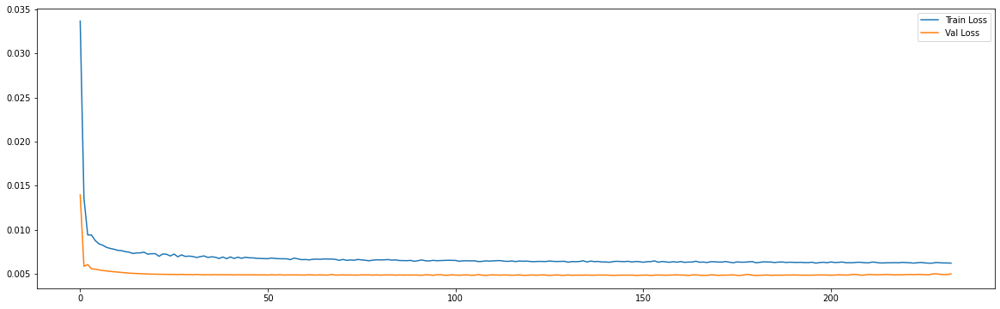

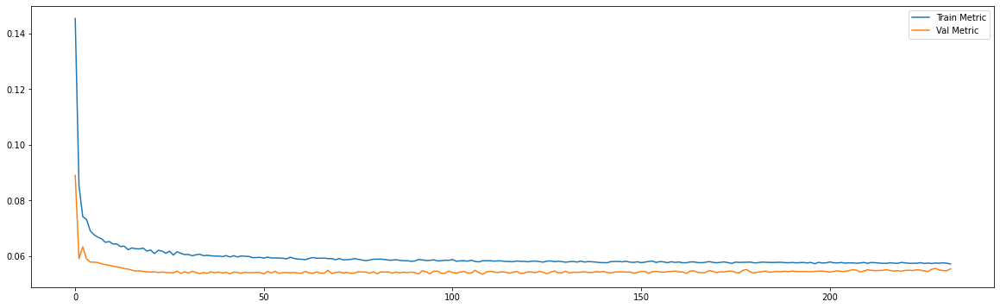

Epoch 00309: early stopping
============================model:37===========================
39/39 [==============================] - 0s 5ms/step - loss: 0.0058 - mae: 0.0563
loss and metric train data [0.005755263846367598, 0.05631618946790695]
7/7 [==============================] - 0s 6ms/step - loss: 0.0049 - mae: 0.0551
loss and metric val data [0.004887048155069351, 0.05505687743425369]
7/7 [==============================] - 0s 5ms/step - loss: 0.0084 - mae: 0.0705
loss and metric test data [0.008424789644777775, 0.07053451240062714]


'neurons': 30, 'dropout': 0.2, 'time_steps': 120, 'batch_size':120, 'hidden_layers':2




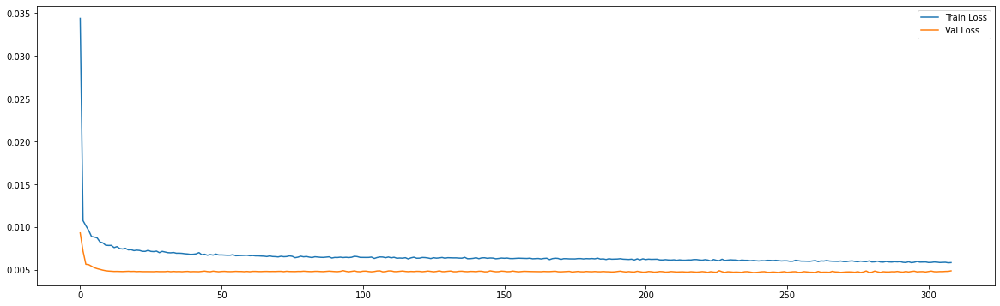

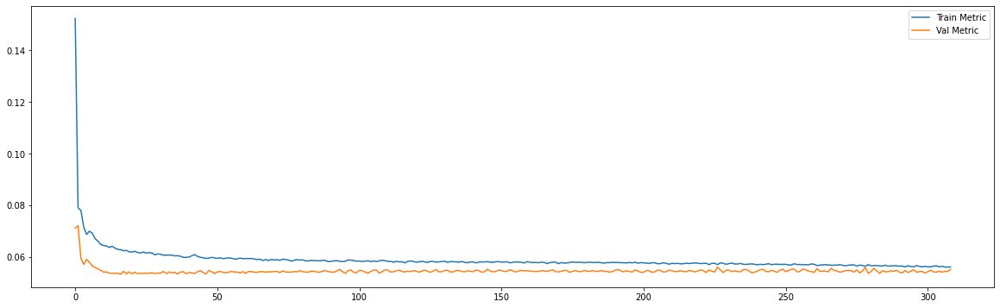

============================model:38===========================
32/32 [==============================] - 0s 5ms/step - loss: 0.0068 - mae: 0.0607
loss and metric train data [0.006768236868083477, 0.06072201207280159]
3/3 [==============================] - 0s 4ms/step - loss: 0.0063 - mae: 0.0640
loss and metric val data [0.006309094373136759, 0.06402858346700668]
3/3 [==============================] - 0s 4ms/step - loss: 0.0141 - mae: 0.0929
loss and metric test data [0.014089680276811123, 0.09287014603614807]


'neurons': 30, 'dropout': 0.2, 'time_steps': 240, 'batch_size':240, 'learning_rate':0.001, 'hidden_layers':1




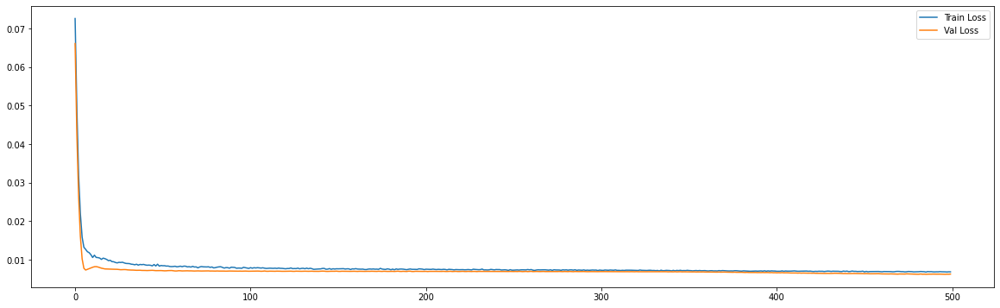

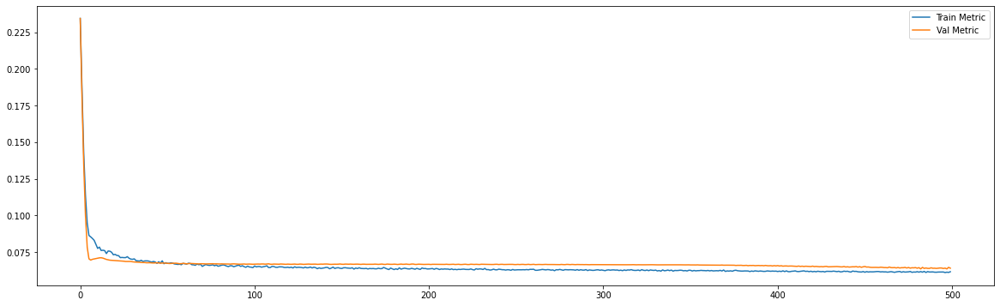

============================model:39===========================
32/32 [==============================] - 0s 8ms/step - loss: 0.0066 - mae: 0.0602
loss and metric train data [0.006579666398465633, 0.06023883447051048]
3/3 [==============================] - 0s 6ms/step - loss: 0.0062 - mae: 0.0637
loss and metric val data [0.006168176420032978, 0.06369967758655548]
3/3 [==============================] - 0s 6ms/step - loss: 0.0140 - mae: 0.0928
loss and metric test data [0.013964317739009857, 0.09281257539987564]


'neurons': 30, 'dropout': 0.2, 'time_steps': 240, 'batch_size':240, 'hidden_layers':2




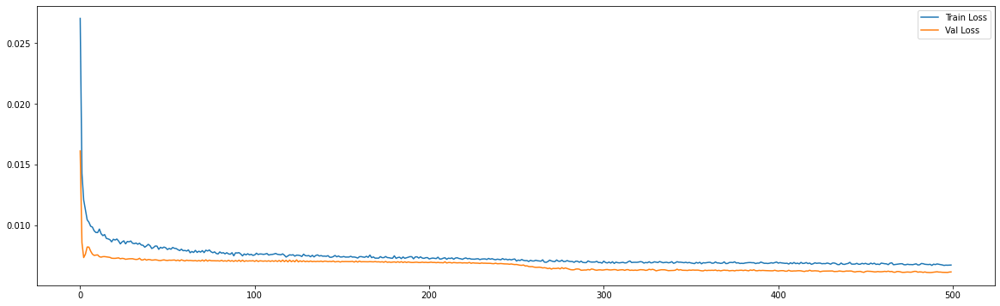

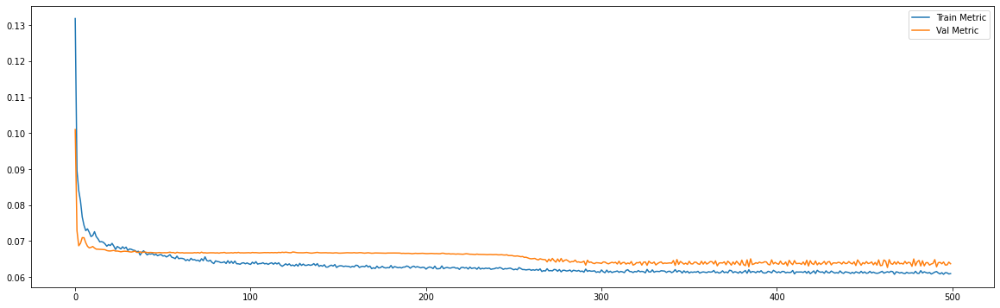

Epoch 00286: early stopping
============================model:40===========================
45/45 [==============================] - 0s 2ms/step - loss: 0.0057 - mae: 0.0558
loss and metric train data [0.0056693400256335735, 0.05584195628762245]
9/9 [==============================] - 0s 2ms/step - loss: 0.0050 - mae: 0.0561
loss and metric val data [0.005013229325413704, 0.0561499148607254]
9/9 [==============================] - 0s 2ms/step - loss: 0.0059 - mae: 0.0568
loss and metric test data [0.005949934478849173, 0.05679069831967354]


'neurons': 30, 'dropout': 0.4, 'time_steps': 30, 'batch_size':30, 'learning_rate':0.001, 'hidden_layers':1




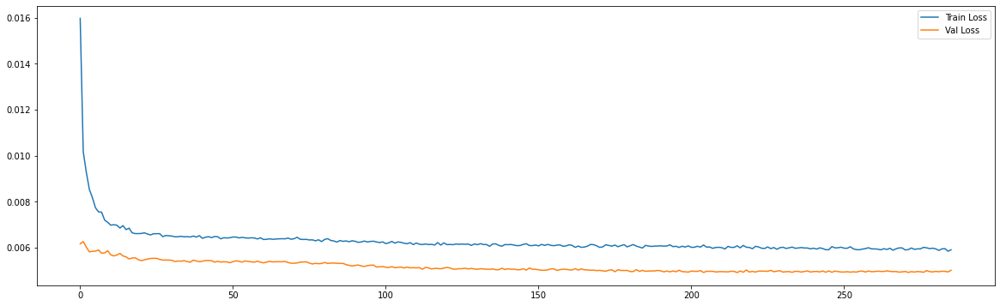

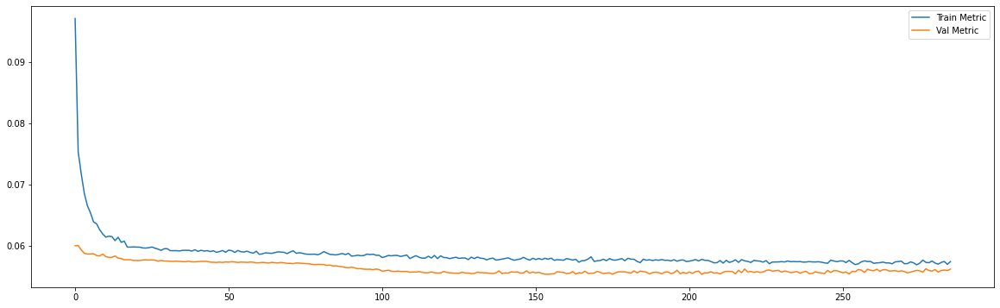

Epoch 00313: early stopping
============================model:41===========================
45/45 [==============================] - 0s 3ms/step - loss: 0.0053 - mae: 0.0545
loss and metric train data [0.005256154108792543, 0.05447961762547493]
9/9 [==============================] - 0s 3ms/step - loss: 0.0052 - mae: 0.0566
loss and metric val data [0.005233522038906813, 0.0565587542951107]
9/9 [==============================] - 0s 4ms/step - loss: 0.0062 - mae: 0.0565
loss and metric test data [0.0061995224095880985, 0.05649459362030029]


'neurons': 30, 'dropout': 0.4, 'time_steps': 30, 'batch_size':30, 'hidden_layers':2




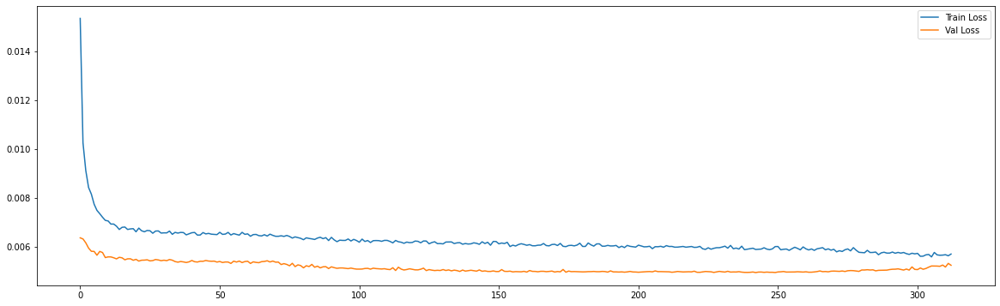

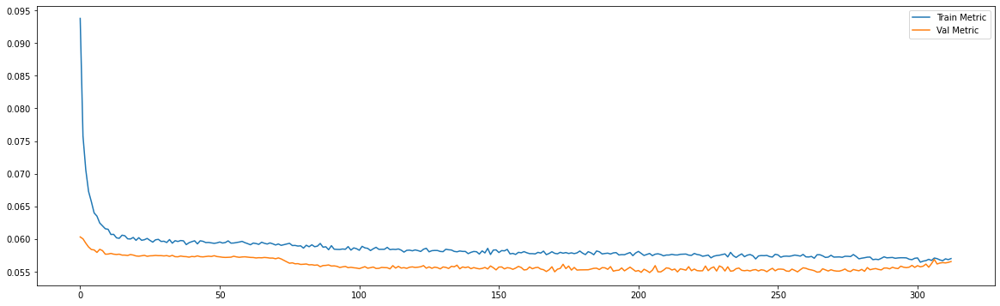

Epoch 00324: early stopping
============================model:42===========================
43/43 [==============================] - 0s 3ms/step - loss: 0.0057 - mae: 0.0557
loss and metric train data [0.005689442623406649, 0.055722616612911224]
8/8 [==============================] - 0s 2ms/step - loss: 0.0049 - mae: 0.0548
loss and metric val data [0.004863807465881109, 0.054827820509672165]
8/8 [==============================] - 0s 2ms/step - loss: 0.0071 - mae: 0.0634
loss and metric test data [0.00709392549470067, 0.06340939551591873]


'neurons': 30, 'dropout': 0.4, 'time_steps': 60, 'batch_size':60, 'learning_rate':0.001, 'hidden_layers':1




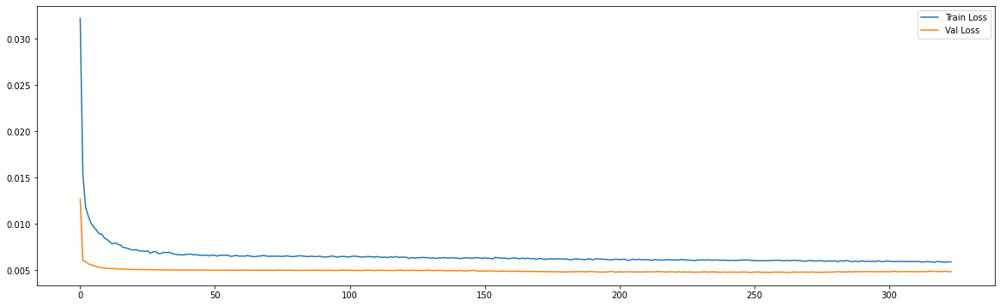

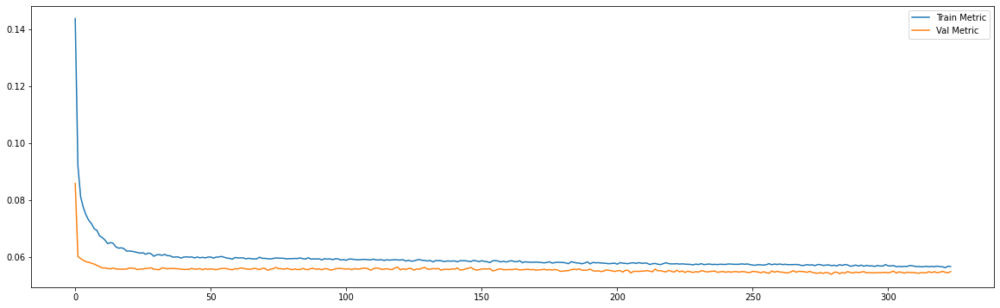

Epoch 00336: early stopping
============================model:43===========================
43/43 [==============================] - 0s 4ms/step - loss: 0.0055 - mae: 0.0555
loss and metric train data [0.00550623657181859, 0.05550042912364006]
8/8 [==============================] - 0s 3ms/step - loss: 0.0049 - mae: 0.0558
loss and metric val data [0.0049050915986299515, 0.055789463222026825]
8/8 [==============================] - 0s 3ms/step - loss: 0.0077 - mae: 0.0641
loss and metric test data [0.007658518385142088, 0.06408973783254623]


'neurons': 30, 'dropout': 0.4, 'time_steps': 60, 'batch_size':60, 'hidden_layers':2




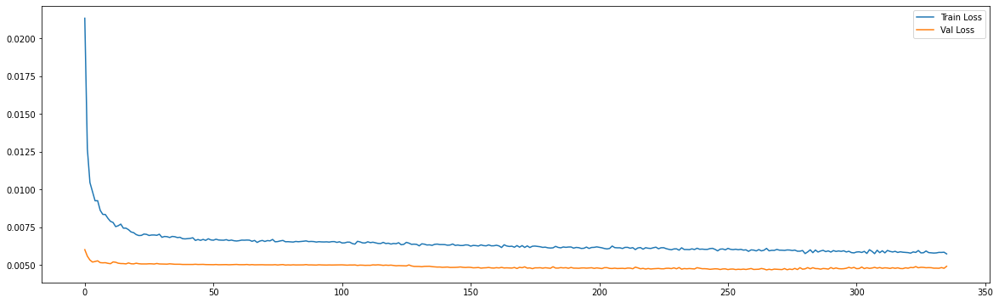

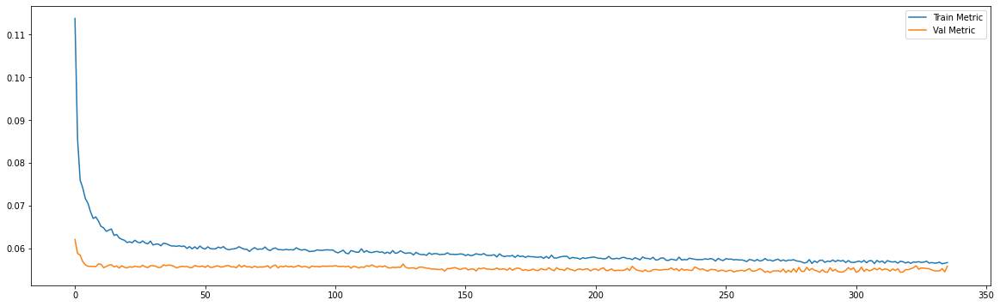

Epoch 00380: early stopping
============================model:44===========================
39/39 [==============================] - 0s 4ms/step - loss: 0.0058 - mae: 0.0557
loss and metric train data [0.005785815883427858, 0.055704452097415924]
7/7 [==============================] - 0s 3ms/step - loss: 0.0048 - mae: 0.0538
loss and metric val data [0.0048187789507210255, 0.05383841693401337]
7/7 [==============================] - 0s 3ms/step - loss: 0.0082 - mae: 0.0691
loss and metric test data [0.008243047632277012, 0.06905855238437653]


'neurons': 30, 'dropout': 0.4, 'time_steps': 120, 'batch_size':120, 'learning_rate':0.001, 'hidden_layers':1




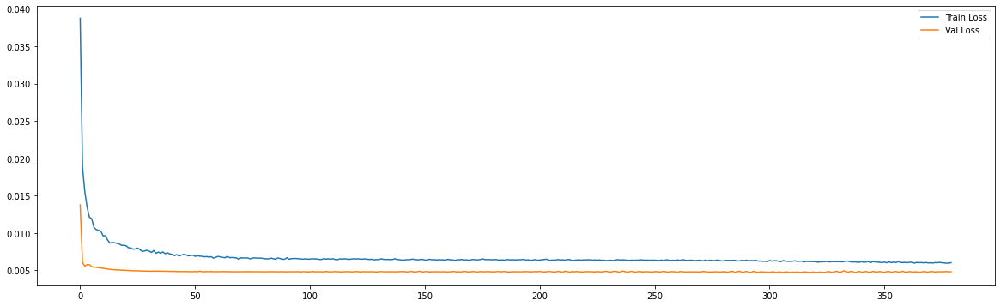

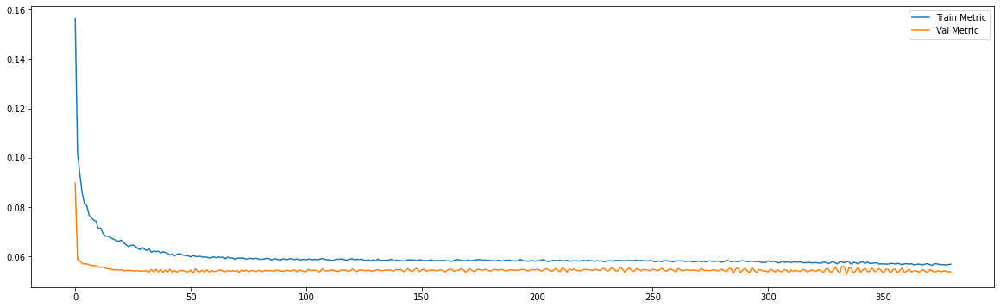

Epoch 00134: early stopping
============================model:45===========================
39/39 [==============================] - 0s 5ms/step - loss: 0.0062 - mae: 0.0573
loss and metric train data [0.006214058957993984, 0.05726626515388489]
7/7 [==============================] - 0s 5ms/step - loss: 0.0048 - mae: 0.0543
loss and metric val data [0.0047982740215957165, 0.054261479526758194]
7/7 [==============================] - 0s 6ms/step - loss: 0.0084 - mae: 0.0701
loss and metric test data [0.00839039497077465, 0.0701318308711052]


'neurons': 30, 'dropout': 0.4, 'time_steps': 120, 'batch_size':120, 'hidden_layers':2




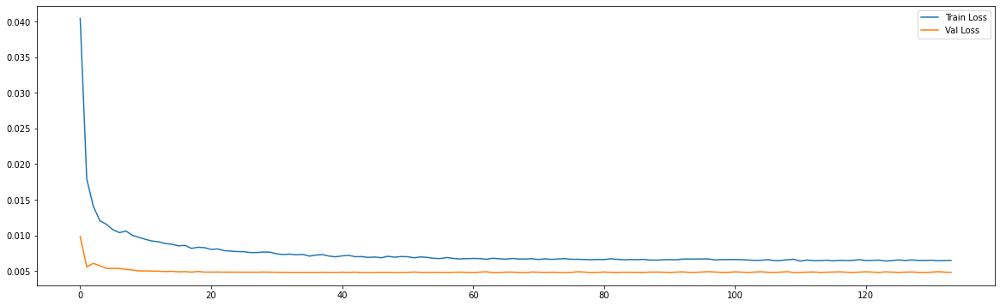

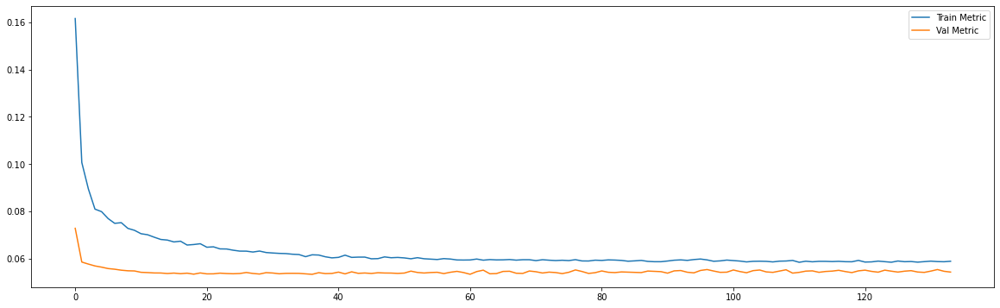

============================model:46===========================
32/32 [==============================] - 0s 5ms/step - loss: 0.0070 - mae: 0.0612
loss and metric train data [0.006956386845558882, 0.06123657152056694]
3/3 [==============================] - 0s 4ms/step - loss: 0.0067 - mae: 0.0652
loss and metric val data [0.006654826458543539, 0.0652313306927681]
3/3 [==============================] - 0s 4ms/step - loss: 0.0143 - mae: 0.0929
loss and metric test data [0.014254968613386154, 0.09291825443506241]


'neurons': 30, 'dropout': 0.4, 'time_steps': 240, 'batch_size':240, 'learning_rate':0.001, 'hidden_layers':1




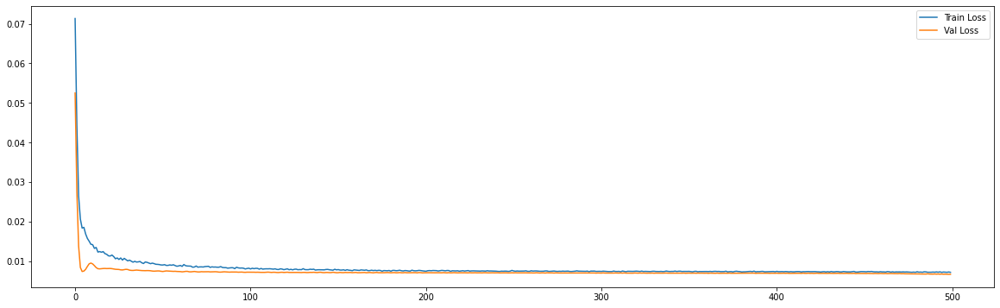

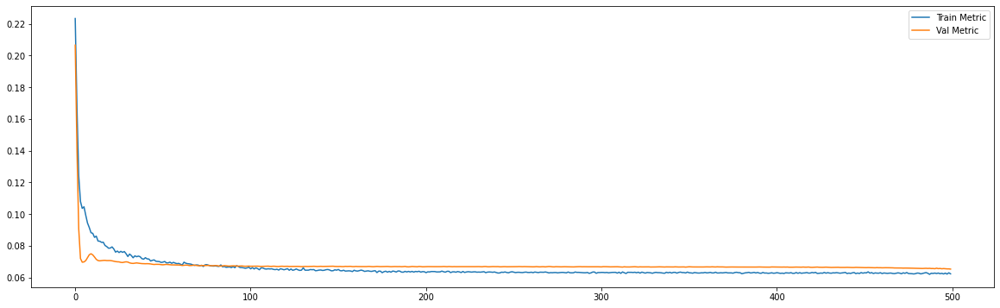

============================model:47===========================
32/32 [==============================] - 0s 8ms/step - loss: 0.0068 - mae: 0.0612
loss and metric train data [0.006823497358709574, 0.061199940741062164]
3/3 [==============================] - 0s 6ms/step - loss: 0.0063 - mae: 0.0644
loss and metric val data [0.006328293588012457, 0.06439147144556046]
3/3 [==============================] - 0s 6ms/step - loss: 0.0140 - mae: 0.0918
loss and metric test data [0.013951999135315418, 0.09180719405412674]


'neurons': 30, 'dropout': 0.4, 'time_steps': 240, 'batch_size':240, 'hidden_layers':2




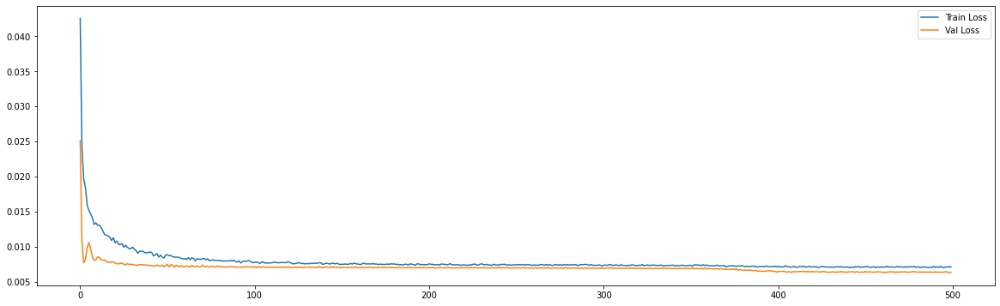

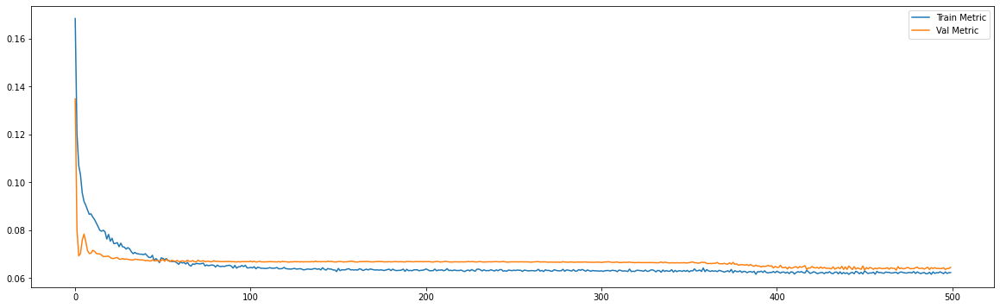

In [37]:
future_steps = 5
n_features = df_train.shape[1]

neurons_list = [20,25,30]
dropout_list = [0.2,0.4]
time_steps_list = [30,60,120,240]
lr_list = [0.001]
models = {}
i=0
for neurons in neurons_list:
  for dropout in dropout_list:
    for time_steps in time_steps_list:
      for lr in lr_list:
        x_train,x_test,x_val,y_train,y_val,y_test = Regressor(future_steps = future_steps,time_steps = time_steps,n_features = n_features,df_train = df_train_norm,df_val = df_val_norm,df_test = df_test_norm)

        models[i] = {'neurons':neurons,'dropout':dropout,'time_steps': time_steps, 'batch_size':time_steps, 'learning_rate':lr}
        models[i]['resumo'] = "'neurons': {}, 'dropout': {}, 'time_steps': {}, 'batch_size':{}, 'learning_rate':{}, 'hidden_layers':{}".format(neurons,dropout,time_steps,time_steps,lr,1)

        # The GRU architecture
        models[i]['model'] = Sequential()
        models[i]['model'].add(GRU(units=neurons, return_sequences=False,input_shape=(time_steps, n_features))) # return_sequences=True next layer is GRU
        models[i]['model'].add(Dropout(dropout))
        models[i]['model'].add(Dense(units=future_steps))

        #Compiling the GRU
        adam = optimizers.Adam(lr = lr, beta_1 = 0.9, beta_2 = 0.999, decay = 0.0)
        models[i]['model'].compile(optimizer = adam, loss = 'mse', metrics=['mae'])

        # early stop
        es = EarlyStopping(monitor='val_loss', mode='min', verbose=1, patience = 70)

        #Fitting to traning set
        history = models[i]['model'].fit(x_train, y_train, validation_data = (x_val,y_val), epochs = 500, batch_size = time_steps, verbose = 0, shuffle = False, callbacks = [es])

        print('============================model:{}==========================='.format(i))

          
        print('loss and metric train data',models[i]['model'].evaluate(x_train,y_train))
        print('loss and metric val data',models[i]['model'].evaluate(x_val,y_val))
        print('loss and metric test data',models[i]['model'].evaluate(x_test,y_test))
        print('\n')

        print(models[i]['resumo'])
        print('\n')

        plt.figure(figsize=(20,6))
        plt.plot(history.history['loss'])
        plt.plot(history.history['val_loss'])
        plt.legend(['Train Loss', 'Val Loss'])

        plt.figure(figsize=(20,6))
        plt.plot(history.history['mae'])
        plt.plot(history.history['val_mae'])
        plt.legend(['Train Metric', 'Val Metric'])
        plt.show()

        i+=1


        models[i] = {'neurons':neurons,'dropout':dropout,'time_steps': time_steps, 'batch_size':time_steps}
        models[i]['resumo'] = "'neurons': {}, 'dropout': {}, 'time_steps': {}, 'batch_size':{}, 'hidden_layers':{}".format(neurons,dropout,time_steps,time_steps,2)

        # The GRU architecture
        models[i]['model'] = Sequential()
        models[i]['model'].add(GRU(units=neurons, return_sequences=True,input_shape=(time_steps, n_features))) # return_sequences=True next layer is GRU
        models[i]['model'].add(Dropout(dropout))
        models[i]['model'].add(GRU(units=neurons, return_sequences=False))
        models[i]['model'].add(Dropout(dropout))
        models[i]['model'].add(Dense(units=future_steps))

        #Compiling the GRU
        adam = optimizers.Adam(lr = lr, beta_1 = 0.9, beta_2 = 0.999, decay = 0.0)
        models[i]['model'].compile(optimizer = adam, loss = 'mse', metrics=['mae'])

         # early stop
        es = EarlyStopping(monitor='val_loss', mode='min', verbose=1, patience = 70)

        #Fitting to traning set
        history = models[i]['model'].fit(x_train, y_train, validation_data = (x_val,y_val), epochs = 500, batch_size = time_steps, verbose = 0, shuffle = False, callbacks = [es])

        print('============================model:{}==========================='.format(i))

          
        print('loss and metric train data',models[i]['model'].evaluate(x_train,y_train))
        print('loss and metric val data',models[i]['model'].evaluate(x_val,y_val))
        print('loss and metric test data',models[i]['model'].evaluate(x_test,y_test))
        print('\n')

        print(models[i]['resumo'])
        print('\n')

        plt.figure(figsize=(20,6))
        plt.plot(history.history['loss'])
        plt.plot(history.history['val_loss'])
        plt.legend(['Train Loss', 'Val Loss'])

        plt.figure(figsize=(20,6))
        plt.plot(history.history['mae'])
        plt.plot(history.history['val_mae'])
        plt.legend(['Train Metric', 'Val Metric'])
        plt.show()

        i+=1

In [38]:
models[5]

{'batch_size': 120,
 'dropout': 0.2,
 'model': <tensorflow.python.keras.engine.sequential.Sequential at 0x7efeb4623278>,
 'neurons': 20,
 'resumo': "'neurons': 20, 'dropout': 0.2, 'time_steps': 120, 'batch_size':120, 'hidden_layers':2",
 'time_steps': 120}

Saving the Model

In [0]:
models[5]['model'].save("/content/drive/My Drive/ML Projects/Pharma Sales/GRU_MostRelavantFeatures.h5")

Ploting the model prediction

In [0]:
future_steps = 5
n_features = df_train.shape[1]
x_train,x_test,x_val,y_train,y_val,y_test = Regressor(future_steps = future_steps,time_steps = 120,n_features = n_features,df_train = df_train_norm,df_val = df_val_norm,df_test = df_test_norm)

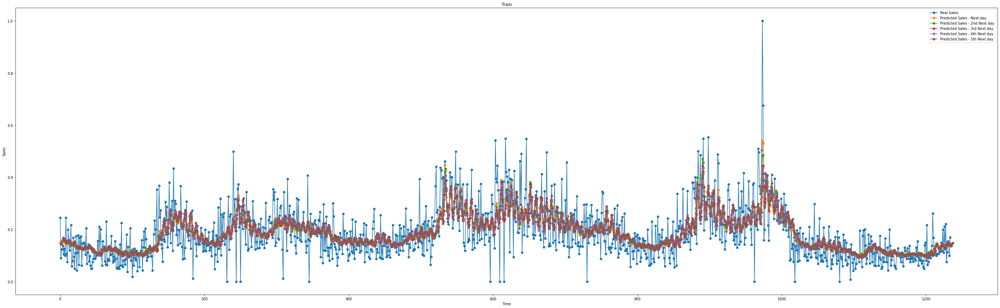

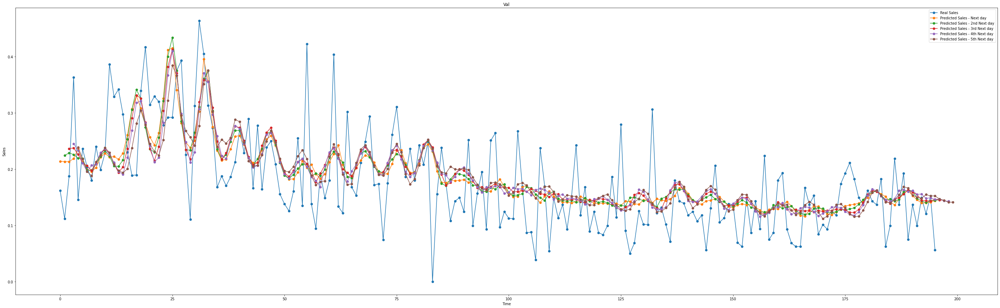

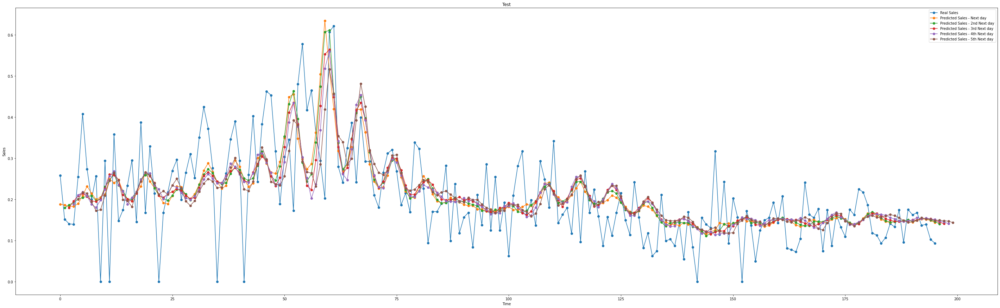

In [41]:
y_train_predict = models[5]['model'].predict(x_train)
y_val_predict = models[5]['model'].predict(x_val)
y_test_predict = models[5]['model'].predict(x_test)

plt.figure(figsize=(50,15))
plt.plot(y_train[:,0],marker='o',label='Real Sales')
plt.plot(y_train_predict[:,0],marker='o',label='Predicted Sales - Next day')
plt.plot(np.concatenate(([None],y_train_predict[:, 1])),marker='o',label='Predicted Sales - 2nd Next day')
plt.plot(np.concatenate(([None, None],y_train_predict[:, 2])),marker='o',label='Predicted Sales - 3rd Next day')
plt.plot(np.concatenate(([None, None, None],y_train_predict[:, 3])),marker='o',label='Predicted Sales - 4th Next day')
plt.plot(np.concatenate(([None, None, None,None],y_train_predict[:, 4])),marker='o',label='Predicted Sales - 5th Next day')
plt.title('Train')
plt.xlabel('Time')
plt.ylabel('Sales')
plt.legend()
plt.show()

plt.figure(figsize=(50,15))
plt.plot(y_val[:,0],marker='o',label='Real Sales')
plt.plot(y_val_predict[:,0],marker='o',label='Predicted Sales - Next day')
plt.plot(np.concatenate(([None],y_val_predict[:, 1])),marker='o',label='Predicted Sales - 2nd Next day')
plt.plot(np.concatenate(([None, None],y_val_predict[:, 2])),marker='o',label='Predicted Sales - 3rd Next day')
plt.plot(np.concatenate(([None, None, None],y_val_predict[:, 3])),marker='o',label='Predicted Sales - 4th Next day')
plt.plot(np.concatenate(([None, None, None,None],y_val_predict[:, 4])),marker='o',label='Predicted Sales - 5th Next day')
plt.title('Val')
plt.xlabel('Time')
plt.ylabel('Sales')
plt.legend()
plt.show()

plt.figure(figsize=(50,15))
plt.plot(y_test[:,0],marker='o',label='Real Sales')
plt.plot(y_test_predict[:,0],marker='o',label='Predicted Sales - Next day')
plt.plot(np.concatenate(([None],y_test_predict[:, 1])),marker='o',label='Predicted Sales - 2nd Next day')
plt.plot(np.concatenate(([None, None],y_test_predict[:, 2])),marker='o',label='Predicted Sales - 3rd Next day')
plt.plot(np.concatenate(([None, None, None],y_test_predict[:, 3])),marker='o',label='Predicted Sales - 4th Next day')
plt.plot(np.concatenate(([None, None, None,None],y_test_predict[:, 4])),marker='o',label='Predicted Sales - 5th Next day')
plt.title('Test')
plt.xlabel('Time')
plt.ylabel('Sales')
plt.legend()
plt.show()

# Outliers Treatment

## Cape

In [0]:
df_daily = pd.read_csv('/content/drive/My Drive/ML Projects/Pharma Sales/Data/salesdaily.csv')
df_daily = df_daily['N02BE']

In [0]:
df_train,df_val,df_test = dataSplit(df = df_daily,train_percent = 0.7,val_percent = 0.15)

(1474,)
(316,)
(316,)


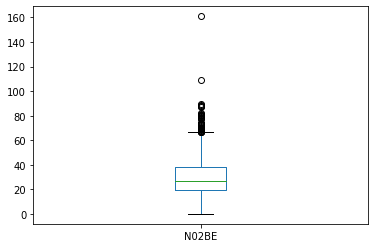

In [0]:
df_train.plot.box()

In [0]:
print(df_train[df_train>df_train.quantile(0.8)].shape)
print(df_train[df_train>df_train.quantile(0.9)].shape)
print(df_train[df_train>df_train.quantile(0.95)].shape)

(295,)
(148,)
(74,)


In [0]:
df_train[df_train>df_train.quantile(0.9)] = df_train.quantile(0.9)

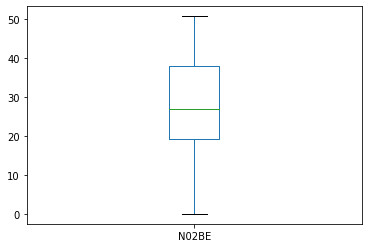

In [0]:
df_train.plot.box()

In [0]:
df_train_norm,df_val_norm,df_test_norm = normalizing_data(df_train,df_val,df_test,frange=(0,1))

[1.]
[0.]


[1.46937168]
[0.]


[1.97163679]
[0.]
-------------------------
(1474, 1)
(316, 1)
(316, 1)


Epoch 00270: early stopping
============================model:0===========================
45/45 [==============================] - 0s 4ms/step - loss: 0.0381 - mae: 0.1548
loss and metric train data [0.03808577358722687, 0.1547812968492508]
9/9 [==============================] - 0s 4ms/step - loss: 0.0539 - mae: 0.1844
loss and metric val data [0.05389866232872009, 0.18442262709140778]
9/9 [==============================] - 0s 4ms/step - loss: 0.0676 - mae: 0.1923
loss and metric test data [0.0676456019282341, 0.19226035475730896]


'neurons': 20, 'dropout': 0.2, 'time_steps': 30, 'batch_size':30, 'learning_rate':0.001, 'hidden_layers':1




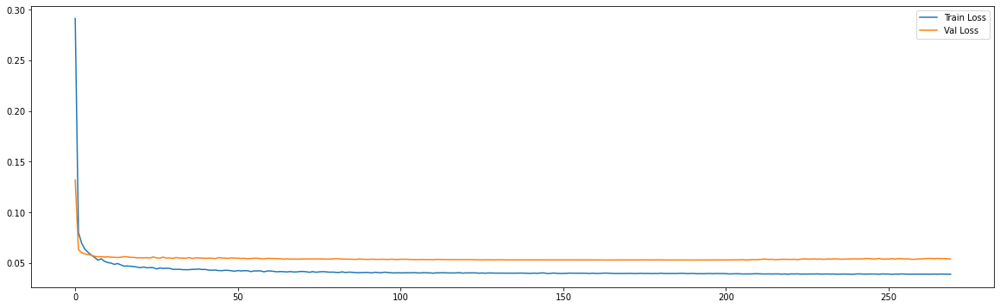

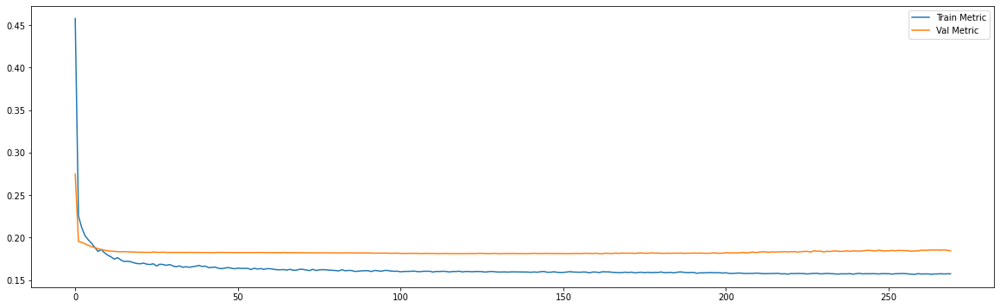

Epoch 00219: early stopping
============================model:1===========================
45/45 [==============================] - 0s 6ms/step - loss: 0.0382 - mae: 0.1549
loss and metric train data [0.03815905749797821, 0.15488819777965546]
9/9 [==============================] - 0s 5ms/step - loss: 0.0539 - mae: 0.1845
loss and metric val data [0.05390779674053192, 0.1844676285982132]
9/9 [==============================] - 0s 5ms/step - loss: 0.0667 - mae: 0.1900
loss and metric test data [0.06668142229318619, 0.18998883664608002]


'neurons': 20, 'dropout': 0.2, 'time_steps': 30, 'batch_size':30, 'hidden_layers':2




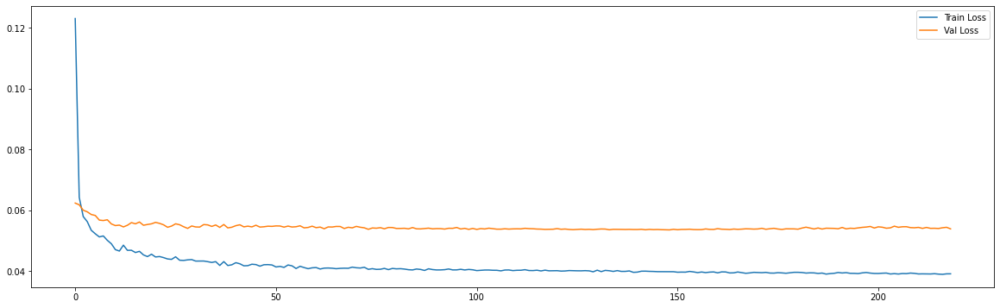

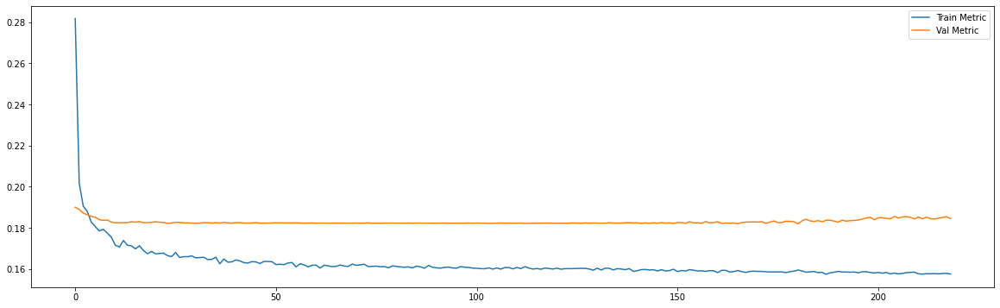

Epoch 00179: early stopping
============================model:2===========================
43/43 [==============================] - 0s 5ms/step - loss: 0.0384 - mae: 0.1558
loss and metric train data [0.03843121975660324, 0.15583503246307373]
8/8 [==============================] - 0s 4ms/step - loss: 0.0509 - mae: 0.1751
loss and metric val data [0.05090693384408951, 0.1751355230808258]
8/8 [==============================] - 0s 4ms/step - loss: 0.0710 - mae: 0.1991
loss and metric test data [0.07098889350891113, 0.1991291046142578]


'neurons': 20, 'dropout': 0.2, 'time_steps': 60, 'batch_size':60, 'learning_rate':0.001, 'hidden_layers':1




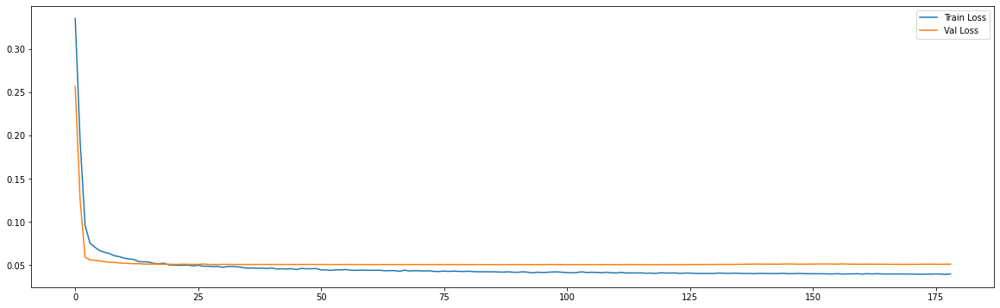

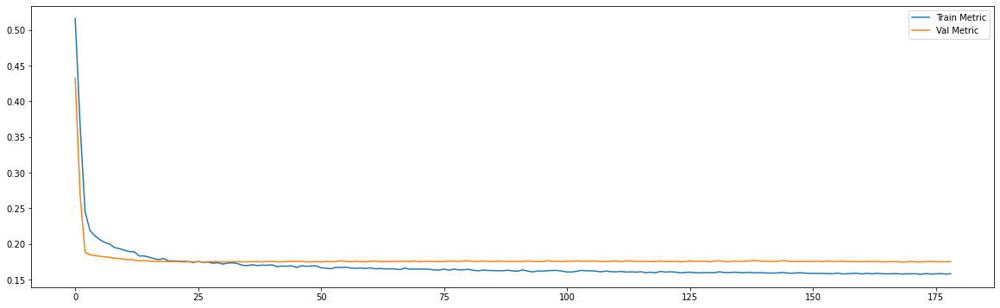

Epoch 00100: early stopping
============================model:3===========================
43/43 [==============================] - 0s 9ms/step - loss: 0.0393 - mae: 0.1583
loss and metric train data [0.039295729249715805, 0.1582566499710083]
8/8 [==============================] - 0s 9ms/step - loss: 0.0507 - mae: 0.1766
loss and metric val data [0.05065399035811424, 0.1766064167022705]
8/8 [==============================] - 0s 8ms/step - loss: 0.0700 - mae: 0.1982
loss and metric test data [0.07003527879714966, 0.19823992252349854]


'neurons': 20, 'dropout': 0.2, 'time_steps': 60, 'batch_size':60, 'hidden_layers':2




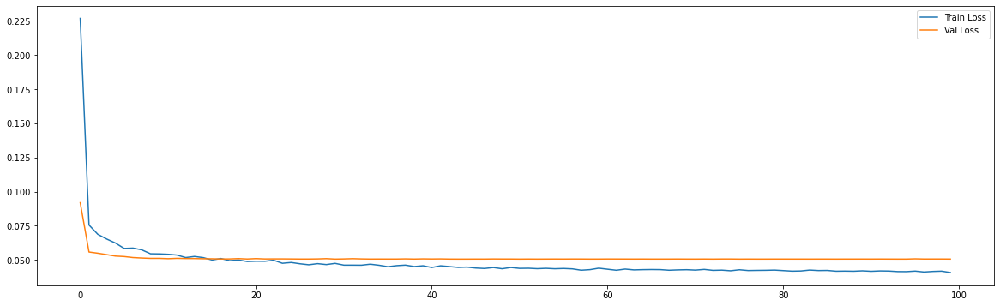

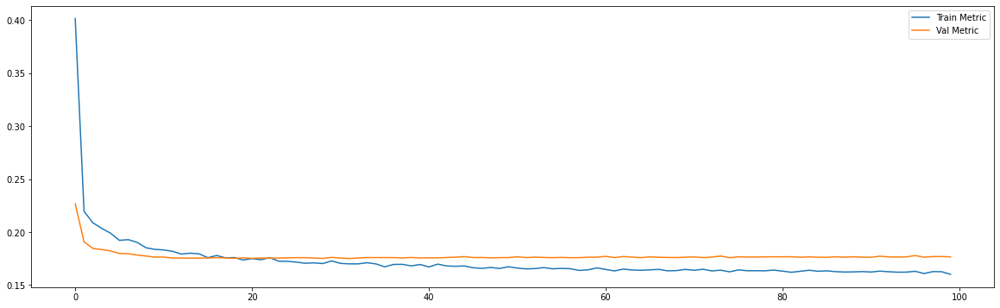

Epoch 00178: early stopping
============================model:4===========================
39/39 [==============================] - 0s 9ms/step - loss: 0.0383 - mae: 0.1561
loss and metric train data [0.03834950551390648, 0.1560644507408142]
7/7 [==============================] - 0s 7ms/step - loss: 0.0484 - mae: 0.1695
loss and metric val data [0.04843093827366829, 0.16946181654930115]
7/7 [==============================] - 0s 8ms/step - loss: 0.0842 - mae: 0.2226
loss and metric test data [0.08420790731906891, 0.2226272076368332]


'neurons': 20, 'dropout': 0.2, 'time_steps': 120, 'batch_size':120, 'learning_rate':0.001, 'hidden_layers':1




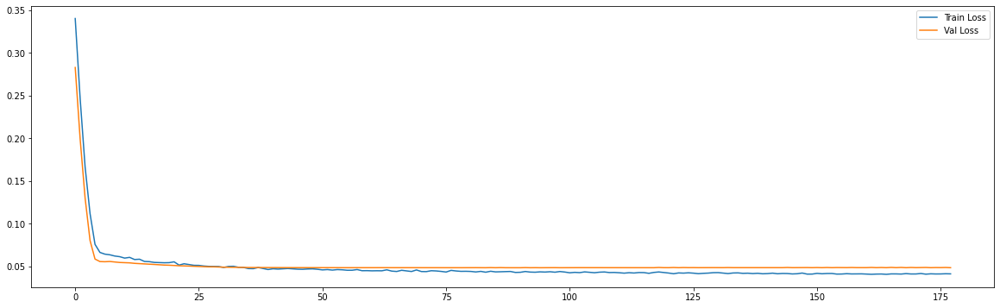

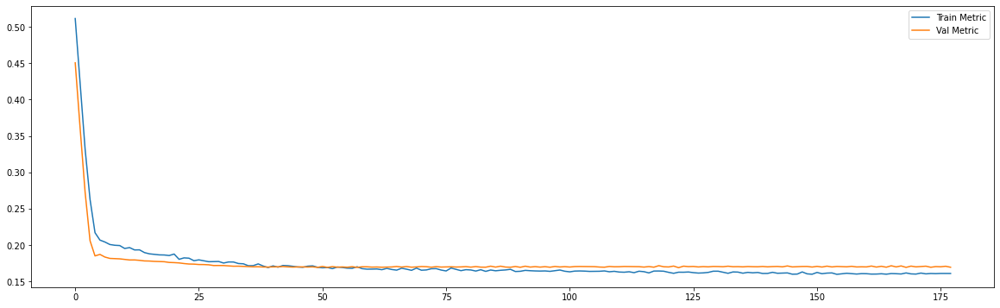

Epoch 00279: early stopping
============================model:5===========================
39/39 [==============================] - 1s 16ms/step - loss: 0.0376 - mae: 0.1538
loss and metric train data [0.03756069764494896, 0.15384581685066223]
7/7 [==============================] - 0s 13ms/step - loss: 0.0495 - mae: 0.1691
loss and metric val data [0.049453843384981155, 0.169107586145401]
7/7 [==============================] - 0s 14ms/step - loss: 0.0858 - mae: 0.2259
loss and metric test data [0.08575950562953949, 0.22594554722309113]


'neurons': 20, 'dropout': 0.2, 'time_steps': 120, 'batch_size':120, 'hidden_layers':2




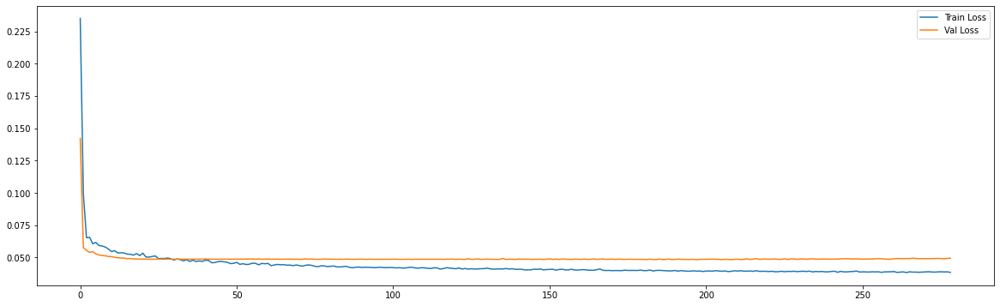

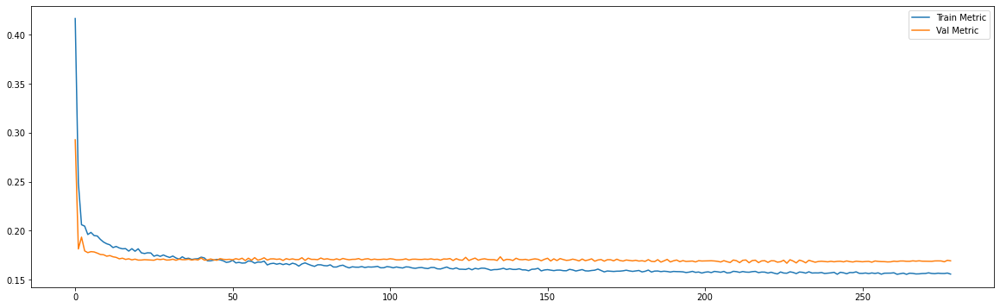

Epoch 00228: early stopping
============================model:6===========================
32/32 [==============================] - 0s 14ms/step - loss: 0.0429 - mae: 0.1666
loss and metric train data [0.042876649647951126, 0.16662311553955078]
3/3 [==============================] - 0s 10ms/step - loss: 0.0723 - mae: 0.2125
loss and metric val data [0.07232841849327087, 0.21251454949378967]
3/3 [==============================] - 0s 9ms/step - loss: 0.1513 - mae: 0.3079
loss and metric test data [0.15129360556602478, 0.30790242552757263]


'neurons': 20, 'dropout': 0.2, 'time_steps': 240, 'batch_size':240, 'learning_rate':0.001, 'hidden_layers':1




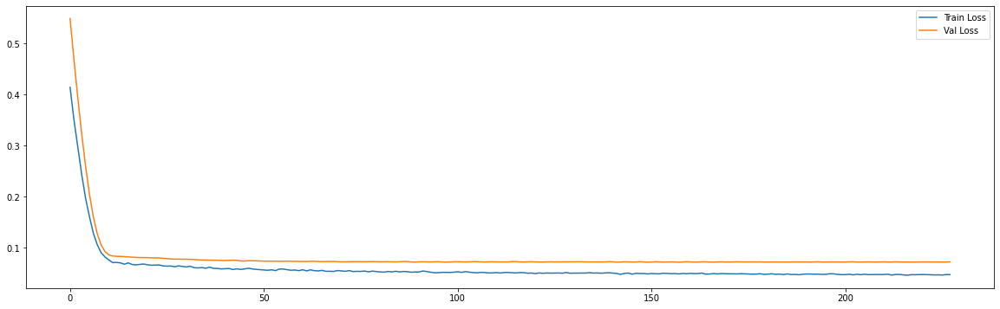

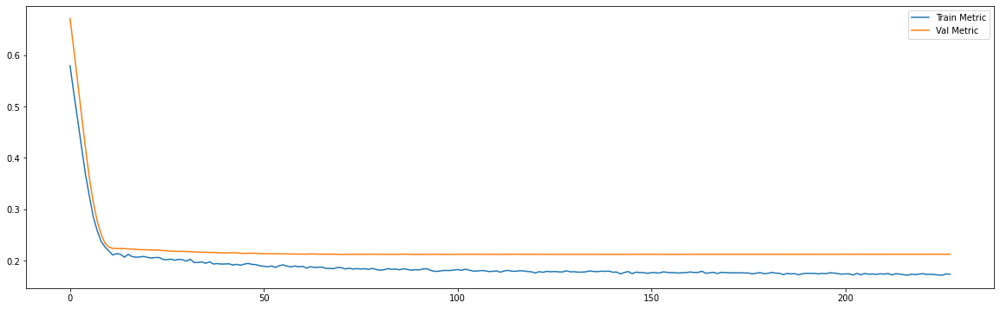

Epoch 00265: early stopping
============================model:7===========================
32/32 [==============================] - 1s 29ms/step - loss: 0.0427 - mae: 0.1663
loss and metric train data [0.04269992932677269, 0.16627612709999084]
3/3 [==============================] - 0s 19ms/step - loss: 0.0722 - mae: 0.2137
loss and metric val data [0.07215602695941925, 0.21372061967849731]
3/3 [==============================] - 0s 20ms/step - loss: 0.1502 - mae: 0.3076
loss and metric test data [0.15024742484092712, 0.3075893521308899]


'neurons': 20, 'dropout': 0.2, 'time_steps': 240, 'batch_size':240, 'hidden_layers':2




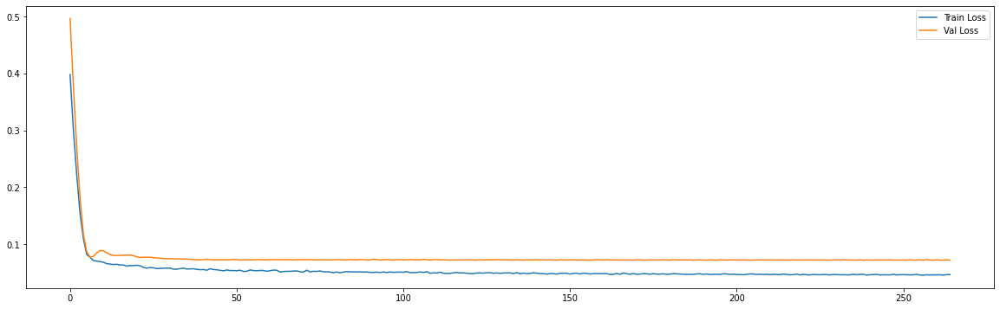

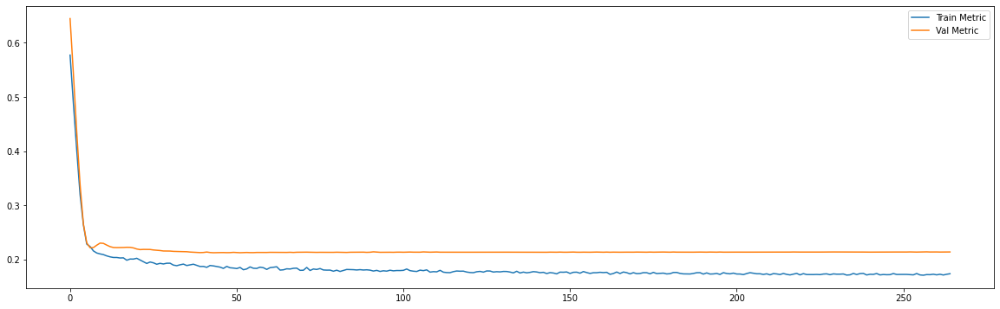

Epoch 00211: early stopping
============================model:8===========================
45/45 [==============================] - 0s 4ms/step - loss: 0.0390 - mae: 0.1575
loss and metric train data [0.03899533674120903, 0.15751586854457855]
9/9 [==============================] - 0s 4ms/step - loss: 0.0529 - mae: 0.1827
loss and metric val data [0.05294623598456383, 0.18271252512931824]
9/9 [==============================] - 0s 4ms/step - loss: 0.0629 - mae: 0.1848
loss and metric test data [0.06285477429628372, 0.1848038136959076]


'neurons': 20, 'dropout': 0.4, 'time_steps': 30, 'batch_size':30, 'learning_rate':0.001, 'hidden_layers':1




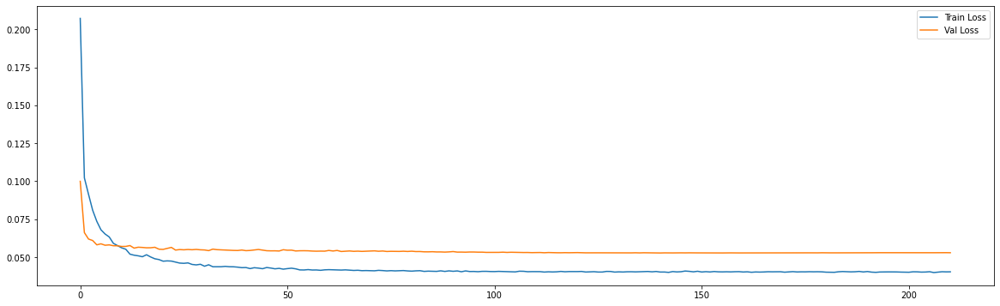

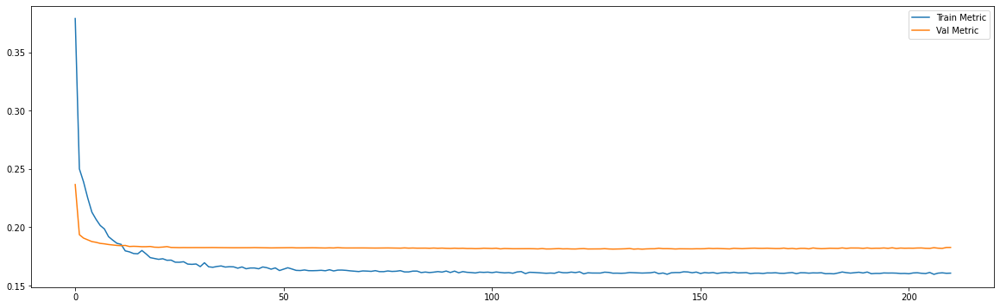

Epoch 00263: early stopping
============================model:9===========================
45/45 [==============================] - 0s 6ms/step - loss: 0.0389 - mae: 0.1569
loss and metric train data [0.03891661763191223, 0.15689589083194733]
9/9 [==============================] - 0s 7ms/step - loss: 0.0535 - mae: 0.1834
loss and metric val data [0.05352107062935829, 0.18343505263328552]
9/9 [==============================] - 0s 5ms/step - loss: 0.0651 - mae: 0.1880
loss and metric test data [0.06509041041135788, 0.1879851520061493]


'neurons': 20, 'dropout': 0.4, 'time_steps': 30, 'batch_size':30, 'hidden_layers':2




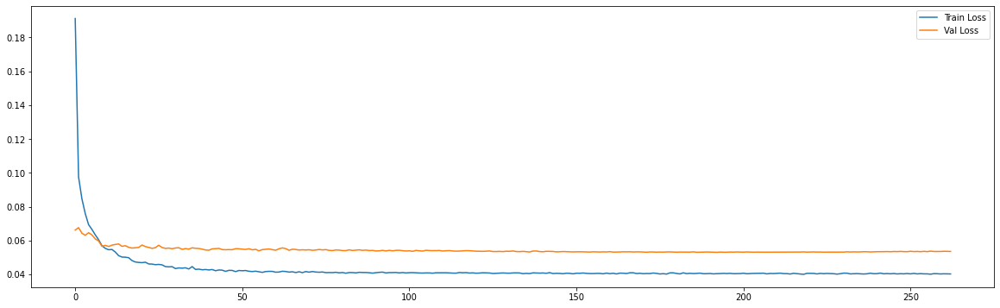

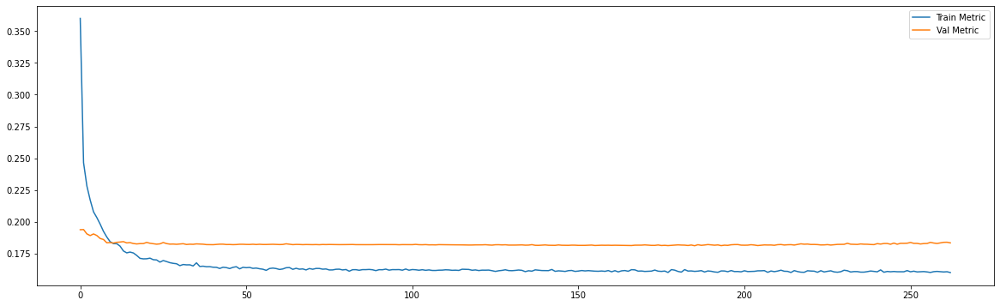

Epoch 00222: early stopping
============================model:10===========================
43/43 [==============================] - 0s 6ms/step - loss: 0.0385 - mae: 0.1565
loss and metric train data [0.038523878902196884, 0.1564987450838089]
8/8 [==============================] - 0s 5ms/step - loss: 0.0505 - mae: 0.1750
loss and metric val data [0.05046998709440231, 0.17497125267982483]
8/8 [==============================] - 0s 4ms/step - loss: 0.0695 - mae: 0.1971
loss and metric test data [0.06954412907361984, 0.19714266061782837]


'neurons': 20, 'dropout': 0.4, 'time_steps': 60, 'batch_size':60, 'learning_rate':0.001, 'hidden_layers':1




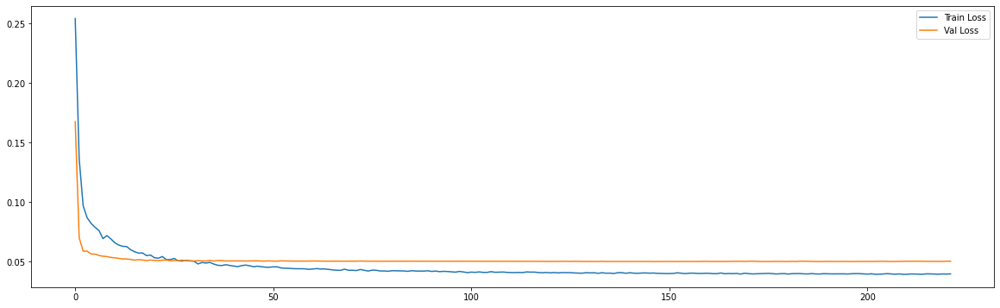

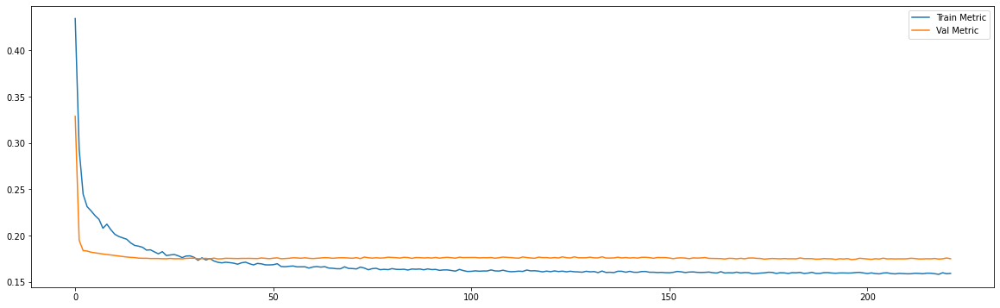

Epoch 00247: early stopping
============================model:11===========================
43/43 [==============================] - 0s 10ms/step - loss: 0.0382 - mae: 0.1553
loss and metric train data [0.03819015994668007, 0.1552860289812088]
8/8 [==============================] - 0s 9ms/step - loss: 0.0507 - mae: 0.1757
loss and metric val data [0.050738055258989334, 0.1757267713546753]
8/8 [==============================] - 0s 8ms/step - loss: 0.0688 - mae: 0.1967
loss and metric test data [0.0688440352678299, 0.19673356413841248]


'neurons': 20, 'dropout': 0.4, 'time_steps': 60, 'batch_size':60, 'hidden_layers':2




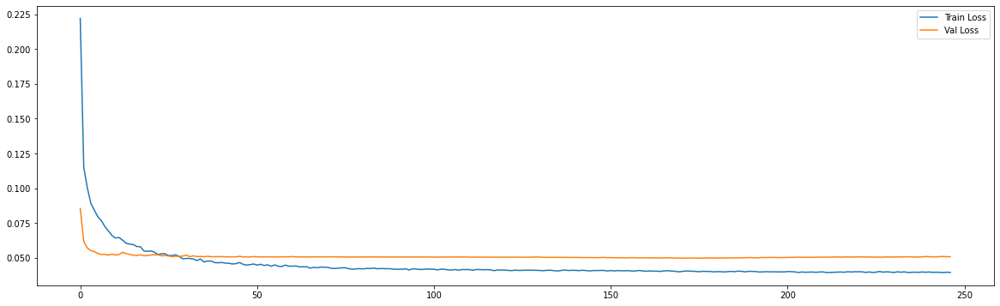

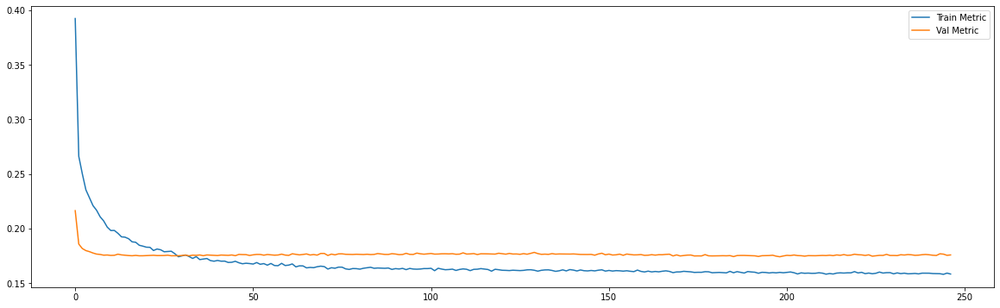

Epoch 00174: early stopping
============================model:12===========================
39/39 [==============================] - 0s 9ms/step - loss: 0.0385 - mae: 0.1567
loss and metric train data [0.03848046436905861, 0.15671497583389282]
7/7 [==============================] - 0s 7ms/step - loss: 0.0486 - mae: 0.1695
loss and metric val data [0.048611074686050415, 0.1695297360420227]
7/7 [==============================] - 0s 7ms/step - loss: 0.0848 - mae: 0.2227
loss and metric test data [0.08478806912899017, 0.222652867436409]


'neurons': 20, 'dropout': 0.4, 'time_steps': 120, 'batch_size':120, 'learning_rate':0.001, 'hidden_layers':1




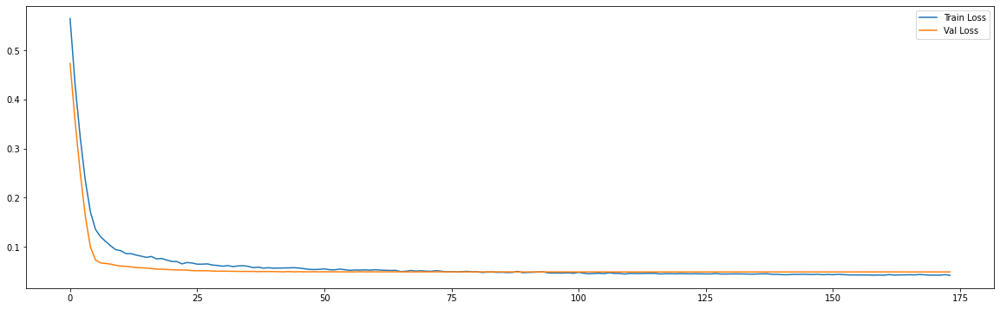

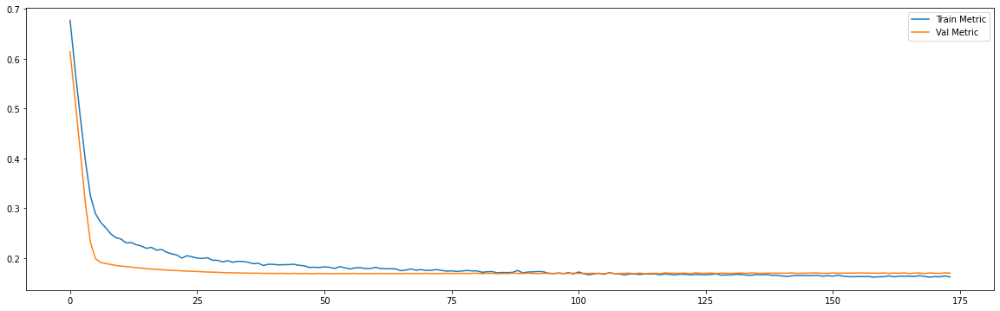

============================model:13===========================
39/39 [==============================] - 1s 16ms/step - loss: 0.0378 - mae: 0.1543
loss and metric train data [0.037764500826597214, 0.15431450307369232]
7/7 [==============================] - 0s 14ms/step - loss: 0.0484 - mae: 0.1695
loss and metric val data [0.04842500761151314, 0.1694617122411728]
7/7 [==============================] - 0s 14ms/step - loss: 0.0823 - mae: 0.2200
loss and metric test data [0.08228413015604019, 0.21997570991516113]


'neurons': 20, 'dropout': 0.4, 'time_steps': 120, 'batch_size':120, 'hidden_layers':2




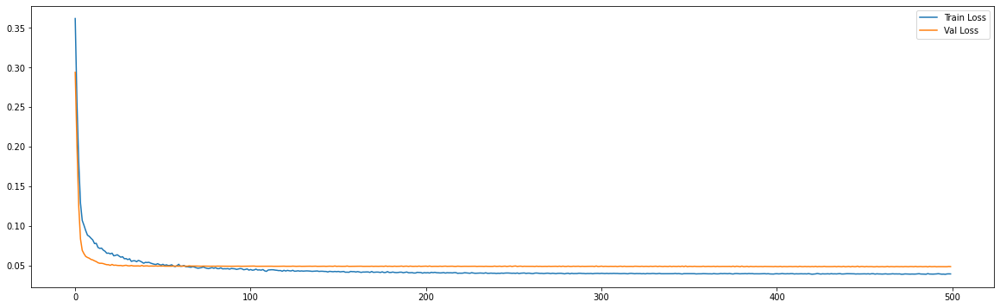

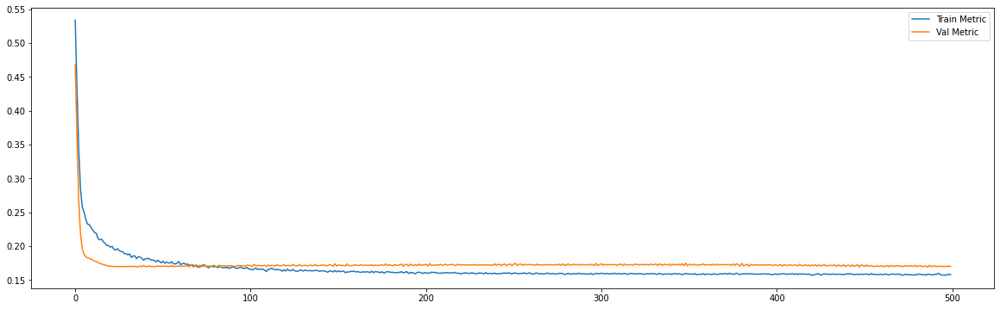

Epoch 00279: early stopping
============================model:14===========================
32/32 [==============================] - 0s 15ms/step - loss: 0.0429 - mae: 0.1669
loss and metric train data [0.042911481112241745, 0.16685719788074493]
3/3 [==============================] - 0s 10ms/step - loss: 0.0738 - mae: 0.2126
loss and metric val data [0.07383677363395691, 0.21255624294281006]
3/3 [==============================] - 0s 10ms/step - loss: 0.1531 - mae: 0.3100
loss and metric test data [0.1531192809343338, 0.31004831194877625]


'neurons': 20, 'dropout': 0.4, 'time_steps': 240, 'batch_size':240, 'learning_rate':0.001, 'hidden_layers':1




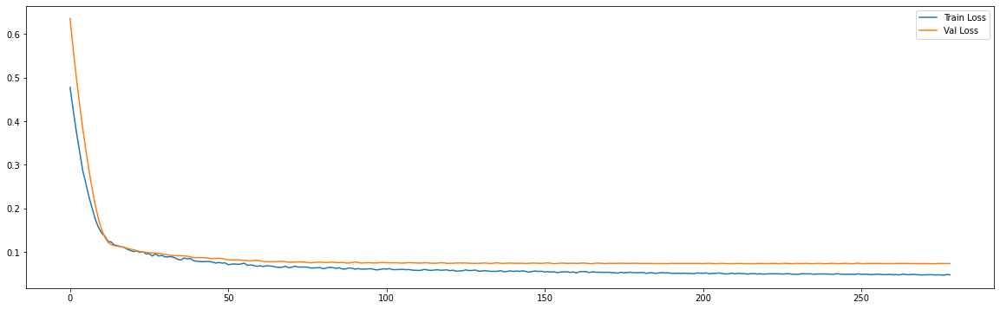

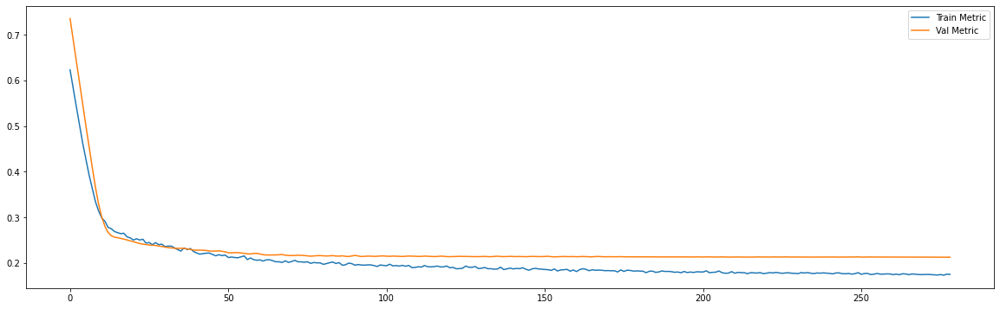

Epoch 00493: early stopping
============================model:15===========================
32/32 [==============================] - 1s 30ms/step - loss: 0.0424 - mae: 0.1660
loss and metric train data [0.042372025549411774, 0.16596651077270508]
3/3 [==============================] - 0s 20ms/step - loss: 0.0726 - mae: 0.2124
loss and metric val data [0.07263791561126709, 0.2124096155166626]
3/3 [==============================] - 0s 20ms/step - loss: 0.1506 - mae: 0.3103
loss and metric test data [0.15057146549224854, 0.31028231978416443]


'neurons': 20, 'dropout': 0.4, 'time_steps': 240, 'batch_size':240, 'hidden_layers':2




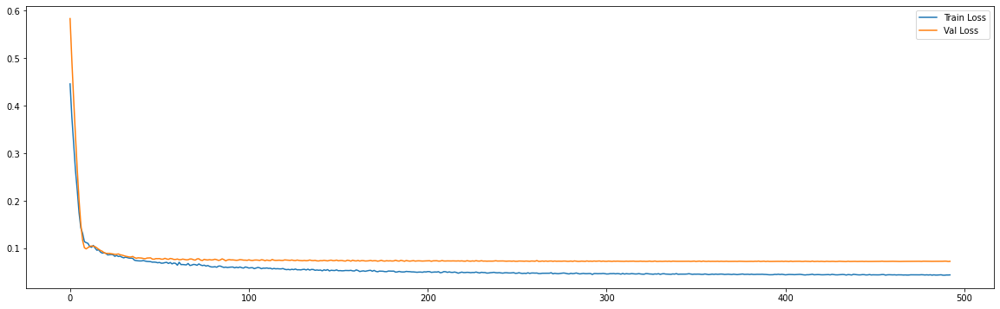

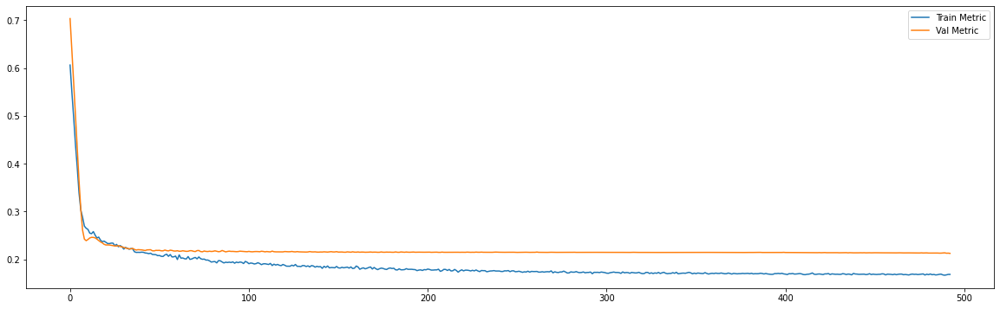

Epoch 00275: early stopping
============================model:16===========================
45/45 [==============================] - 0s 5ms/step - loss: 0.0381 - mae: 0.1545
loss and metric train data [0.038124628365039825, 0.1544562578201294]
9/9 [==============================] - 0s 5ms/step - loss: 0.0535 - mae: 0.1834
loss and metric val data [0.05350010097026825, 0.18341732025146484]
9/9 [==============================] - 0s 4ms/step - loss: 0.0648 - mae: 0.1886
loss and metric test data [0.06475172191858292, 0.1885620802640915]


'neurons': 25, 'dropout': 0.2, 'time_steps': 30, 'batch_size':30, 'learning_rate':0.001, 'hidden_layers':1




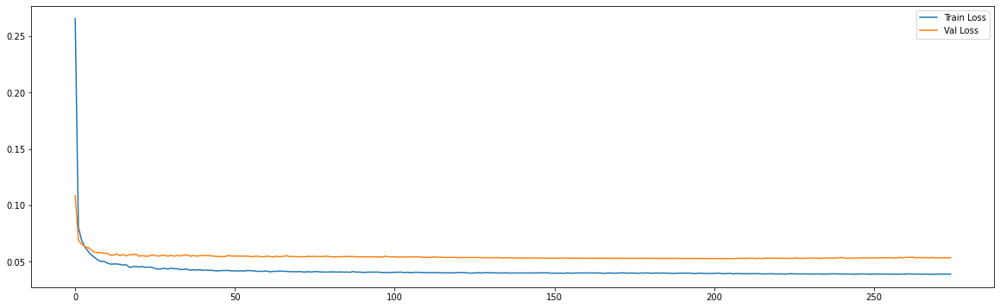

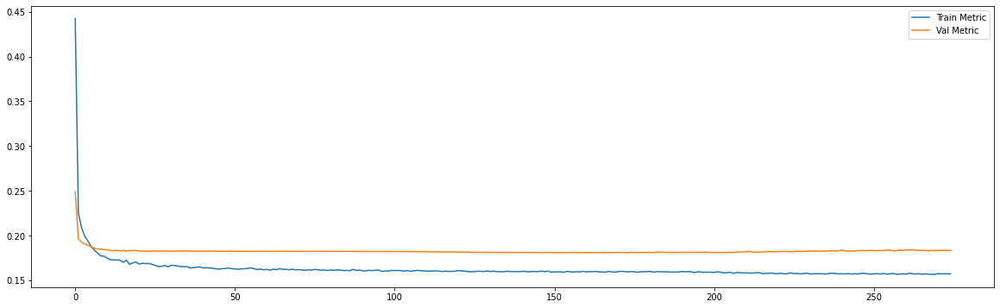

Epoch 00251: early stopping
============================model:17===========================
45/45 [==============================] - 0s 6ms/step - loss: 0.0374 - mae: 0.1523
loss and metric train data [0.037366509437561035, 0.1522885262966156]
9/9 [==============================] - 0s 6ms/step - loss: 0.0560 - mae: 0.1845
loss and metric val data [0.056016989052295685, 0.1845073252916336]
9/9 [==============================] - 0s 6ms/step - loss: 0.0783 - mae: 0.2033
loss and metric test data [0.07828186452388763, 0.20330365002155304]


'neurons': 25, 'dropout': 0.2, 'time_steps': 30, 'batch_size':30, 'hidden_layers':2




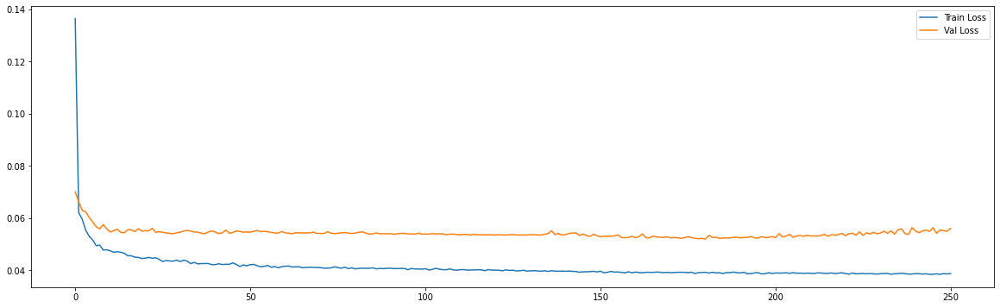

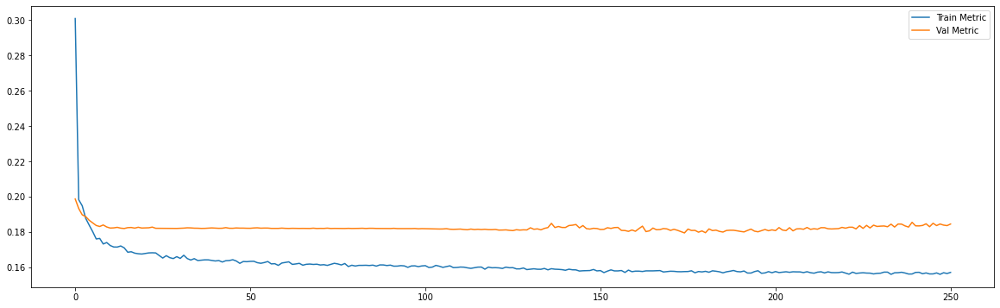

Epoch 00213: early stopping
============================model:18===========================
43/43 [==============================] - 0s 6ms/step - loss: 0.0385 - mae: 0.1560
loss and metric train data [0.03845290094614029, 0.15600287914276123]
8/8 [==============================] - 0s 6ms/step - loss: 0.0507 - mae: 0.1754
loss and metric val data [0.050653621554374695, 0.1754467785358429]
8/8 [==============================] - 0s 5ms/step - loss: 0.0696 - mae: 0.1977
loss and metric test data [0.06959516555070877, 0.19769316911697388]


'neurons': 25, 'dropout': 0.2, 'time_steps': 60, 'batch_size':60, 'learning_rate':0.001, 'hidden_layers':1




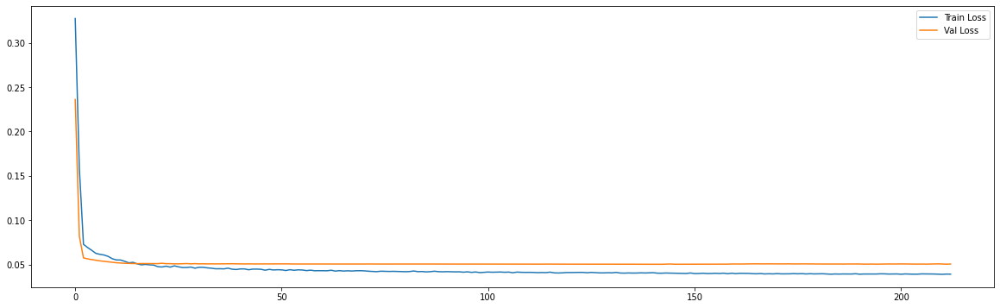

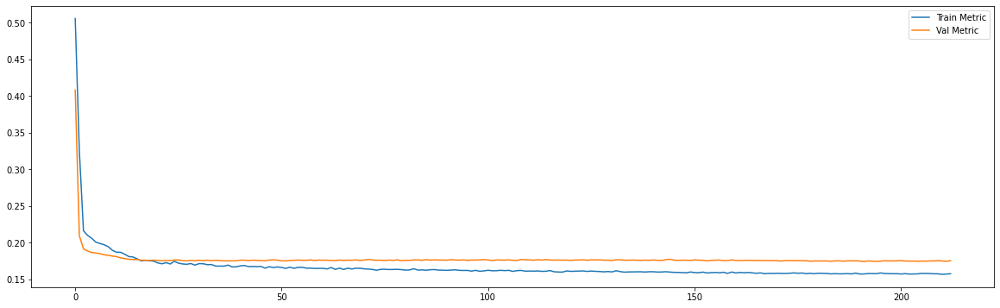

Epoch 00104: early stopping
============================model:19===========================
43/43 [==============================] - 0s 9ms/step - loss: 0.0393 - mae: 0.1583
loss and metric train data [0.03926103562116623, 0.1583085060119629]
8/8 [==============================] - 0s 9ms/step - loss: 0.0506 - mae: 0.1766
loss and metric val data [0.05059457942843437, 0.17658688127994537]
8/8 [==============================] - 0s 8ms/step - loss: 0.0697 - mae: 0.1975
loss and metric test data [0.0696621760725975, 0.1975107342004776]


'neurons': 25, 'dropout': 0.2, 'time_steps': 60, 'batch_size':60, 'hidden_layers':2




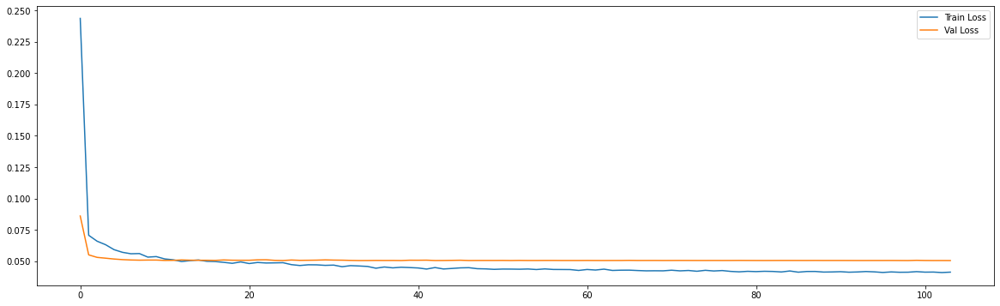

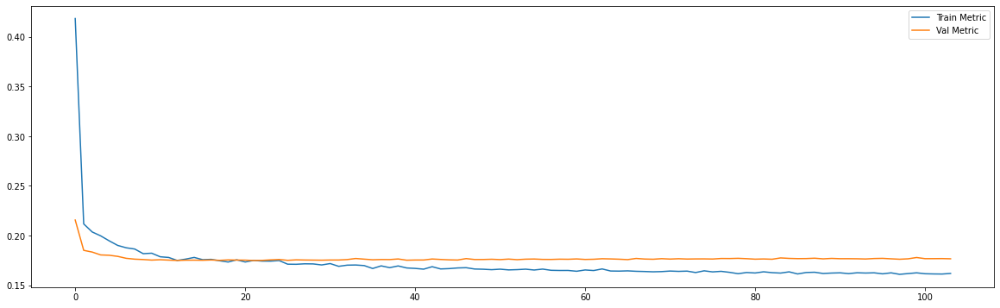

Epoch 00299: early stopping
============================model:20===========================
39/39 [==============================] - 0s 9ms/step - loss: 0.0377 - mae: 0.1547
loss and metric train data [0.03774912655353546, 0.15469808876514435]
7/7 [==============================] - 0s 8ms/step - loss: 0.0489 - mae: 0.1686
loss and metric val data [0.04893423616886139, 0.16861549019813538]
7/7 [==============================] - 0s 7ms/step - loss: 0.0836 - mae: 0.2213
loss and metric test data [0.08355261385440826, 0.2213032990694046]


'neurons': 25, 'dropout': 0.2, 'time_steps': 120, 'batch_size':120, 'learning_rate':0.001, 'hidden_layers':1




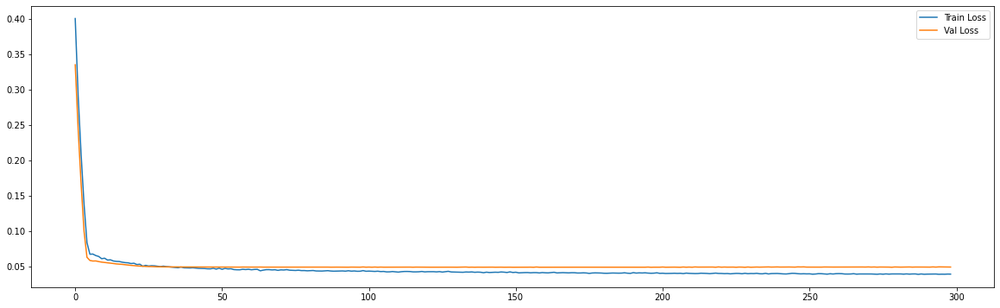

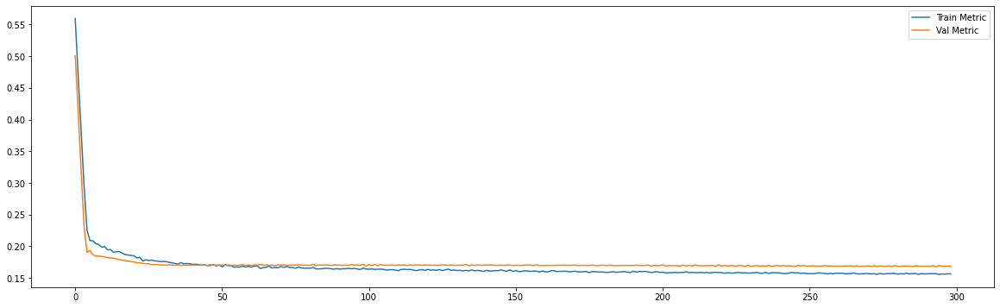

Epoch 00093: early stopping
============================model:21===========================
39/39 [==============================] - 1s 16ms/step - loss: 0.0386 - mae: 0.1571
loss and metric train data [0.03860967606306076, 0.1571088582277298]
7/7 [==============================] - 0s 14ms/step - loss: 0.0490 - mae: 0.1726
loss and metric val data [0.04900801554322243, 0.1726156324148178]
7/7 [==============================] - 0s 14ms/step - loss: 0.0858 - mae: 0.2246
loss and metric test data [0.08575113117694855, 0.22457614541053772]


'neurons': 25, 'dropout': 0.2, 'time_steps': 120, 'batch_size':120, 'hidden_layers':2




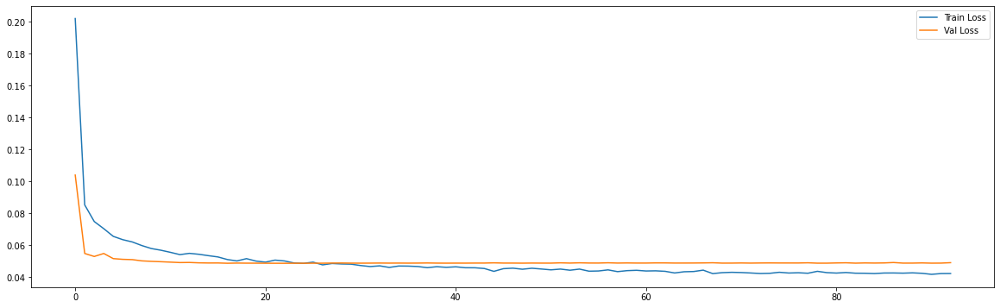

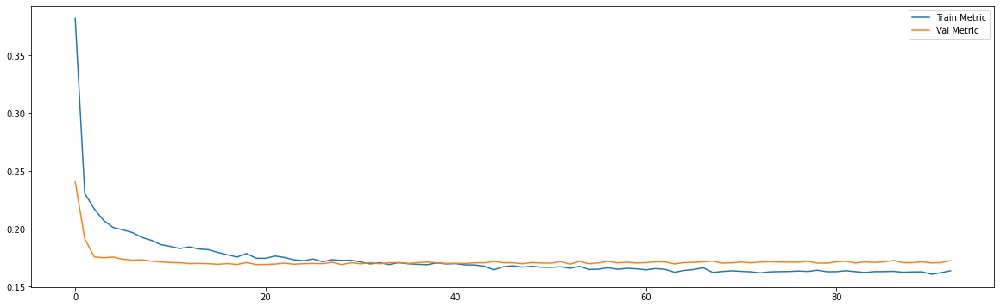

Epoch 00343: early stopping
============================model:22===========================
32/32 [==============================] - 0s 14ms/step - loss: 0.0424 - mae: 0.1657
loss and metric train data [0.04244973883032799, 0.16572006046772003]
3/3 [==============================] - 0s 10ms/step - loss: 0.0724 - mae: 0.2112
loss and metric val data [0.07241600751876831, 0.21123705804347992]
3/3 [==============================] - 0s 9ms/step - loss: 0.1503 - mae: 0.3095
loss and metric test data [0.1503439098596573, 0.3094622790813446]


'neurons': 25, 'dropout': 0.2, 'time_steps': 240, 'batch_size':240, 'learning_rate':0.001, 'hidden_layers':1




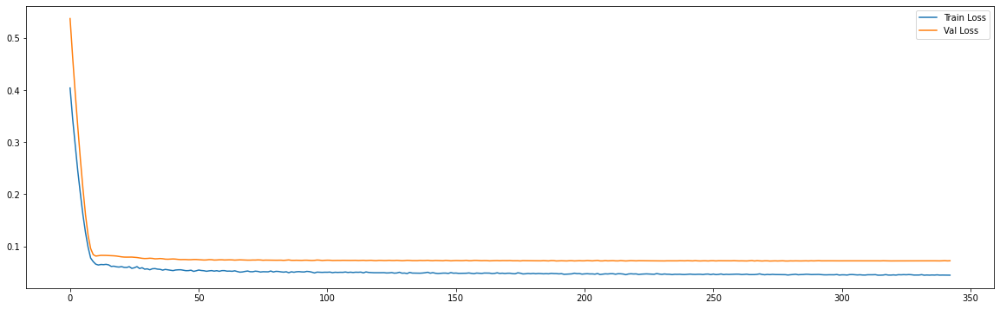

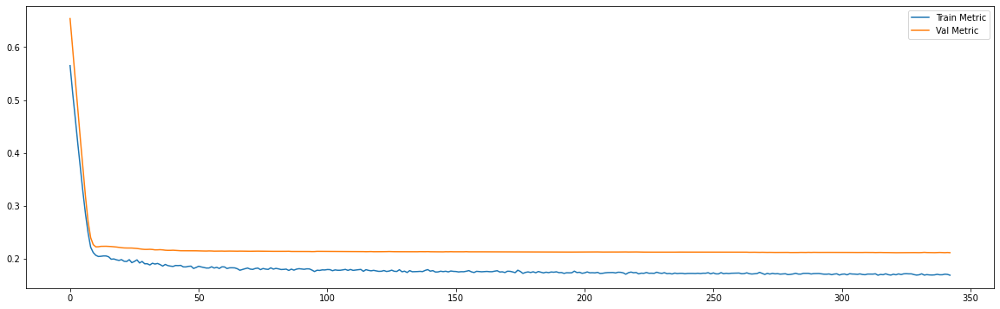

============================model:23===========================
32/32 [==============================] - 1s 29ms/step - loss: 0.0421 - mae: 0.1650
loss and metric train data [0.04212985932826996, 0.16497422754764557]
3/3 [==============================] - 0s 19ms/step - loss: 0.0711 - mae: 0.2092
loss and metric val data [0.07105614989995956, 0.20917357504367828]
3/3 [==============================] - 0s 20ms/step - loss: 0.1503 - mae: 0.3116
loss and metric test data [0.1502843201160431, 0.3115706443786621]


'neurons': 25, 'dropout': 0.2, 'time_steps': 240, 'batch_size':240, 'hidden_layers':2




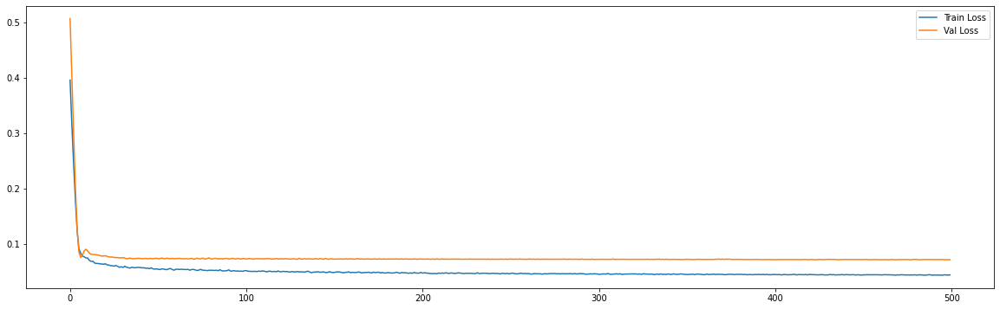

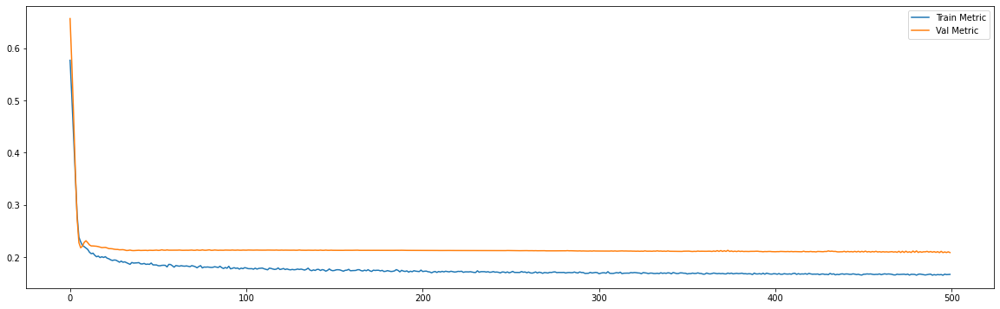

Epoch 00226: early stopping
============================model:24===========================
45/45 [==============================] - 0s 4ms/step - loss: 0.0384 - mae: 0.1558
loss and metric train data [0.03842151537537575, 0.1557602733373642]
9/9 [==============================] - 0s 4ms/step - loss: 0.0538 - mae: 0.1825
loss and metric val data [0.053803857415914536, 0.1824628859758377]
9/9 [==============================] - 0s 4ms/step - loss: 0.0651 - mae: 0.1866
loss and metric test data [0.06509389728307724, 0.18664973974227905]


'neurons': 25, 'dropout': 0.4, 'time_steps': 30, 'batch_size':30, 'learning_rate':0.001, 'hidden_layers':1




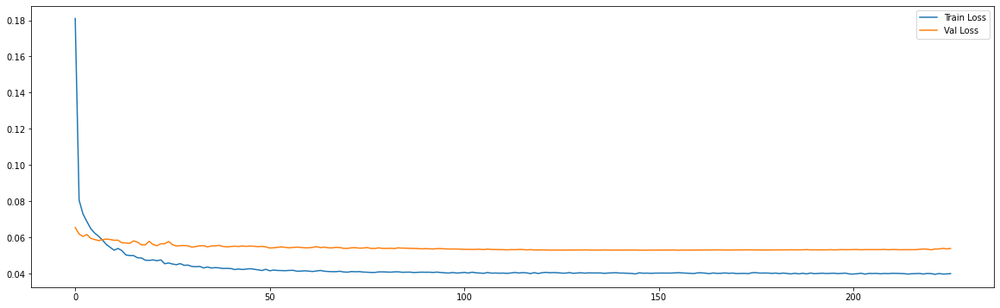

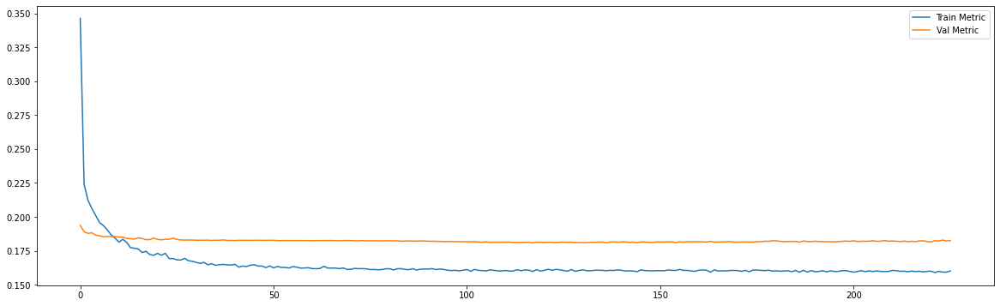

Epoch 00229: early stopping
============================model:25===========================
45/45 [==============================] - 0s 7ms/step - loss: 0.0387 - mae: 0.1558
loss and metric train data [0.03868424519896507, 0.15581420063972473]
9/9 [==============================] - 0s 7ms/step - loss: 0.0543 - mae: 0.1844
loss and metric val data [0.054319027811288834, 0.18435636162757874]
9/9 [==============================] - 0s 5ms/step - loss: 0.0668 - mae: 0.1909
loss and metric test data [0.06682100892066956, 0.1909152865409851]


'neurons': 25, 'dropout': 0.4, 'time_steps': 30, 'batch_size':30, 'hidden_layers':2




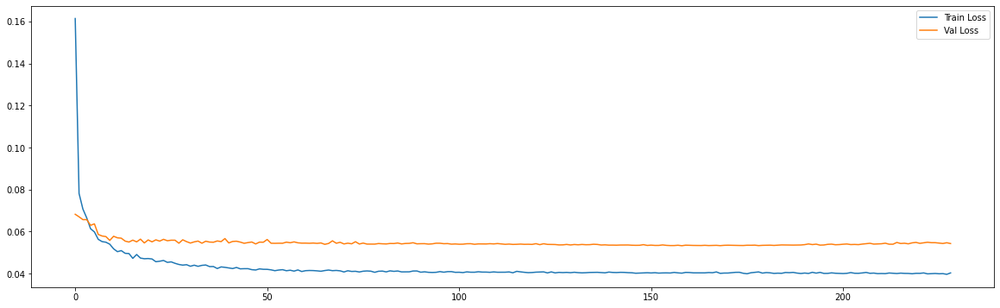

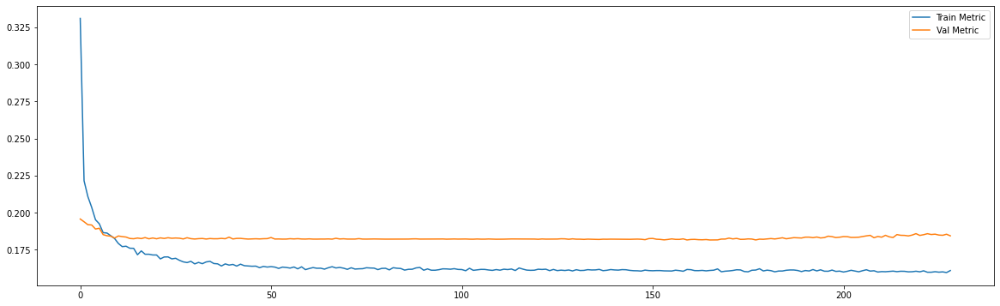

Epoch 00181: early stopping
============================model:26===========================
43/43 [==============================] - 0s 5ms/step - loss: 0.0384 - mae: 0.1562
loss and metric train data [0.038350660353899, 0.15620756149291992]
8/8 [==============================] - 0s 4ms/step - loss: 0.0505 - mae: 0.1749
loss and metric val data [0.05052249878644943, 0.1749047189950943]
8/8 [==============================] - 0s 5ms/step - loss: 0.0694 - mae: 0.1970
loss and metric test data [0.06940701603889465, 0.19696380198001862]


'neurons': 25, 'dropout': 0.4, 'time_steps': 60, 'batch_size':60, 'learning_rate':0.001, 'hidden_layers':1




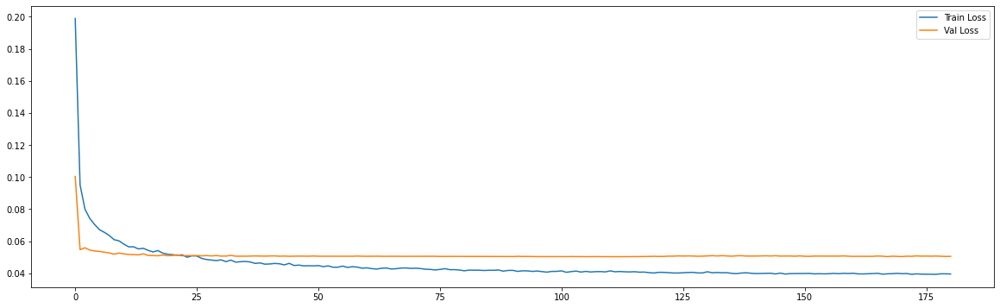

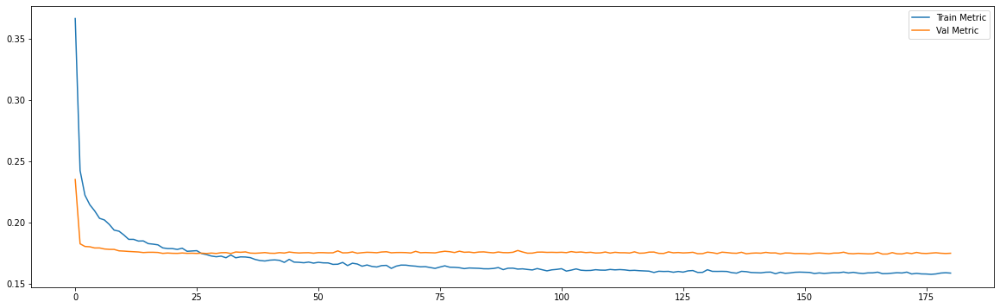

Epoch 00218: early stopping
============================model:27===========================
43/43 [==============================] - 0s 9ms/step - loss: 0.0381 - mae: 0.1549
loss and metric train data [0.038120366632938385, 0.15487071871757507]
8/8 [==============================] - 0s 8ms/step - loss: 0.0531 - mae: 0.1798
loss and metric val data [0.053145166486501694, 0.17976945638656616]
8/8 [==============================] - 0s 8ms/step - loss: 0.0767 - mae: 0.2091
loss and metric test data [0.07668907940387726, 0.2090650349855423]


'neurons': 25, 'dropout': 0.4, 'time_steps': 60, 'batch_size':60, 'hidden_layers':2




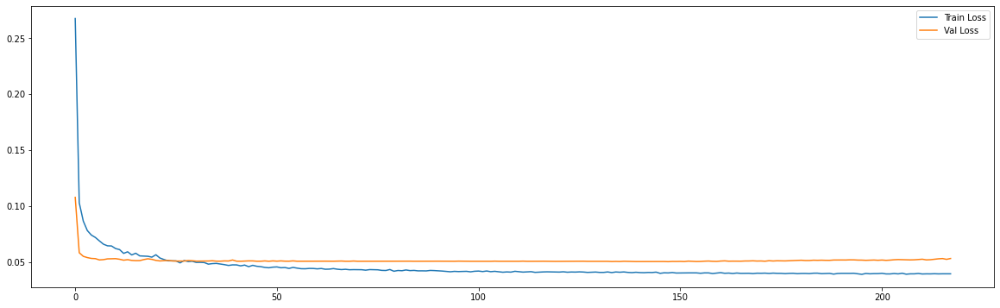

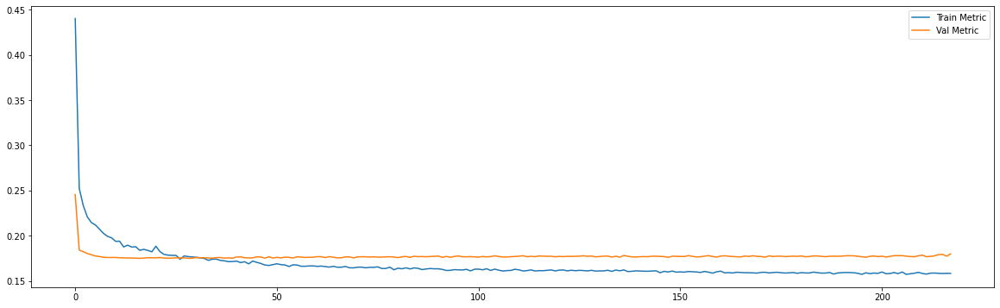

Epoch 00243: early stopping
============================model:28===========================
39/39 [==============================] - 0s 9ms/step - loss: 0.0383 - mae: 0.1558
loss and metric train data [0.0382620133459568, 0.15576854348182678]
7/7 [==============================] - 0s 8ms/step - loss: 0.0489 - mae: 0.1693
loss and metric val data [0.048861440271139145, 0.1693260222673416]
7/7 [==============================] - 0s 8ms/step - loss: 0.0841 - mae: 0.2216
loss and metric test data [0.08406897634267807, 0.2215946763753891]


'neurons': 25, 'dropout': 0.4, 'time_steps': 120, 'batch_size':120, 'learning_rate':0.001, 'hidden_layers':1




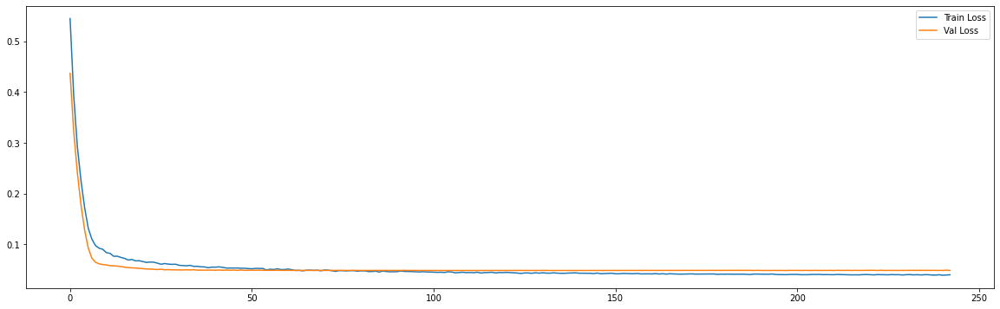

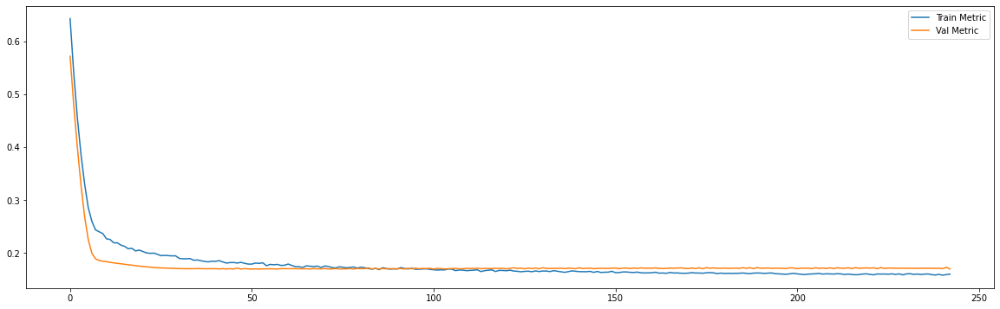

Epoch 00348: early stopping
============================model:29===========================
39/39 [==============================] - 1s 16ms/step - loss: 0.0378 - mae: 0.1547
loss and metric train data [0.03778151050209999, 0.1547379195690155]
7/7 [==============================] - 0s 14ms/step - loss: 0.0488 - mae: 0.1701
loss and metric val data [0.048754528164863586, 0.1700659841299057]
7/7 [==============================] - 0s 14ms/step - loss: 0.0814 - mae: 0.2182
loss and metric test data [0.08137279003858566, 0.21818260848522186]


'neurons': 25, 'dropout': 0.4, 'time_steps': 120, 'batch_size':120, 'hidden_layers':2




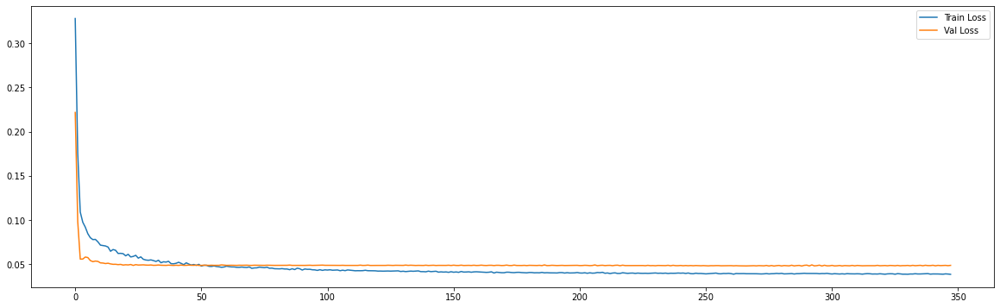

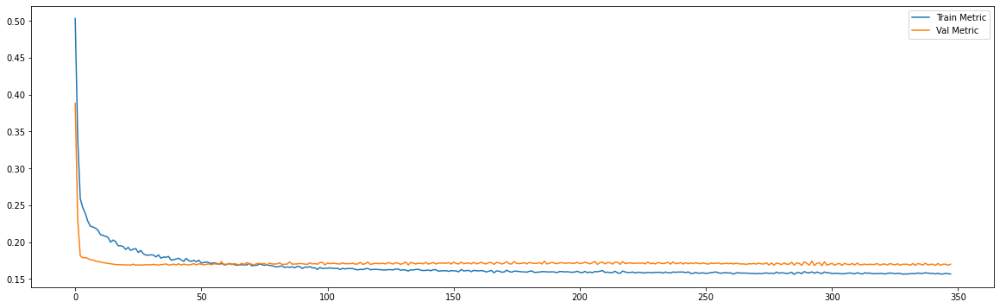

Epoch 00249: early stopping
============================model:30===========================
32/32 [==============================] - 0s 14ms/step - loss: 0.0427 - mae: 0.1666
loss and metric train data [0.04271428659558296, 0.16661445796489716]
3/3 [==============================] - 0s 9ms/step - loss: 0.0723 - mae: 0.2115
loss and metric val data [0.07228314131498337, 0.21151457726955414]
3/3 [==============================] - 0s 10ms/step - loss: 0.1525 - mae: 0.3097
loss and metric test data [0.1524704396724701, 0.30967020988464355]


'neurons': 25, 'dropout': 0.4, 'time_steps': 240, 'batch_size':240, 'learning_rate':0.001, 'hidden_layers':1




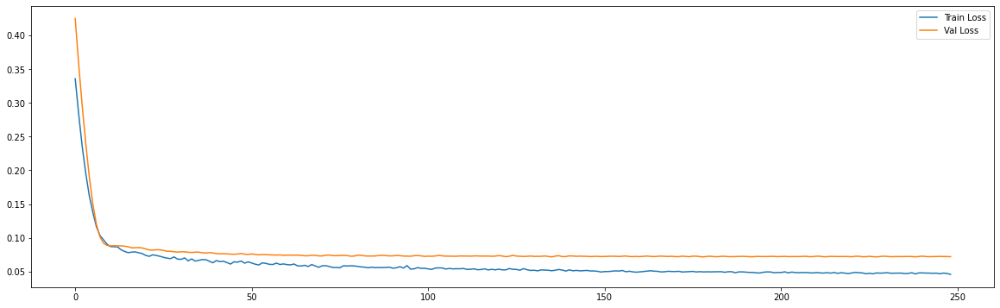

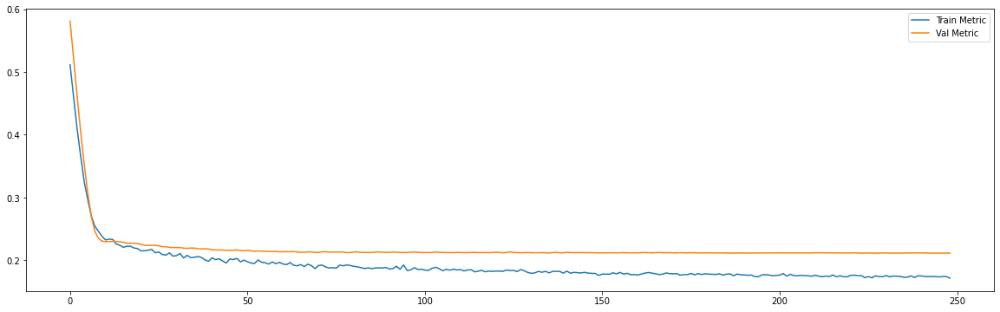

============================model:31===========================
32/32 [==============================] - 1s 30ms/step - loss: 0.0425 - mae: 0.1660
loss and metric train data [0.04246160760521889, 0.1659645438194275]
3/3 [==============================] - 0s 21ms/step - loss: 0.0723 - mae: 0.2133
loss and metric val data [0.07234591245651245, 0.21327362954616547]
3/3 [==============================] - 0s 21ms/step - loss: 0.1516 - mae: 0.3117
loss and metric test data [0.15159818530082703, 0.31166085600852966]


'neurons': 25, 'dropout': 0.4, 'time_steps': 240, 'batch_size':240, 'hidden_layers':2




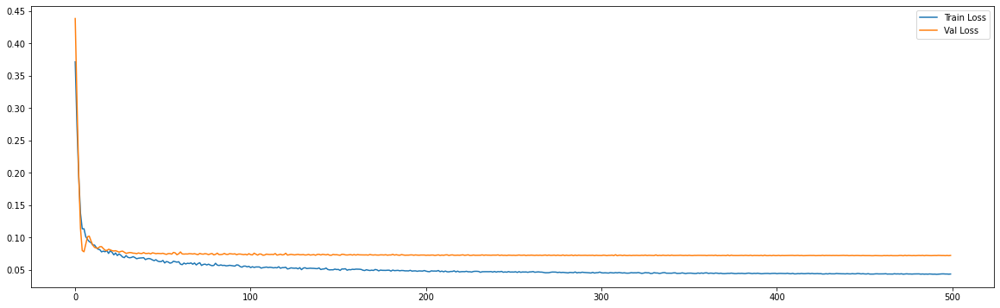

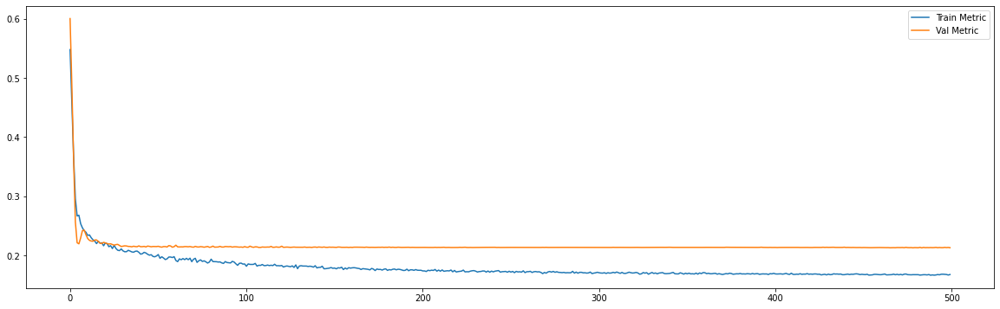

Epoch 00245: early stopping
============================model:32===========================
45/45 [==============================] - 0s 5ms/step - loss: 0.0378 - mae: 0.1538
loss and metric train data [0.03775431960821152, 0.15376560389995575]
9/9 [==============================] - 0s 5ms/step - loss: 0.0541 - mae: 0.1821
loss and metric val data [0.05406875163316727, 0.18214941024780273]
9/9 [==============================] - 0s 4ms/step - loss: 0.0655 - mae: 0.1872
loss and metric test data [0.06548719108104706, 0.1871834099292755]


'neurons': 30, 'dropout': 0.2, 'time_steps': 30, 'batch_size':30, 'learning_rate':0.001, 'hidden_layers':1




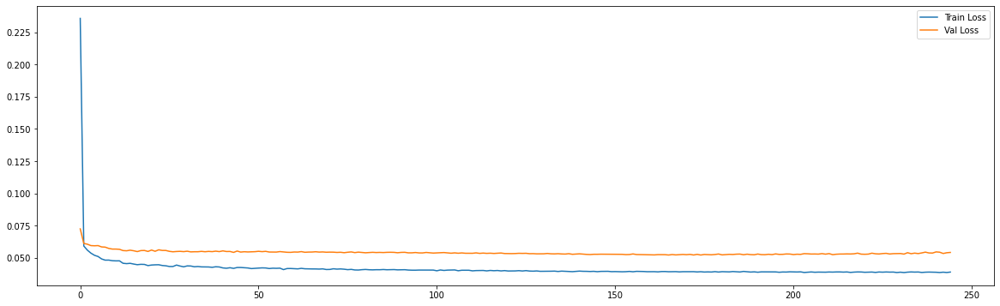

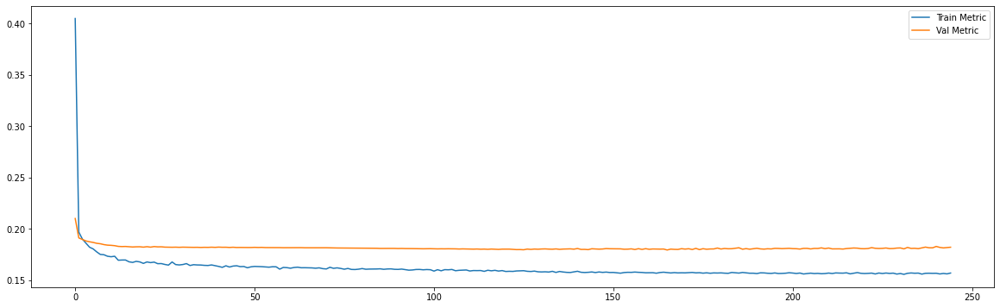

Epoch 00220: early stopping
============================model:33===========================
45/45 [==============================] - 0s 6ms/step - loss: 0.0374 - mae: 0.1521
loss and metric train data [0.037387873977422714, 0.15208421647548676]
9/9 [==============================] - 0s 5ms/step - loss: 0.0559 - mae: 0.1849
loss and metric val data [0.05585748329758644, 0.18485413491725922]
9/9 [==============================] - 0s 5ms/step - loss: 0.0701 - mae: 0.1945
loss and metric test data [0.07014960050582886, 0.1945263296365738]


'neurons': 30, 'dropout': 0.2, 'time_steps': 30, 'batch_size':30, 'hidden_layers':2




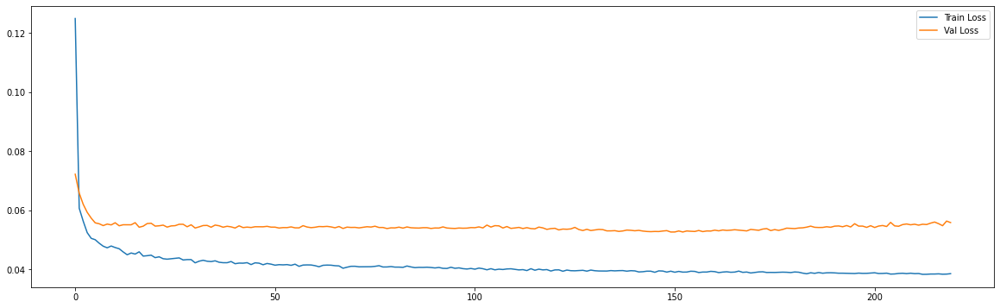

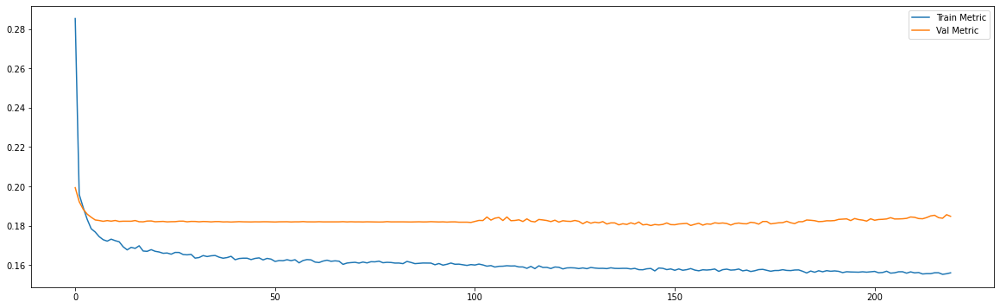

Epoch 00194: early stopping
============================model:34===========================
43/43 [==============================] - 0s 6ms/step - loss: 0.0383 - mae: 0.1554
loss and metric train data [0.03834778070449829, 0.15544945001602173]
8/8 [==============================] - 0s 5ms/step - loss: 0.0507 - mae: 0.1752
loss and metric val data [0.050726376473903656, 0.17516164481639862]
8/8 [==============================] - 0s 4ms/step - loss: 0.0696 - mae: 0.1981
loss and metric test data [0.06960742175579071, 0.19807478785514832]


'neurons': 30, 'dropout': 0.2, 'time_steps': 60, 'batch_size':60, 'learning_rate':0.001, 'hidden_layers':1




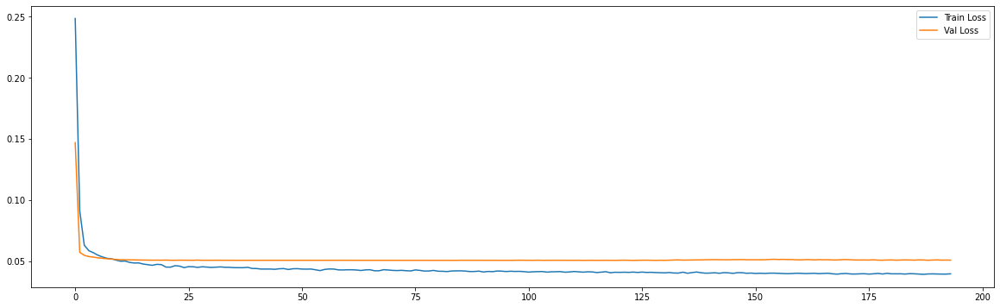

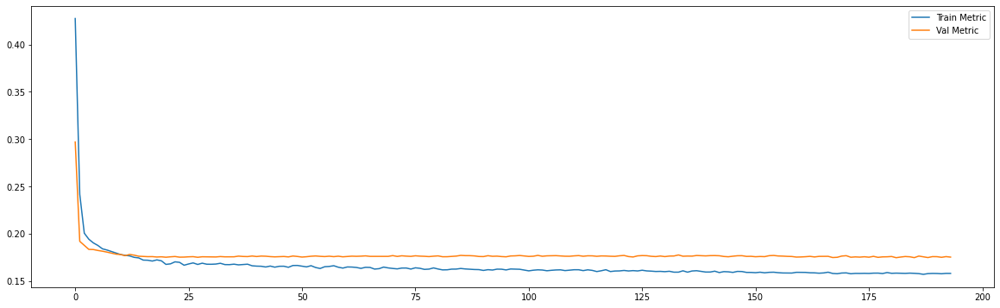

Epoch 00205: early stopping
============================model:35===========================
43/43 [==============================] - 0s 9ms/step - loss: 0.0377 - mae: 0.1536
loss and metric train data [0.037718404084444046, 0.15356802940368652]
8/8 [==============================] - 0s 8ms/step - loss: 0.0541 - mae: 0.1819
loss and metric val data [0.054101862013339996, 0.181855246424675]
8/8 [==============================] - 0s 8ms/step - loss: 0.0826 - mae: 0.2170
loss and metric test data [0.08259258419275284, 0.21698957681655884]


'neurons': 30, 'dropout': 0.2, 'time_steps': 60, 'batch_size':60, 'hidden_layers':2




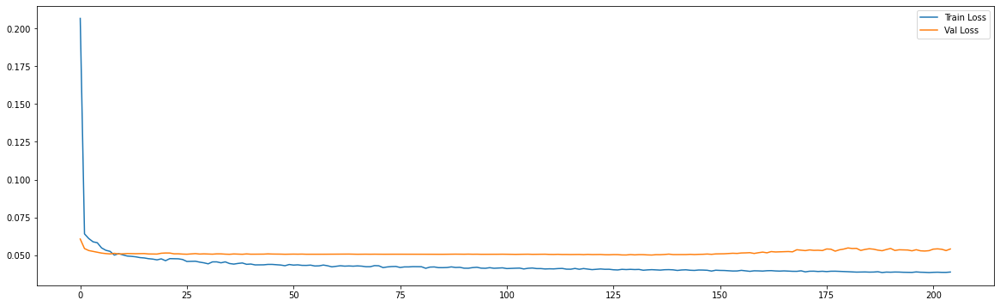

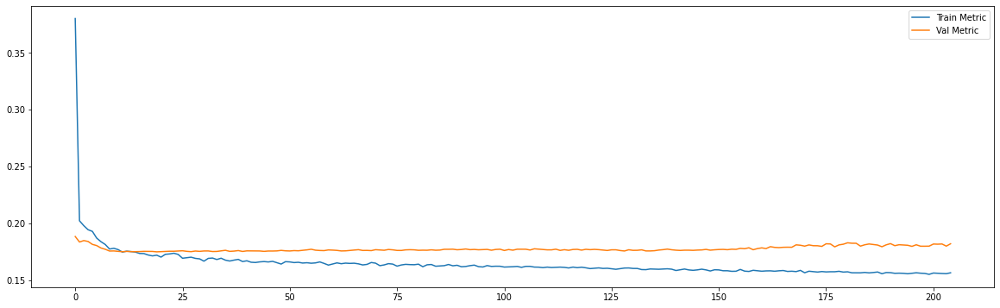

Epoch 00178: early stopping
============================model:36===========================
39/39 [==============================] - 0s 8ms/step - loss: 0.0382 - mae: 0.1559
loss and metric train data [0.03822046145796776, 0.15585951507091522]
7/7 [==============================] - 0s 9ms/step - loss: 0.0487 - mae: 0.1700
loss and metric val data [0.04868919402360916, 0.16996286809444427]
7/7 [==============================] - 0s 8ms/step - loss: 0.0848 - mae: 0.2241
loss and metric test data [0.08482510596513748, 0.22408422827720642]


'neurons': 30, 'dropout': 0.2, 'time_steps': 120, 'batch_size':120, 'learning_rate':0.001, 'hidden_layers':1




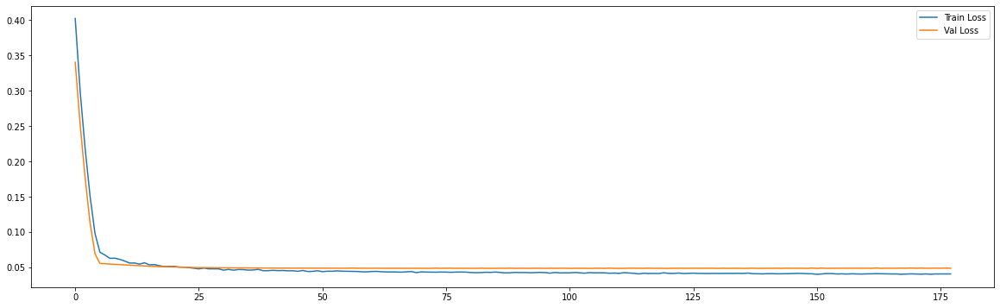

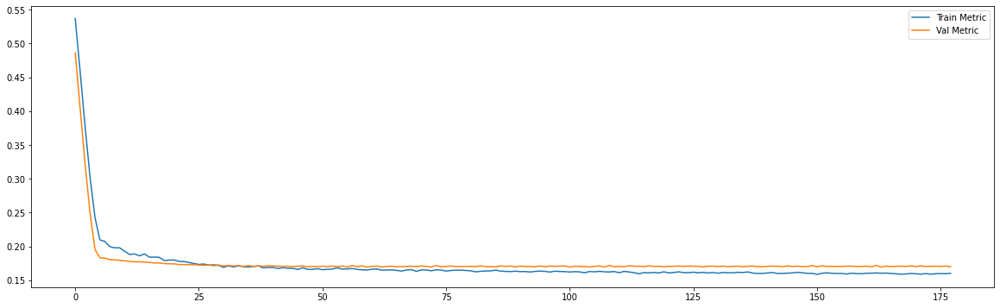

Epoch 00102: early stopping
============================model:37===========================
39/39 [==============================] - 1s 17ms/step - loss: 0.0385 - mae: 0.1568
loss and metric train data [0.03854433447122574, 0.15676820278167725]
7/7 [==============================] - 0s 15ms/step - loss: 0.0487 - mae: 0.1714
loss and metric val data [0.04872431978583336, 0.1713501662015915]
7/7 [==============================] - 0s 14ms/step - loss: 0.0856 - mae: 0.2243
loss and metric test data [0.08555145561695099, 0.22430042922496796]


'neurons': 30, 'dropout': 0.2, 'time_steps': 120, 'batch_size':120, 'hidden_layers':2




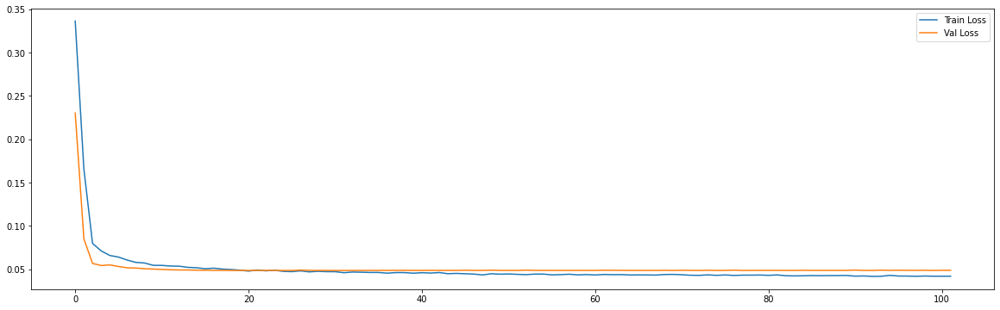

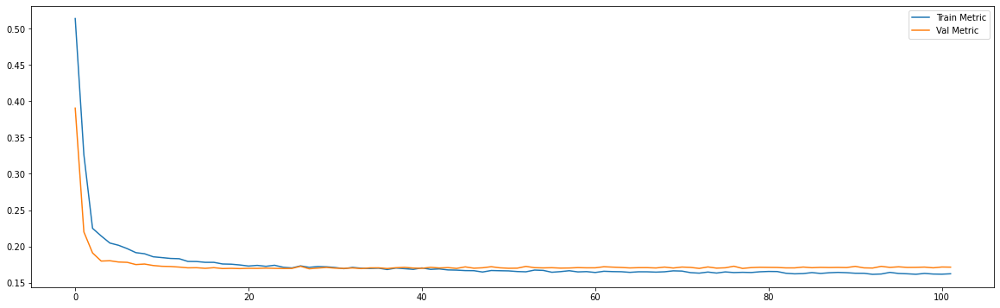

Epoch 00172: early stopping
============================model:38===========================
32/32 [==============================] - 0s 15ms/step - loss: 0.0427 - mae: 0.1662
loss and metric train data [0.042698681354522705, 0.16621054708957672]
3/3 [==============================] - 0s 10ms/step - loss: 0.0728 - mae: 0.2110
loss and metric val data [0.07279602438211441, 0.2109987586736679]
3/3 [==============================] - 0s 10ms/step - loss: 0.1519 - mae: 0.3108
loss and metric test data [0.15190410614013672, 0.3108256459236145]


'neurons': 30, 'dropout': 0.2, 'time_steps': 240, 'batch_size':240, 'learning_rate':0.001, 'hidden_layers':1




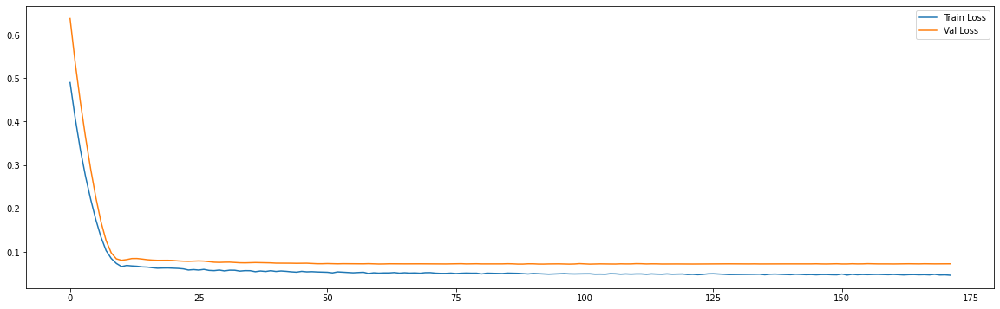

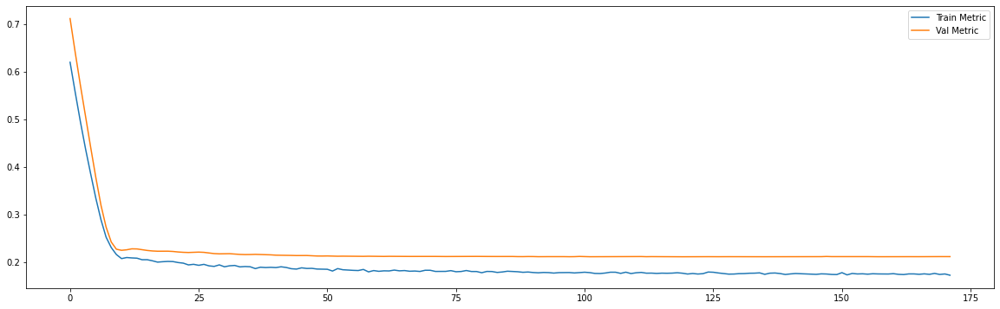

Epoch 00308: early stopping
============================model:39===========================
32/32 [==============================] - 1s 30ms/step - loss: 0.0424 - mae: 0.1657
loss and metric train data [0.042377132922410965, 0.16571667790412903]
3/3 [==============================] - 0s 20ms/step - loss: 0.0719 - mae: 0.2114
loss and metric val data [0.07190306484699249, 0.21135571599006653]
3/3 [==============================] - 0s 20ms/step - loss: 0.1503 - mae: 0.3096
loss and metric test data [0.15025708079338074, 0.30960550904273987]


'neurons': 30, 'dropout': 0.2, 'time_steps': 240, 'batch_size':240, 'hidden_layers':2




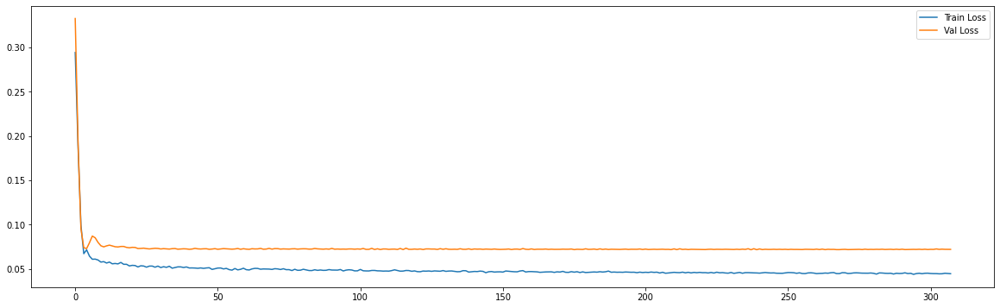

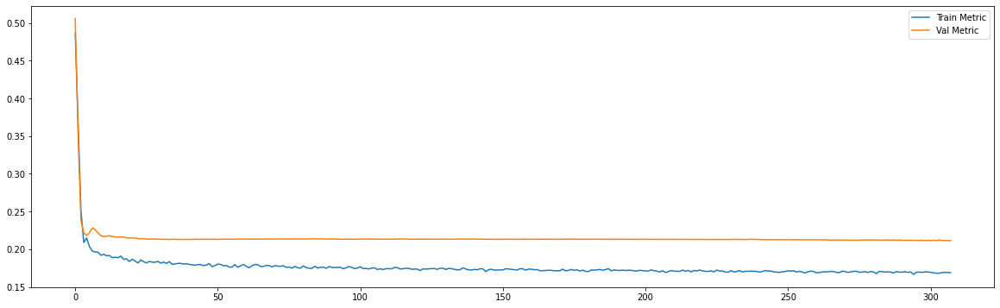

Epoch 00231: early stopping
============================model:40===========================
45/45 [==============================] - 0s 4ms/step - loss: 0.0388 - mae: 0.1566
loss and metric train data [0.03876986354589462, 0.15659838914871216]
9/9 [==============================] - 0s 3ms/step - loss: 0.0538 - mae: 0.1826
loss and metric val data [0.05375577136874199, 0.18256887793540955]
9/9 [==============================] - 0s 4ms/step - loss: 0.0642 - mae: 0.1867
loss and metric test data [0.06416008621454239, 0.1866960972547531]


'neurons': 30, 'dropout': 0.4, 'time_steps': 30, 'batch_size':30, 'learning_rate':0.001, 'hidden_layers':1




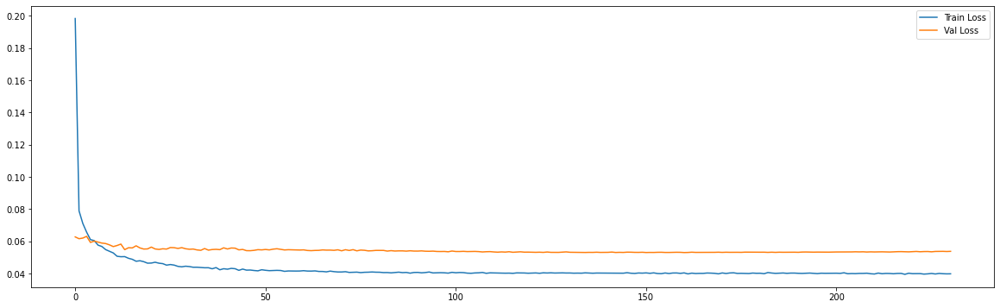

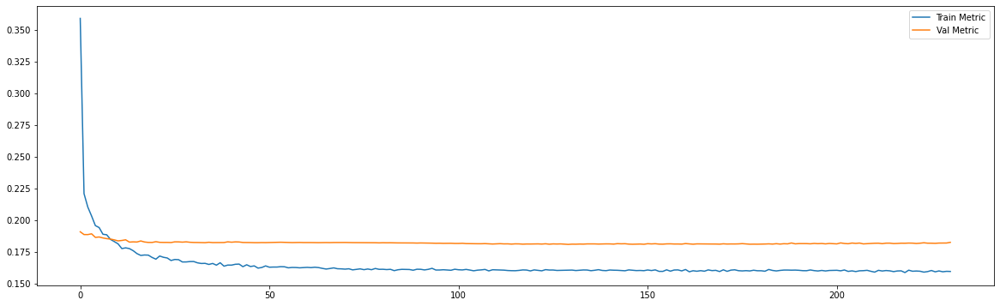

Epoch 00239: early stopping
============================model:41===========================
45/45 [==============================] - 0s 6ms/step - loss: 0.0382 - mae: 0.1545
loss and metric train data [0.03820471093058586, 0.1545039415359497]
9/9 [==============================] - 0s 5ms/step - loss: 0.0547 - mae: 0.1835
loss and metric val data [0.05474448204040527, 0.18345335125923157]
9/9 [==============================] - 0s 6ms/step - loss: 0.0647 - mae: 0.1872
loss and metric test data [0.06471249461174011, 0.18719066679477692]


'neurons': 30, 'dropout': 0.4, 'time_steps': 30, 'batch_size':30, 'hidden_layers':2




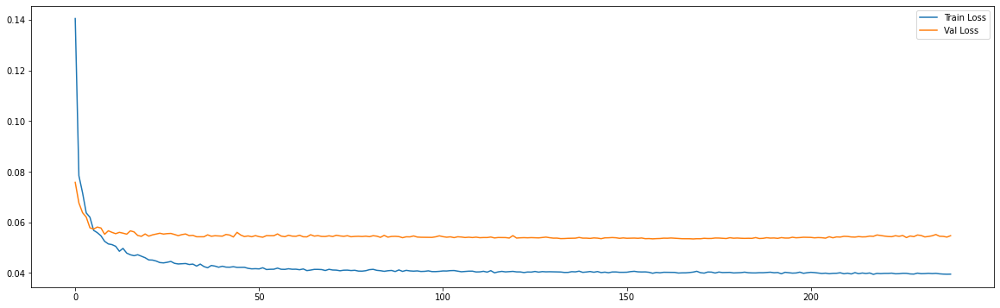

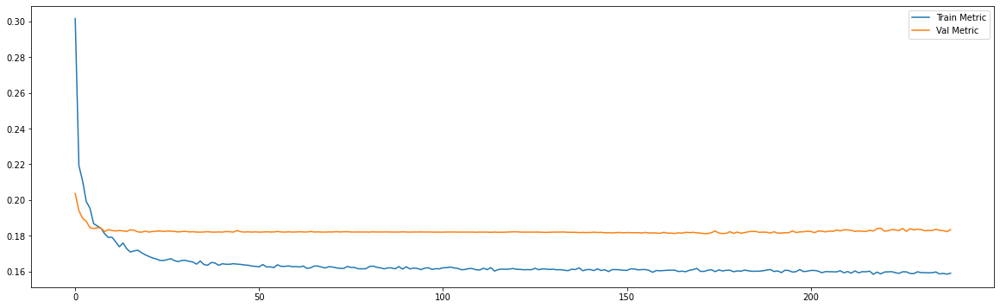

Epoch 00164: early stopping
============================model:42===========================
43/43 [==============================] - 0s 6ms/step - loss: 0.0384 - mae: 0.1562
loss and metric train data [0.03844873979687691, 0.1561530977487564]
8/8 [==============================] - 0s 5ms/step - loss: 0.0510 - mae: 0.1753
loss and metric val data [0.051019489765167236, 0.17531287670135498]
8/8 [==============================] - 0s 6ms/step - loss: 0.0693 - mae: 0.1970
loss and metric test data [0.06928800046443939, 0.19698914885520935]


'neurons': 30, 'dropout': 0.4, 'time_steps': 60, 'batch_size':60, 'learning_rate':0.001, 'hidden_layers':1




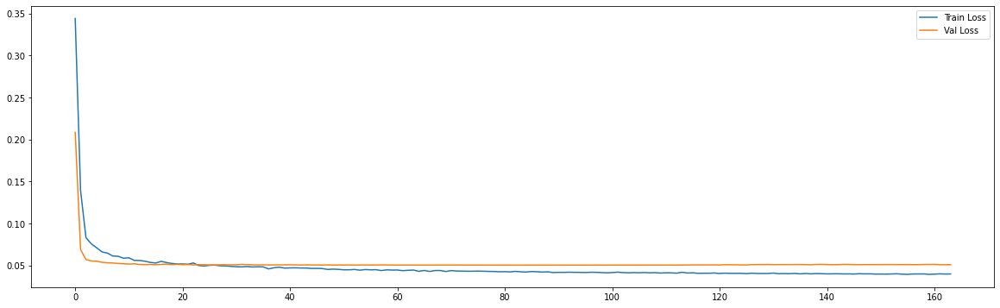

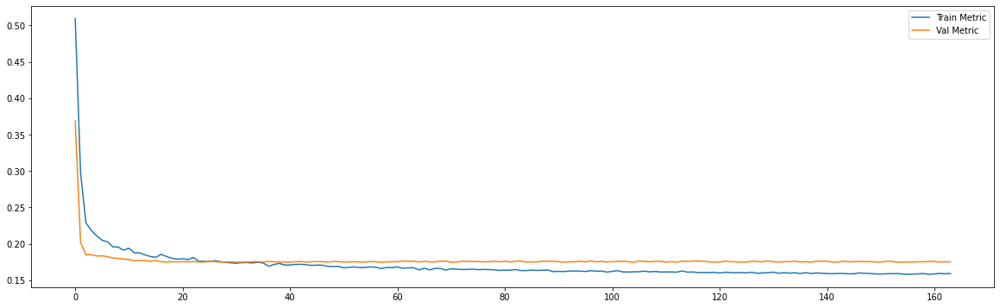

Epoch 00239: early stopping
============================model:43===========================
43/43 [==============================] - 0s 10ms/step - loss: 0.0382 - mae: 0.1550
loss and metric train data [0.03815075382590294, 0.1549847424030304]
8/8 [==============================] - 0s 9ms/step - loss: 0.0514 - mae: 0.1757
loss and metric val data [0.05144396051764488, 0.17567597329616547]
8/8 [==============================] - 0s 8ms/step - loss: 0.0700 - mae: 0.1977
loss and metric test data [0.07002135366201401, 0.19767701625823975]


'neurons': 30, 'dropout': 0.4, 'time_steps': 60, 'batch_size':60, 'hidden_layers':2




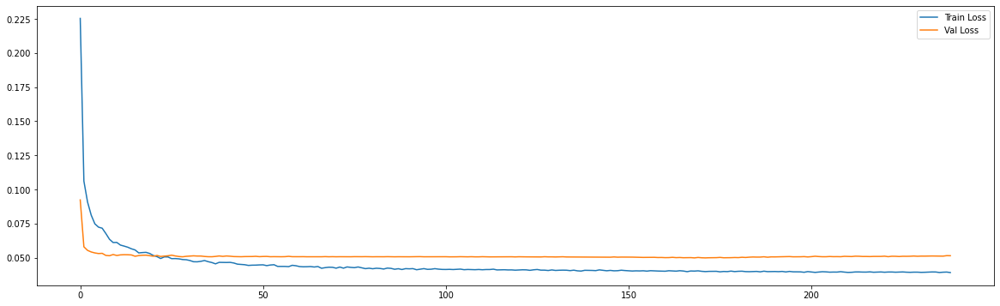

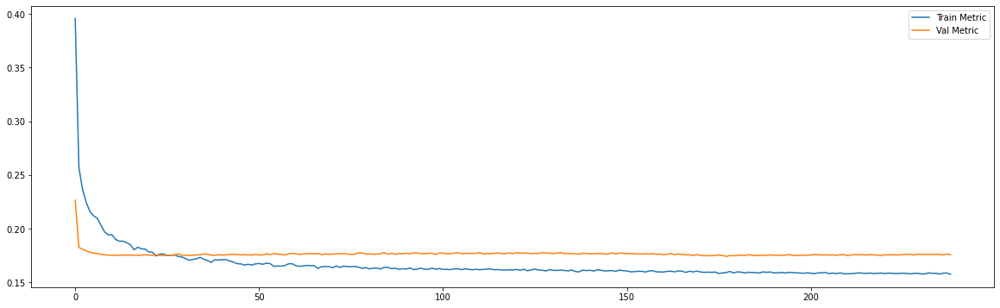

Epoch 00120: early stopping
============================model:44===========================
39/39 [==============================] - 0s 8ms/step - loss: 0.0385 - mae: 0.1569
loss and metric train data [0.03854604437947273, 0.1568855196237564]
7/7 [==============================] - 0s 8ms/step - loss: 0.0485 - mae: 0.1701
loss and metric val data [0.048546504229307175, 0.1701360046863556]
7/7 [==============================] - 0s 7ms/step - loss: 0.0853 - mae: 0.2235
loss and metric test data [0.0852503851056099, 0.2234615832567215]


'neurons': 30, 'dropout': 0.4, 'time_steps': 120, 'batch_size':120, 'learning_rate':0.001, 'hidden_layers':1




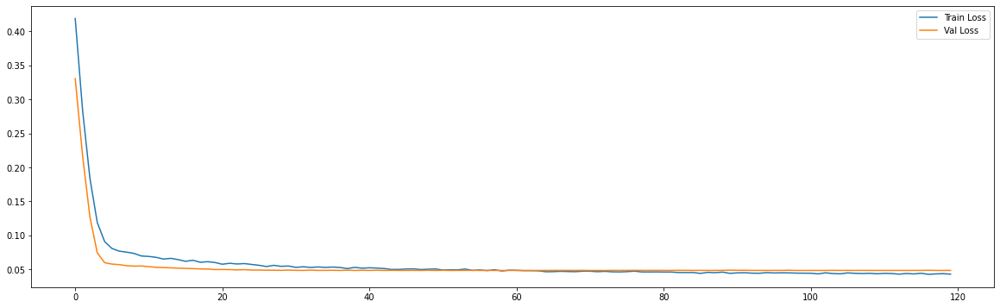

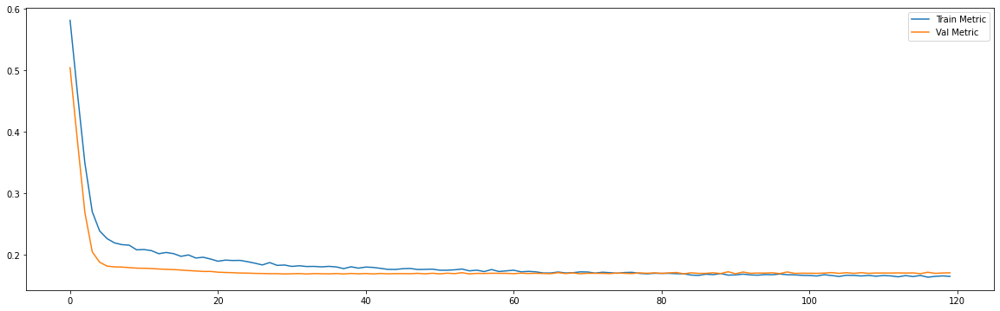

Epoch 00099: early stopping
============================model:45===========================
39/39 [==============================] - 1s 16ms/step - loss: 0.0388 - mae: 0.1570
loss and metric train data [0.03882607817649841, 0.15696130692958832]
7/7 [==============================] - 0s 14ms/step - loss: 0.0487 - mae: 0.1700
loss and metric val data [0.04872473329305649, 0.1699952483177185]
7/7 [==============================] - 0s 15ms/step - loss: 0.0861 - mae: 0.2238
loss and metric test data [0.08609963208436966, 0.2237555980682373]


'neurons': 30, 'dropout': 0.4, 'time_steps': 120, 'batch_size':120, 'hidden_layers':2




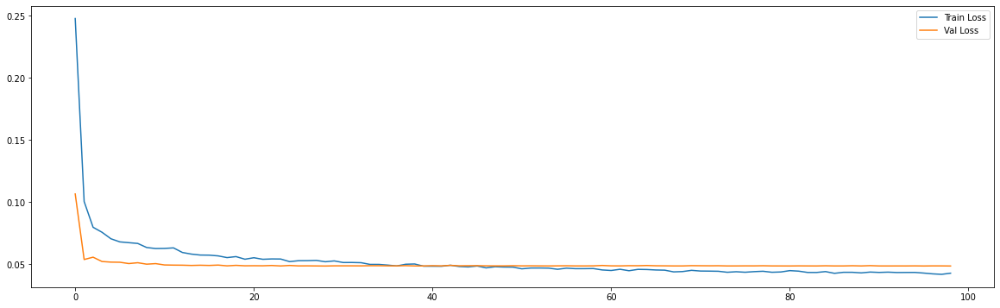

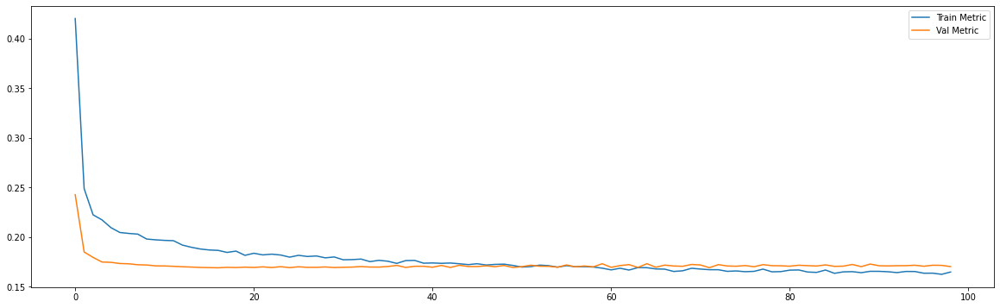

Epoch 00199: early stopping
============================model:46===========================
32/32 [==============================] - 0s 14ms/step - loss: 0.0430 - mae: 0.1667
loss and metric train data [0.042970143258571625, 0.1667318344116211]
3/3 [==============================] - 0s 11ms/step - loss: 0.0728 - mae: 0.2123
loss and metric val data [0.0727824792265892, 0.21234436333179474]
3/3 [==============================] - 0s 10ms/step - loss: 0.1523 - mae: 0.3105
loss and metric test data [0.15233846008777618, 0.31053468585014343]


'neurons': 30, 'dropout': 0.4, 'time_steps': 240, 'batch_size':240, 'learning_rate':0.001, 'hidden_layers':1




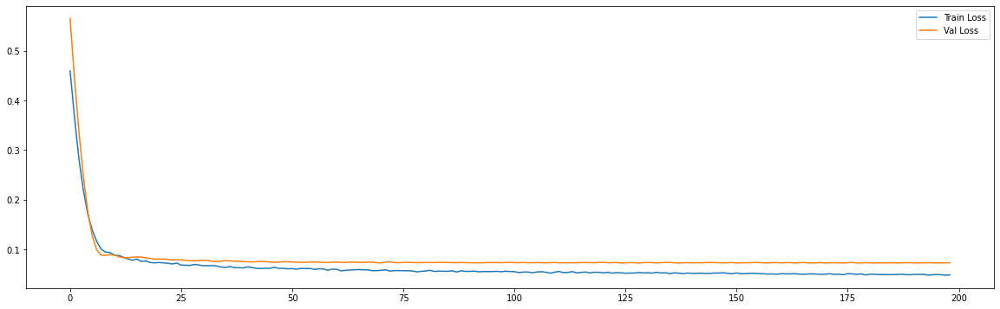

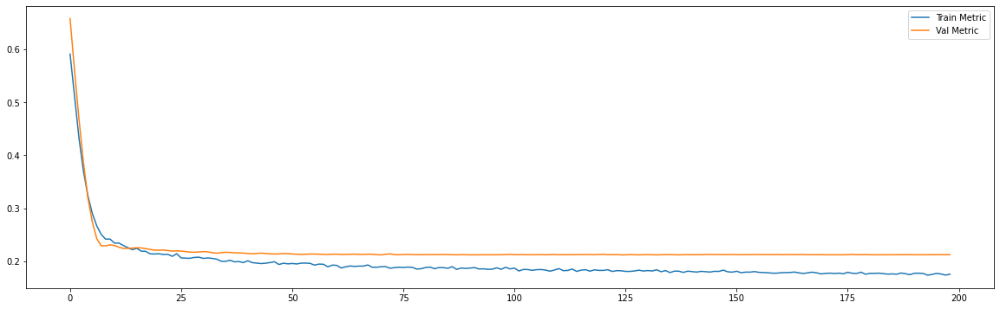

Epoch 00257: early stopping
============================model:47===========================
32/32 [==============================] - 1s 29ms/step - loss: 0.0427 - mae: 0.1666
loss and metric train data [0.042703330516815186, 0.1665692925453186]
3/3 [==============================] - 0s 22ms/step - loss: 0.0722 - mae: 0.2138
loss and metric val data [0.07220840454101562, 0.21382097899913788]
3/3 [==============================] - 0s 21ms/step - loss: 0.1504 - mae: 0.3073
loss and metric test data [0.15038859844207764, 0.30727067589759827]


'neurons': 30, 'dropout': 0.4, 'time_steps': 240, 'batch_size':240, 'hidden_layers':2




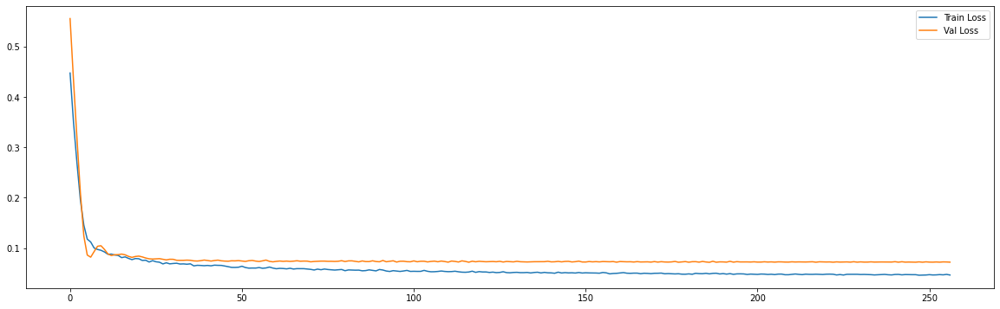

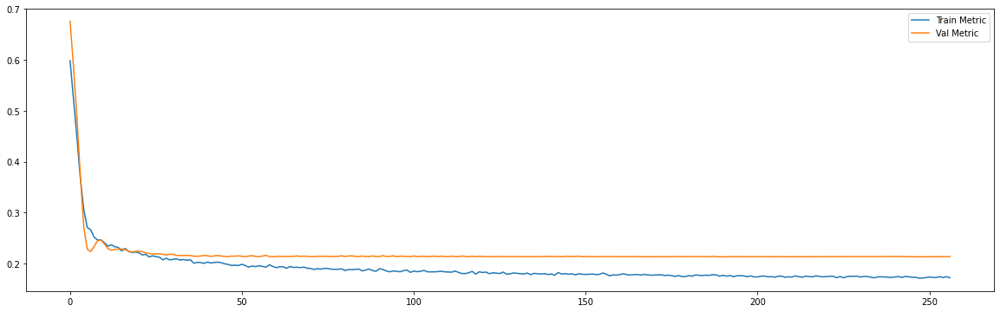

In [0]:
future_steps = 5
n_features = 1

neurons_list = [20,25,30]
dropout_list = [0.2,0.4]
time_steps_list = [30,60,120,240]
lr_list = [0.001]
models = {}
i=0
for neurons in neurons_list:
  for dropout in dropout_list:
    for time_steps in time_steps_list:
      for lr in lr_list:
        x_train,x_test,x_val,y_train,y_val,y_test = Regressor(future_steps = future_steps,time_steps = time_steps,n_features = n_features,df_train = df_train_norm,df_val = df_val_norm,df_test = df_test_norm)

        models[i] = {'neurons':neurons,'dropout':dropout,'time_steps': time_steps, 'batch_size':time_steps, 'learning_rate':lr}
        models[i]['resumo'] = "'neurons': {}, 'dropout': {}, 'time_steps': {}, 'batch_size':{}, 'learning_rate':{}, 'hidden_layers':{}".format(neurons,dropout,time_steps,time_steps,lr,1)

        # The GRU architecture
        models[i]['model'] = Sequential()
        models[i]['model'].add(GRU(units=neurons, return_sequences=False,input_shape=(time_steps, n_features))) # return_sequences=True next layer is GRU
        models[i]['model'].add(Dropout(dropout))
        models[i]['model'].add(Dense(units=future_steps))

        #Compiling the GRU
        adam = optimizers.Adam(lr = lr, beta_1 = 0.9, beta_2 = 0.999, decay = 0.0)
        models[i]['model'].compile(optimizer = adam, loss = 'mse', metrics=['mae'])

        # early stop
        es = EarlyStopping(monitor='val_loss', mode='min', verbose=1, patience = 70)

        #Fitting to traning set
        history = models[i]['model'].fit(x_train, y_train, validation_data = (x_val,y_val), epochs = 500, batch_size = time_steps, verbose = 0, shuffle = False, callbacks = [es])

        print('============================model:{}==========================='.format(i))

          
        print('loss and metric train data',models[i]['model'].evaluate(x_train,y_train))
        print('loss and metric val data',models[i]['model'].evaluate(x_val,y_val))
        print('loss and metric test data',models[i]['model'].evaluate(x_test,y_test))
        print('\n')

        print(models[i]['resumo'])
        print('\n')

        plt.figure(figsize=(20,6))
        plt.plot(history.history['loss'])
        plt.plot(history.history['val_loss'])
        plt.legend(['Train Loss', 'Val Loss'])

        plt.figure(figsize=(20,6))
        plt.plot(history.history['mae'])
        plt.plot(history.history['val_mae'])
        plt.legend(['Train Metric', 'Val Metric'])
        plt.show()

        i+=1


        models[i] = {'neurons':neurons,'dropout':dropout,'time_steps': time_steps, 'batch_size':time_steps}
        models[i]['resumo'] = "'neurons': {}, 'dropout': {}, 'time_steps': {}, 'batch_size':{}, 'hidden_layers':{}".format(neurons,dropout,time_steps,time_steps,2)

        # The GRU architecture
        models[i]['model'] = Sequential()
        models[i]['model'].add(GRU(units=neurons, return_sequences=True,input_shape=(time_steps, n_features))) # return_sequences=True next layer is GRU
        models[i]['model'].add(Dropout(dropout))
        models[i]['model'].add(GRU(units=neurons, return_sequences=False))
        models[i]['model'].add(Dropout(dropout))
        models[i]['model'].add(Dense(units=future_steps))

        #Compiling the GRU
        adam = optimizers.Adam(lr = lr, beta_1 = 0.9, beta_2 = 0.999, decay = 0.0)
        models[i]['model'].compile(optimizer = adam, loss = 'mse', metrics=['mae'])

         # early stop
        es = EarlyStopping(monitor='val_loss', mode='min', verbose=1, patience = 70)

        #Fitting to traning set
        history = models[i]['model'].fit(x_train, y_train, validation_data = (x_val,y_val), epochs = 500, batch_size = time_steps, verbose = 0, shuffle = False, callbacks = [es])

        print('============================model:{}==========================='.format(i))

          
        print('loss and metric train data',models[i]['model'].evaluate(x_train,y_train))
        print('loss and metric val data',models[i]['model'].evaluate(x_val,y_val))
        print('loss and metric test data',models[i]['model'].evaluate(x_test,y_test))
        print('\n')

        print(models[i]['resumo'])
        print('\n')

        plt.figure(figsize=(20,6))
        plt.plot(history.history['loss'])
        plt.plot(history.history['val_loss'])
        plt.legend(['Train Loss', 'Val Loss'])

        plt.figure(figsize=(20,6))
        plt.plot(history.history['mae'])
        plt.plot(history.history['val_mae'])
        plt.legend(['Train Metric', 'Val Metric'])
        plt.show()

        i+=1

## Excluding Outliers 

In [0]:
df_daily = pd.read_csv('/content/drive/My Drive/ML Projects/Pharma Sales/Data/salesdaily.csv')
df_daily = df_daily['N02BE']

In [0]:
df_train,df_val,df_test = dataSplit(df = df_daily,train_percent = 0.7,val_percent = 0.15)

(1474,)
(316,)
(316,)


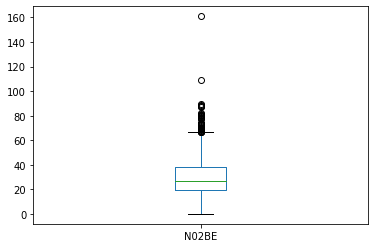

In [0]:
df_train.plot.box()

In [0]:
print(df_train[df_train>df_train.quantile(0.8)].shape)
print(df_train[df_train>df_train.quantile(0.9)].shape)
print(df_train[df_train>df_train.quantile(0.95)].shape)

(295,)
(148,)
(74,)


In [0]:
df_train = df_train[df_train<df_train.quantile(0.9)].reset_index(drop = True)

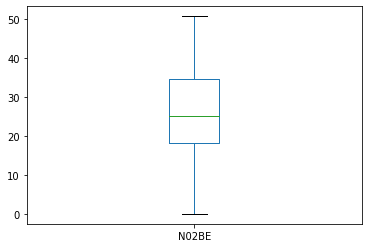

In [0]:
df_train.plot.box()

In [0]:
df_train_norm,df_val_norm,df_test_norm = normalizing_data(df_train,df_val,df_test,frange=(0,1))

[1.]
[0.]


[1.47140039]
[0.]


[1.97435897]
[0.]
-------------------------
(1326, 1)
(316, 1)
(316, 1)


Epoch 00256: early stopping
============================model:0===========================
40/40 [==============================] - 0s 4ms/step - loss: 0.0336 - mae: 0.1465
loss and metric train data [0.03362102806568146, 0.14646250009536743]
9/9 [==============================] - 0s 4ms/step - loss: 0.0544 - mae: 0.1841
loss and metric val data [0.05444617196917534, 0.1840660721063614]
9/9 [==============================] - 0s 4ms/step - loss: 0.0691 - mae: 0.1902
loss and metric test data [0.06907723844051361, 0.19023190438747406]


'neurons': 20, 'dropout': 0.2, 'time_steps': 30, 'batch_size':30, 'learning_rate':0.001, 'hidden_layers':1




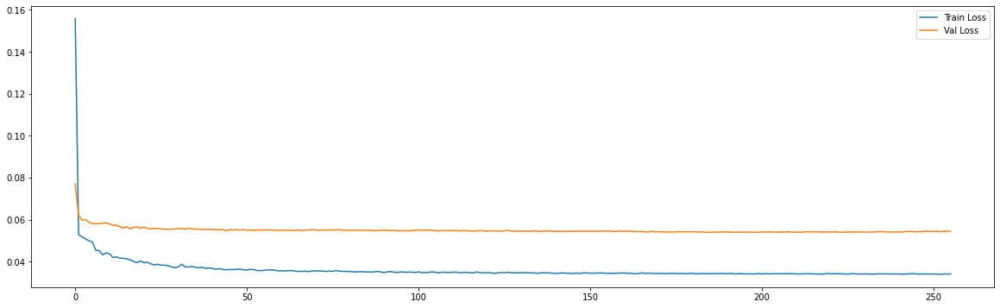

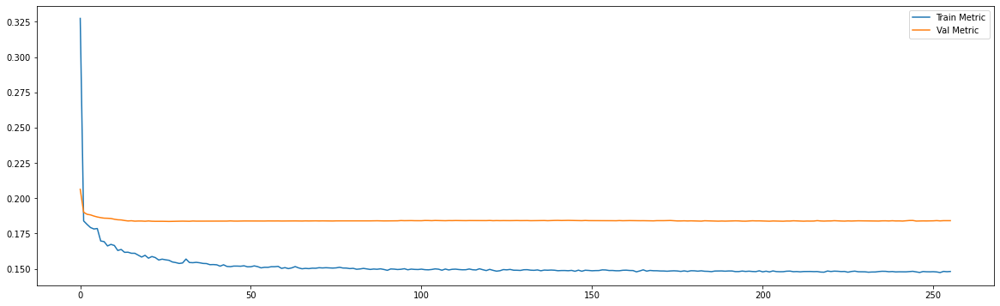

Epoch 00301: early stopping
============================model:1===========================
40/40 [==============================] - 0s 6ms/step - loss: 0.0326 - mae: 0.1444
loss and metric train data [0.032629601657390594, 0.1443682610988617]
9/9 [==============================] - 0s 6ms/step - loss: 0.0567 - mae: 0.1874
loss and metric val data [0.05670798942446709, 0.18740180134773254]
9/9 [==============================] - 0s 5ms/step - loss: 0.0749 - mae: 0.1948
loss and metric test data [0.07490480691194534, 0.19484850764274597]


'neurons': 20, 'dropout': 0.2, 'time_steps': 30, 'batch_size':30, 'hidden_layers':2




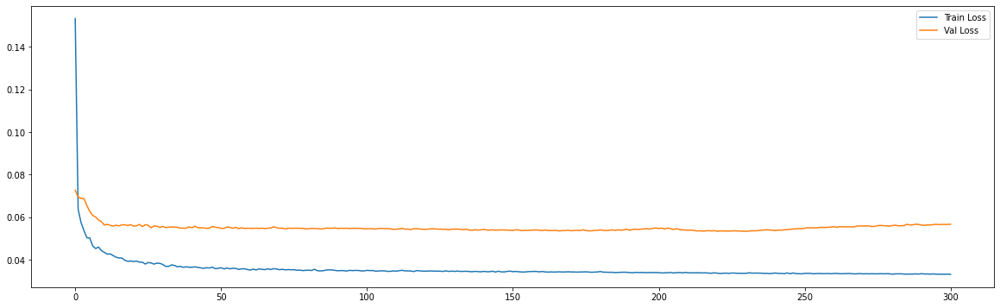

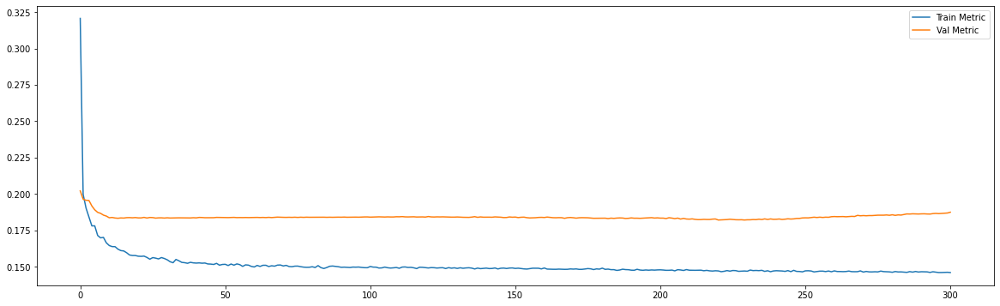

Epoch 00108: early stopping
============================model:2===========================
38/38 [==============================] - 0s 6ms/step - loss: 0.0337 - mae: 0.1467
loss and metric train data [0.03366507217288017, 0.1467243731021881]
8/8 [==============================] - 0s 6ms/step - loss: 0.0514 - mae: 0.1773
loss and metric val data [0.05144134536385536, 0.177337184548378]
8/8 [==============================] - 0s 7ms/step - loss: 0.0721 - mae: 0.1995
loss and metric test data [0.07212100923061371, 0.1994602233171463]


'neurons': 20, 'dropout': 0.2, 'time_steps': 60, 'batch_size':60, 'learning_rate':0.001, 'hidden_layers':1




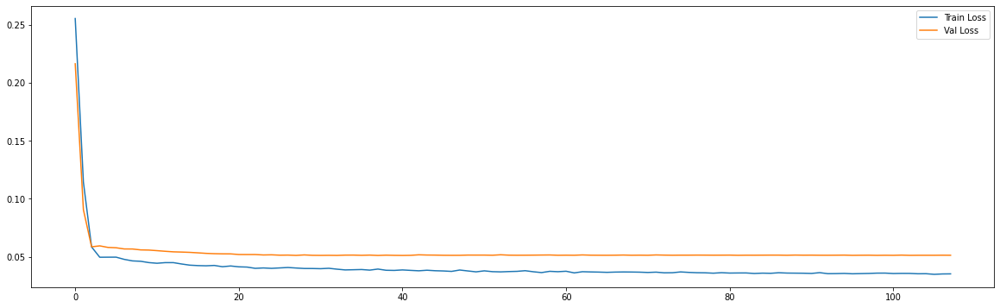

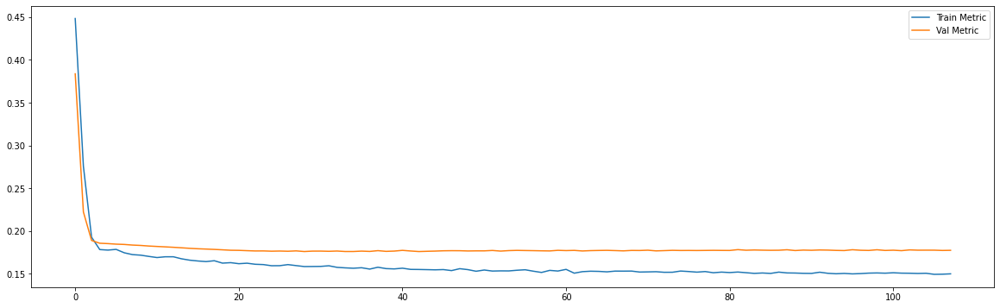

Epoch 00089: early stopping
============================model:3===========================
38/38 [==============================] - 0s 9ms/step - loss: 0.0338 - mae: 0.1468
loss and metric train data [0.03375796973705292, 0.14682678878307343]
8/8 [==============================] - 0s 8ms/step - loss: 0.0516 - mae: 0.1775
loss and metric val data [0.05159902572631836, 0.17748765647411346]
8/8 [==============================] - 0s 8ms/step - loss: 0.0728 - mae: 0.1995
loss and metric test data [0.07279078662395477, 0.1994742453098297]


'neurons': 20, 'dropout': 0.2, 'time_steps': 60, 'batch_size':60, 'hidden_layers':2




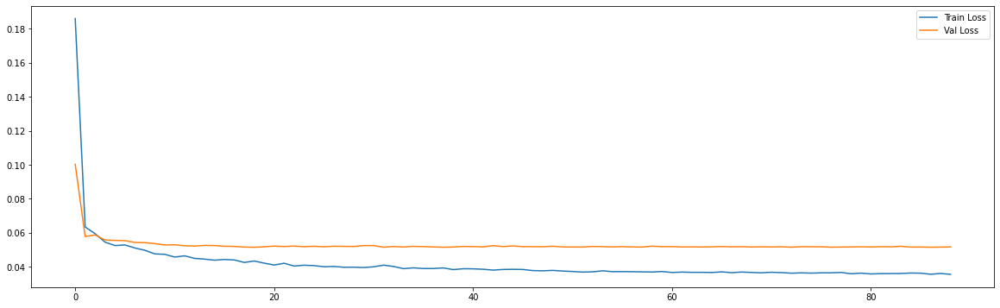

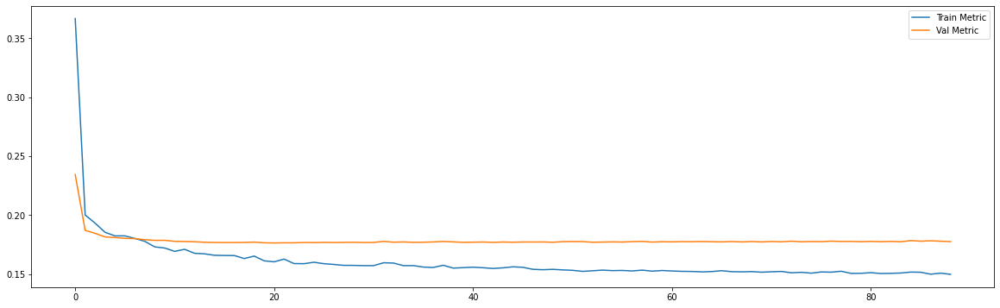

Epoch 00142: early stopping
============================model:4===========================
34/34 [==============================] - 0s 8ms/step - loss: 0.0333 - mae: 0.1453
loss and metric train data [0.03327402099967003, 0.14533258974552155]
7/7 [==============================] - 0s 8ms/step - loss: 0.0504 - mae: 0.1742
loss and metric val data [0.05044734105467796, 0.17422839999198914]
7/7 [==============================] - 0s 7ms/step - loss: 0.0897 - mae: 0.2265
loss and metric test data [0.08968645334243774, 0.2265213578939438]


'neurons': 20, 'dropout': 0.2, 'time_steps': 120, 'batch_size':120, 'learning_rate':0.001, 'hidden_layers':1




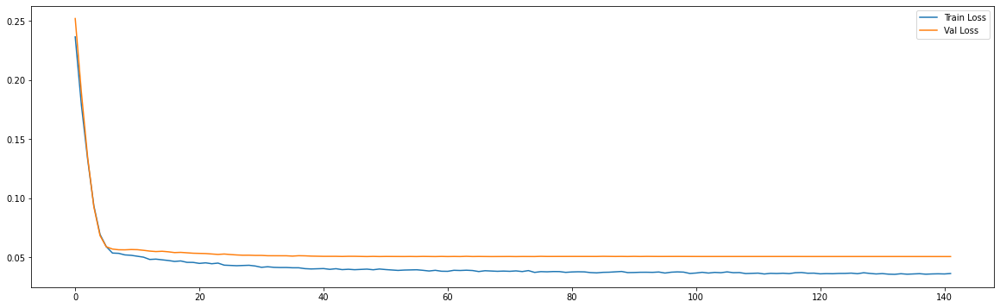

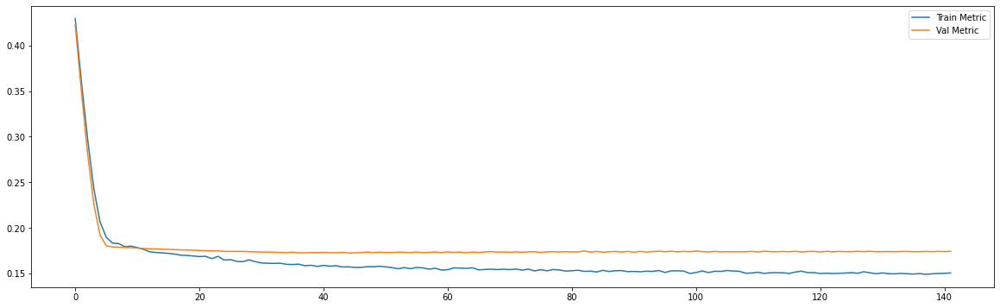

Epoch 00106: early stopping
============================model:5===========================
34/34 [==============================] - 1s 16ms/step - loss: 0.0333 - mae: 0.1451
loss and metric train data [0.03327804431319237, 0.14514890313148499]
7/7 [==============================] - 0s 16ms/step - loss: 0.0503 - mae: 0.1742
loss and metric val data [0.05033549666404724, 0.17423401772975922]
7/7 [==============================] - 0s 13ms/step - loss: 0.0898 - mae: 0.2265
loss and metric test data [0.08980324864387512, 0.22646096348762512]


'neurons': 20, 'dropout': 0.2, 'time_steps': 120, 'batch_size':120, 'hidden_layers':2




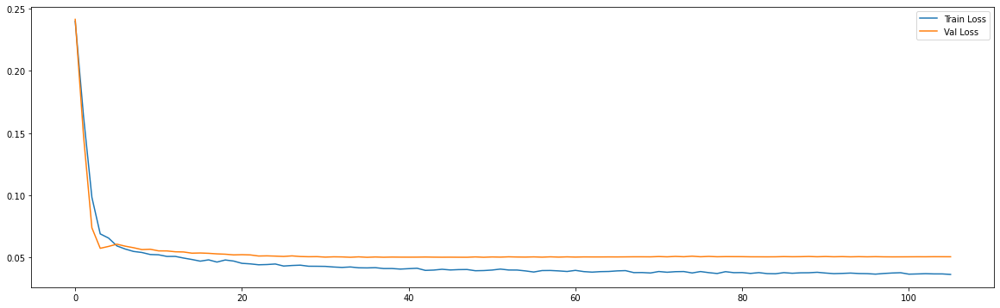

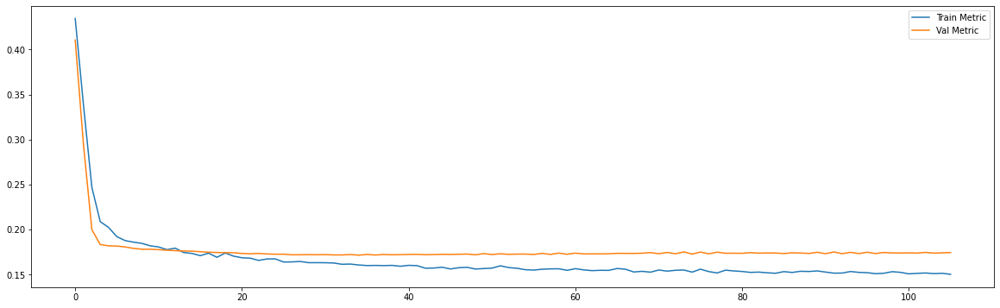

============================model:6===========================
27/27 [==============================] - 0s 15ms/step - loss: 0.0367 - mae: 0.1540
loss and metric train data [0.03671718016266823, 0.15397976338863373]
3/3 [==============================] - 0s 11ms/step - loss: 0.0744 - mae: 0.2168
loss and metric val data [0.07444926351308823, 0.21675832569599152]
3/3 [==============================] - 0s 11ms/step - loss: 0.1522 - mae: 0.3052
loss and metric test data [0.15216988325119019, 0.30516695976257324]


'neurons': 20, 'dropout': 0.2, 'time_steps': 240, 'batch_size':240, 'learning_rate':0.001, 'hidden_layers':1




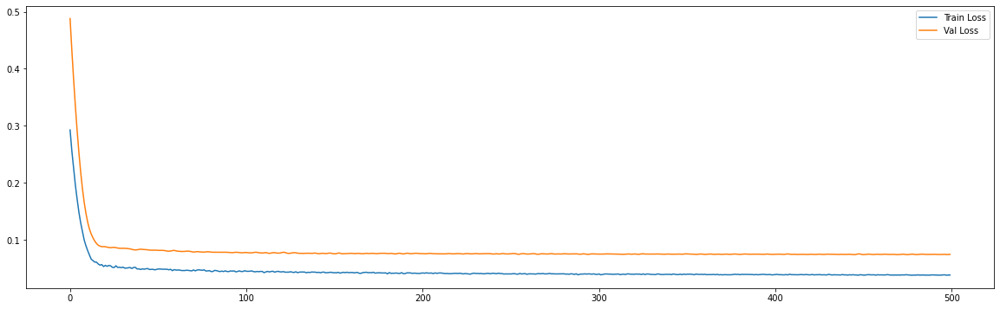

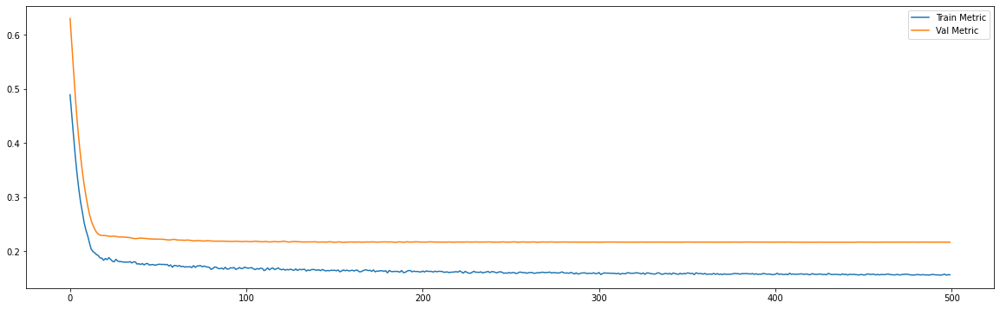

Epoch 00204: early stopping
============================model:7===========================
27/27 [==============================] - 1s 29ms/step - loss: 0.0370 - mae: 0.1546
loss and metric train data [0.037016719579696655, 0.1546422243118286]
3/3 [==============================] - 0s 20ms/step - loss: 0.0761 - mae: 0.2183
loss and metric val data [0.07612258195877075, 0.21827565133571625]
3/3 [==============================] - 0s 19ms/step - loss: 0.1595 - mae: 0.3115
loss and metric test data [0.1594572216272354, 0.3115261197090149]


'neurons': 20, 'dropout': 0.2, 'time_steps': 240, 'batch_size':240, 'hidden_layers':2




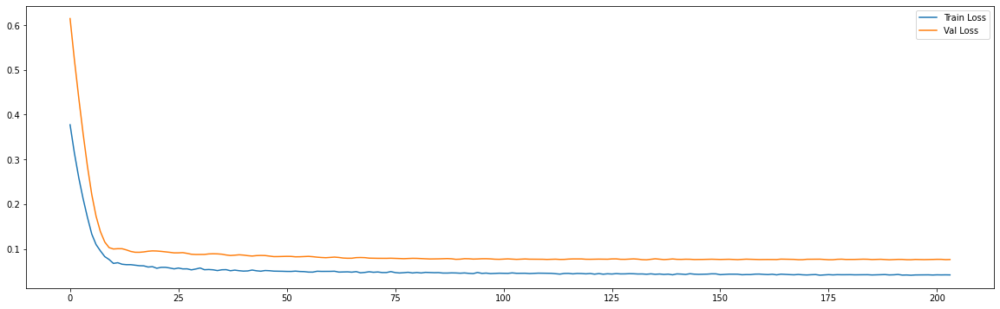

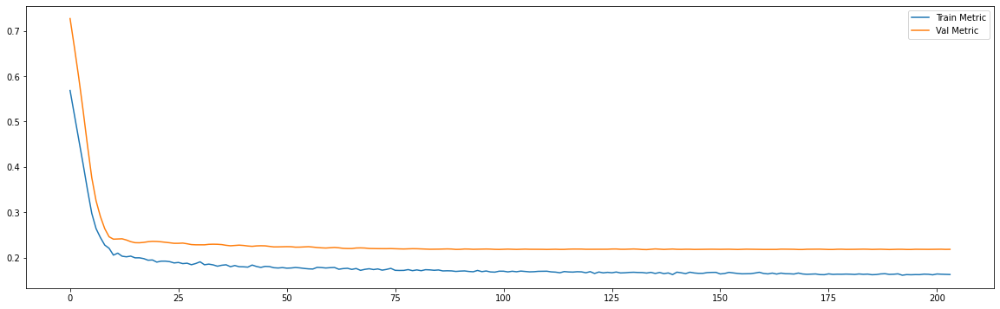

Epoch 00245: early stopping
============================model:8===========================
40/40 [==============================] - 0s 4ms/step - loss: 0.0336 - mae: 0.1466
loss and metric train data [0.03360510617494583, 0.14656010270118713]
9/9 [==============================] - 0s 3ms/step - loss: 0.0543 - mae: 0.1845
loss and metric val data [0.054347503930330276, 0.1845404952764511]
9/9 [==============================] - 0s 4ms/step - loss: 0.0679 - mae: 0.1892
loss and metric test data [0.06788089871406555, 0.1892460435628891]


'neurons': 20, 'dropout': 0.4, 'time_steps': 30, 'batch_size':30, 'learning_rate':0.001, 'hidden_layers':1




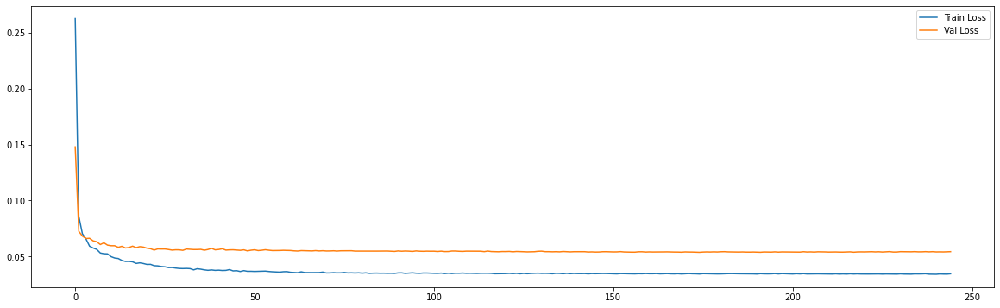

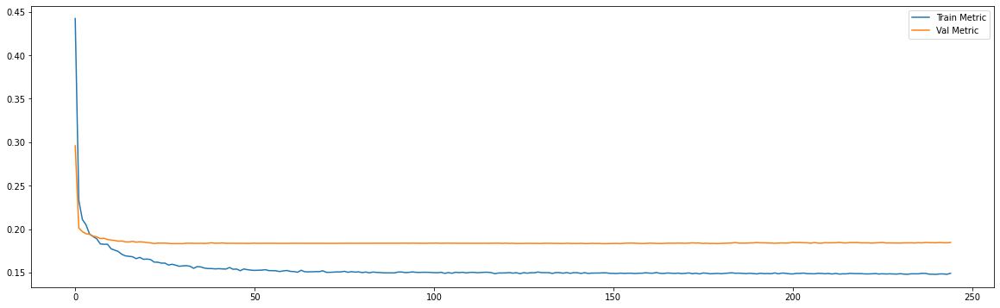

Epoch 00208: early stopping
============================model:9===========================
40/40 [==============================] - 0s 6ms/step - loss: 0.0333 - mae: 0.1456
loss and metric train data [0.033318258821964264, 0.14563331007957458]
9/9 [==============================] - 0s 5ms/step - loss: 0.0560 - mae: 0.1847
loss and metric val data [0.05604637414216995, 0.184737890958786]
9/9 [==============================] - 0s 6ms/step - loss: 0.0722 - mae: 0.1918
loss and metric test data [0.07223521173000336, 0.19183050096035004]


'neurons': 20, 'dropout': 0.4, 'time_steps': 30, 'batch_size':30, 'hidden_layers':2




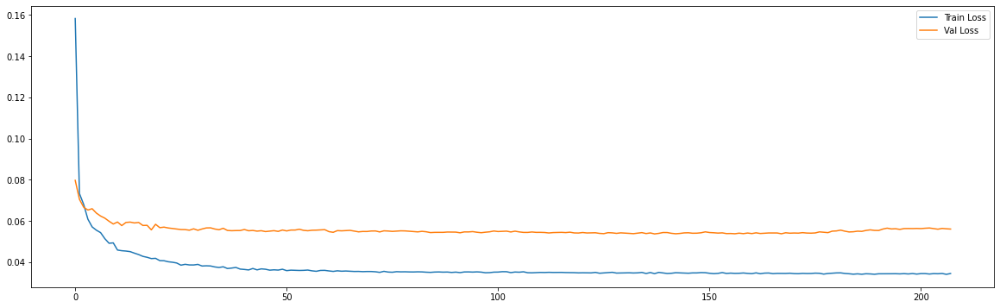

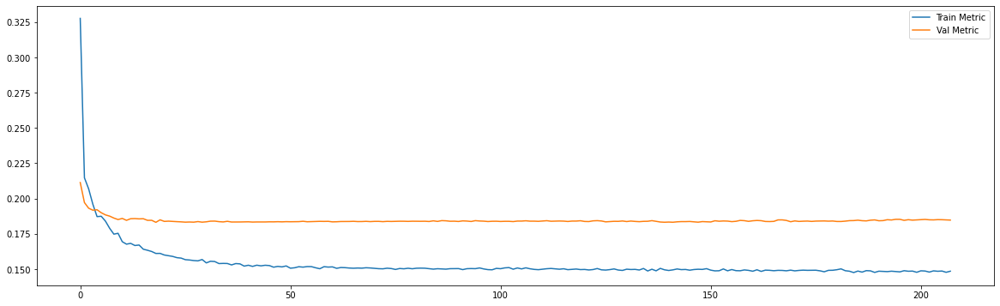

Epoch 00342: early stopping
============================model:10===========================
38/38 [==============================] - 0s 5ms/step - loss: 0.0332 - mae: 0.1457
loss and metric train data [0.0331571064889431, 0.14571325480937958]
8/8 [==============================] - 0s 5ms/step - loss: 0.0512 - mae: 0.1786
loss and metric val data [0.05121881142258644, 0.17855674028396606]
8/8 [==============================] - 0s 5ms/step - loss: 0.0717 - mae: 0.1981
loss and metric test data [0.07172517478466034, 0.19808122515678406]


'neurons': 20, 'dropout': 0.4, 'time_steps': 60, 'batch_size':60, 'learning_rate':0.001, 'hidden_layers':1




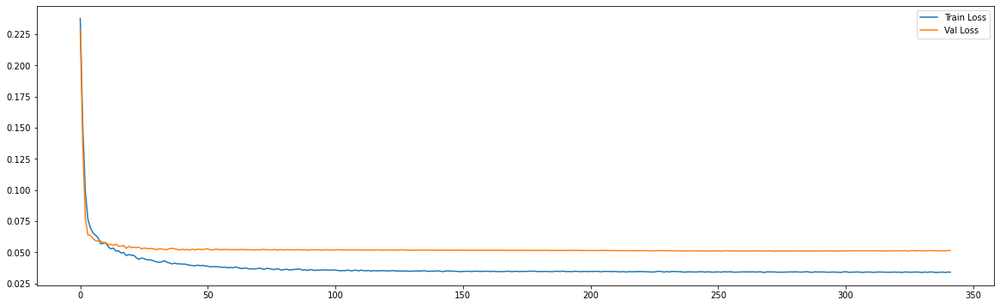

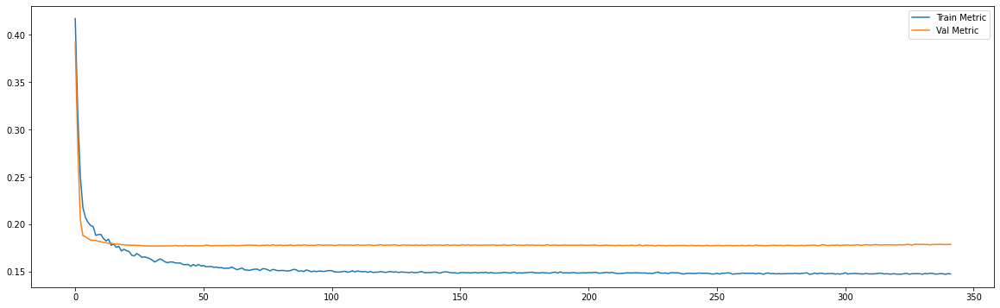

Epoch 00312: early stopping
============================model:11===========================
38/38 [==============================] - 0s 10ms/step - loss: 0.0332 - mae: 0.1455
loss and metric train data [0.03317300230264664, 0.14548437297344208]
8/8 [==============================] - 0s 8ms/step - loss: 0.0512 - mae: 0.1788
loss and metric val data [0.05116656795144081, 0.17875538766384125]
8/8 [==============================] - 0s 9ms/step - loss: 0.0720 - mae: 0.1973
loss and metric test data [0.07196305692195892, 0.19730092585086823]


'neurons': 20, 'dropout': 0.4, 'time_steps': 60, 'batch_size':60, 'hidden_layers':2




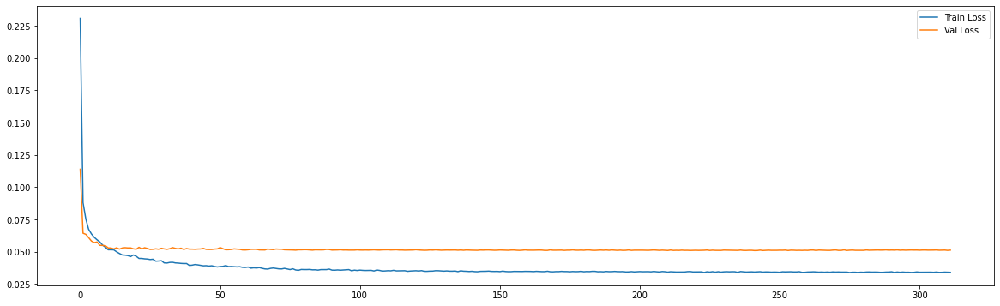

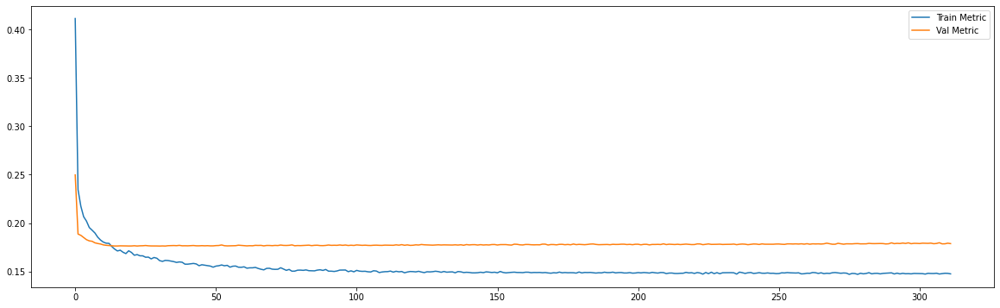

Epoch 00145: early stopping
============================model:12===========================
34/34 [==============================] - 0s 8ms/step - loss: 0.0333 - mae: 0.1454
loss and metric train data [0.03331029787659645, 0.14537177979946136]
7/7 [==============================] - 0s 7ms/step - loss: 0.0503 - mae: 0.1735
loss and metric val data [0.050310924649238586, 0.1734645813703537]
7/7 [==============================] - 0s 7ms/step - loss: 0.0894 - mae: 0.2263
loss and metric test data [0.0893632173538208, 0.22631821036338806]


'neurons': 20, 'dropout': 0.4, 'time_steps': 120, 'batch_size':120, 'learning_rate':0.001, 'hidden_layers':1




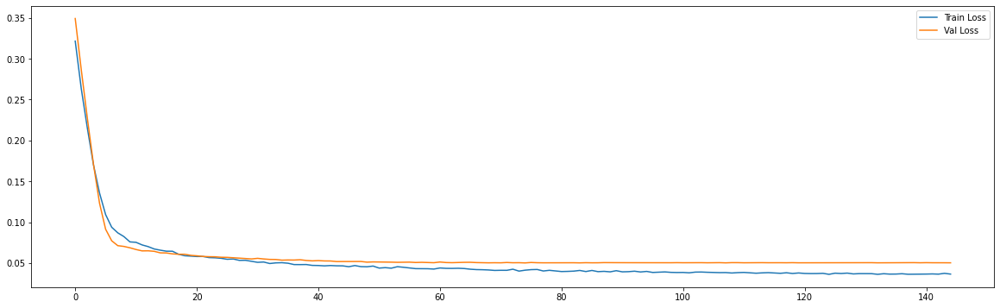

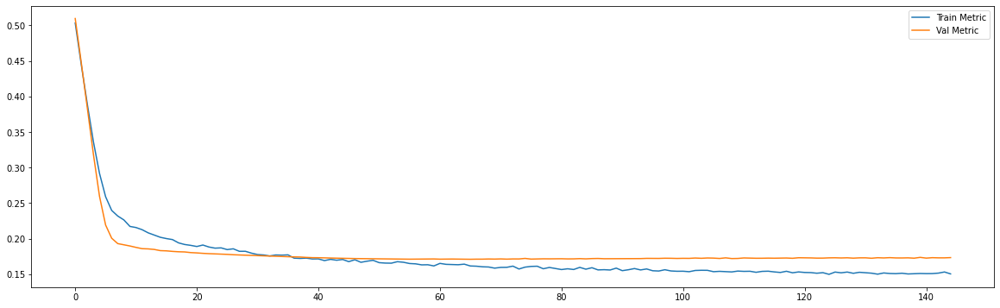

Epoch 00118: early stopping
============================model:13===========================
34/34 [==============================] - 1s 16ms/step - loss: 0.0337 - mae: 0.1456
loss and metric train data [0.03374210000038147, 0.14563101530075073]
7/7 [==============================] - 0s 14ms/step - loss: 0.0502 - mae: 0.1714
loss and metric val data [0.050223492085933685, 0.17136022448539734]
7/7 [==============================] - 0s 14ms/step - loss: 0.0888 - mae: 0.2248
loss and metric test data [0.08884485065937042, 0.2247873991727829]


'neurons': 20, 'dropout': 0.4, 'time_steps': 120, 'batch_size':120, 'hidden_layers':2




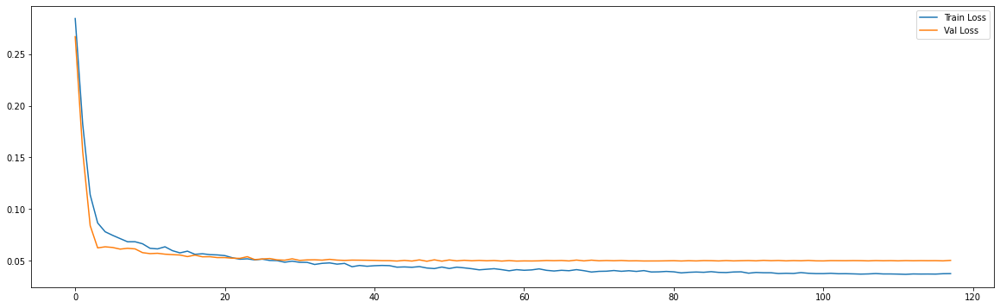

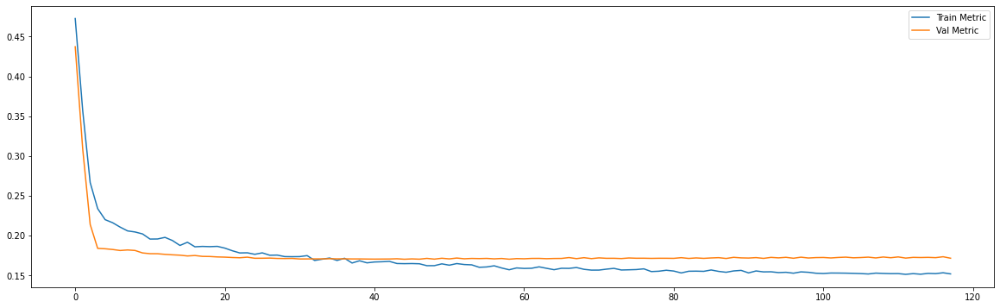

Epoch 00390: early stopping
============================model:14===========================
27/27 [==============================] - 0s 14ms/step - loss: 0.0368 - mae: 0.1543
loss and metric train data [0.036778777837753296, 0.15425755083560944]
3/3 [==============================] - 0s 9ms/step - loss: 0.0755 - mae: 0.2179
loss and metric val data [0.07548949867486954, 0.21790625154972076]
3/3 [==============================] - 0s 9ms/step - loss: 0.1544 - mae: 0.3072
loss and metric test data [0.1543927788734436, 0.30723726749420166]


'neurons': 20, 'dropout': 0.4, 'time_steps': 240, 'batch_size':240, 'learning_rate':0.001, 'hidden_layers':1




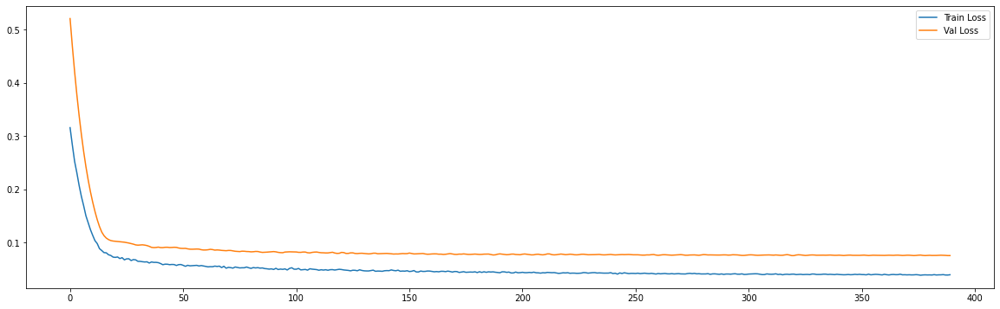

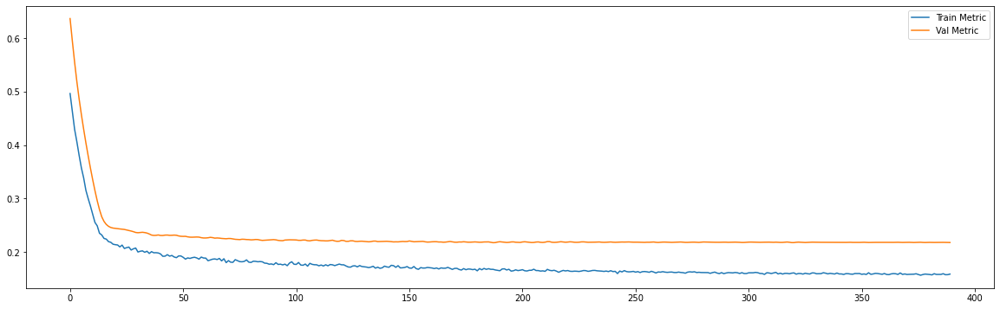

Epoch 00227: early stopping
============================model:15===========================
27/27 [==============================] - 1s 30ms/step - loss: 0.0371 - mae: 0.1549
loss and metric train data [0.037120696157217026, 0.15489348769187927]
3/3 [==============================] - 0s 21ms/step - loss: 0.0763 - mae: 0.2177
loss and metric val data [0.07632673531770706, 0.21769805252552032]
3/3 [==============================] - 0s 20ms/step - loss: 0.1603 - mae: 0.3125
loss and metric test data [0.16030676662921906, 0.3125237822532654]


'neurons': 20, 'dropout': 0.4, 'time_steps': 240, 'batch_size':240, 'hidden_layers':2




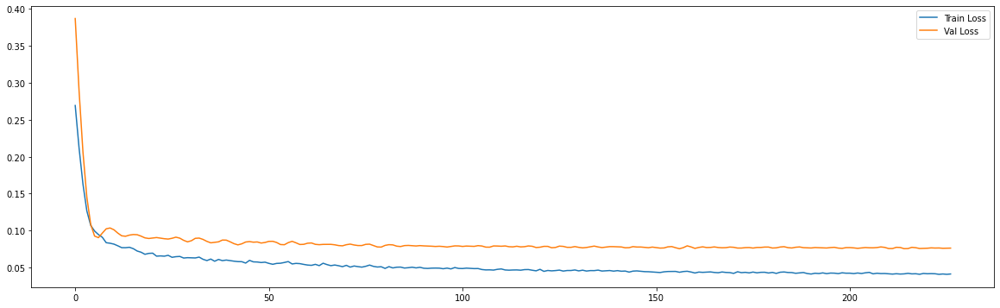

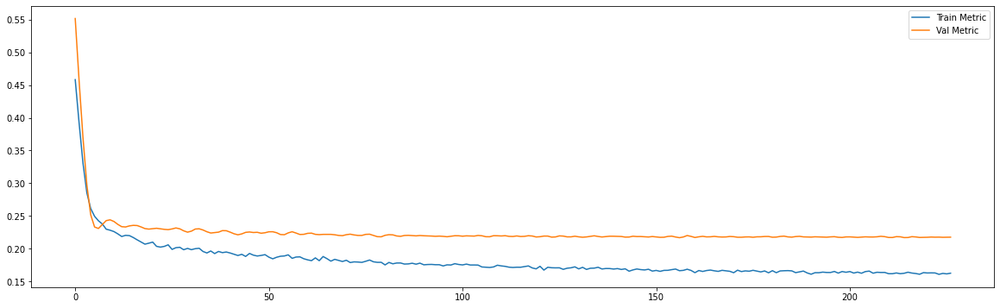

Epoch 00294: early stopping
============================model:16===========================
40/40 [==============================] - 0s 4ms/step - loss: 0.0335 - mae: 0.1461
loss and metric train data [0.033461954444646835, 0.1461002677679062]
9/9 [==============================] - 0s 4ms/step - loss: 0.0554 - mae: 0.1859
loss and metric val data [0.0553690567612648, 0.18591155111789703]
9/9 [==============================] - 0s 4ms/step - loss: 0.0701 - mae: 0.1911
loss and metric test data [0.07009348273277283, 0.19114071130752563]


'neurons': 25, 'dropout': 0.2, 'time_steps': 30, 'batch_size':30, 'learning_rate':0.001, 'hidden_layers':1




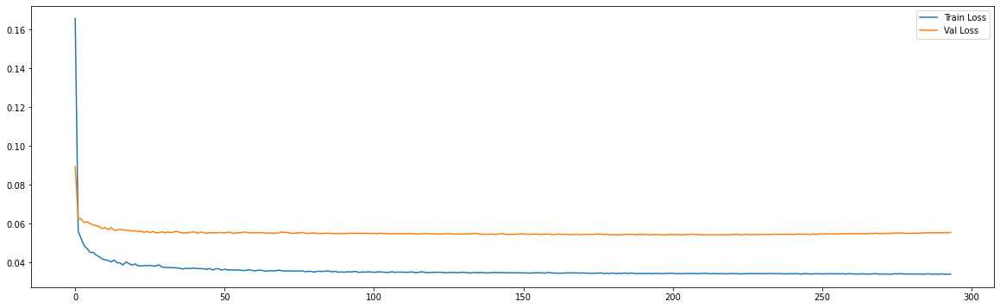

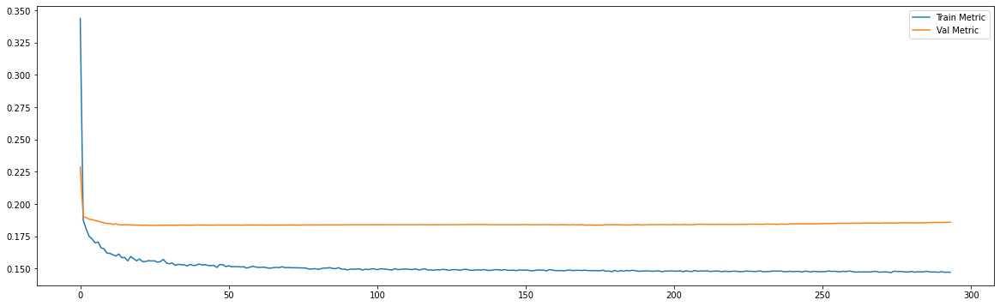

Epoch 00217: early stopping
============================model:17===========================
40/40 [==============================] - 0s 6ms/step - loss: 0.0331 - mae: 0.1448
loss and metric train data [0.03309181332588196, 0.14483948051929474]
9/9 [==============================] - 0s 5ms/step - loss: 0.0553 - mae: 0.1838
loss and metric val data [0.05534636229276657, 0.18377923965454102]
9/9 [==============================] - 0s 5ms/step - loss: 0.0722 - mae: 0.1904
loss and metric test data [0.07218467444181442, 0.1904231756925583]


'neurons': 25, 'dropout': 0.2, 'time_steps': 30, 'batch_size':30, 'hidden_layers':2




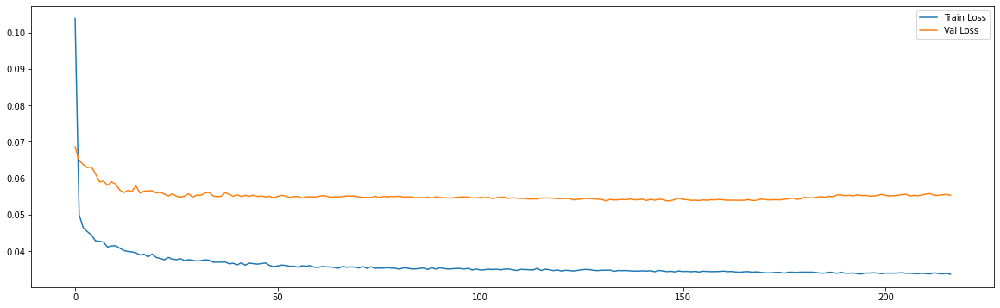

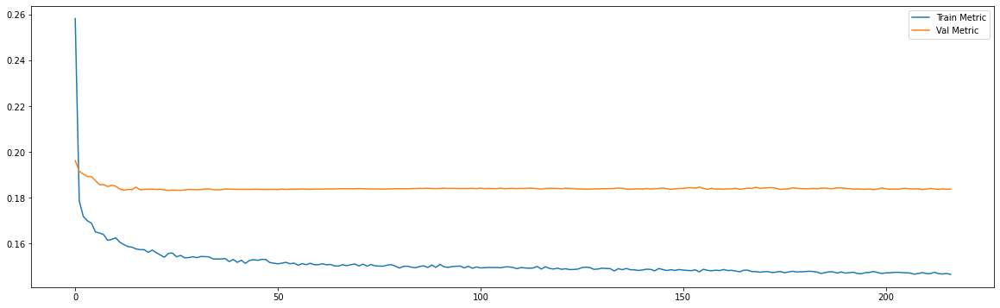

Epoch 00241: early stopping
============================model:18===========================
38/38 [==============================] - 0s 6ms/step - loss: 0.0330 - mae: 0.1448
loss and metric train data [0.03299020975828171, 0.14483997225761414]
8/8 [==============================] - 0s 4ms/step - loss: 0.0509 - mae: 0.1781
loss and metric val data [0.05089142173528671, 0.17806534469127655]
8/8 [==============================] - 0s 5ms/step - loss: 0.0699 - mae: 0.1964
loss and metric test data [0.0699073076248169, 0.19638723134994507]


'neurons': 25, 'dropout': 0.2, 'time_steps': 60, 'batch_size':60, 'learning_rate':0.001, 'hidden_layers':1




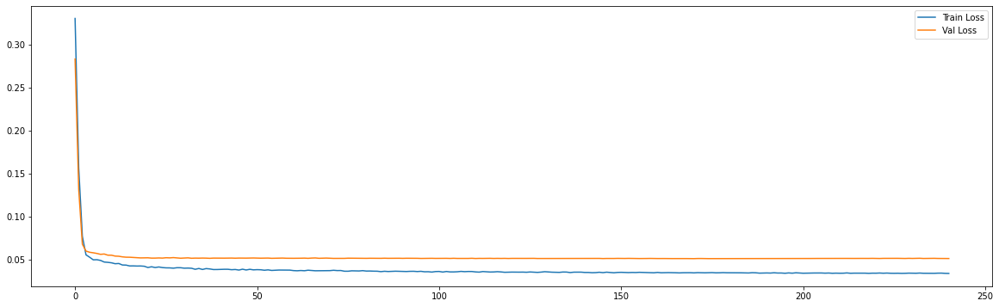

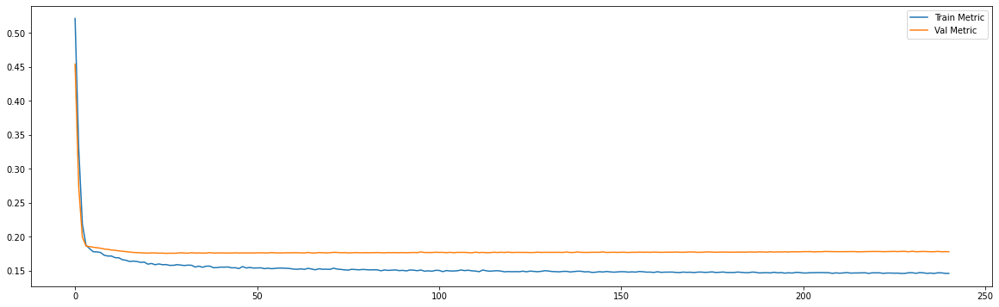

Epoch 00086: early stopping
============================model:19===========================
38/38 [==============================] - 0s 9ms/step - loss: 0.0337 - mae: 0.1469
loss and metric train data [0.03373121842741966, 0.14689384400844574]
8/8 [==============================] - 0s 8ms/step - loss: 0.0514 - mae: 0.1777
loss and metric val data [0.051429200917482376, 0.17772407829761505]
8/8 [==============================] - 0s 8ms/step - loss: 0.0725 - mae: 0.1994
loss and metric test data [0.07249009609222412, 0.19937683641910553]


'neurons': 25, 'dropout': 0.2, 'time_steps': 60, 'batch_size':60, 'hidden_layers':2




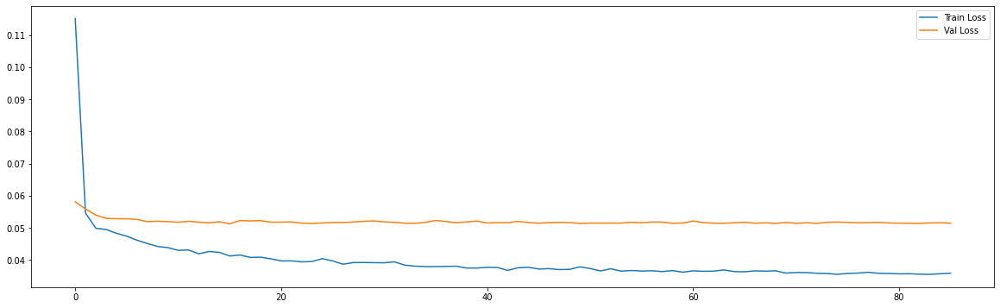

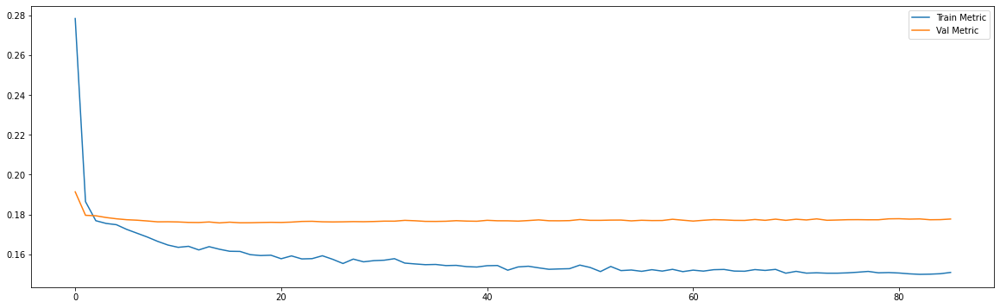

Epoch 00121: early stopping
============================model:20===========================
34/34 [==============================] - 0s 8ms/step - loss: 0.0333 - mae: 0.1453
loss and metric train data [0.03327958658337593, 0.14528261125087738]
7/7 [==============================] - 0s 7ms/step - loss: 0.0503 - mae: 0.1740
loss and metric val data [0.05030732601881027, 0.1739739179611206]
7/7 [==============================] - 0s 7ms/step - loss: 0.0892 - mae: 0.2263
loss and metric test data [0.08921031653881073, 0.22633658349514008]


'neurons': 25, 'dropout': 0.2, 'time_steps': 120, 'batch_size':120, 'learning_rate':0.001, 'hidden_layers':1




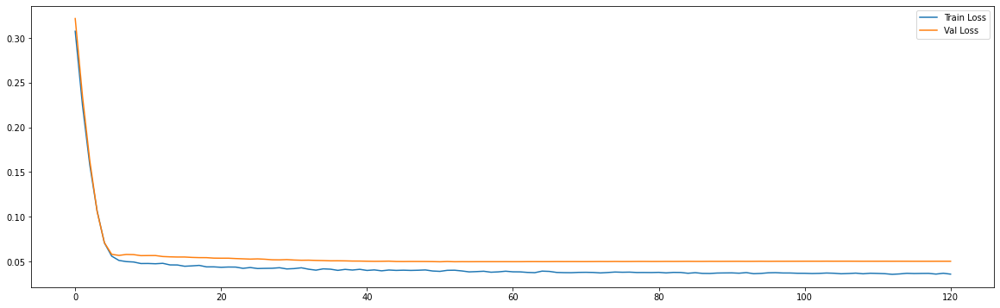

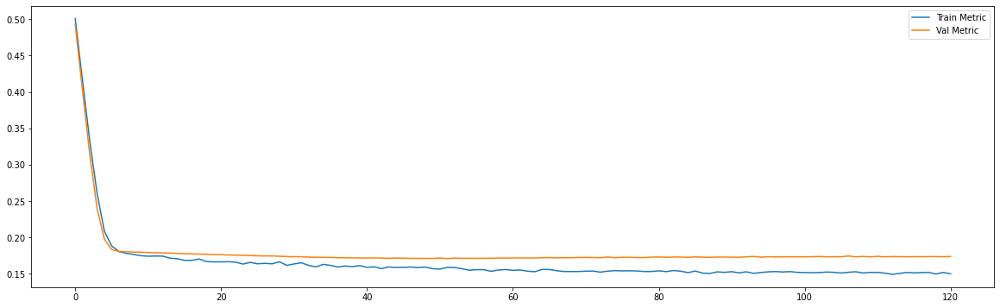

Epoch 00113: early stopping
============================model:21===========================
34/34 [==============================] - 1s 17ms/step - loss: 0.0333 - mae: 0.1451
loss and metric train data [0.03327404335141182, 0.14512591063976288]
7/7 [==============================] - 0s 16ms/step - loss: 0.0503 - mae: 0.1739
loss and metric val data [0.050275105983018875, 0.17393708229064941]
7/7 [==============================] - 0s 15ms/step - loss: 0.0892 - mae: 0.2262
loss and metric test data [0.089169442653656, 0.22621269524097443]


'neurons': 25, 'dropout': 0.2, 'time_steps': 120, 'batch_size':120, 'hidden_layers':2




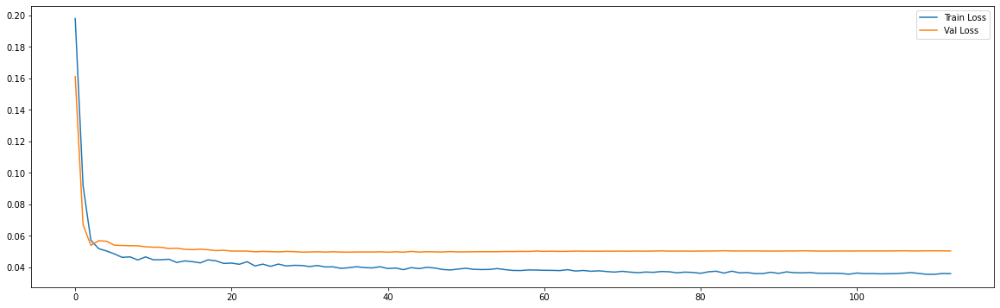

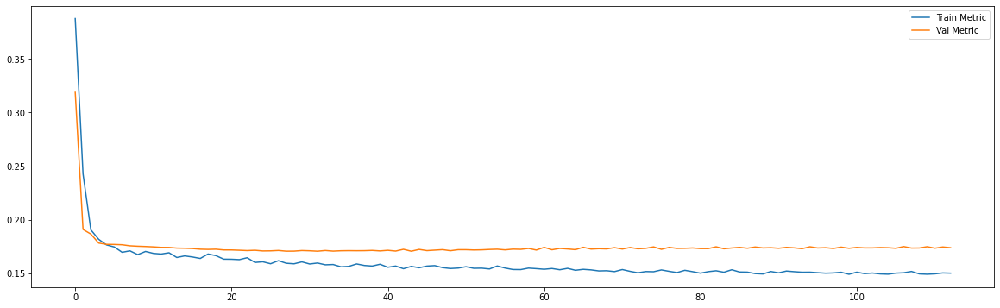

Epoch 00354: early stopping
============================model:22===========================
27/27 [==============================] - 0s 14ms/step - loss: 0.0369 - mae: 0.1544
loss and metric train data [0.03693562000989914, 0.15443755686283112]
3/3 [==============================] - 0s 10ms/step - loss: 0.0754 - mae: 0.2170
loss and metric val data [0.07539782673120499, 0.2170420140028]
3/3 [==============================] - 0s 10ms/step - loss: 0.1556 - mae: 0.3095
loss and metric test data [0.1555919051170349, 0.30947932600975037]


'neurons': 25, 'dropout': 0.2, 'time_steps': 240, 'batch_size':240, 'learning_rate':0.001, 'hidden_layers':1




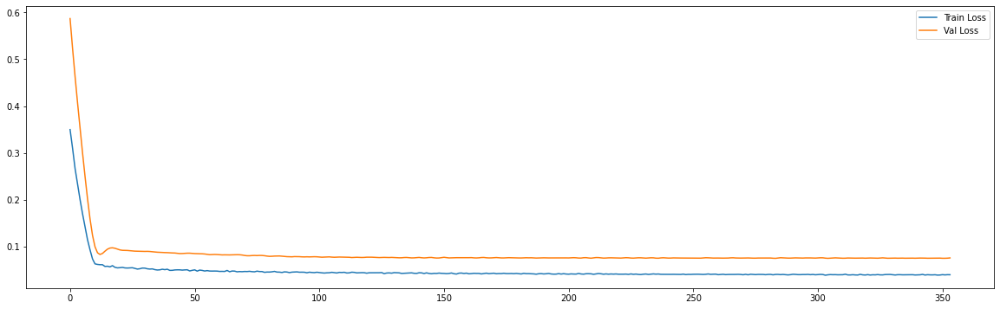

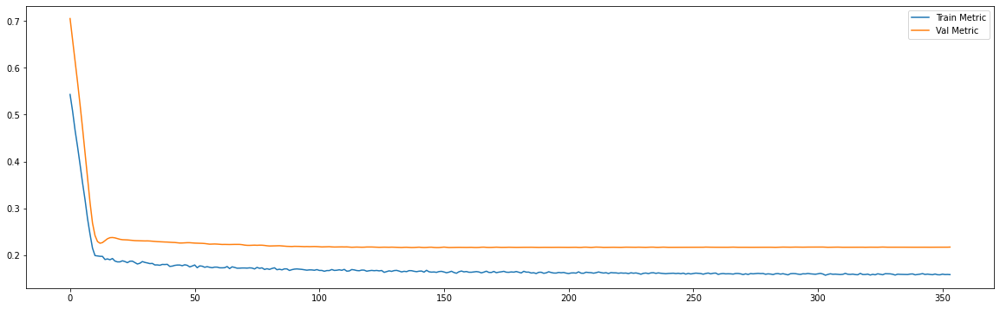

Epoch 00076: early stopping
============================model:23===========================
27/27 [==============================] - 1s 29ms/step - loss: 0.0371 - mae: 0.1549
loss and metric train data [0.03713396191596985, 0.15491290390491486]
3/3 [==============================] - 0s 21ms/step - loss: 0.0764 - mae: 0.2176
loss and metric val data [0.0763915479183197, 0.21755746006965637]
3/3 [==============================] - 0s 20ms/step - loss: 0.1615 - mae: 0.3132
loss and metric test data [0.1614857167005539, 0.31323981285095215]


'neurons': 25, 'dropout': 0.2, 'time_steps': 240, 'batch_size':240, 'hidden_layers':2




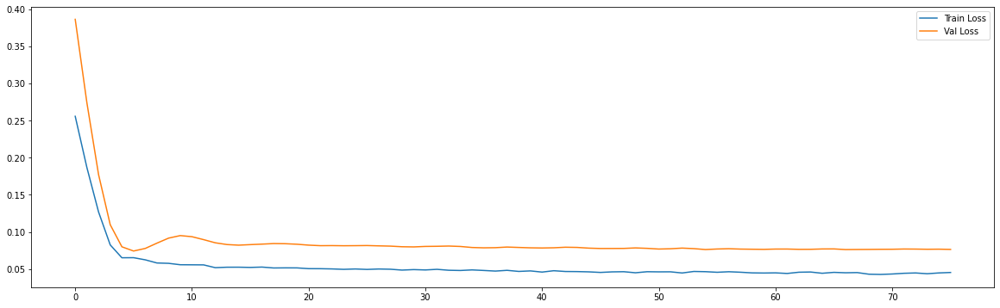

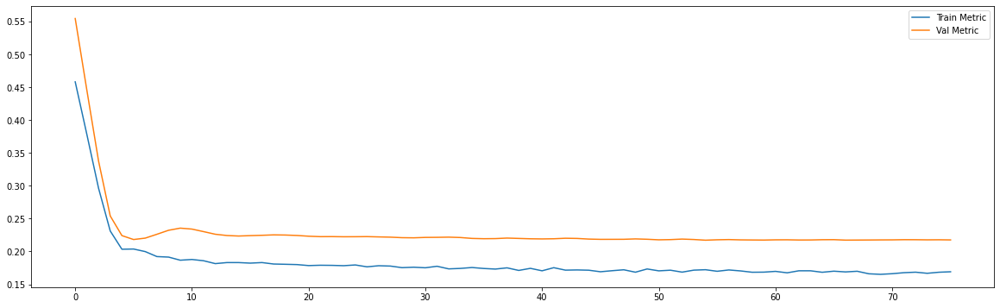

Epoch 00272: early stopping
============================model:24===========================
40/40 [==============================] - 0s 4ms/step - loss: 0.0336 - mae: 0.1460
loss and metric train data [0.03356590121984482, 0.14604701101779938]
9/9 [==============================] - 0s 4ms/step - loss: 0.0548 - mae: 0.1846
loss and metric val data [0.05478055402636528, 0.1846255213022232]
9/9 [==============================] - 0s 4ms/step - loss: 0.0700 - mae: 0.1906
loss and metric test data [0.07000957429409027, 0.19056515395641327]


'neurons': 25, 'dropout': 0.4, 'time_steps': 30, 'batch_size':30, 'learning_rate':0.001, 'hidden_layers':1




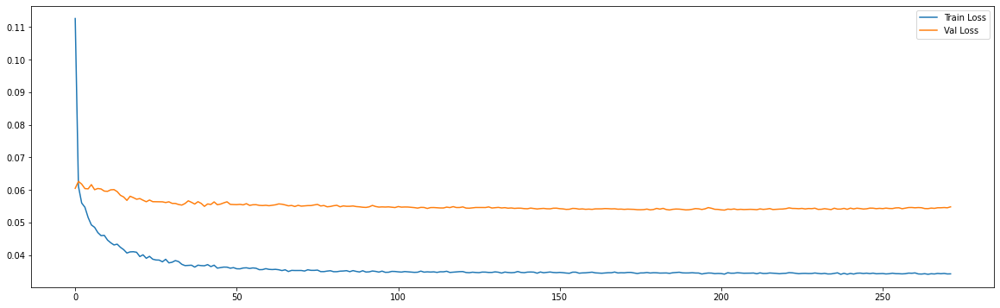

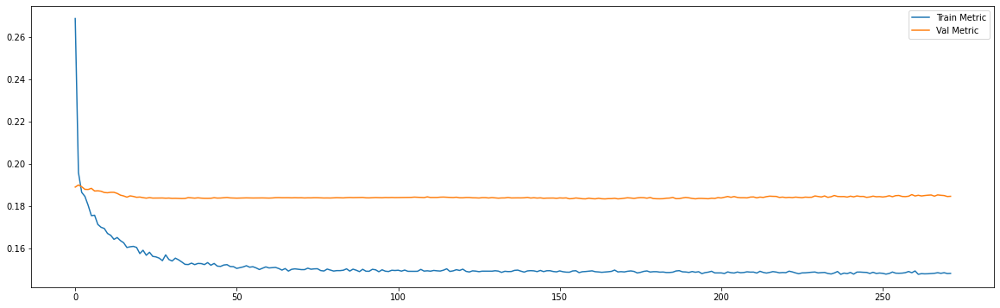

Epoch 00212: early stopping
============================model:25===========================
40/40 [==============================] - 0s 6ms/step - loss: 0.0335 - mae: 0.1460
loss and metric train data [0.03347880020737648, 0.14595665037631989]
9/9 [==============================] - 0s 6ms/step - loss: 0.0568 - mae: 0.1856
loss and metric val data [0.05684391036629677, 0.1855815351009369]
9/9 [==============================] - 0s 5ms/step - loss: 0.0734 - mae: 0.1935
loss and metric test data [0.0734085962176323, 0.1934959888458252]


'neurons': 25, 'dropout': 0.4, 'time_steps': 30, 'batch_size':30, 'hidden_layers':2




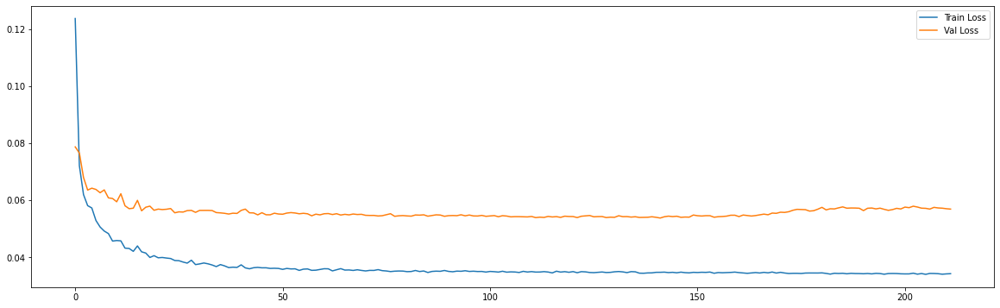

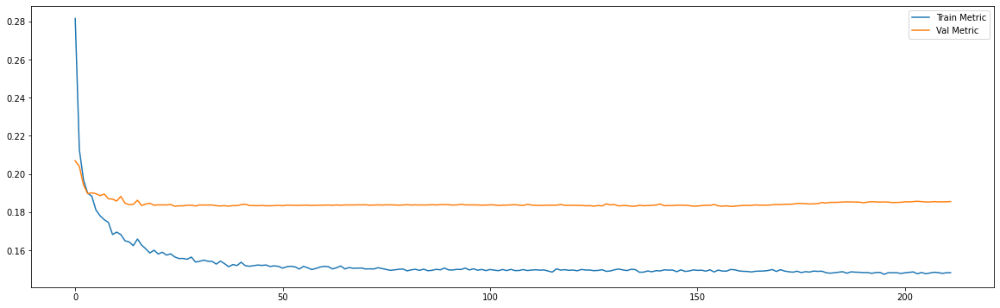

Epoch 00103: early stopping
============================model:26===========================
38/38 [==============================] - 0s 5ms/step - loss: 0.0338 - mae: 0.1471
loss and metric train data [0.033800218254327774, 0.14707022905349731]
8/8 [==============================] - 0s 5ms/step - loss: 0.0517 - mae: 0.1770
loss and metric val data [0.05169503018260002, 0.17701156437397003]
8/8 [==============================] - 0s 4ms/step - loss: 0.0732 - mae: 0.1997
loss and metric test data [0.0731818899512291, 0.19966702163219452]


'neurons': 25, 'dropout': 0.4, 'time_steps': 60, 'batch_size':60, 'learning_rate':0.001, 'hidden_layers':1




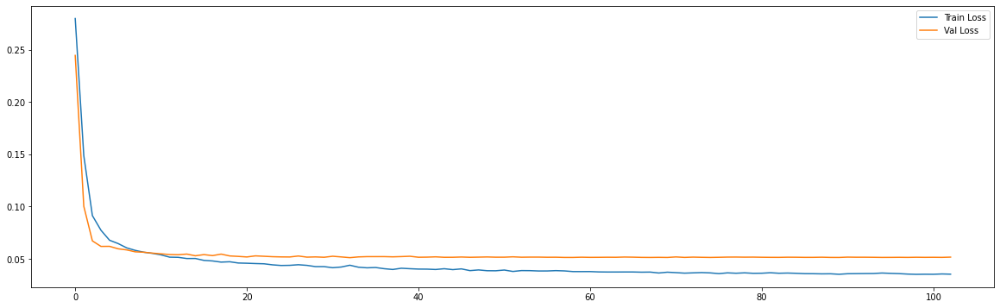

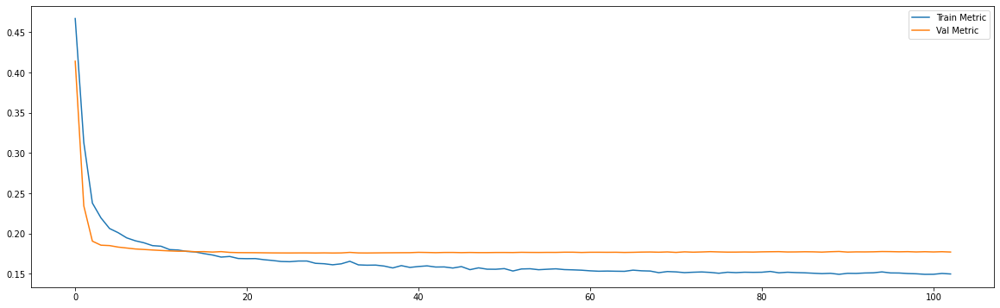

Epoch 00232: early stopping
============================model:27===========================
38/38 [==============================] - 0s 10ms/step - loss: 0.0332 - mae: 0.1455
loss and metric train data [0.03317231312394142, 0.14548639953136444]
8/8 [==============================] - 0s 9ms/step - loss: 0.0512 - mae: 0.1789
loss and metric val data [0.05119481682777405, 0.1788521558046341]
8/8 [==============================] - 0s 8ms/step - loss: 0.0710 - mae: 0.1961
loss and metric test data [0.0710146352648735, 0.1961231529712677]


'neurons': 25, 'dropout': 0.4, 'time_steps': 60, 'batch_size':60, 'hidden_layers':2




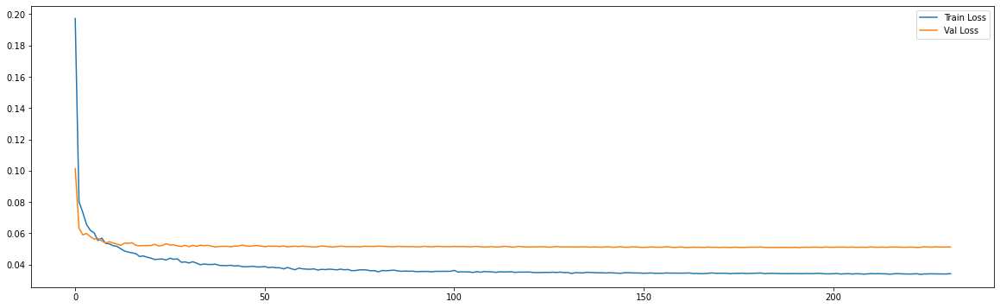

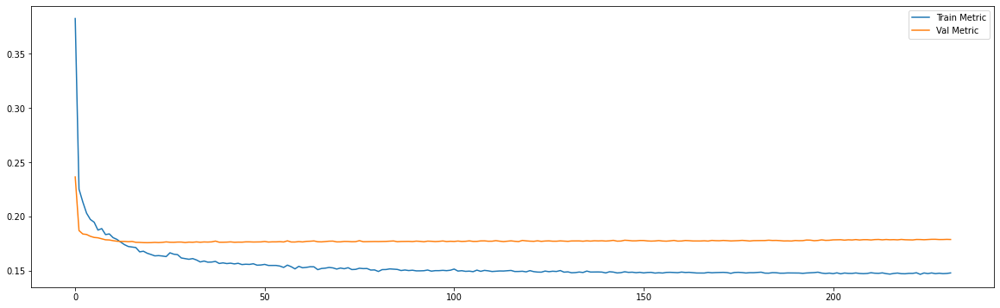

Epoch 00162: early stopping
============================model:28===========================
34/34 [==============================] - 0s 8ms/step - loss: 0.0333 - mae: 0.1453
loss and metric train data [0.033283084630966187, 0.14525507390499115]
7/7 [==============================] - 0s 7ms/step - loss: 0.0502 - mae: 0.1736
loss and metric val data [0.050228945910930634, 0.17355525493621826]
7/7 [==============================] - 0s 7ms/step - loss: 0.0890 - mae: 0.2260
loss and metric test data [0.0889560803771019, 0.22597336769104004]


'neurons': 25, 'dropout': 0.4, 'time_steps': 120, 'batch_size':120, 'learning_rate':0.001, 'hidden_layers':1




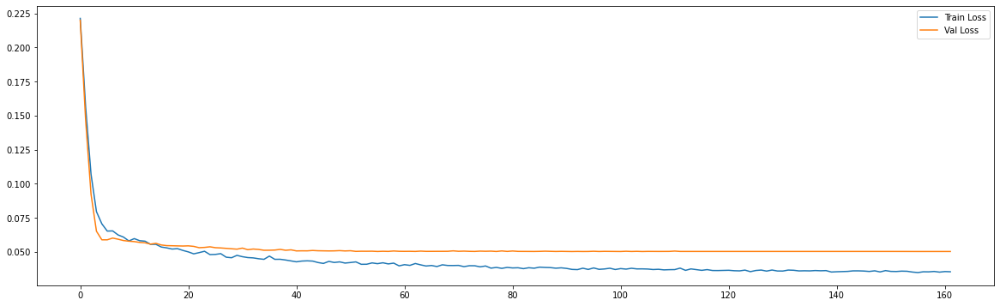

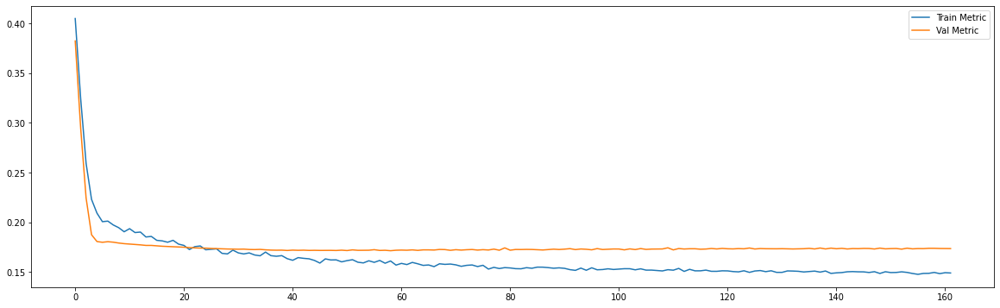

Epoch 00100: early stopping
============================model:29===========================
34/34 [==============================] - 1s 16ms/step - loss: 0.0339 - mae: 0.1458
loss and metric train data [0.033931978046894073, 0.1457655429840088]
7/7 [==============================] - 0s 15ms/step - loss: 0.0505 - mae: 0.1715
loss and metric val data [0.05054691433906555, 0.17149733006954193]
7/7 [==============================] - 0s 14ms/step - loss: 0.0898 - mae: 0.2256
loss and metric test data [0.08979100733995438, 0.2255704402923584]


'neurons': 25, 'dropout': 0.4, 'time_steps': 120, 'batch_size':120, 'hidden_layers':2




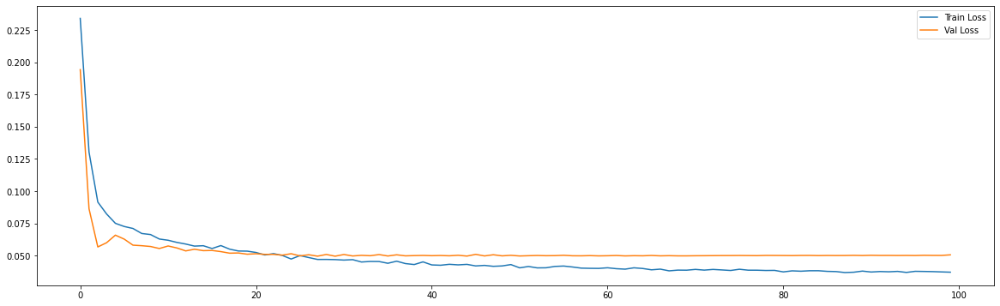

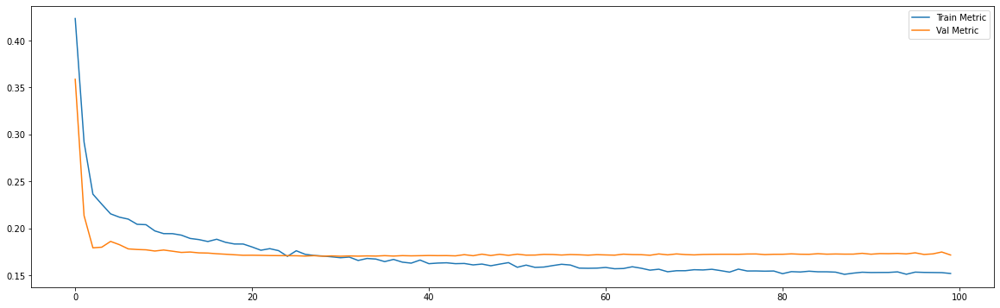

Epoch 00291: early stopping
============================model:30===========================
27/27 [==============================] - 0s 15ms/step - loss: 0.0372 - mae: 0.1550
loss and metric train data [0.03716711327433586, 0.15496748685836792]
3/3 [==============================] - 0s 11ms/step - loss: 0.0765 - mae: 0.2180
loss and metric val data [0.07653779536485672, 0.21799586713314056]
3/3 [==============================] - 0s 10ms/step - loss: 0.1585 - mae: 0.3111
loss and metric test data [0.15854066610336304, 0.31109848618507385]


'neurons': 25, 'dropout': 0.4, 'time_steps': 240, 'batch_size':240, 'learning_rate':0.001, 'hidden_layers':1




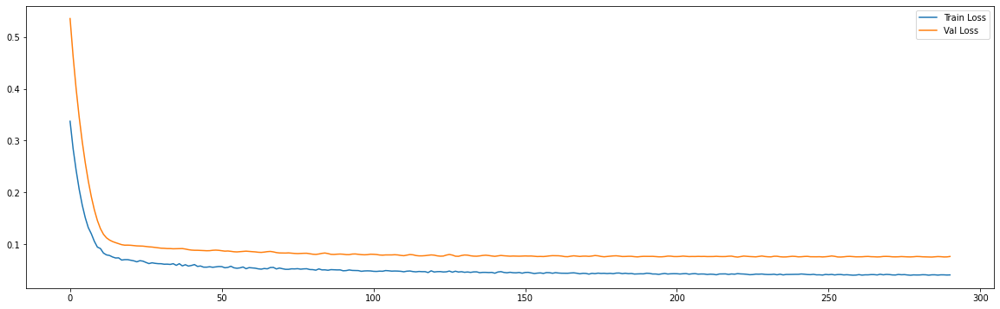

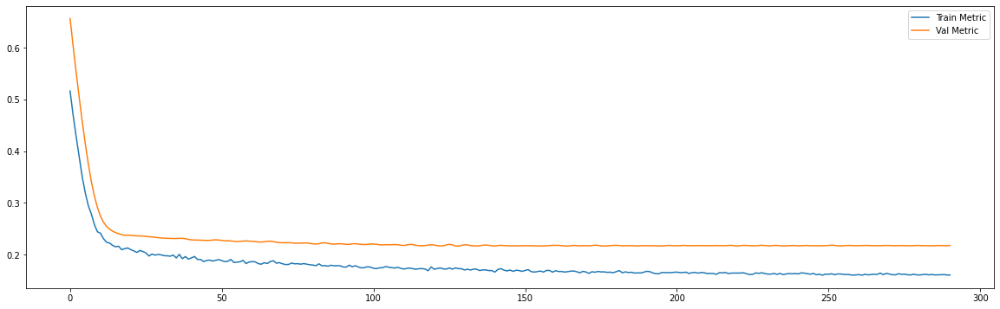

Epoch 00202: early stopping
============================model:31===========================
27/27 [==============================] - 1s 29ms/step - loss: 0.0371 - mae: 0.1549
loss and metric train data [0.037128884345293045, 0.1549394726753235]
3/3 [==============================] - 0s 21ms/step - loss: 0.0764 - mae: 0.2177
loss and metric val data [0.07635540515184402, 0.2176545113325119]
3/3 [==============================] - 0s 20ms/step - loss: 0.1610 - mae: 0.3137
loss and metric test data [0.16101665794849396, 0.3137446343898773]


'neurons': 25, 'dropout': 0.4, 'time_steps': 240, 'batch_size':240, 'hidden_layers':2




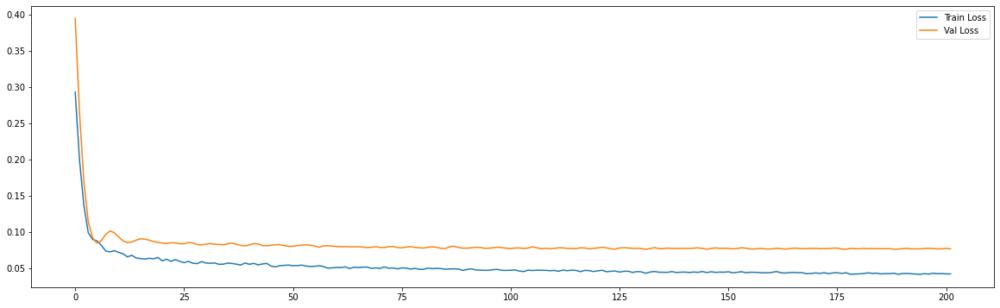

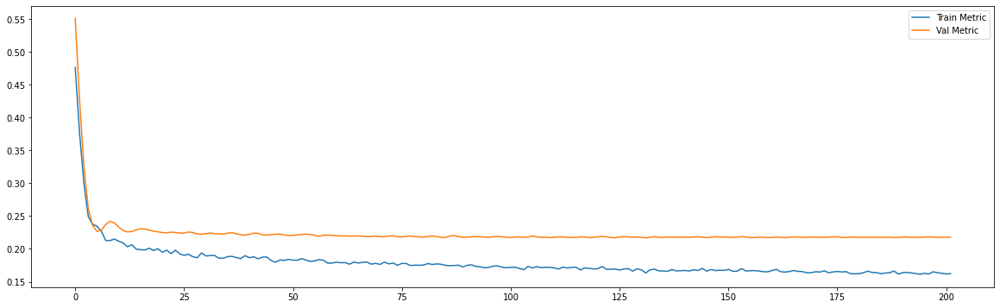

Epoch 00199: early stopping
============================model:32===========================
40/40 [==============================] - 0s 4ms/step - loss: 0.0336 - mae: 0.1465
loss and metric train data [0.03363307937979698, 0.1465291678905487]
9/9 [==============================] - 0s 4ms/step - loss: 0.0543 - mae: 0.1843
loss and metric val data [0.05434359982609749, 0.18428881466388702]
9/9 [==============================] - 0s 4ms/step - loss: 0.0681 - mae: 0.1898
loss and metric test data [0.06811560690402985, 0.18975211679935455]


'neurons': 30, 'dropout': 0.2, 'time_steps': 30, 'batch_size':30, 'learning_rate':0.001, 'hidden_layers':1




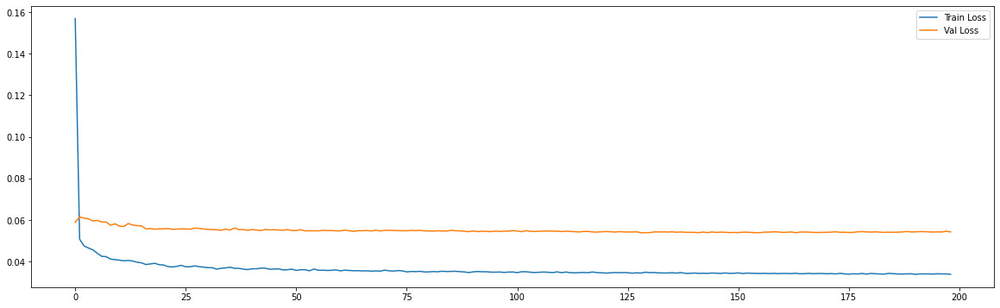

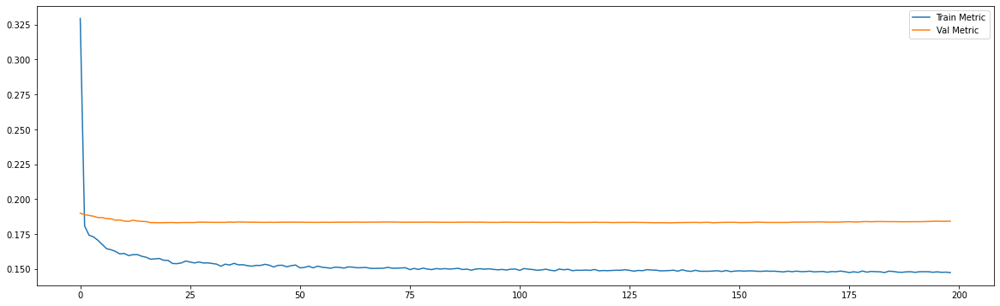

Epoch 00172: early stopping
============================model:33===========================
40/40 [==============================] - 0s 6ms/step - loss: 0.0335 - mae: 0.1460
loss and metric train data [0.03348374739289284, 0.14602185785770416]
9/9 [==============================] - 0s 5ms/step - loss: 0.0556 - mae: 0.1840
loss and metric val data [0.05560699477791786, 0.18397440016269684]
9/9 [==============================] - 0s 5ms/step - loss: 0.0701 - mae: 0.1898
loss and metric test data [0.0700780525803566, 0.1898108869791031]


'neurons': 30, 'dropout': 0.2, 'time_steps': 30, 'batch_size':30, 'hidden_layers':2




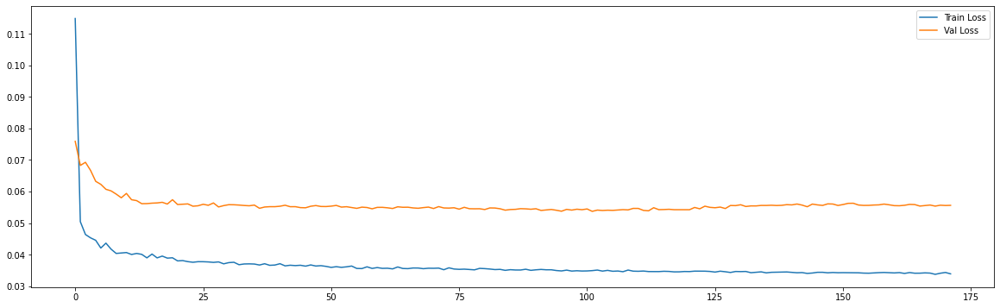

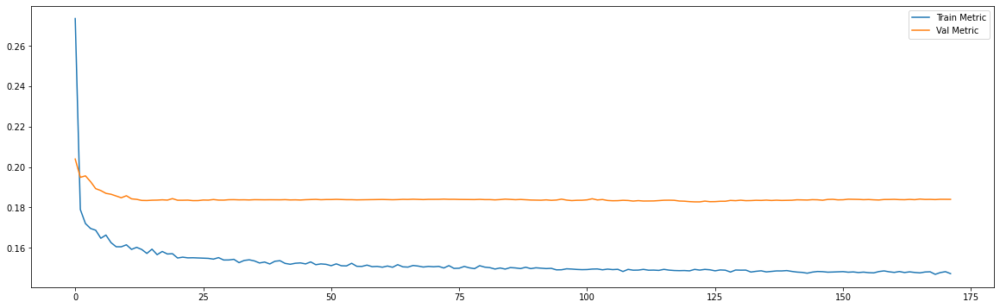

Epoch 00094: early stopping
============================model:34===========================
38/38 [==============================] - 0s 6ms/step - loss: 0.0337 - mae: 0.1467
loss and metric train data [0.03368426486849785, 0.14674194157123566]
8/8 [==============================] - 0s 5ms/step - loss: 0.0513 - mae: 0.1771
loss and metric val data [0.0512876883149147, 0.17712979018688202]
8/8 [==============================] - 0s 5ms/step - loss: 0.0720 - mae: 0.1994
loss and metric test data [0.07202519476413727, 0.19942401349544525]


'neurons': 30, 'dropout': 0.2, 'time_steps': 60, 'batch_size':60, 'learning_rate':0.001, 'hidden_layers':1




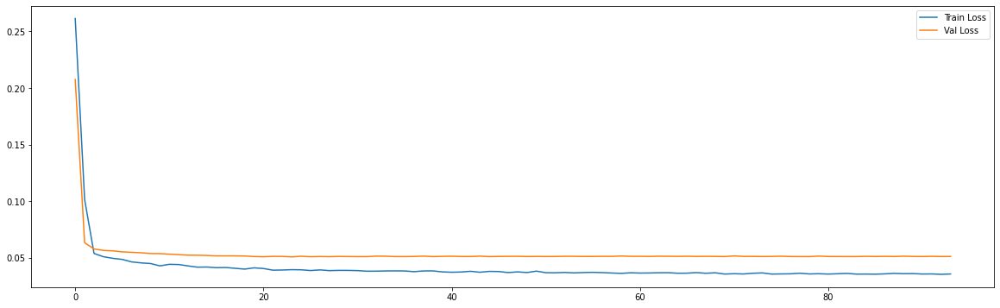

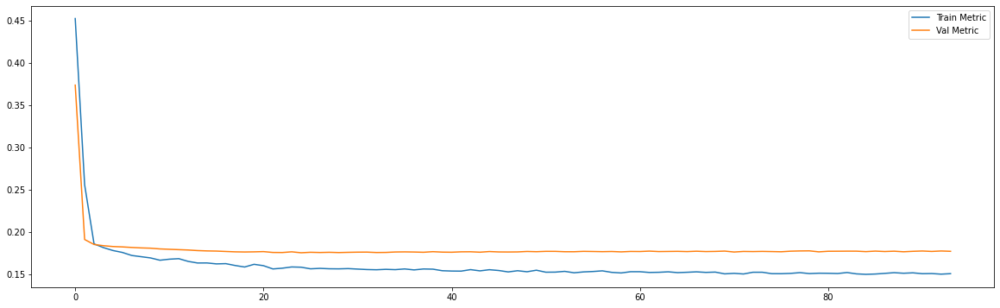

Epoch 00081: early stopping
============================model:35===========================
38/38 [==============================] - 0s 10ms/step - loss: 0.0337 - mae: 0.1467
loss and metric train data [0.03371664881706238, 0.14673852920532227]
8/8 [==============================] - 0s 9ms/step - loss: 0.0515 - mae: 0.1772
loss and metric val data [0.0514773353934288, 0.1771538406610489]
8/8 [==============================] - 0s 8ms/step - loss: 0.0727 - mae: 0.1993
loss and metric test data [0.07267162203788757, 0.19931063055992126]


'neurons': 30, 'dropout': 0.2, 'time_steps': 60, 'batch_size':60, 'hidden_layers':2




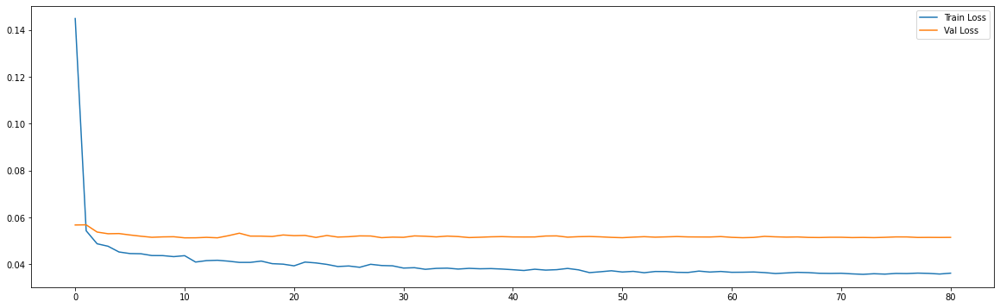

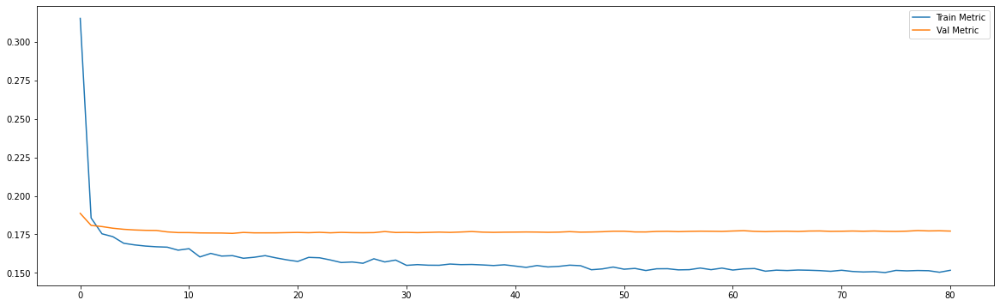

Epoch 00113: early stopping
============================model:36===========================
34/34 [==============================] - 0s 8ms/step - loss: 0.0332 - mae: 0.1451
loss and metric train data [0.033241912722587585, 0.14508794248104095]
7/7 [==============================] - 0s 8ms/step - loss: 0.0503 - mae: 0.1738
loss and metric val data [0.05034984275698662, 0.17384524643421173]
7/7 [==============================] - 0s 7ms/step - loss: 0.0890 - mae: 0.2265
loss and metric test data [0.08903593569993973, 0.22653406858444214]


'neurons': 30, 'dropout': 0.2, 'time_steps': 120, 'batch_size':120, 'learning_rate':0.001, 'hidden_layers':1




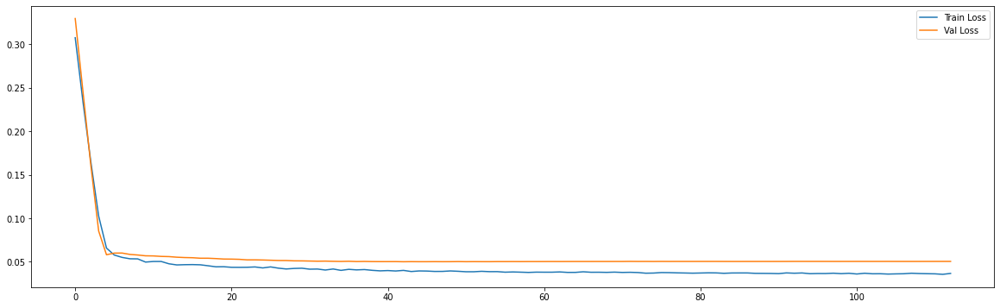

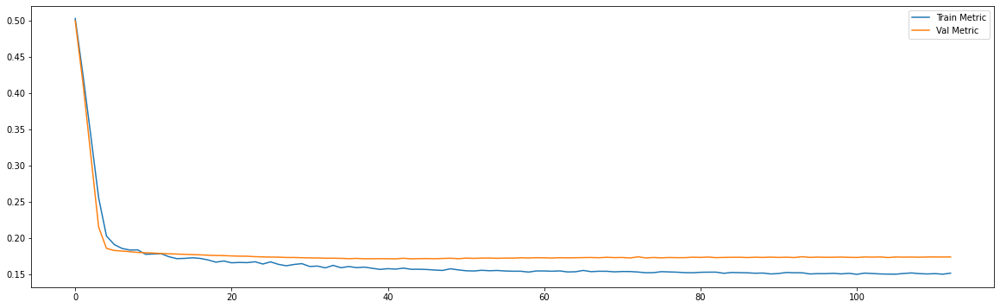

Epoch 00094: early stopping
============================model:37===========================
34/34 [==============================] - 1s 16ms/step - loss: 0.0336 - mae: 0.1454
loss and metric train data [0.033643338829278946, 0.14543414115905762]
7/7 [==============================] - 0s 14ms/step - loss: 0.0505 - mae: 0.1724
loss and metric val data [0.050480686128139496, 0.1724221557378769]
7/7 [==============================] - 0s 13ms/step - loss: 0.0900 - mae: 0.2260
loss and metric test data [0.08997613191604614, 0.2259962111711502]


'neurons': 30, 'dropout': 0.2, 'time_steps': 120, 'batch_size':120, 'hidden_layers':2




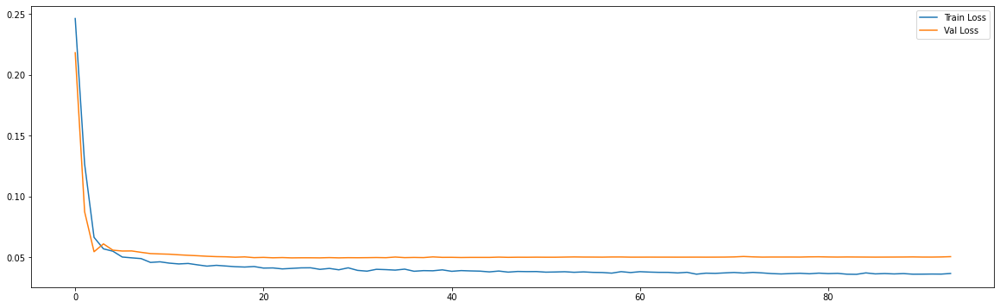

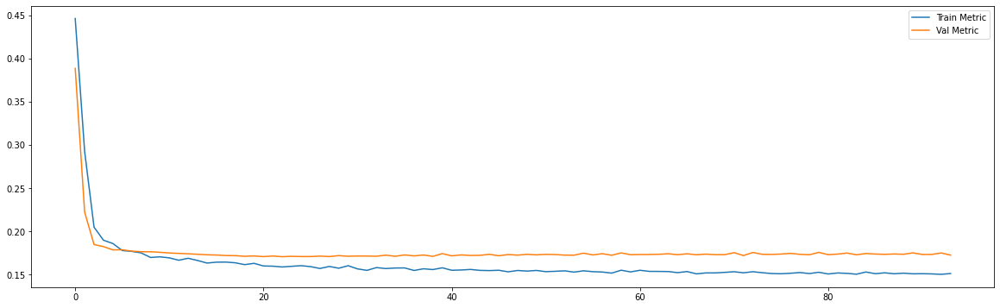

Epoch 00303: early stopping
============================model:38===========================
27/27 [==============================] - 0s 15ms/step - loss: 0.0368 - mae: 0.1544
loss and metric train data [0.03684666380286217, 0.15435951948165894]
3/3 [==============================] - 0s 12ms/step - loss: 0.0750 - mae: 0.2176
loss and metric val data [0.0750291496515274, 0.2175704538822174]
3/3 [==============================] - 0s 10ms/step - loss: 0.1548 - mae: 0.3086
loss and metric test data [0.15475553274154663, 0.30859291553497314]


'neurons': 30, 'dropout': 0.2, 'time_steps': 240, 'batch_size':240, 'learning_rate':0.001, 'hidden_layers':1




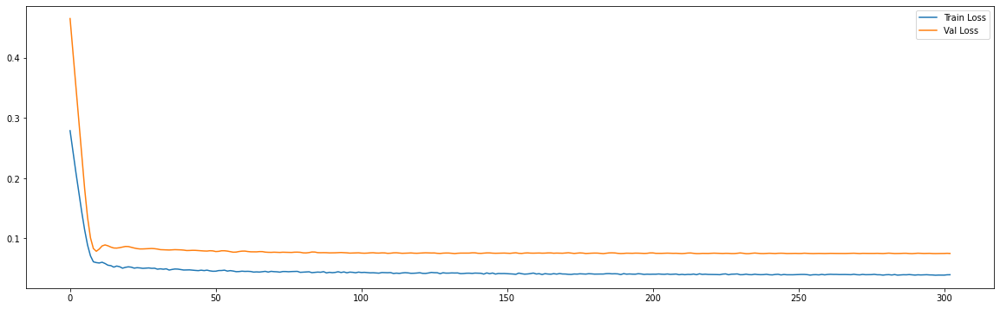

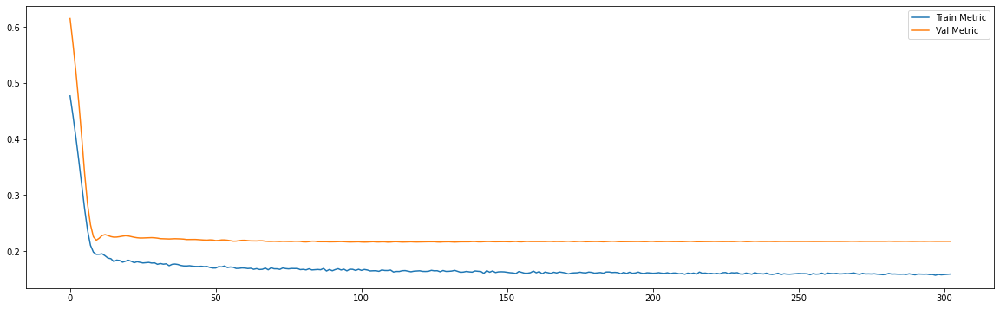

Epoch 00194: early stopping
============================model:39===========================
27/27 [==============================] - 1s 30ms/step - loss: 0.0368 - mae: 0.1543
loss and metric train data [0.03683847188949585, 0.15430280566215515]
3/3 [==============================] - 0s 21ms/step - loss: 0.0752 - mae: 0.2182
loss and metric val data [0.07523142546415329, 0.2182062566280365]
3/3 [==============================] - 0s 20ms/step - loss: 0.1567 - mae: 0.3093
loss and metric test data [0.15669825673103333, 0.309283584356308]


'neurons': 30, 'dropout': 0.2, 'time_steps': 240, 'batch_size':240, 'hidden_layers':2




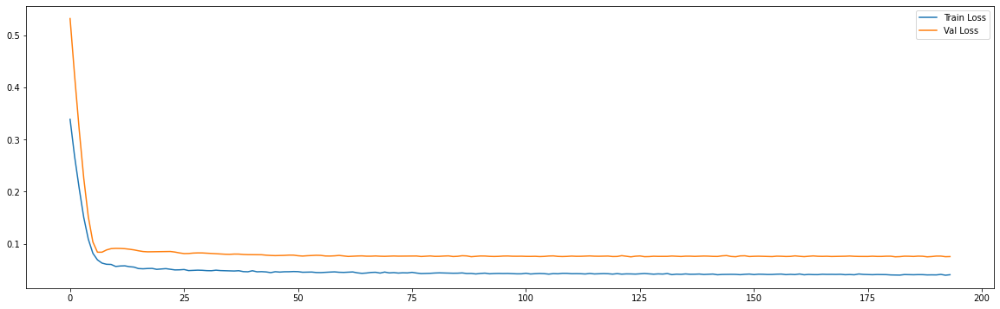

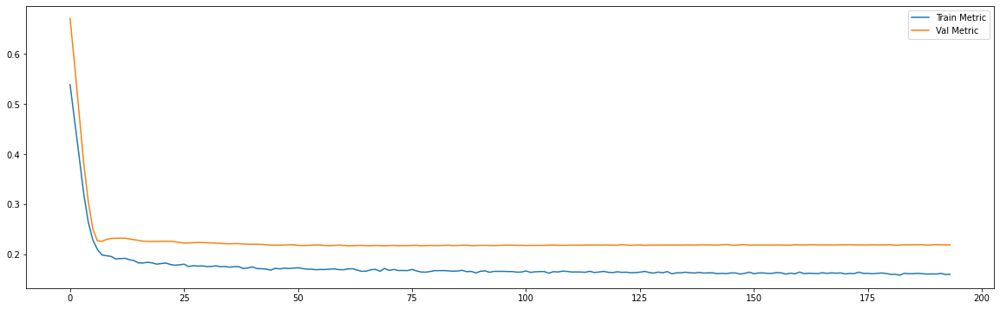

Epoch 00257: early stopping
============================model:40===========================
40/40 [==============================] - 0s 4ms/step - loss: 0.0335 - mae: 0.1462
loss and metric train data [0.033515822142362595, 0.14624017477035522]
9/9 [==============================] - 0s 4ms/step - loss: 0.0549 - mae: 0.1845
loss and metric val data [0.054930850863456726, 0.18454745411872864]
9/9 [==============================] - 0s 4ms/step - loss: 0.0694 - mae: 0.1900
loss and metric test data [0.06936363875865936, 0.18998540937900543]


'neurons': 30, 'dropout': 0.4, 'time_steps': 30, 'batch_size':30, 'learning_rate':0.001, 'hidden_layers':1




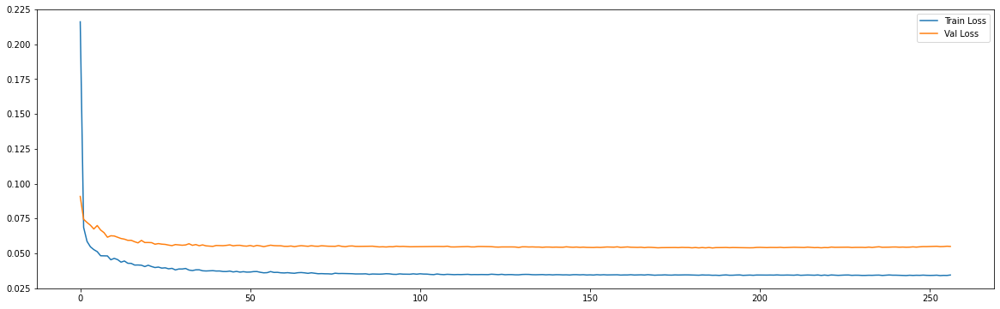

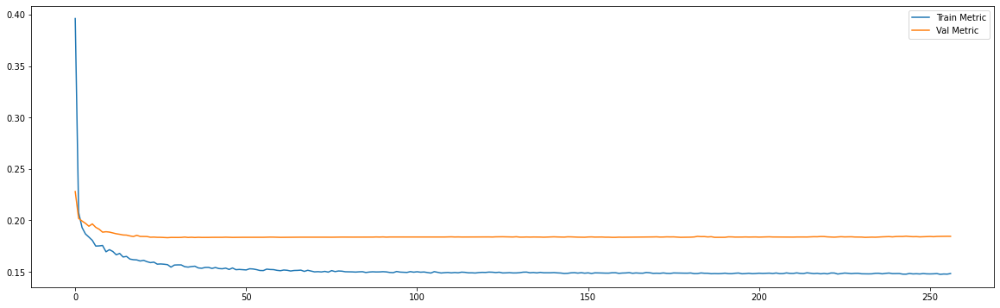

Epoch 00191: early stopping
============================model:41===========================
40/40 [==============================] - 0s 6ms/step - loss: 0.0333 - mae: 0.1454
loss and metric train data [0.033261481672525406, 0.1453801691532135]
9/9 [==============================] - 0s 6ms/step - loss: 0.0552 - mae: 0.1845
loss and metric val data [0.05517220124602318, 0.18449151515960693]
9/9 [==============================] - 0s 5ms/step - loss: 0.0710 - mae: 0.1907
loss and metric test data [0.07103671133518219, 0.19073058664798737]


'neurons': 30, 'dropout': 0.4, 'time_steps': 30, 'batch_size':30, 'hidden_layers':2




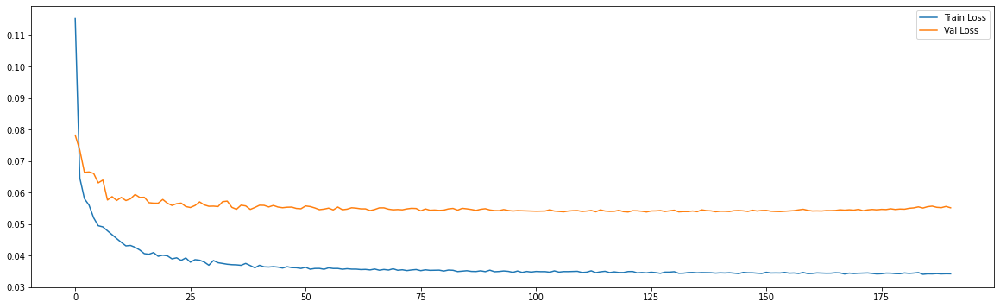

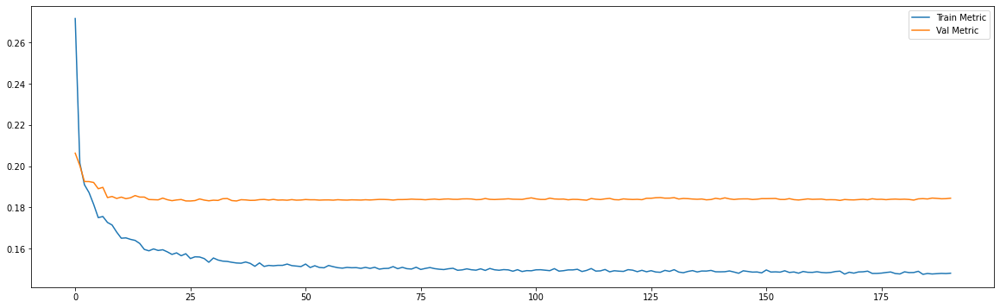

Epoch 00131: early stopping
============================model:42===========================
38/38 [==============================] - 0s 6ms/step - loss: 0.0337 - mae: 0.1469
loss and metric train data [0.033701833337545395, 0.1468563973903656]
8/8 [==============================] - 0s 5ms/step - loss: 0.0516 - mae: 0.1779
loss and metric val data [0.0515616349875927, 0.17787015438079834]
8/8 [==============================] - 0s 5ms/step - loss: 0.0728 - mae: 0.1997
loss and metric test data [0.07284125685691833, 0.19971269369125366]


'neurons': 30, 'dropout': 0.4, 'time_steps': 60, 'batch_size':60, 'learning_rate':0.001, 'hidden_layers':1




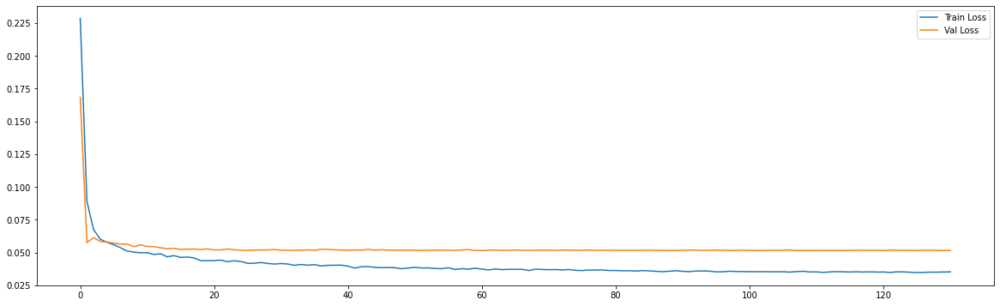

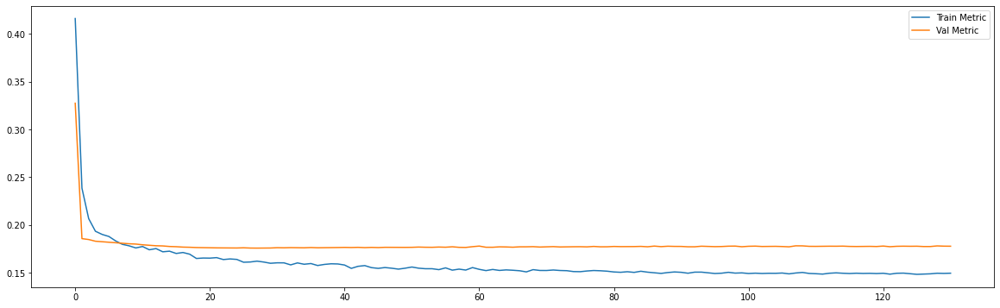

Epoch 00230: early stopping
============================model:43===========================
38/38 [==============================] - 0s 9ms/step - loss: 0.0332 - mae: 0.1458
loss and metric train data [0.033170443028211594, 0.14575320482254028]
8/8 [==============================] - 0s 8ms/step - loss: 0.0514 - mae: 0.1788
loss and metric val data [0.051385387778282166, 0.17878513038158417]
8/8 [==============================] - 0s 8ms/step - loss: 0.0713 - mae: 0.1963
loss and metric test data [0.07132019102573395, 0.1962594836950302]


'neurons': 30, 'dropout': 0.4, 'time_steps': 60, 'batch_size':60, 'hidden_layers':2




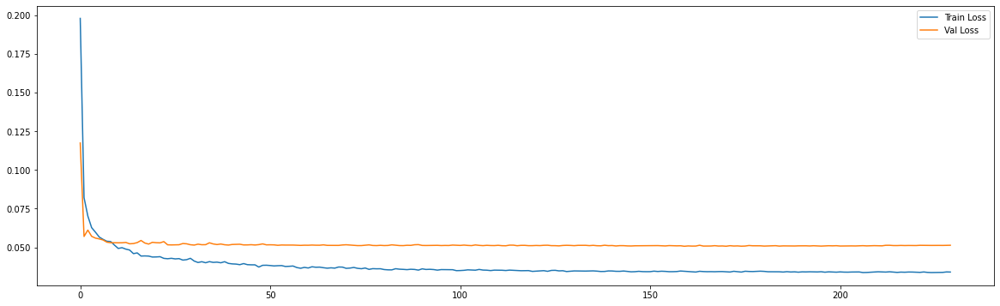

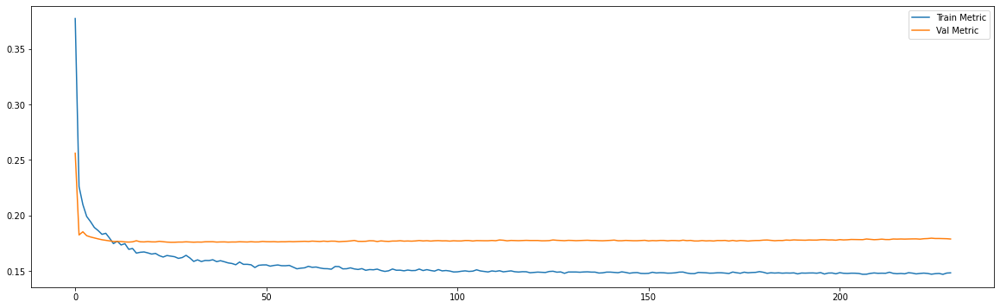

Epoch 00137: early stopping
============================model:44===========================
34/34 [==============================] - 0s 8ms/step - loss: 0.0333 - mae: 0.1454
loss and metric train data [0.033262114971876144, 0.14541204273700714]
7/7 [==============================] - 0s 8ms/step - loss: 0.0503 - mae: 0.1742
loss and metric val data [0.05028393864631653, 0.17422932386398315]
7/7 [==============================] - 0s 7ms/step - loss: 0.0887 - mae: 0.2258
loss and metric test data [0.08867111802101135, 0.22576546669006348]


'neurons': 30, 'dropout': 0.4, 'time_steps': 120, 'batch_size':120, 'learning_rate':0.001, 'hidden_layers':1




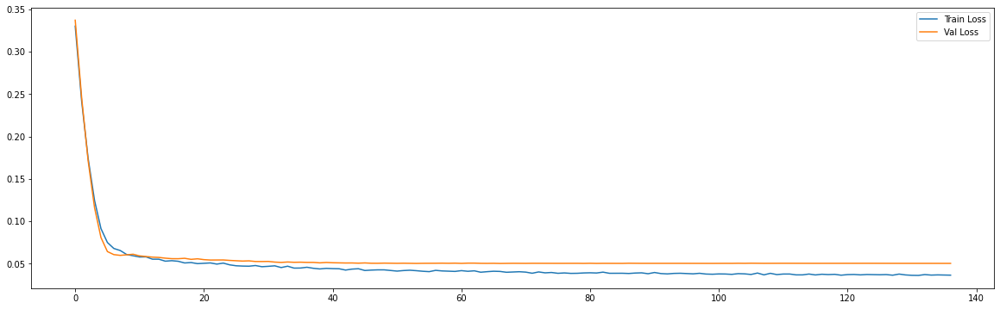

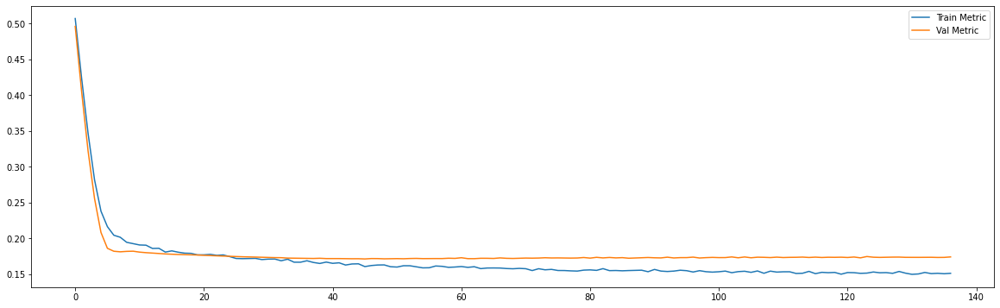

Epoch 00117: early stopping
============================model:45===========================
34/34 [==============================] - 1s 16ms/step - loss: 0.0334 - mae: 0.1454
loss and metric train data [0.033385202288627625, 0.1453966200351715]
7/7 [==============================] - 0s 14ms/step - loss: 0.0502 - mae: 0.1727
loss and metric val data [0.05022185668349266, 0.1727387011051178]
7/7 [==============================] - 0s 14ms/step - loss: 0.0890 - mae: 0.2252
loss and metric test data [0.08903931826353073, 0.22521960735321045]


'neurons': 30, 'dropout': 0.4, 'time_steps': 120, 'batch_size':120, 'hidden_layers':2




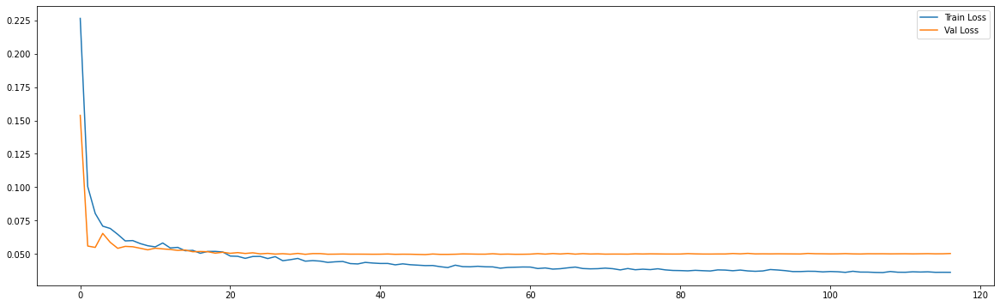

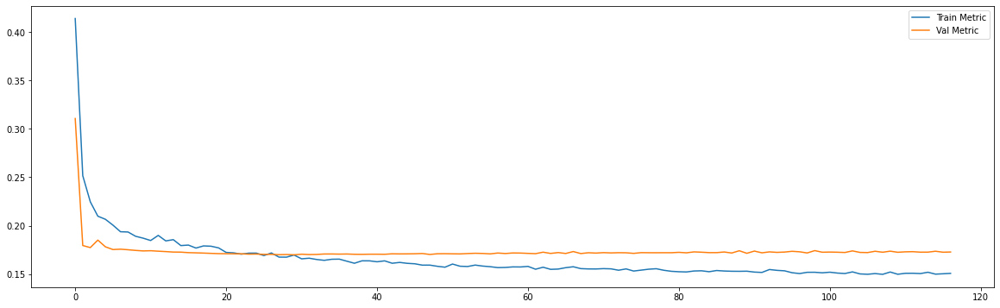

Epoch 00322: early stopping
============================model:46===========================
27/27 [==============================] - 0s 14ms/step - loss: 0.0368 - mae: 0.1543
loss and metric train data [0.036815617233514786, 0.15426161885261536]
3/3 [==============================] - 0s 10ms/step - loss: 0.0751 - mae: 0.2169
loss and metric val data [0.07514478266239166, 0.2168513387441635]
3/3 [==============================] - 0s 11ms/step - loss: 0.1552 - mae: 0.3089
loss and metric test data [0.15519270300865173, 0.30891725420951843]


'neurons': 30, 'dropout': 0.4, 'time_steps': 240, 'batch_size':240, 'learning_rate':0.001, 'hidden_layers':1




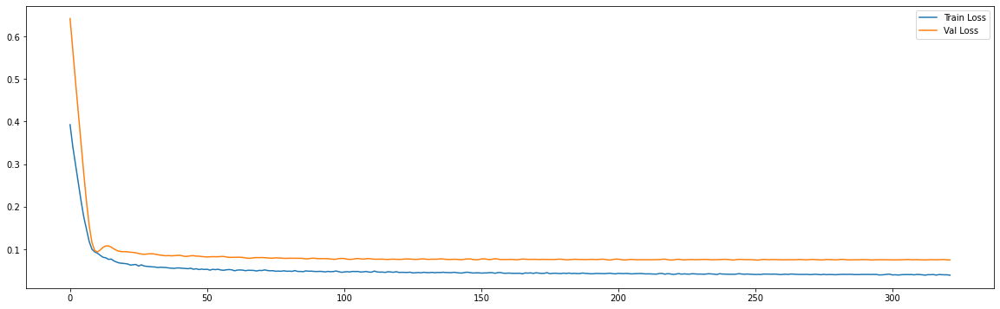

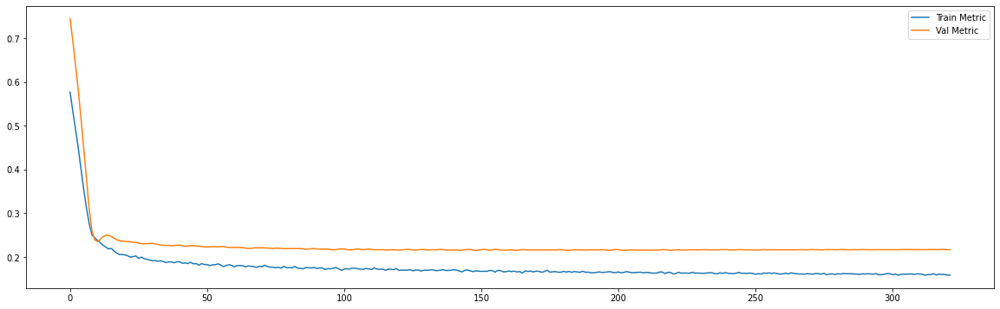

Epoch 00320: early stopping
============================model:47===========================
27/27 [==============================] - 1s 30ms/step - loss: 0.0370 - mae: 0.1545
loss and metric train data [0.03696206584572792, 0.15452364087104797]
3/3 [==============================] - 0s 21ms/step - loss: 0.0756 - mae: 0.2176
loss and metric val data [0.07557035237550735, 0.2176257222890854]
3/3 [==============================] - 0s 20ms/step - loss: 0.1566 - mae: 0.3095
loss and metric test data [0.15663987398147583, 0.3095360994338989]


'neurons': 30, 'dropout': 0.4, 'time_steps': 240, 'batch_size':240, 'hidden_layers':2




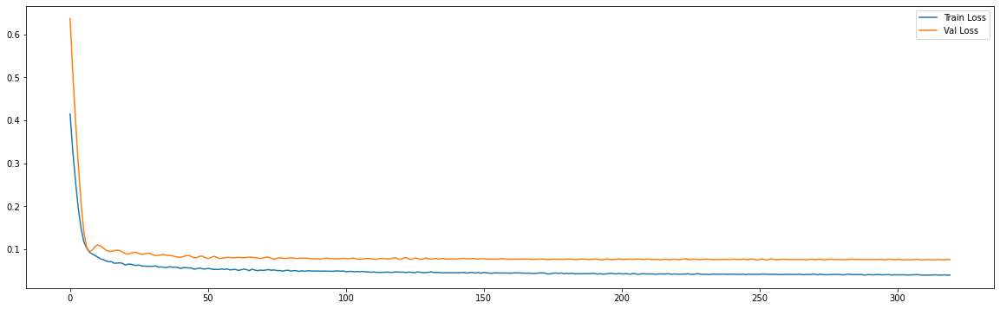

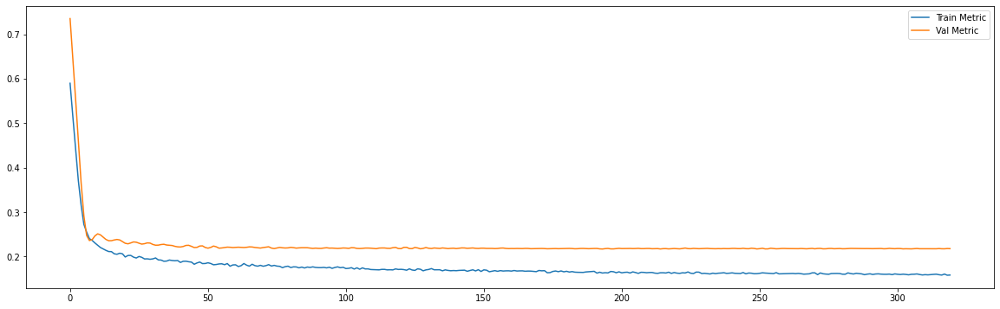

In [0]:
future_steps = 5
n_features = 1

neurons_list = [20,25,30]
dropout_list = [0.2,0.4]
time_steps_list = [30,60,120,240]
lr_list = [0.001]
models = {}
i=0
for neurons in neurons_list:
  for dropout in dropout_list:
    for time_steps in time_steps_list:
      for lr in lr_list:
        x_train,x_test,x_val,y_train,y_val,y_test = Regressor(future_steps = future_steps,time_steps = time_steps,n_features = n_features,df_train = df_train_norm,df_val = df_val_norm,df_test = df_test_norm)

        models[i] = {'neurons':neurons,'dropout':dropout,'time_steps': time_steps, 'batch_size':time_steps, 'learning_rate':lr}
        models[i]['resumo'] = "'neurons': {}, 'dropout': {}, 'time_steps': {}, 'batch_size':{}, 'learning_rate':{}, 'hidden_layers':{}".format(neurons,dropout,time_steps,time_steps,lr,1)

        # The GRU architecture
        models[i]['model'] = Sequential()
        models[i]['model'].add(GRU(units=neurons, return_sequences=False,input_shape=(time_steps, n_features))) # return_sequences=True next layer is GRU
        models[i]['model'].add(Dropout(dropout))
        models[i]['model'].add(Dense(units=future_steps))

        #Compiling the GRU
        adam = optimizers.Adam(lr = lr, beta_1 = 0.9, beta_2 = 0.999, decay = 0.0)
        models[i]['model'].compile(optimizer = adam, loss = 'mse', metrics=['mae'])

        # early stop
        es = EarlyStopping(monitor='val_loss', mode='min', verbose=1, patience = 70)

        #Fitting to traning set
        history = models[i]['model'].fit(x_train, y_train, validation_data = (x_val,y_val), epochs = 500, batch_size = time_steps, verbose = 0, shuffle = False, callbacks = [es])

        print('============================model:{}==========================='.format(i))

          
        print('loss and metric train data',models[i]['model'].evaluate(x_train,y_train))
        print('loss and metric val data',models[i]['model'].evaluate(x_val,y_val))
        print('loss and metric test data',models[i]['model'].evaluate(x_test,y_test))
        print('\n')

        print(models[i]['resumo'])
        print('\n')

        plt.figure(figsize=(20,6))
        plt.plot(history.history['loss'])
        plt.plot(history.history['val_loss'])
        plt.legend(['Train Loss', 'Val Loss'])

        plt.figure(figsize=(20,6))
        plt.plot(history.history['mae'])
        plt.plot(history.history['val_mae'])
        plt.legend(['Train Metric', 'Val Metric'])
        plt.show()

        i+=1


        models[i] = {'neurons':neurons,'dropout':dropout,'time_steps': time_steps, 'batch_size':time_steps}
        models[i]['resumo'] = "'neurons': {}, 'dropout': {}, 'time_steps': {}, 'batch_size':{}, 'hidden_layers':{}".format(neurons,dropout,time_steps,time_steps,2)

        # The GRU architecture
        models[i]['model'] = Sequential()
        models[i]['model'].add(GRU(units=neurons, return_sequences=True,input_shape=(time_steps, n_features))) # return_sequences=True next layer is GRU
        models[i]['model'].add(Dropout(dropout))
        models[i]['model'].add(GRU(units=neurons, return_sequences=False))
        models[i]['model'].add(Dropout(dropout))
        models[i]['model'].add(Dense(units=future_steps))

        #Compiling the GRU
        adam = optimizers.Adam(lr = lr, beta_1 = 0.9, beta_2 = 0.999, decay = 0.0)
        models[i]['model'].compile(optimizer = adam, loss = 'mse', metrics=['mae'])

         # early stop
        es = EarlyStopping(monitor='val_loss', mode='min', verbose=1, patience = 70)

        #Fitting to traning set
        history = models[i]['model'].fit(x_train, y_train, validation_data = (x_val,y_val), epochs = 500, batch_size = time_steps, verbose = 0, shuffle = False, callbacks = [es])

        print('============================model:{}==========================='.format(i))

          
        print('loss and metric train data',models[i]['model'].evaluate(x_train,y_train))
        print('loss and metric val data',models[i]['model'].evaluate(x_val,y_val))
        print('loss and metric test data',models[i]['model'].evaluate(x_test,y_test))
        print('\n')

        print(models[i]['resumo'])
        print('\n')

        plt.figure(figsize=(20,6))
        plt.plot(history.history['loss'])
        plt.plot(history.history['val_loss'])
        plt.legend(['Train Loss', 'Val Loss'])

        plt.figure(figsize=(20,6))
        plt.plot(history.history['mae'])
        plt.plot(history.history['val_mae'])
        plt.legend(['Train Metric', 'Val Metric'])
        plt.show()

        i+=1